# Emotion Recognition


## Environment Preparation

### Package Importing

In [19]:
import os
import sys
import torch
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from itertools import combinations  # For generating combinations of values
import pandas as pd
from IPython.display import display
import psychai.data_visualization.chart
from scipy.stats import ttest_1samp, ttest_ind, pearsonr, f_oneway  # For statistical tests
from dotenv import load_dotenv
import pickle
import psychai.data_preparation.preprocessing
import psychai.machine_learning.classification_supervise_learning
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import itertools
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import pandas as pd
import seaborn as sns
from sklearn.model_selection import StratifiedKFold, cross_val_predict, KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import matplotlib.pyplot as plt
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

import pandas as pd
import itertools

# Extend system path to current directory (for importing modules if needed)
current_dir = os.path.abspath('../')
sys.path.append(current_dir)

import local_utilities
import local_data_loader

### Parameters Setting

In [20]:

chart_helper = psychai.data_visualization.chart.Chart()
data_loader = local_data_loader.DataLoader()
emotion_classification_task = local_utilities.EmotionClassificationTask()
outlier_multiplier = 3
group_names = {
    1: "ELVT",
    2: "SYMP",
    3: "ADMR",
    4: "CTRL"
}
path_mm_llm = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/mm_llm/csv_output/results_20241109_processed_and_merged.csv"
path_thermal = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/thermal/summarized_results/df_with_features_20241108.csv"
path_r_ppg = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/remote_ppg/csv_output/results_20241108.csv"
path_eye_movement = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/eye_movement/csv/eye_movement_features_cache_20241106.csv"
path_pose = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/pose/pose_features_cache_20241101_2.csv"
path_facial_target = r'/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/facial/facial_features_cache_20241220.csv'
path_facial_baseline = r'/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/facial/facial_features_baseline_cache_20241226.csv'
path_speech_text = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/speech_text/csv/result_speech_sentiment_concatenated_20241223.csv"
path_acoustic_target = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/audio/audio_features_target.csv"
path_acoustic_baseline = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/audio/audio_features_baseline.csv"
path_pickle_df_list = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/early_fusion/df_list.plk"
path_pickle_df_names = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/early_fusion/df_names.plk"
path_pickle_df_predictions = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/early_fusion/df_predictions.plk"
path_pickle_df_evaluations = r"/mnt/c/Working/Programming/Python/results/wsl2/examples/paper5_mmer_moral/early_fusion/df_evaluations.plk"

In [21]:
def run_analysis(df, df_name, param_combinations, verbose = False, model_grid_search_parameters = {}, random_state=1):

    # Initialize a DataFrame to store evaluation results
    # This will hold the outcomes of each experiment for comparison
    df_all_evaluations = pd.DataFrame()
    df_all_predictions = pd.DataFrame()
    # all_y_pred_list = pd.DataFrame()
    # all_y_true_list = pd.DataFrame()
    # all_group_list = pd.DataFrame()
    # Iterate over each combination of parameters
    for n_kept, do_anova, do_rfe, do_model_grid_search, model_name, rfe_model_name, group_column in param_combinations:

        # Set up the RFE model based on the name
        # RFE (Recursive Feature Elimination) requires a model to rank features
        if rfe_model_name == "Random Forest":
            rfe_model = RandomForestClassifier(random_state=random_state)  # Random Forest as the RFE estimator
        elif rfe_model_name == "SVM":
            rfe_model = SVC(kernel="linear", random_state=random_state)  # SVM with linear kernel for RFE
        else:
            # Raise an error if the RFE model is not supported
            raise ValueError(f"Unsupported RFE model: {rfe_model_name}")

        # Log the current configuration for tracking
        print(f"=== Task: {df_name}, Model: {model_name}, RFE Model: {rfe_model_name}, "
            f"n_kept: {n_kept}, ANOVA: {do_anova}, RFE: {do_rfe}, Grid Search: {do_model_grid_search} ===")

        if model_grid_search_parameters == {}:
            model_grid_search_parameters= {
                # Parameters to tune during Grid Search for the Random Forest model
                'n_estimators': [50,100],  # Number of trees in the forest
                #'max_features': ['sqrt', 'log2', 0.1],  # Number of features to consider at each split: 'sqrt', 'log2', 0.1
                'max_depth': [2, 3, 5, 10, None],  # Maximum depth of the tree
                'min_samples_split': [2,3],  # Minimum samples required to split an internal node
                'min_samples_leaf': [1,2],  # Minimum samples required to be a leaf node
                'bootstrap': [True, False]  # Whether bootstrap samples are used when building trees
            }            
        # Define the parameters for the emotion classification task
        # This dictionary contains all the configuration needed for running the task
        parameters = {
            "model_name": model_name,  # Name of the classification model
            "group_column": group_column, # Name of the column to group rows by
            "run_1": True,  # First experimental run
            "run_2": True,  # Second experimental run
            "run_3": True,  # Third experimental run
            "verbose": verbose,  # Whether to print detailed logs during training
            "visualization": True,  # Whether to create visual outputs (e.g., confusion matrices)
            "do_anova": do_anova,  # Whether to apply ANOVA for feature selection
            "n_cross_validation": 10,  # Number of folds for cross-validation
            "percentage_kept_by_anova": 0.7,  # Proportion of features to retain after ANOVA
            "do_rfe": do_rfe,  # Whether to apply Recursive Feature Elimination
            "rfe_model": rfe_model,  # Model to be used for RFE
            "n_kept": n_kept,  # Number of features to keep after RFE
            "do_model_grid_search": do_model_grid_search,  # Whether to perform Grid Search
            "random_state": random_state,  # Random seed for reproducibility
            "model_grid_search_parameters": model_grid_search_parameters
        }

        # Add special parameters for MLP (Multi-Layer Perceptron) if applicable
        if model_name == "MLP":
            parameters["model_initial_parameters"] = {
                "hidden_layer_sizes": (128, 64)  # MLP hidden layer sizes, customizable
            }

        # Run the emotion classification task with the defined parameters
        # This function should handle the training, validation, and evaluation of the model
        (accuracy_1, accuracy_2, accuracy_3, all_y_pred, 
        all_y_true, all_group) = emotion_classification_task.run_emotion_classification_tasks(df, parameters=parameters)

        # Prepare evaluation results for this iteration
        # Store the configuration and resulting accuracy in a DataFrame
        result_evaluations = pd.DataFrame({
            'df_name': [df_name],  # Name of the dataset
            'model_name': [model_name],  # Classification model used
            'do_rfe': [do_rfe],  # Model used for RFE
            'rfe_model_name': [rfe_model_name],  # Model used for RFE
            'n_kept': [n_kept],  # Number of features retained
            'do_model_grid_search': [do_model_grid_search],  # Whether Grid Search was applied
            'do_anova': [do_anova],  # Whether ANOVA was applied
            'Accuracy1': [accuracy_1],  # Save the third accuracy value as an example
            'Accuracy2': [accuracy_2],  # Save the third accuracy value as an example
            'Accuracy3': [accuracy_3]  # Save the third accuracy value as an example
        })

        result_prediction = pd.DataFrame({
            'df_name': [df_name]*len(all_y_pred),  # Name of the dataset
            'all_y_pred': all_y_pred,  # Classification model used
            'all_y_true': all_y_true,  # Model used for RFE
            'all_group': all_group,  # Number of features retained
        })

        # Append results to the cumulative DataFrame
        # Concatenate results from each experiment for comparison
        df_all_evaluations = pd.concat([df_all_evaluations, result_evaluations], ignore_index=True)
        df_all_predictions = pd.concat([df_all_predictions, result_prediction], ignore_index=True)     

    # Final evaluation DataFrame
    # This DataFrame contains the results of all experiments and can be exported or analyzed further
    return df_all_evaluations, df_all_predictions

## Data Preparation

### Data Loading

In [22]:
def save_to_cache(data, cache_file):
    """Save data to a pickle cache file."""
    with open(cache_file, 'wb') as f:
        pickle.dump(data, f)

def load_from_cache(cache_file):
    """Load data from a pickle cache file."""
    with open(cache_file, 'rb') as f:
        return pickle.load(f)

In [23]:
if os.path.exists(path_pickle_df_list) and os.path.exists(path_pickle_df_names):
    try:
        all_df = load_from_cache(path_pickle_df_list)
        all_df_name = load_from_cache(path_pickle_df_names)
        print("Pickle files loaded successfully.")
    except Exception as e:
        print(f"Failed to load pickle files: {e}. Re-running processing.")
        all_df = None
        all_df_name = None
else:
    df_pose = data_loader.get_pose_features_without_landmarks_data_frame(record_path= path_pose, prefix = "pose")
    df_acoustics = data_loader.get_acoustics_df(path_acoustic_target, path_acoustic_baseline, prefix = "acoustics")
    df_speech_text = data_loader.get_speech_text_df(path_speech_text, prefix = "speech_text")
    df_facial = data_loader.get_facial_df(file_target_path = path_facial_target, file_baseline_path = path_facial_baseline, outlier_multiplier= outlier_multiplier, prefix = "facial")
    df_eye_movement = data_loader.get_eye_movement_df(path_eye_movement, prefix = "eye_move")
    df_remote_ppg = data_loader.get_r_ppg_df(record_path= path_r_ppg, df_info = df_pose[df_pose.columns[0:2]], prefix = "r_ppg")
    df_thermal = data_loader.get_thermal_df(path_thermal, prefix = "thermal")
    df_mm_llm = data_loader.get_mm_llm_df(path_mm_llm, prefix = "mm_llm")
    all_df = [df_acoustics,df_speech_text,df_facial,df_pose,df_eye_movement,df_remote_ppg,df_thermal,df_mm_llm]
    all_df_name = ["df_acoustics","df_speech_text","df_facial","df_pose","df_eye_movement","df_remote_ppg","df_thermal","df_mm_llm"]
    save_to_cache(all_df, path_pickle_df_list)
    save_to_cache(all_df_name, path_pickle_df_names)

Pickle files loaded successfully.


In [25]:
for index in range(len(all_df)):
    df = all_df[index]
    print(f"table {all_df_name[index]}, number of columns: {len(df.columns.tolist())}")

table df_acoustics, number of columns: 494
table df_speech_text, number of columns: 86
table df_facial, number of columns: 142
table df_pose, number of columns: 46
table df_eye_movement, number of columns: 66
table df_remote_ppg, number of columns: 9
table df_thermal, number of columns: 246
table df_mm_llm, number of columns: 3450


## Single Variate Analysis

In [26]:
df_multimodal_evaluations = pd.DataFrame()
df_multimodal_predictions = pd.DataFrame()

### 1. Speech Acoustics

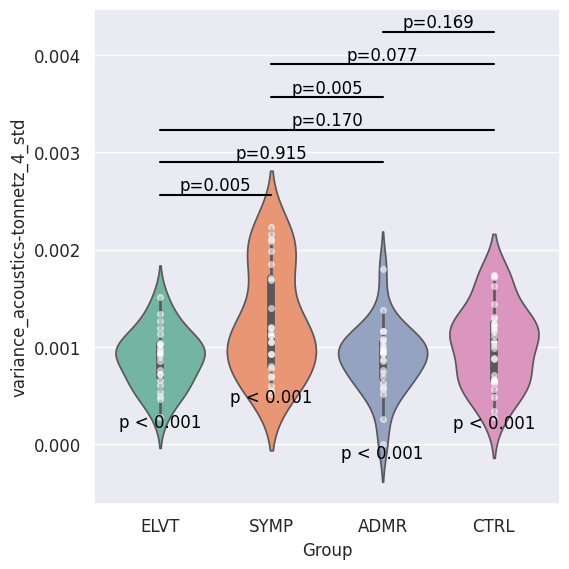

variance_acoustics-tonnetz_4_std: F(3, 97) = 4.612, p=0.005


In [27]:
df = all_df[0]
df_name = "acoustics"
chart_helper = psychai.data_visualization.chart.Chart()
features_to_plot= ['variance_acoustics-tonnetz_4_std']
chart_helper.draw_violin(df, features_to_plot, group_names = group_names)

=== Task: acoustics, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: True, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.5445544554455446
Total Recall: 0.5445544554455446
Total F1 Score: 0.5415723715228665


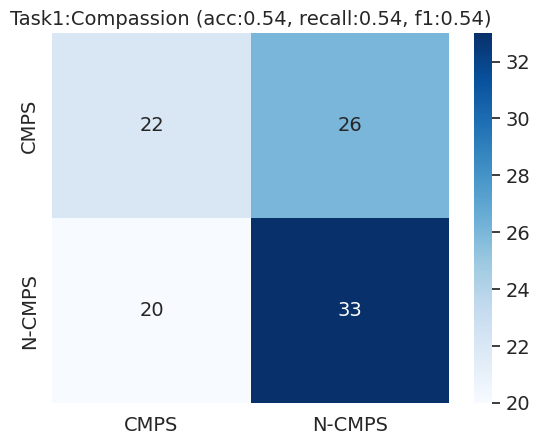

ROC-AUC for Task1:Compassion: 0.5776


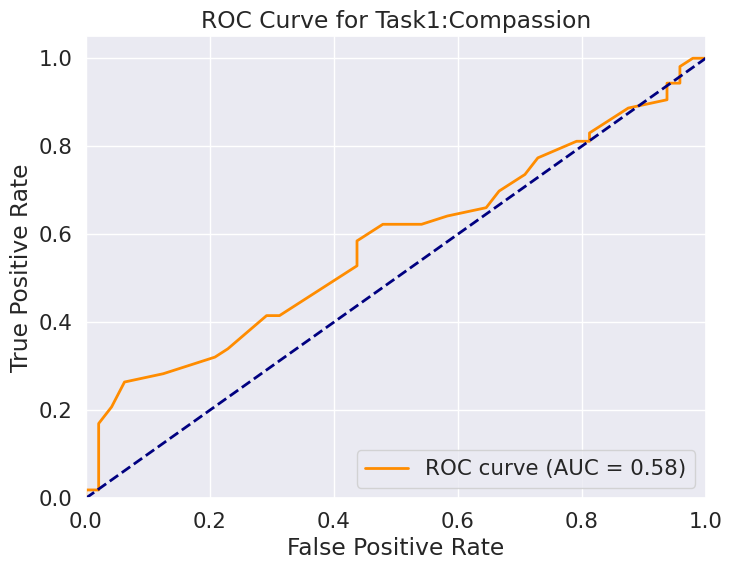

Top 5 Features by Mean Importance:['variance_acoustics-F3amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'max_acoustics-spectral_centroid_std']


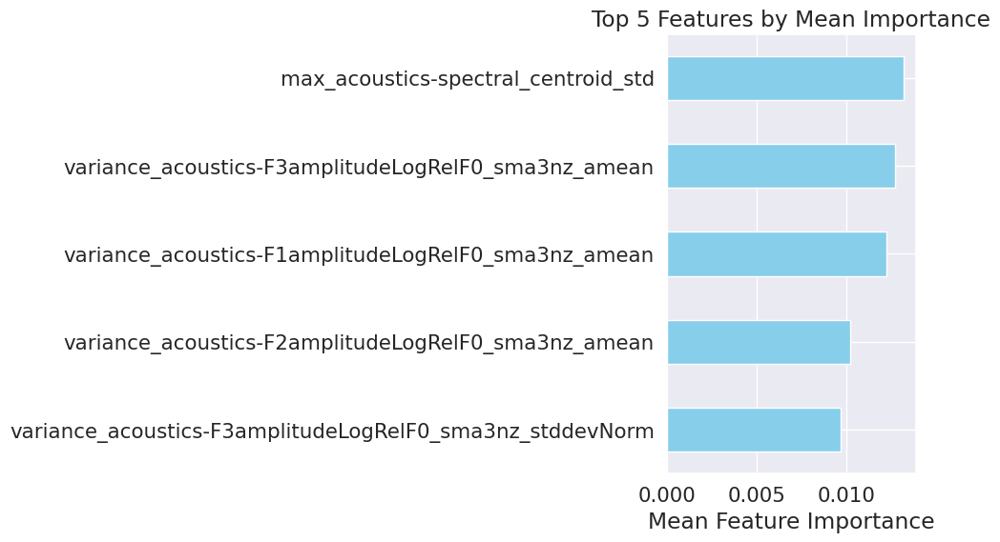

random_state:1
Total Accuracy: 0.5643564356435643
Total Recall: 0.5643564356435643
Total F1 Score: 0.5624548169102624


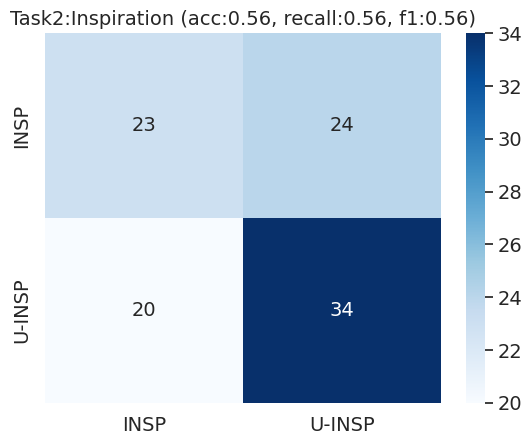

ROC-AUC for Task2:Inspiration: 0.5366


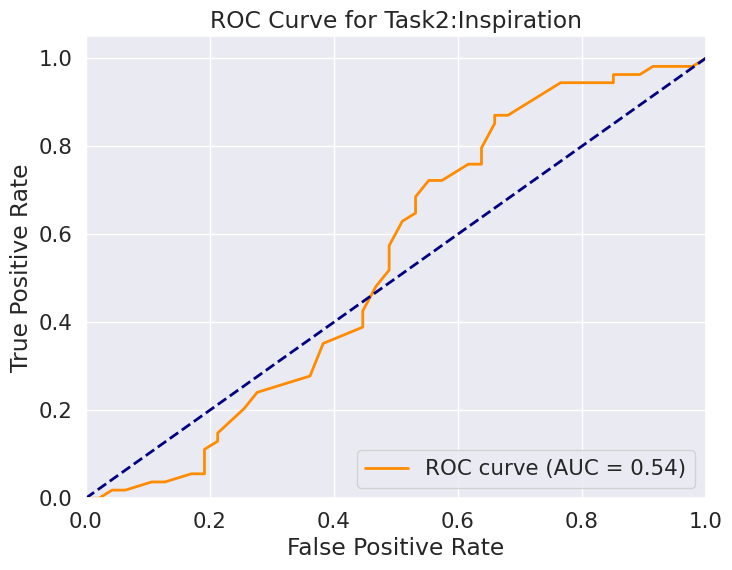

Top 5 Features by Mean Importance:['median_acoustics-F2bandwidth_sma3nz_amean', 'variance_acoustics-chroma_6_std', 'variance_acoustics-loudness_sma3_stddevRisingSlope', 'median_acoustics-alphaRatioUV_sma3nz_amean', 'variance_acoustics-tonnetz_4_std']


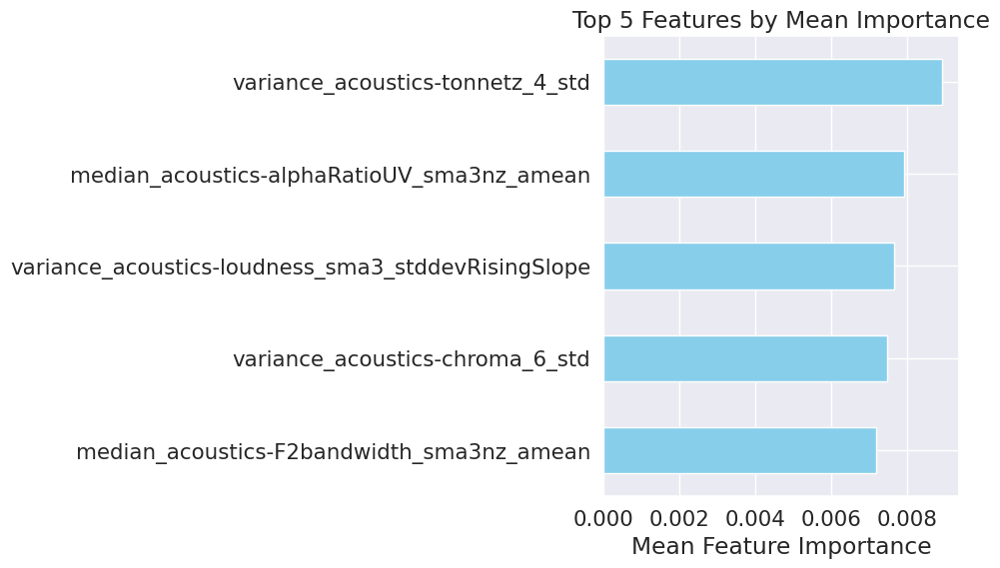

random_state:1
Total Accuracy: 0.3069306930693069
Total Recall: 0.3069306930693069
Total F1 Score: 0.29550091878120255


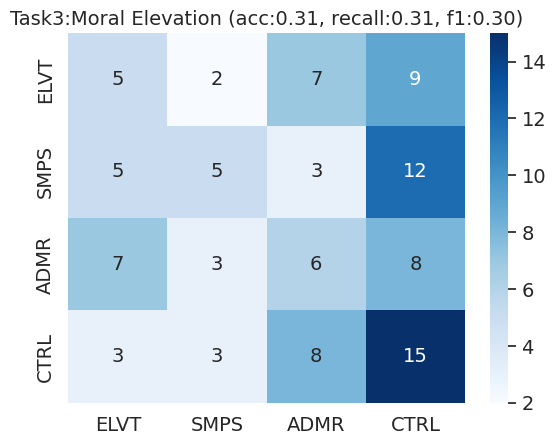

Top 5 Features by Mean Importance:['median_acoustics-chroma_7_std', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'max_acoustics-spectral_centroid_std', 'variance_acoustics-chroma_3_mu', 'median_acoustics-tonnetz_3_std']


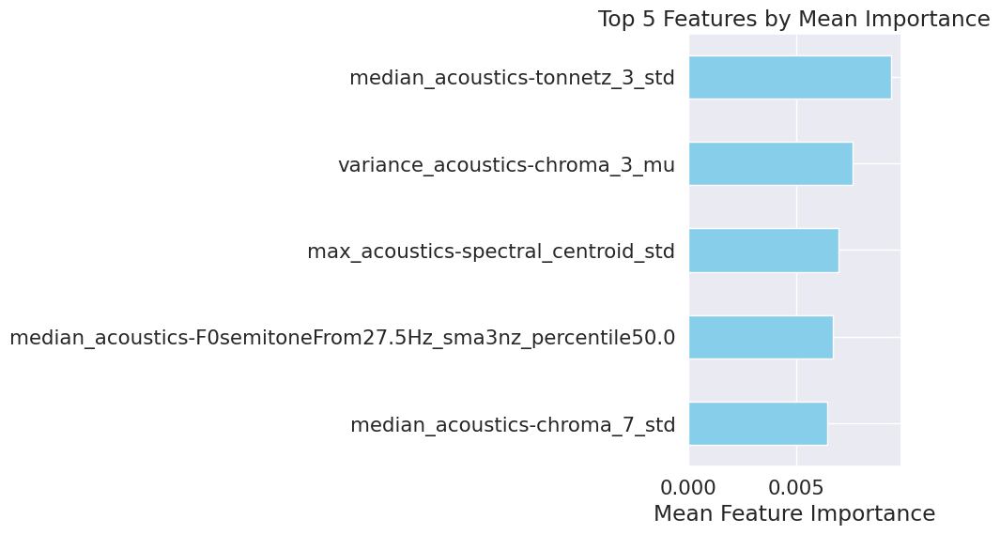

     df_name     model_name  do_rfe rfe_model_name  n_kept  \
0  acoustics  Random Forest   False            SVM      15   

   do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0                 False      True   0.544554   0.564356   0.306931  
       df_name all_y_pred all_y_true  all_group
0    acoustics     N-CMPS       CMPS          1
1    acoustics     N-CMPS     N-CMPS         12
2    acoustics     N-CMPS       CMPS         22
3    acoustics     N-CMPS       CMPS         36
4    acoustics     N-CMPS     N-CMPS         48
..         ...        ...        ...        ...
298  acoustics       CTRL       SMPS         59
299  acoustics       SMPS       SMPS         69
300  acoustics       ELVT       SMPS         83
301  acoustics       ADMR       CTRL         96
302  acoustics       CTRL       CTRL        106

[303 rows x 4 columns]


In [28]:
import itertools
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [True]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations)

print(df_all_evaluations)
print(df_all_predictions)

df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   


### 2. Speech Text

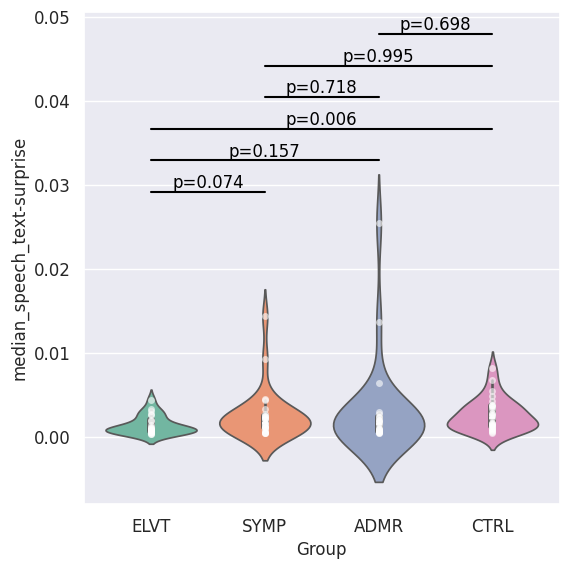

median_speech_text-surprise: F(3, 97) = 1.112, p=0.348


In [29]:
# Assuming df_facial is a pre-loaded DataFrame for this task
# Replace this with the actual DataFrame to be used
df = all_df[1]
df_name = "speech_text"  # Name of the dataset, used for logging and tracking


chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
features_to_plot = ['median_speech_text-surprise']
to_remove_outlier = False
do_within_group_t_test = False
outlier_multiplier = 3
chart_helper.draw_violin(df, features_to_plot, to_remove_outlier, outlier_multiplier, do_within_group_t_test, group_names = group_names)

=== Task: speech_text, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.594059405940594
Total Recall: 0.594059405940594
Total F1 Score: 0.5938197951620051


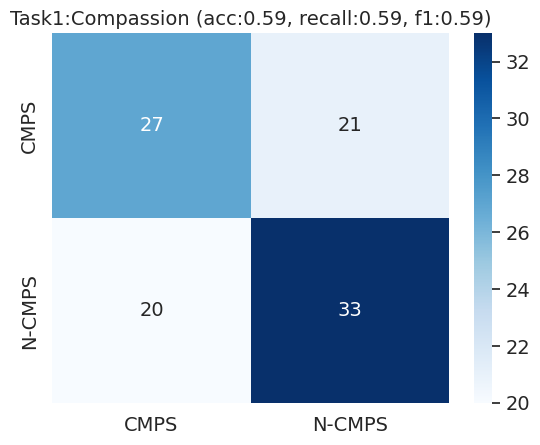

ROC-AUC for Task1:Compassion: 0.6295


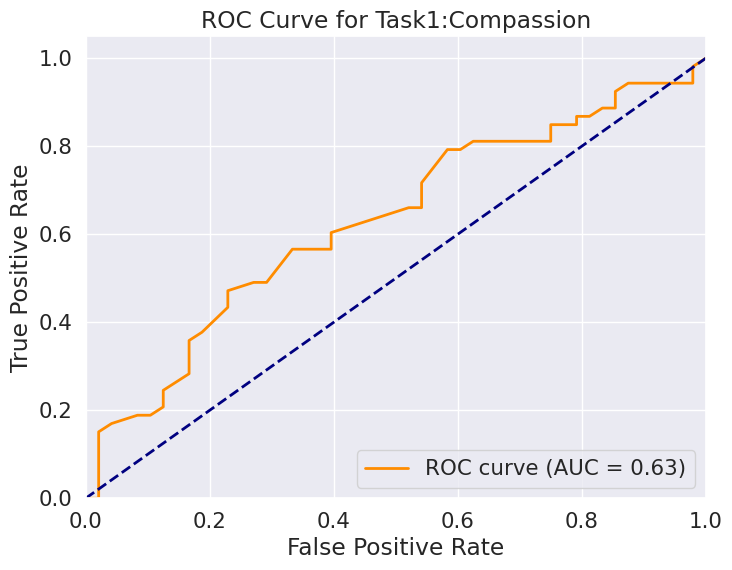

Top 5 Features by Mean Importance:['median_speech_text-disapproval', 'variance_speech_text-grief', 'max_speech_text-sadness', 'variance_speech_text-caring', 'max_speech_text-caring']


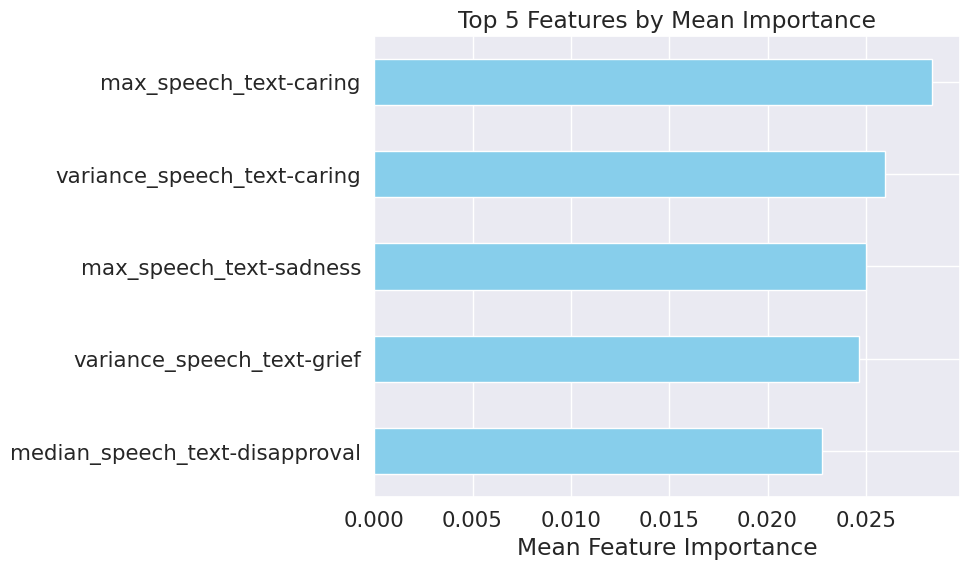

random_state:1
Total Accuracy: 0.6336633663366337
Total Recall: 0.6336633663366337
Total F1 Score: 0.6314778042386122


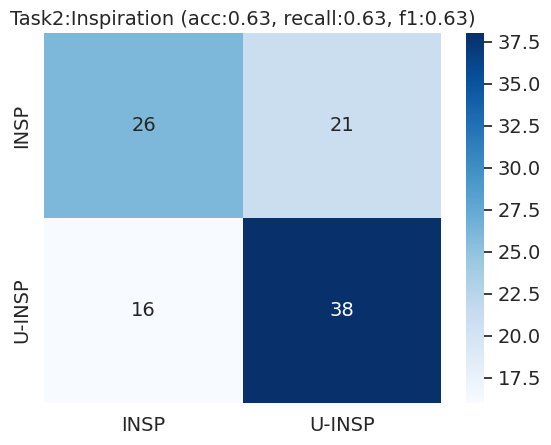

ROC-AUC for Task2:Inspiration: 0.6481


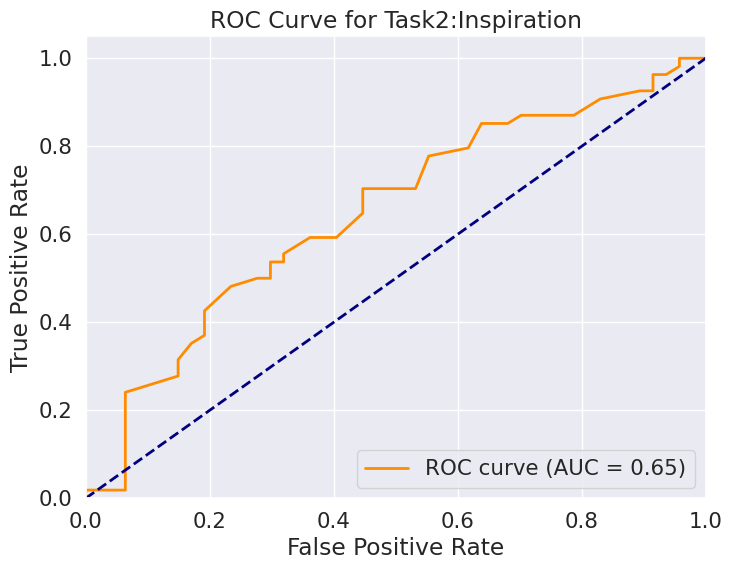

Top 5 Features by Mean Importance:['max_speech_text-caring', 'max_speech_text-disapproval', 'max_speech_text-annoyance', 'variance_speech_text-disapproval', 'median_speech_text-surprise']


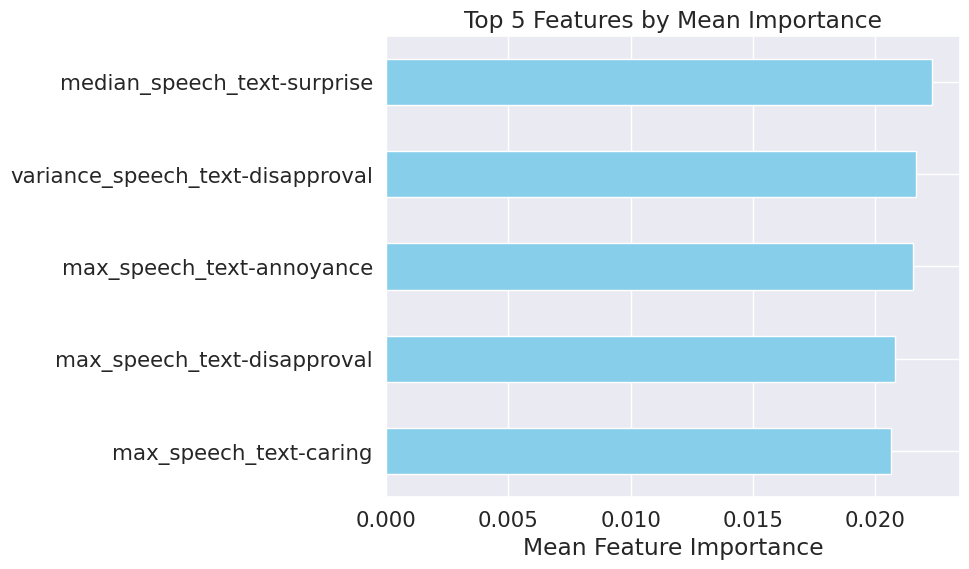

random_state:1
Total Accuracy: 0.44554455445544555
Total Recall: 0.44554455445544555
Total F1 Score: 0.4364463933877743


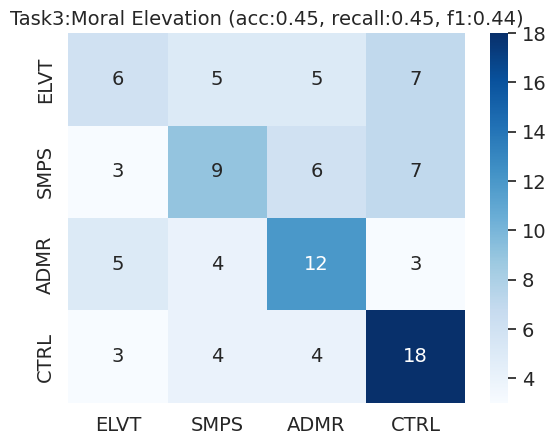

Top 5 Features by Mean Importance:['median_speech_text-sadness', 'variance_speech_text-caring', 'max_speech_text-disapproval', 'variance_speech_text-disapproval', 'max_speech_text-caring']


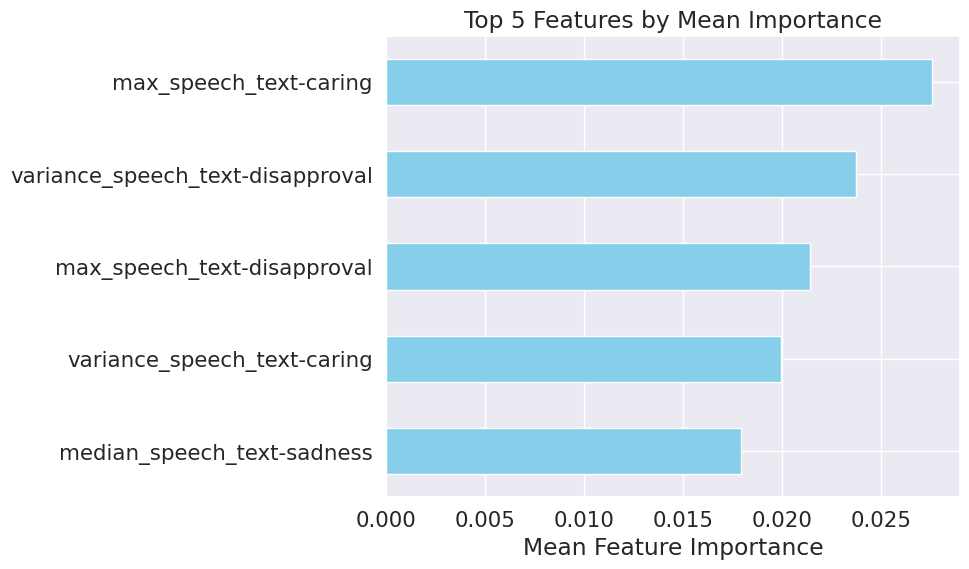

       df_name     model_name  do_rfe rfe_model_name  n_kept  \
0  speech_text  Random Forest   False            SVM      15   

   do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0                 False     False   0.594059   0.633663   0.445545  
         df_name all_y_pred all_y_true  all_group
0    speech_text     N-CMPS       CMPS          1
1    speech_text     N-CMPS     N-CMPS         12
2    speech_text     N-CMPS       CMPS         22
3    speech_text       CMPS       CMPS         36
4    speech_text     N-CMPS     N-CMPS         48
..           ...        ...        ...        ...
298  speech_text       CTRL       SMPS         59
299  speech_text       ELVT       SMPS         69
300  speech_text       SMPS       SMPS         83
301  speech_text       CTRL       CTRL         96
302  speech_text       CTRL       CTRL        106

[303 rows x 4 columns]


In [30]:
import itertools
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations)

print(df_all_evaluations)
print(df_all_predictions)

df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   

In [31]:
print(df_all_evaluations)

       df_name     model_name  do_rfe rfe_model_name  n_kept  \
0  speech_text  Random Forest   False            SVM      15   

   do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0                 False     False   0.594059   0.633663   0.445545  


### 3. Facial Expression 

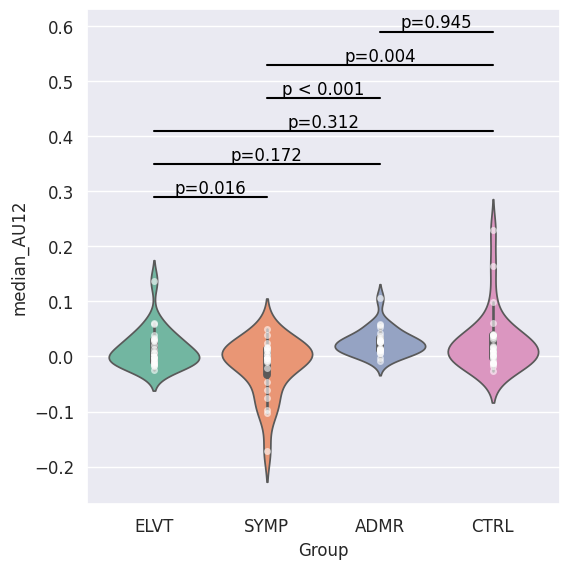

median_AU12: F(3, 95) = 5.676, p=0.001


In [32]:
# Assuming df_facial is a pre-loaded DataFrame for this task
# Replace this with the actual DataFrame to be used
df = all_df[2]
df_name = "facial"  # Name of the dataset, used for logging and tracking

chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
features_to_plot = ['median_AU12']
to_remove_outlier = False
do_within_group_t_test = False
outlier_multiplier = 3
chart_helper.draw_violin(df, features_to_plot, to_remove_outlier, outlier_multiplier, do_within_group_t_test, group_names = group_names)

=== Task: facial, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: True, Grid Search: False ===
random_state:1
Total Accuracy: 0.5959595959595959
Total Recall: 0.5959595959595959
Total F1 Score: 0.5915970334574986


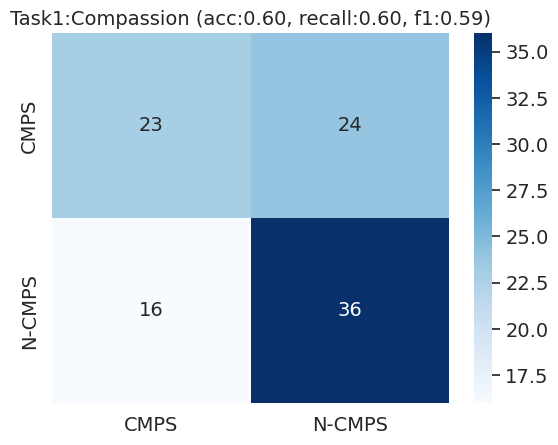

ROC-AUC for Task1:Compassion: 0.6187


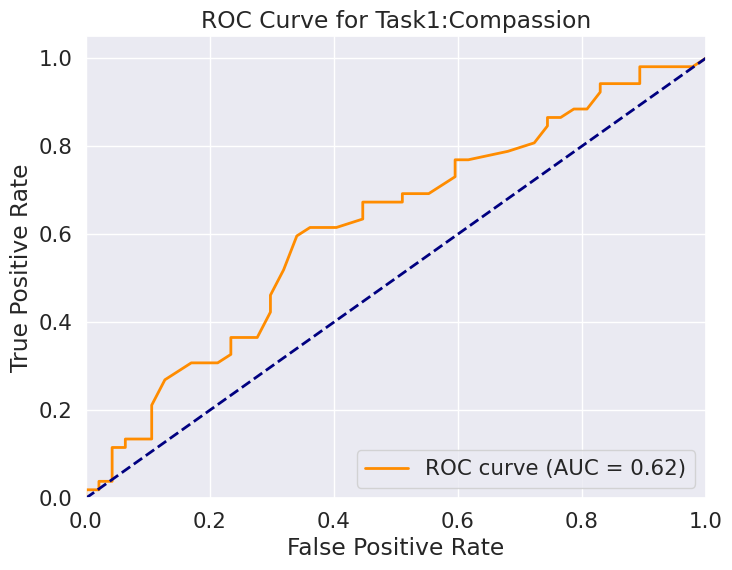

Top 5 Features by Mean Importance:['max_sadness', 'max_AU04', 'median_AU12', 'median_FaceRectX', 'variance_AU28']


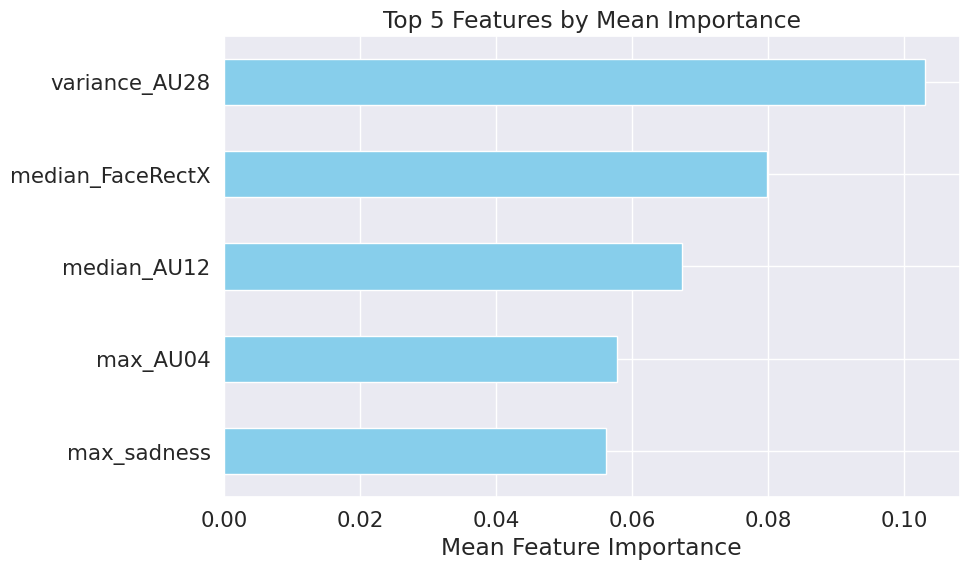

random_state:1
Total Accuracy: 0.494949494949495
Total Recall: 0.494949494949495
Total F1 Score: 0.4903581267217631


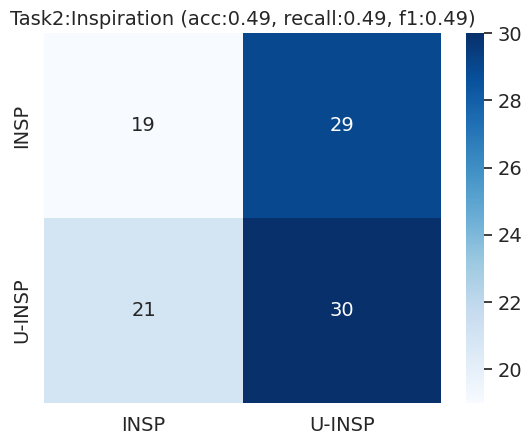

ROC-AUC for Task2:Inspiration: 0.4894


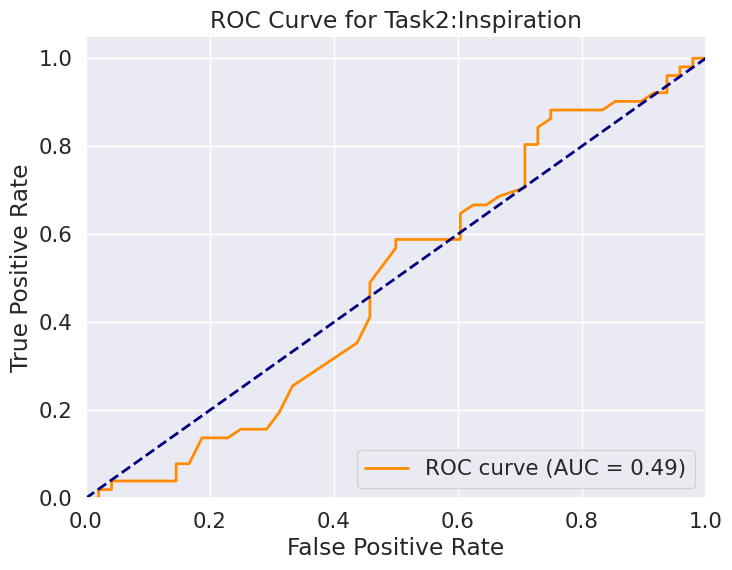

Top 5 Features by Mean Importance:['median_AU06', 'end_to_begin_AU15', 'median_AU05', 'max_AU23', 'variance_Pitch']


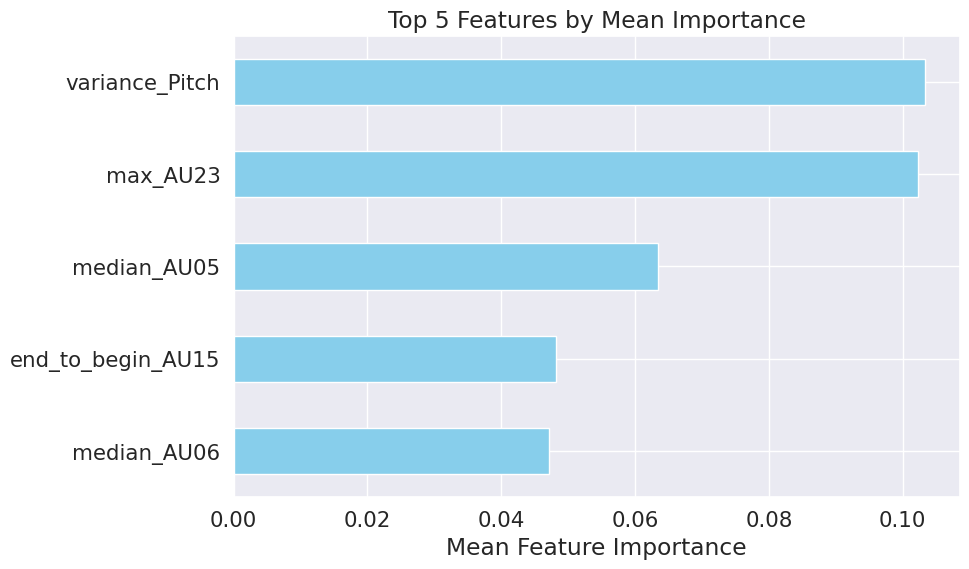

random_state:1
Total Accuracy: 0.43434343434343436
Total Recall: 0.43434343434343436
Total F1 Score: 0.43203693115642805


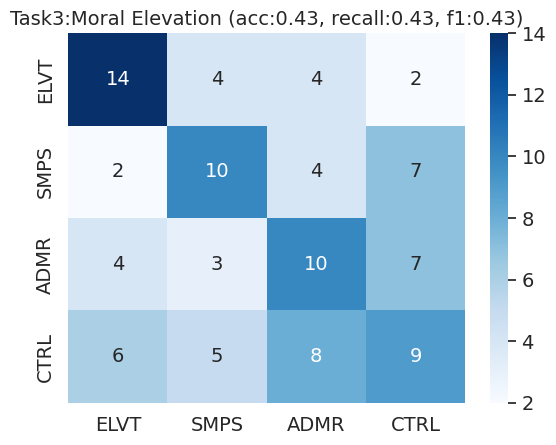

Top 5 Features by Mean Importance:['variance_AU28', 'variance_Pitch', 'max_AU23', 'max_AU04', 'median_AU12']


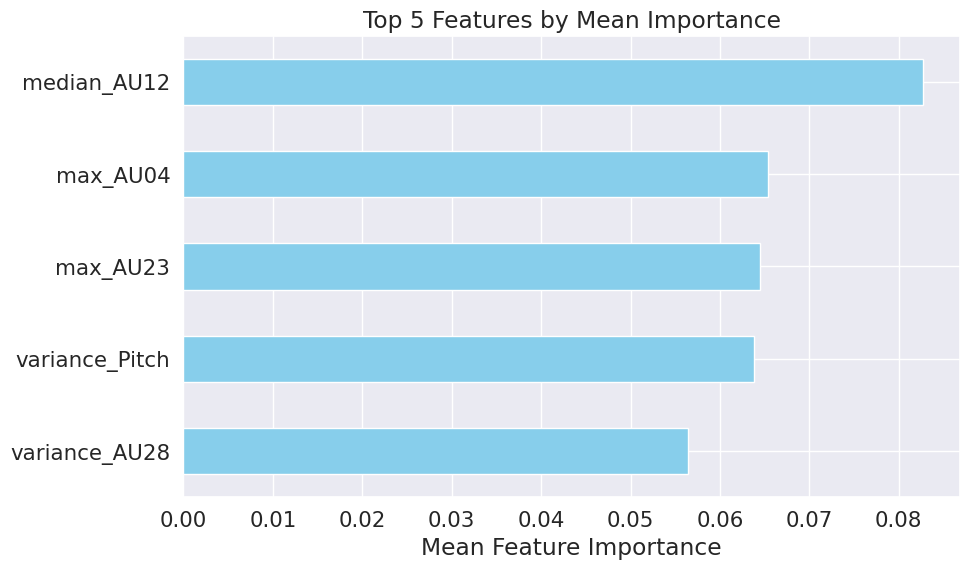

In [33]:
import itertools
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC



# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [True]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations)

df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   


### 4. Pose Analysis

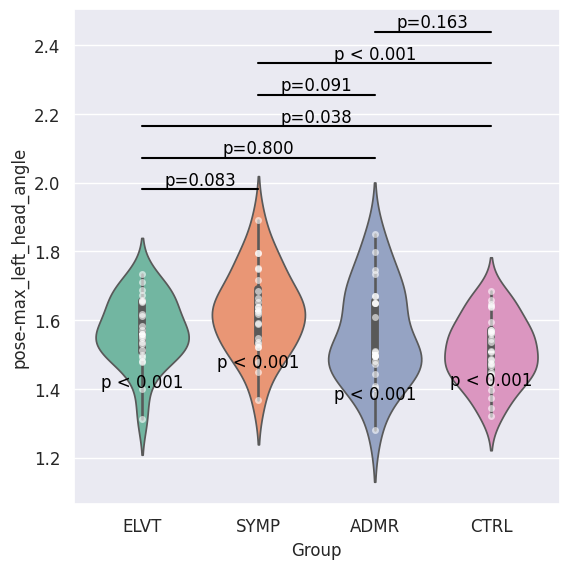

pose-max_left_head_angle: F(3, 97) = 4.327, p=0.007


In [34]:
df = all_df[3]
df_name = "pose"  # Name of the dataset, used for logging and tracking

chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
features_to_plot = ['pose-max_left_head_angle']
chart_helper.draw_violin(df, features_to_plot, group_names = group_names)

=== Task: pose, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: True, RFE: True, Grid Search: False ===
random_state:1
Total Accuracy: 0.6336633663366337
Total Recall: 0.6336633663366337
Total F1 Score: 0.6334471322193704


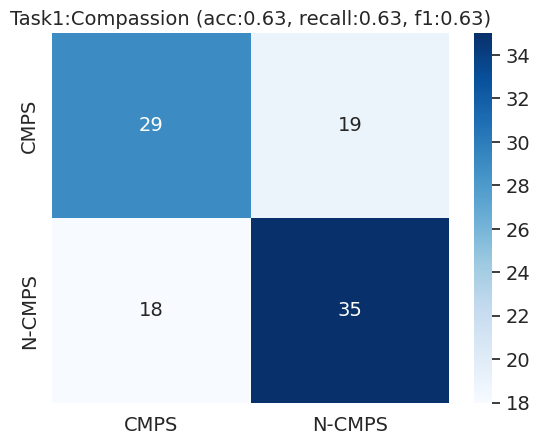

ROC-AUC for Task1:Compassion: 0.6676


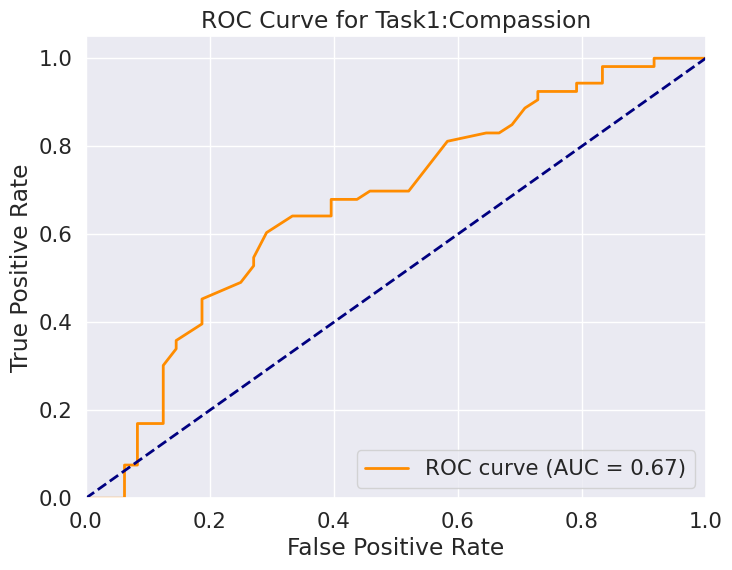

Top 5 Features by Mean Importance:['pose-max_nose_to_lip_difference_x', 'pose-max_ear_to_ear_difference_x', 'pose-variance_nose_to_lip_difference_y', 'pose-max_right_head_angle', 'pose-max_left_head_angle']


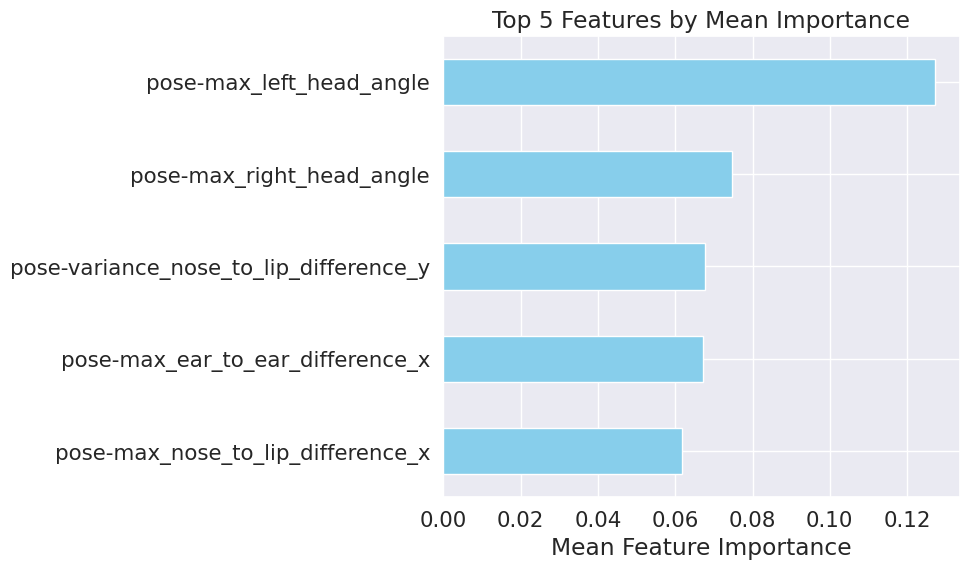

random_state:1
Total Accuracy: 0.5841584158415841
Total Recall: 0.5841584158415841
Total F1 Score: 0.5843214909726266


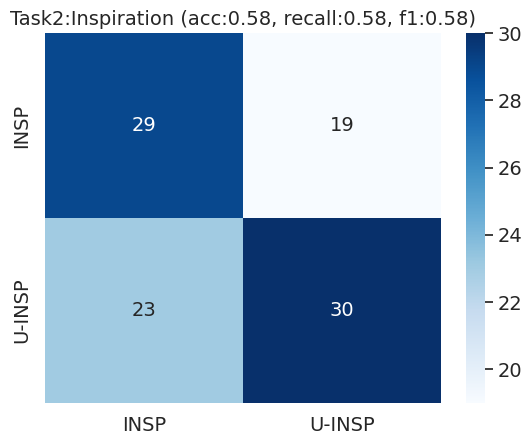

ROC-AUC for Task2:Inspiration: 0.6472


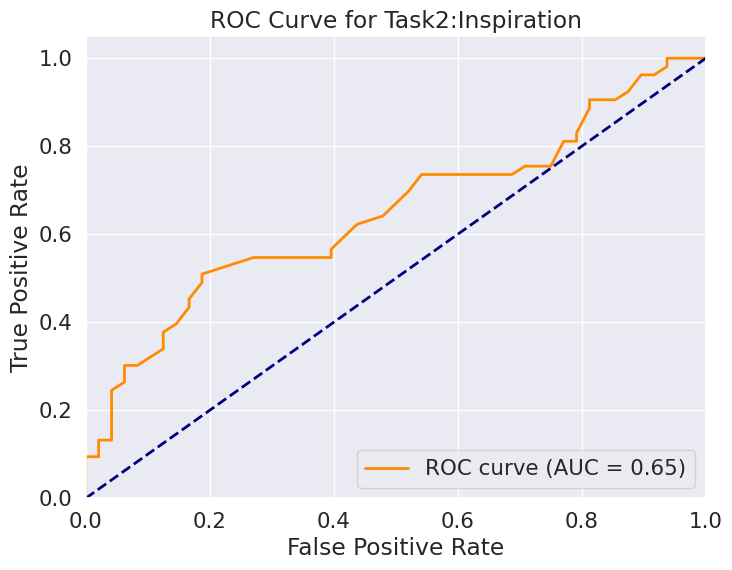

Top 5 Features by Mean Importance:['pose-end_to_begin_ear_to_ear_difference_x', 'pose-mean_nose_to_lip_difference_y', 'pose-end_to_begin_shoulder_to_shoulder_difference_x', 'pose-variance_nose_to_lip_difference_y', 'pose-max_ear_to_ear_difference_x']


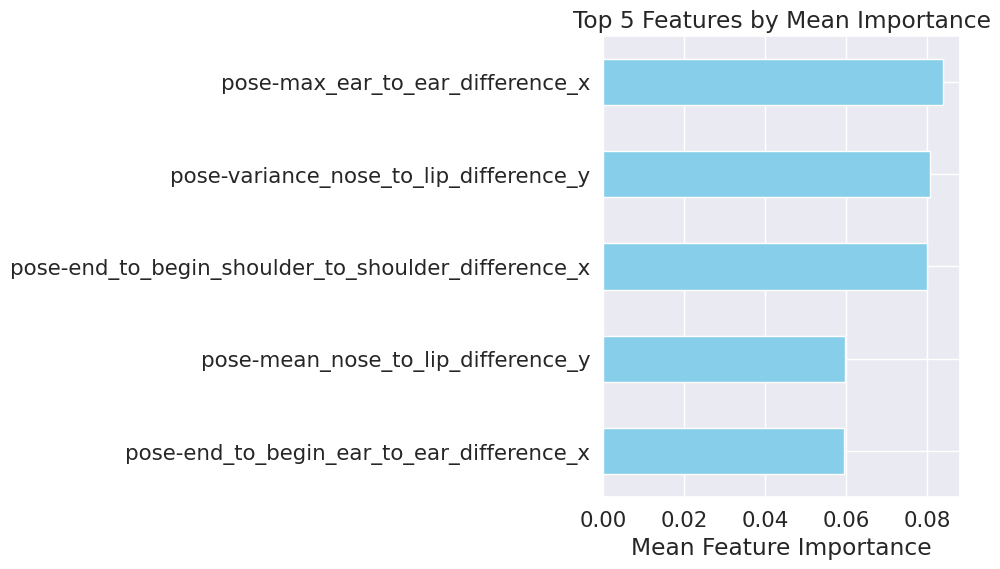

random_state:1
Total Accuracy: 0.36633663366336633
Total Recall: 0.36633663366336633
Total F1 Score: 0.3662729101445814


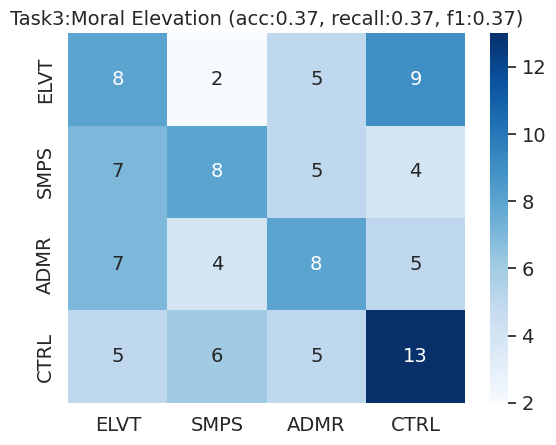

Top 5 Features by Mean Importance:['pose-mean_ear_to_ear_difference_x', 'pose-end_to_begin_ear_to_ear_difference_x', 'pose-mean_nose_to_lip_difference_y', 'pose-variance_nose_to_lip_difference_y', 'pose-max_left_head_angle']


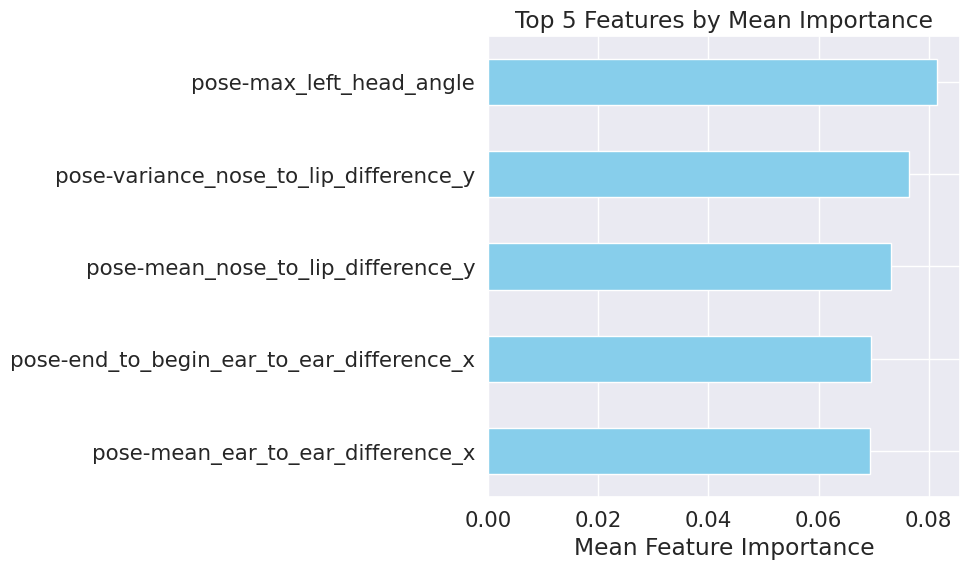

In [35]:
# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [True]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [True]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations)

df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   

### 5. Eye Tracking

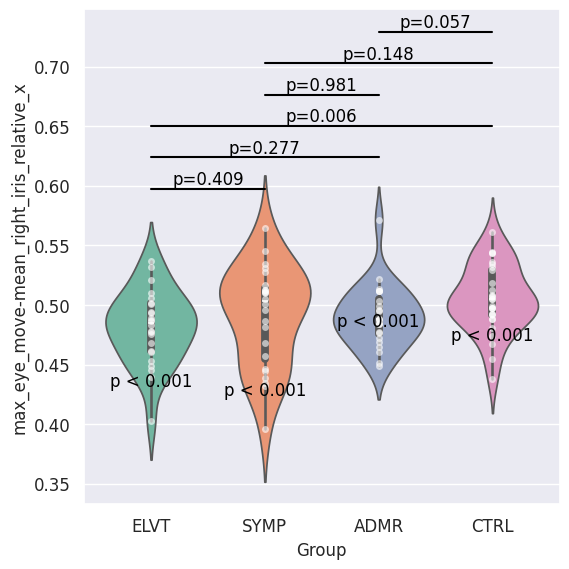

max_eye_move-mean_right_iris_relative_x: F(3, 97) = 2.499, p=0.064


In [36]:
df = all_df[4]
# df = df_eye_movement
df_name = "eye"

chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
features_to_plot = ['max_eye_move-mean_right_iris_relative_x']
chart_helper.draw_violin(df, features_to_plot, group_names = group_names)

=== Task: eye, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
The 1-th run fold score: 0.6363636363636364
The 2-th run fold score: 0.5
The 3-th run fold score: 0.5
The 4-th run fold score: 0.6
The 5-th run fold score: 0.3
The 6-th run fold score: 0.7
The 7-th run fold score: 0.4
The 8-th run fold score: 0.6
The 9-th run fold score: 0.5
The 10-th run fold score: 0.4
Cross-Validation Scores: [0.6363636363636364, 0.5, 0.5, 0.6, 0.3, 0.7, 0.4, 0.6, 0.5, 0.4]
Mean Accuracy: 0.5136363636363637
Total Accuracy: 0.5148514851485149
Total Recall: 0.5148514851485149
Total F1 Score: 0.5137028648114885


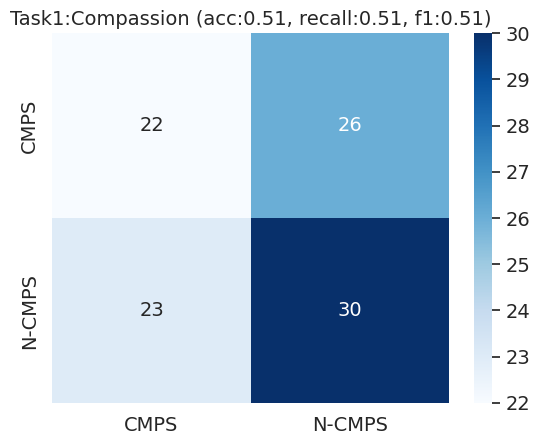

ROC-AUC for Task1:Compassion: 0.5609


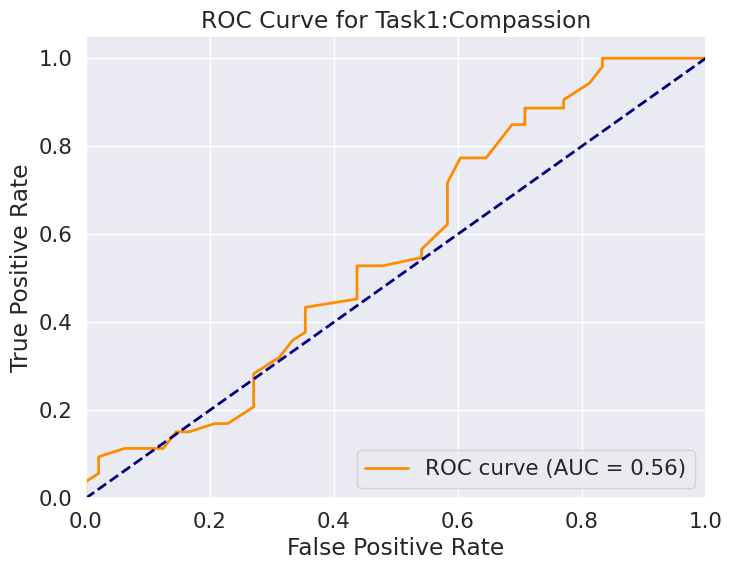

Top 5 Features by Mean Importance:['max_eye_move-mean_right_iris_relative_x', 'max_eye_move-variance_left_eye_height', 'max_eye_move-mean_right_iris_relative_y', 'max_eye_move-end_to_begin_right_iris_relative_x', 'median_eye_move-end_to_begin_right_iris_relative_y']


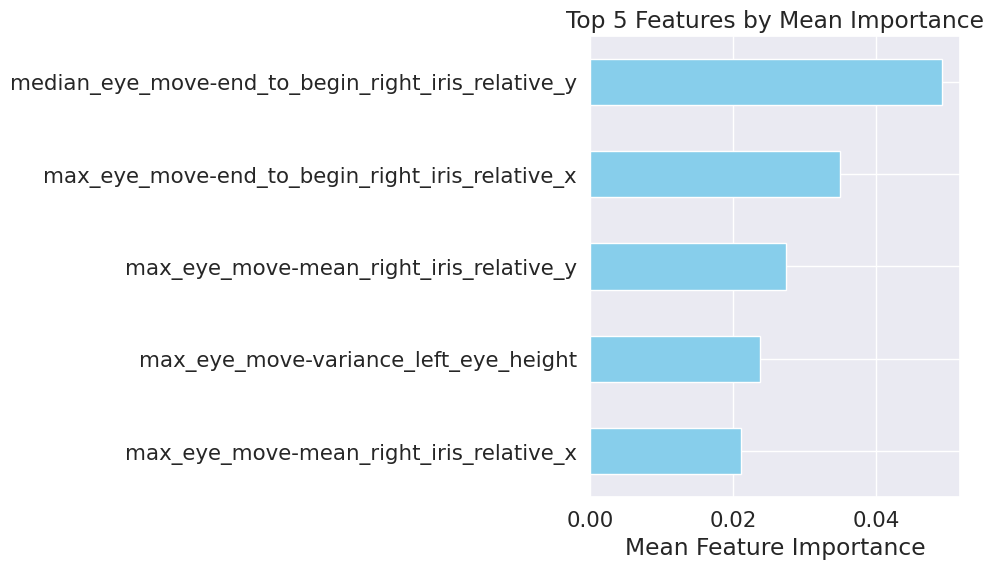

random_state:1
The 1-th run fold score: 0.5454545454545454
The 2-th run fold score: 0.4
The 3-th run fold score: 0.7
The 4-th run fold score: 0.5
The 5-th run fold score: 0.5
The 6-th run fold score: 0.6
The 7-th run fold score: 0.4
The 8-th run fold score: 0.6
The 9-th run fold score: 0.5
The 10-th run fold score: 0.8
Cross-Validation Scores: [0.5454545454545454, 0.4, 0.7, 0.5, 0.5, 0.6, 0.4, 0.6, 0.5, 0.8]
Mean Accuracy: 0.5545454545454546
Total Accuracy: 0.5544554455445545
Total Recall: 0.5544554455445545
Total F1 Score: 0.5534005901329997


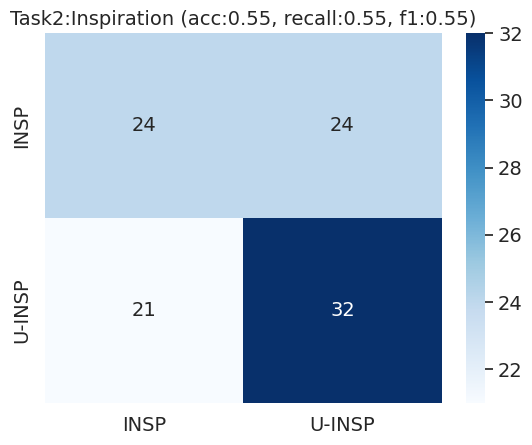

ROC-AUC for Task2:Inspiration: 0.6105


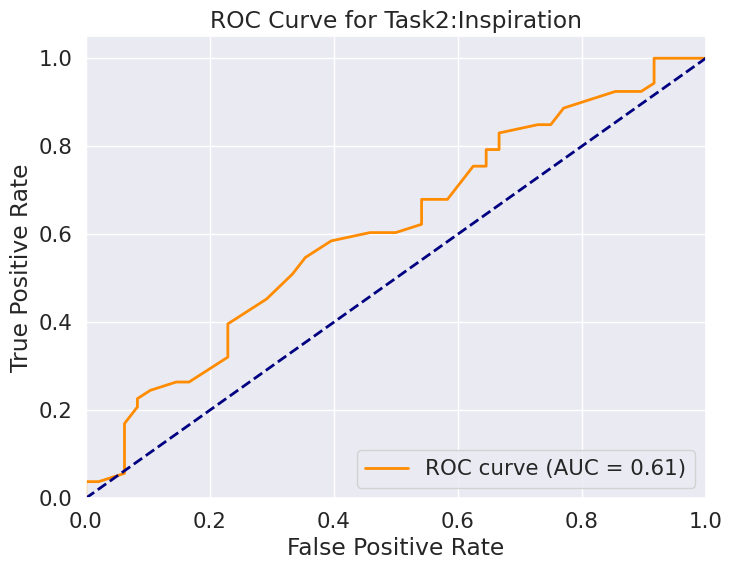

Top 5 Features by Mean Importance:['median_eye_move-end_to_begin_left_eye_width', 'median_eye_move-mean_right_iris_relative_x', 'max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_left_eye_width']


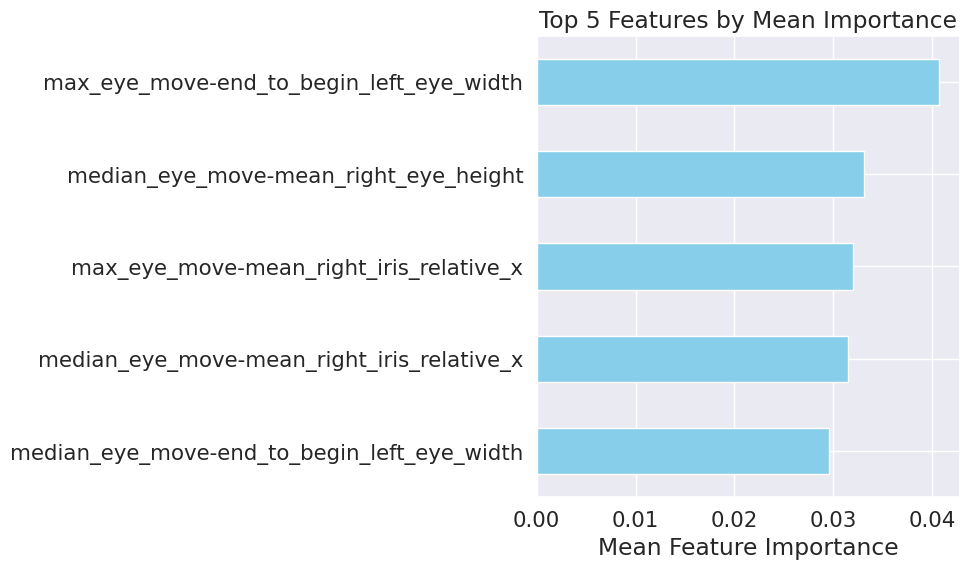

random_state:1
The 1-th run fold score: 0.18181818181818182
The 2-th run fold score: 0.1
The 3-th run fold score: 0.2
The 4-th run fold score: 0.4
The 5-th run fold score: 0.1
The 6-th run fold score: 0.5
The 7-th run fold score: 0.3
The 8-th run fold score: 0.5
The 9-th run fold score: 0.2
The 10-th run fold score: 0.2
Cross-Validation Scores: [0.18181818181818182, 0.1, 0.2, 0.4, 0.1, 0.5, 0.3, 0.5, 0.2, 0.2]
Mean Accuracy: 0.2681818181818182
Total Accuracy: 0.26732673267326734
Total Recall: 0.26732673267326734
Total F1 Score: 0.2652755881432762


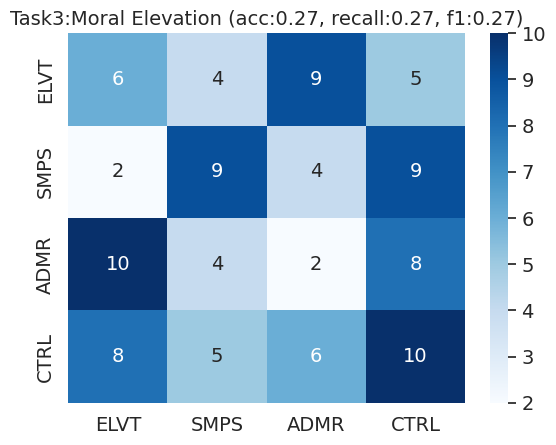

Top 5 Features by Mean Importance:['max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-end_to_begin_left_eye_width', 'max_eye_move-end_to_begin_left_iris_relative_y', 'median_eye_move-end_to_begin_right_iris_relative_y', 'max_eye_move-mean_right_iris_relative_x']


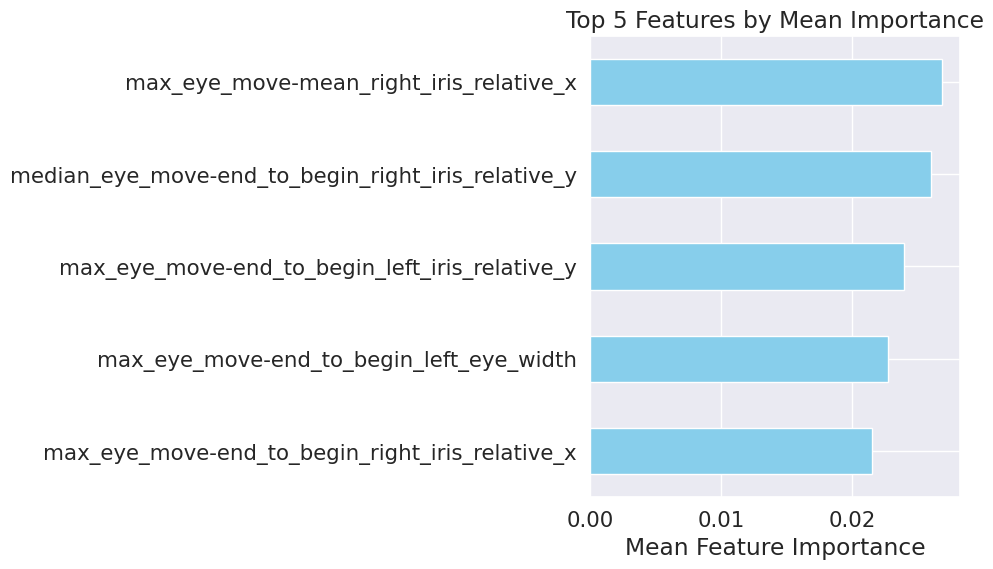

In [37]:
# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

model_grid_search_parameters= {
    # Parameters to tune during Grid Search for the Random Forest model
    'n_estimators': [50],  # Number of trees in the forest
    #'max_features': ['sqrt', 'log2', 0.1],  # Number of features to consider at each split: 'sqrt', 'log2', 0.1
    #'max_depth': [2, 3, 5, 10, None],  # Maximum depth of the tree
    #'min_samples_split': [2,3],  # Minimum samples required to split an internal node
    'min_samples_leaf': [3],  # Minimum samples required to be a leaf node
    'bootstrap': [True, False]  # Whether bootstrap samples are used when building trees
}     

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations, model_grid_search_parameters)
df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   

### 6. Remote PPG

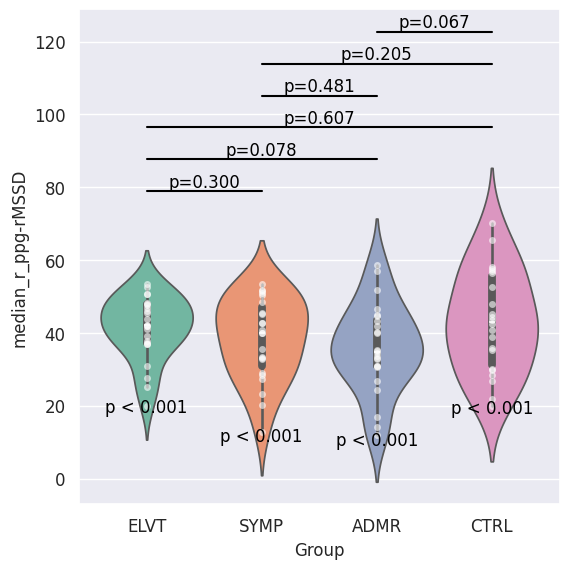

median_r_ppg-rMSSD: F(3, 89) = 1.800, p=0.153


In [38]:
df = all_df[5]
df_name = "r-PPG"

chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
features_to_plot = ["median_r_ppg-rMSSD"]
chart_helper.draw_violin(df, features_to_plot = features_to_plot, group_names = group_names)



=== Task: r-PPG, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.5053763440860215
Total Recall: 0.5053763440860215
Total F1 Score: 0.5053763440860215


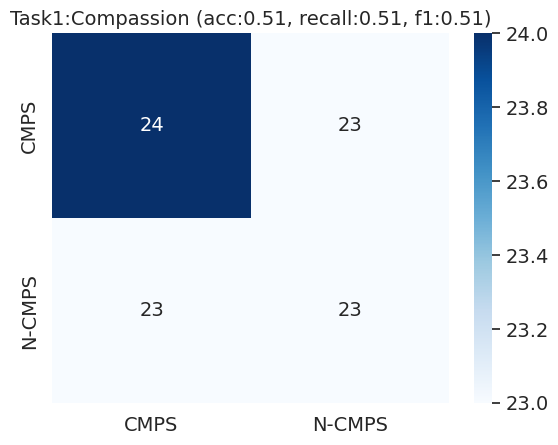

ROC-AUC for Task1:Compassion: 0.5460


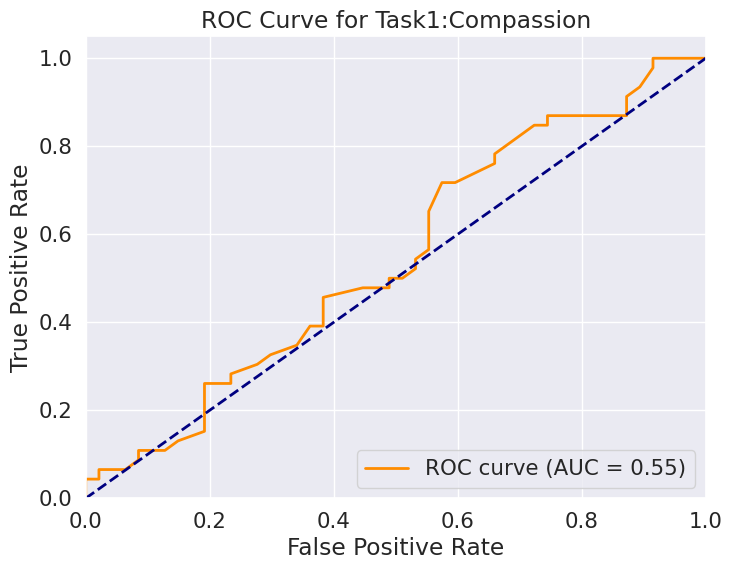

Top 5 Features by Mean Importance:['median_r_ppg-HF', 'median_r_ppg-SDNN', 'median_r_ppg-HR_Median', 'median_r_ppg-pNN50', 'median_r_ppg-rMSSD']


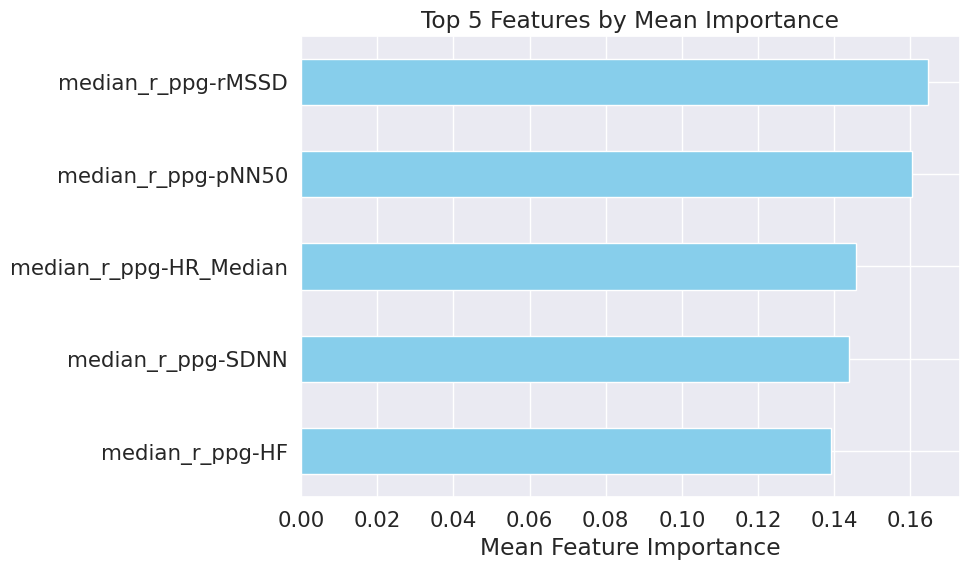

random_state:1
Total Accuracy: 0.5268817204301075
Total Recall: 0.5268817204301075
Total F1 Score: 0.5269911372385186


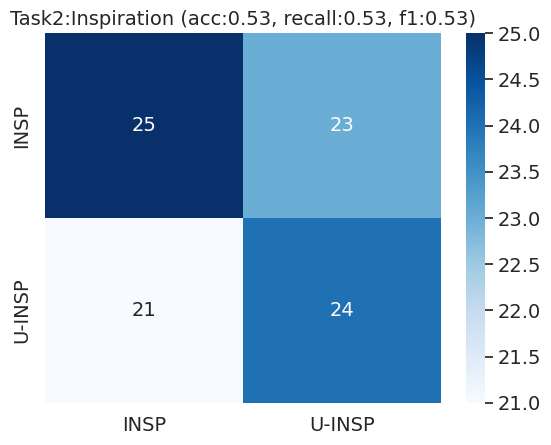

ROC-AUC for Task2:Inspiration: 0.4593


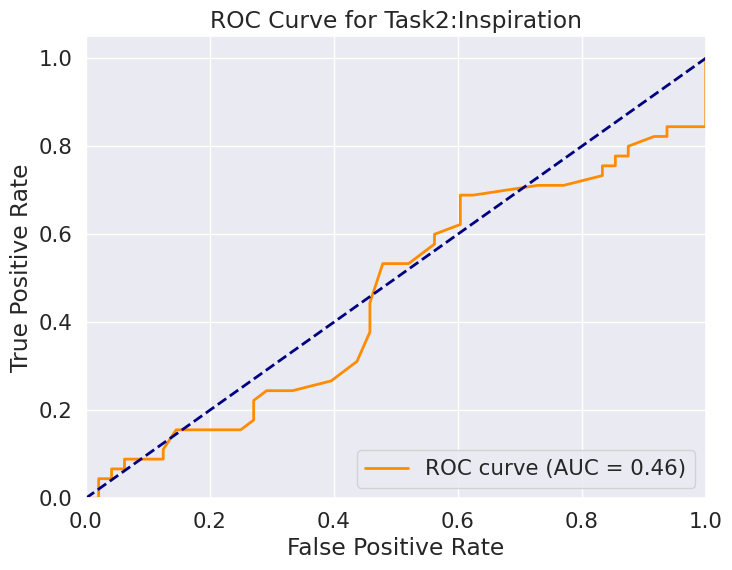

Top 5 Features by Mean Importance:['median_r_ppg-SDNN', 'median_r_ppg-LFHF', 'median_r_ppg-HR_Median', 'median_r_ppg-pNN50', 'median_r_ppg-HF']


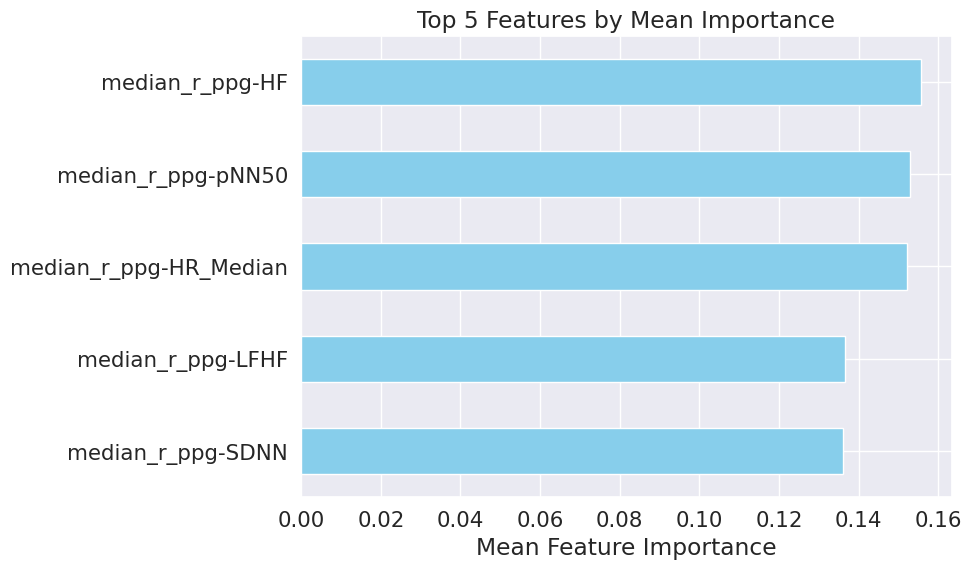

random_state:1
Total Accuracy: 0.26881720430107525
Total Recall: 0.26881720430107525
Total F1 Score: 0.26548813505335245


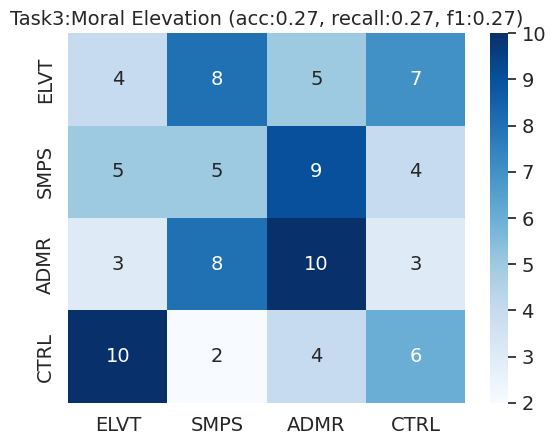

Top 5 Features by Mean Importance:['median_r_ppg-pNN50', 'median_r_ppg-rMSSD', 'median_r_ppg-HF', 'median_r_ppg-LF', 'median_r_ppg-HR_Median']


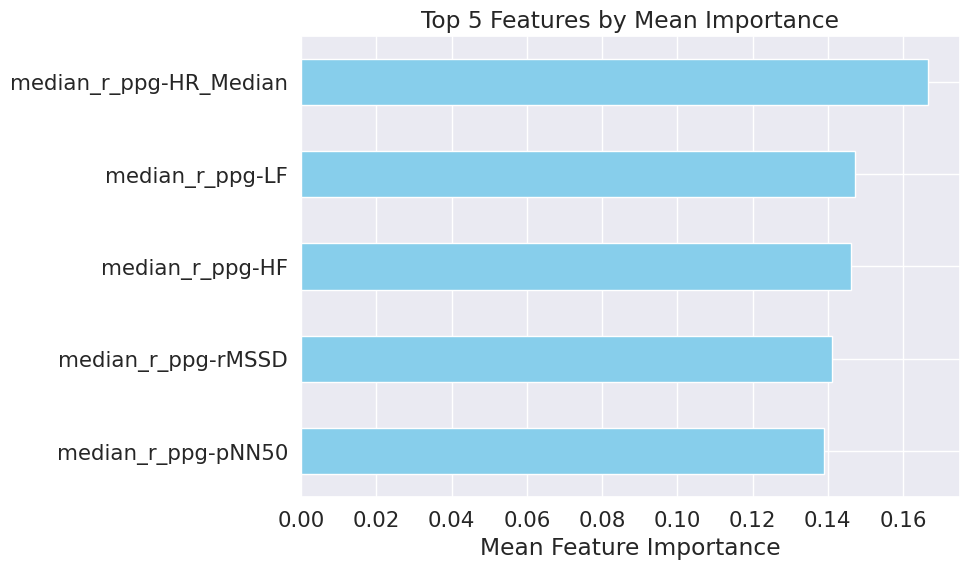

In [39]:
import itertools
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations)

df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   


### 7. Thermal

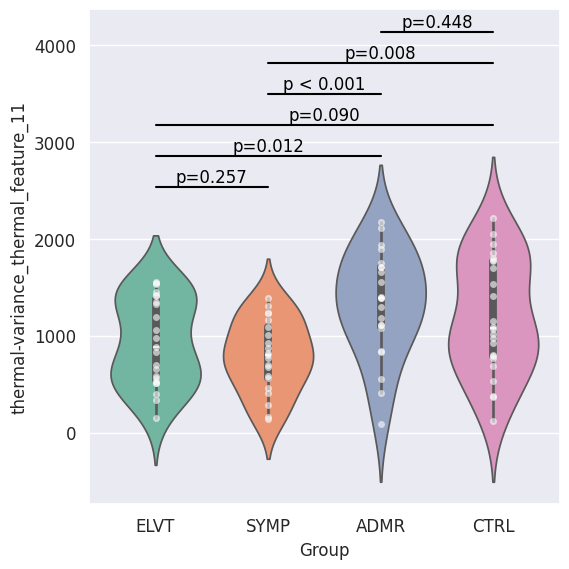

thermal-variance_thermal_feature_11: F(3, 86) = 5.204, p=0.002


In [40]:
df = all_df[6]
df_name = "thermal"

chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
features_to_plot = ['thermal-variance_thermal_feature_11']
to_remove_outlier = False
do_within_group_t_test = False
outlier_multiplier = 3
chart_helper.draw_violin(df, features_to_plot, to_remove_outlier, outlier_multiplier, do_within_group_t_test, group_names = group_names)

=== Task: thermal, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: True, Grid Search: False ===
random_state:1
Total Accuracy: 0.6666666666666666
Total Recall: 0.6666666666666666
Total F1 Score: 0.6666666666666666


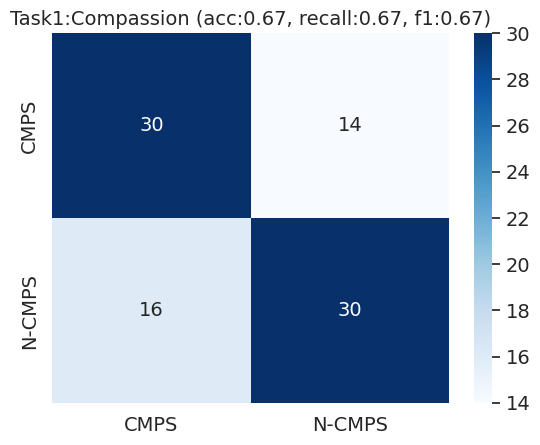

ROC-AUC for Task1:Compassion: 0.7315


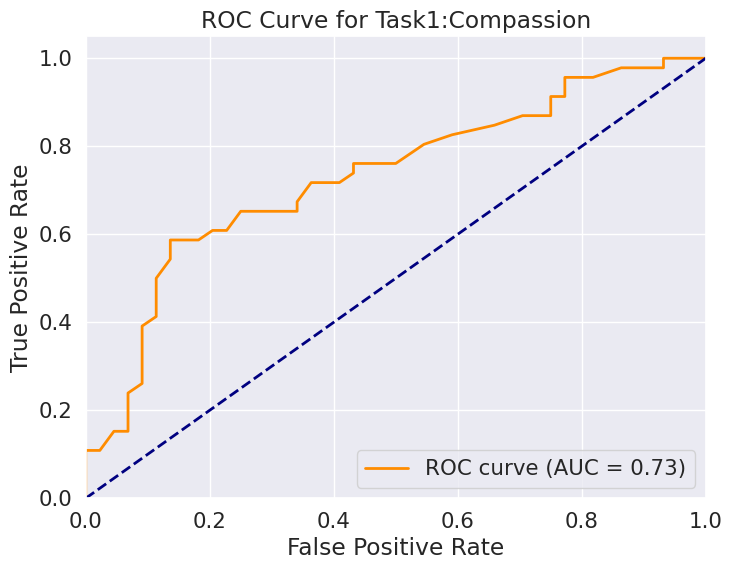

Top 5 Features by Mean Importance:['thermal-variance_thermal_feature_12', 'thermal-mean_thermal_feature_56', 'thermal-variance_thermal_feature_8', 'thermal-variance_thermal_feature_11', 'thermal-variance_thermal_feature_37']


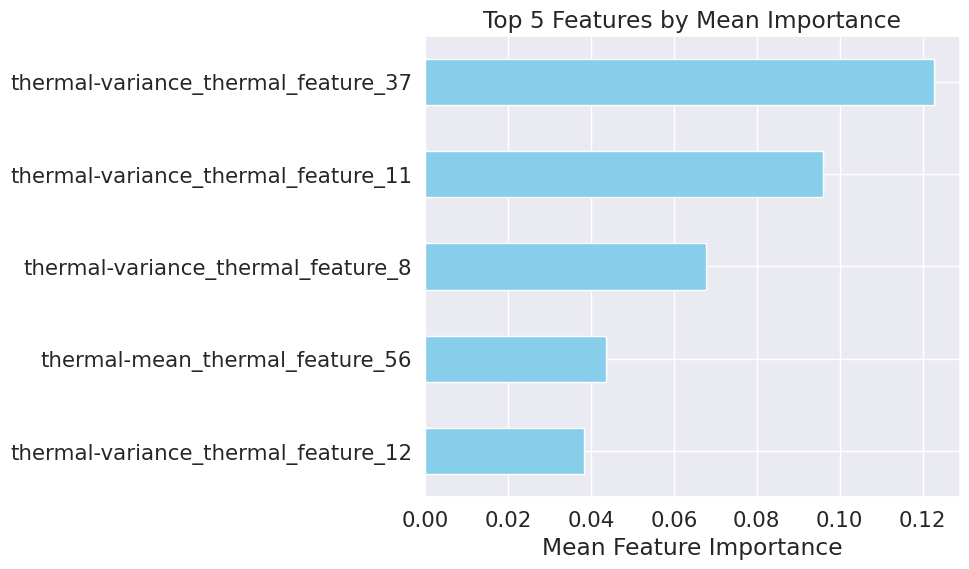

random_state:1
Total Accuracy: 0.6222222222222222
Total Recall: 0.6222222222222222
Total F1 Score: 0.6214745175655616


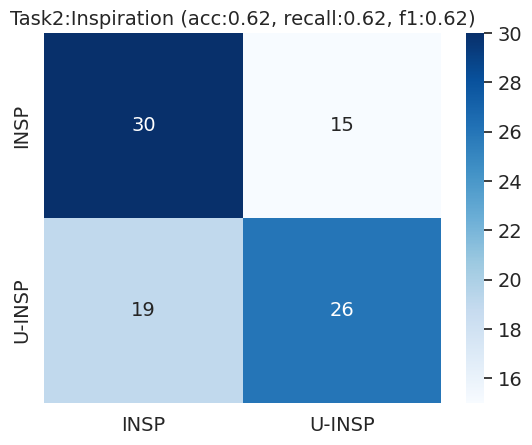

ROC-AUC for Task2:Inspiration: 0.6449


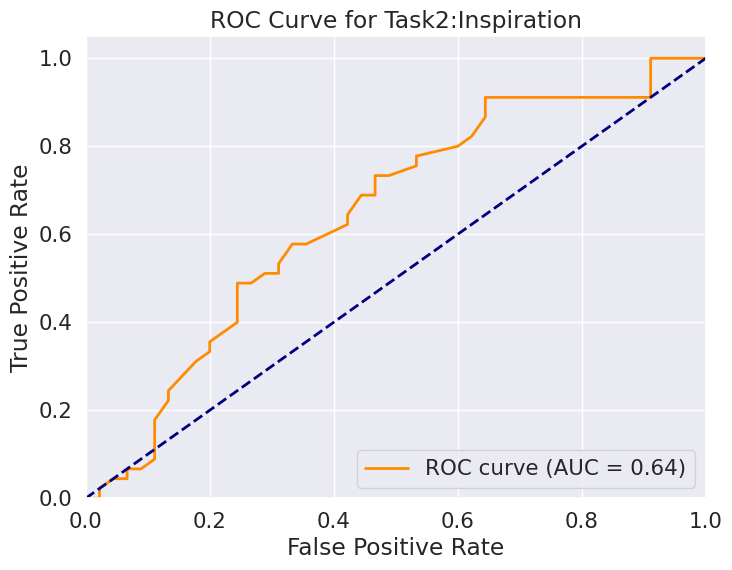

Top 5 Features by Mean Importance:['thermal-max_thermal_feature_54', 'thermal-variance_thermal_feature_40', 'thermal-variance_thermal_feature_27', 'thermal-variance_thermal_feature_45', 'thermal-end_to_begin_thermal_feature_4']


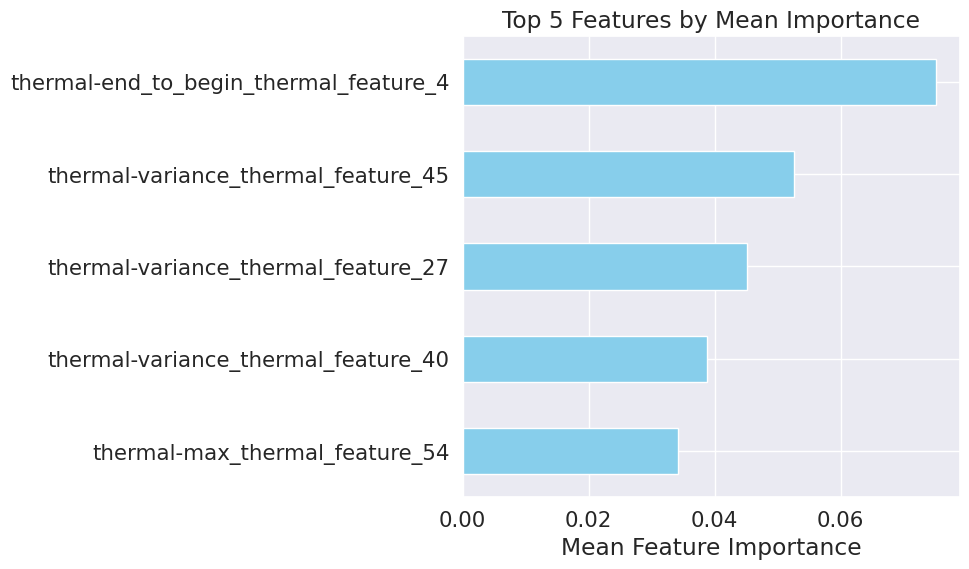

random_state:1
Total Accuracy: 0.4
Total Recall: 0.4
Total F1 Score: 0.3923335096507354


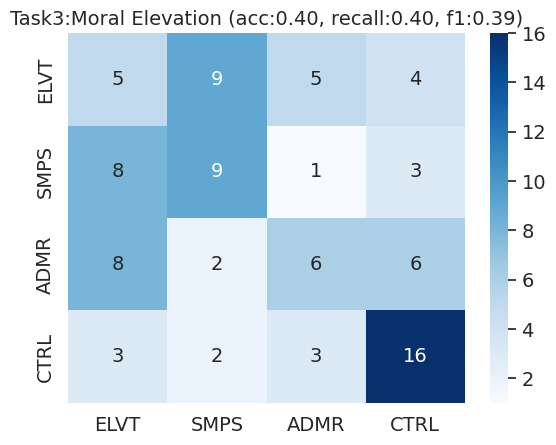

Top 5 Features by Mean Importance:['thermal-variance_thermal_feature_8', 'thermal-mean_thermal_feature_33', 'thermal-variance_thermal_feature_41', 'thermal-mean_thermal_feature_21', 'thermal-variance_thermal_feature_11']


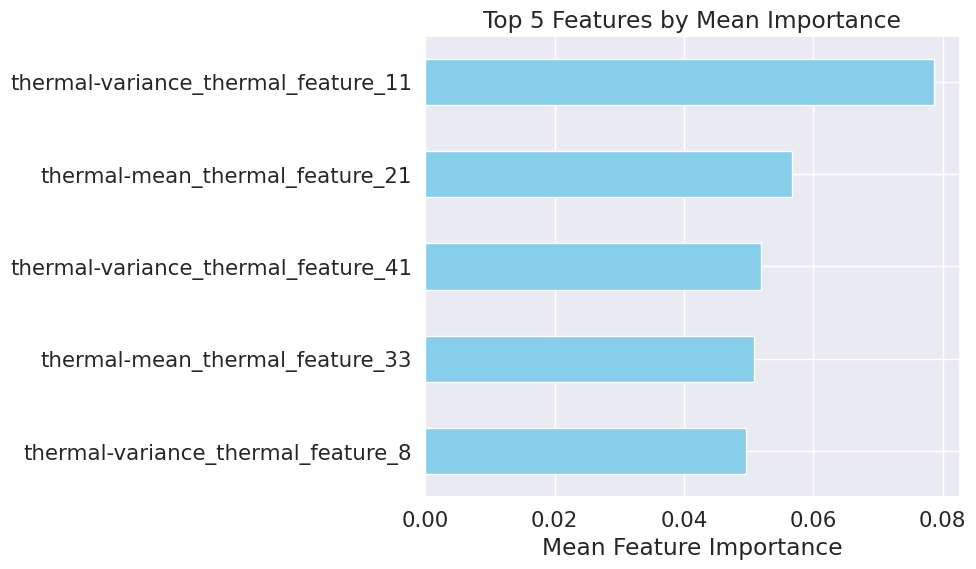

In [41]:
# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [True]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations)

df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   


In [42]:
df_all_evaluations

,df_name,model_name,do_rfe,rfe_model_name,n_kept,do_model_grid_search,do_anova,Accuracy1,Accuracy2,Accuracy3
0,thermal,Random Forest,True,SVM,15,False,False,0.666667,0.622222,0.4


### 8. MLLM

In [62]:
df = all_df[7]
df

,Group,user_id,mm_llm-mean_10,mm_llm-mean_12,mm_llm-mean_15,mm_llm-mean_absorbed,mm_llm-mean_actively,mm_llm-mean_activity,mm_llm-mean_add,mm_llm-mean_adding,...,mm_llm-end_to_begin_world,mm_llm-end_to_begin_worry,mm_llm-end_to_begin_would,mm_llm-end_to_begin_wrist,mm_llm-end_to_begin_writing,mm_llm-end_to_begin_written,mm_llm-end_to_begin_year,mm_llm-end_to_begin_yellow,mm_llm-end_to_begin_yet,mm_llm-end_to_begin_young
0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.876868,0.830588
1,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.017264,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.186521,0.768911
2,4.0,3.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.917752
3,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.044905,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.741986,0.741983
4,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.019175,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.559280,1.158657
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,3.0,111.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.888207,0.888202
96,4.0,113.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.064544,1.064538
97,1.0,114.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.912681,1.639289
98,1.0,115.0,0.0,0.0,0.0,0.0,0.0,0.017578,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.470402,1.110459


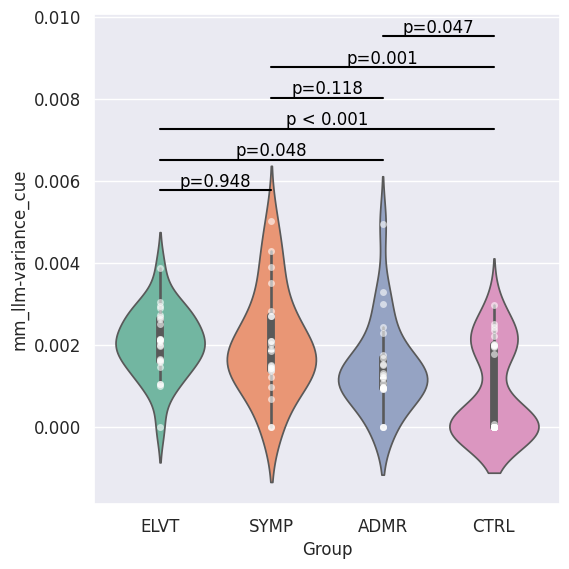

mm_llm-variance_cue: F(3, 96) = 7.215, p < 0.001


In [ ]:
df = all_df[7]
df_name = "mllm"

chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
#features_to_plot = ['thermal-variance_thermal_feature_57', 'thermal-variance_thermal_feature_8', 'thermal-mean_thermal_feature_33', 'thermal-variance_thermal_feature_41', 'thermal-mean_thermal_feature_21', 'thermal-variance_thermal_feature_11']
features_to_plot = ['mm_llm-end_to_begin_sitting']
to_remove_outlier = True
do_within_group_t_test = False
outlier_multiplier = 3
chart_helper.draw_violin(df, features_to_plot, to_remove_outlier, outlier_multiplier, do_within_group_t_test, group_names = group_names)

=== Task: mllm, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.84
Total Recall: 0.84
Total F1 Score: 0.8401280512204883


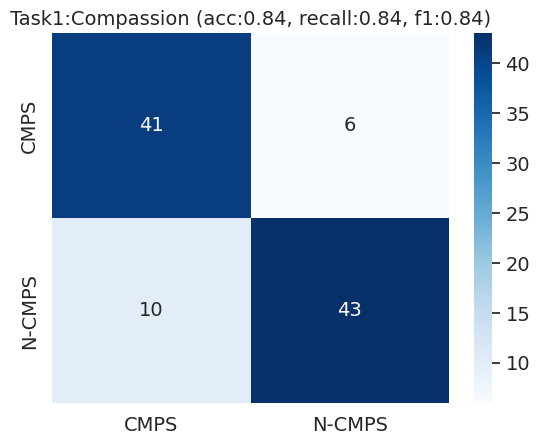

ROC-AUC for Task1:Compassion: 0.8838


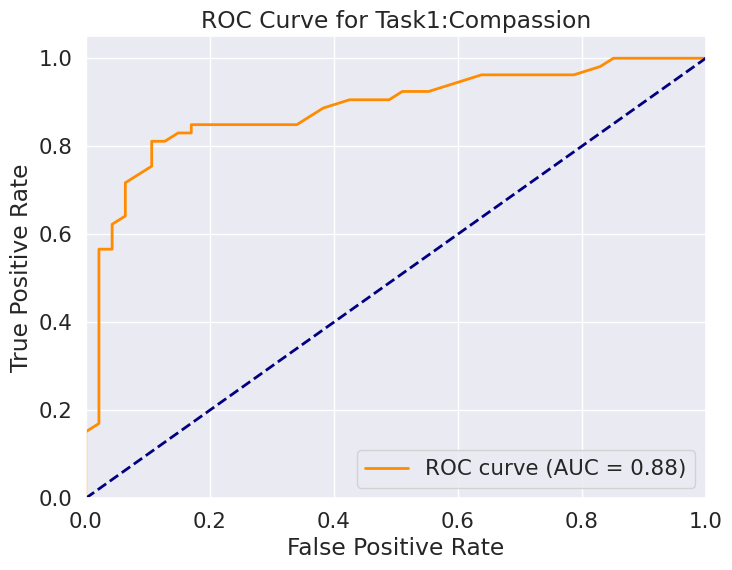

Top 5 Features by Mean Importance:['mm_llm-variance_cue', 'mm_llm-max_cue', 'mm_llm-max_reflect', 'mm_llm-mean_reach', 'mm_llm-end_to_begin_sitting']


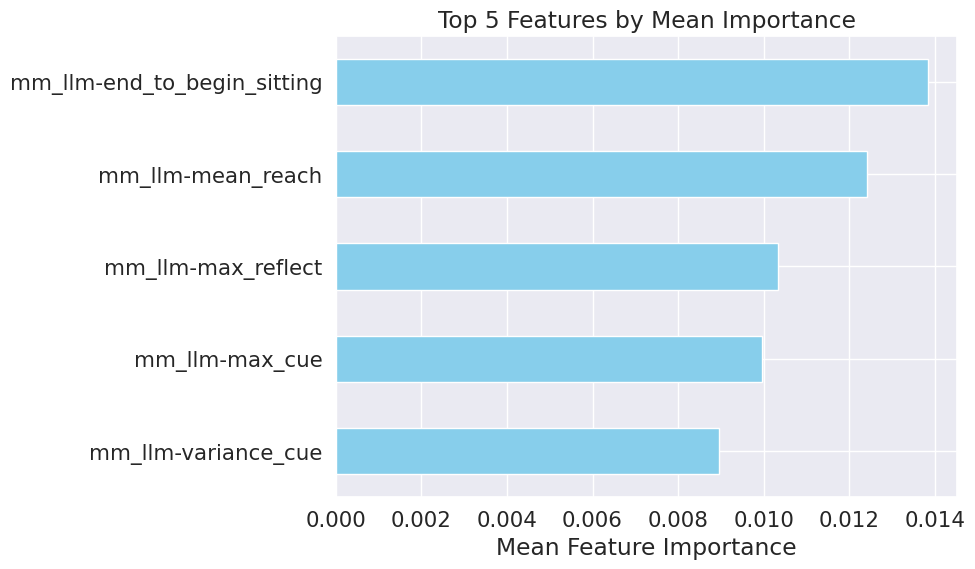

random_state:1
Total Accuracy: 0.61
Total Recall: 0.61
Total F1 Score: 0.6098049804980498


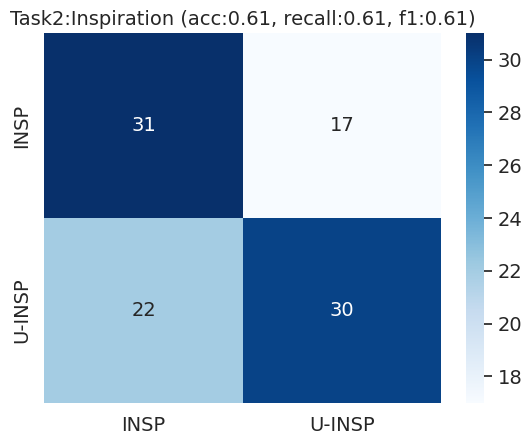

ROC-AUC for Task2:Inspiration: 0.6633


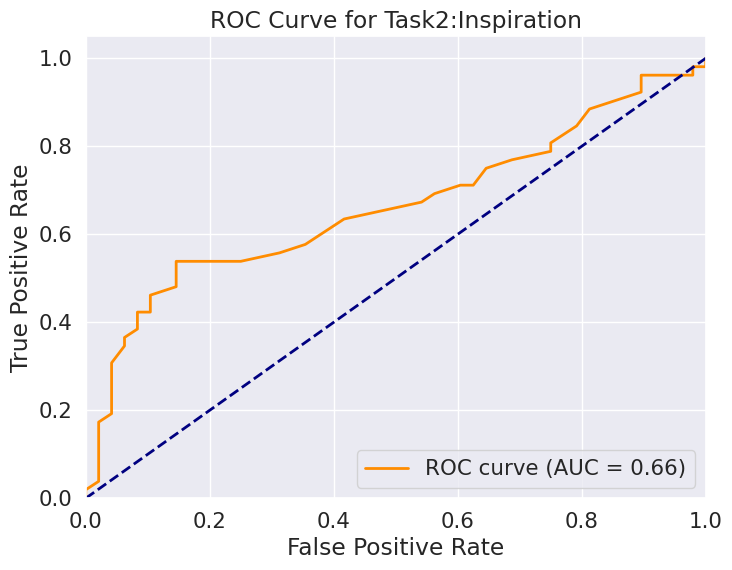

Top 5 Features by Mean Importance:['mm_llm-variance_welcoming', 'mm_llm-max_attentiveness', 'mm_llm-max_making', 'mm_llm-max_play', 'mm_llm-max_sincerity']


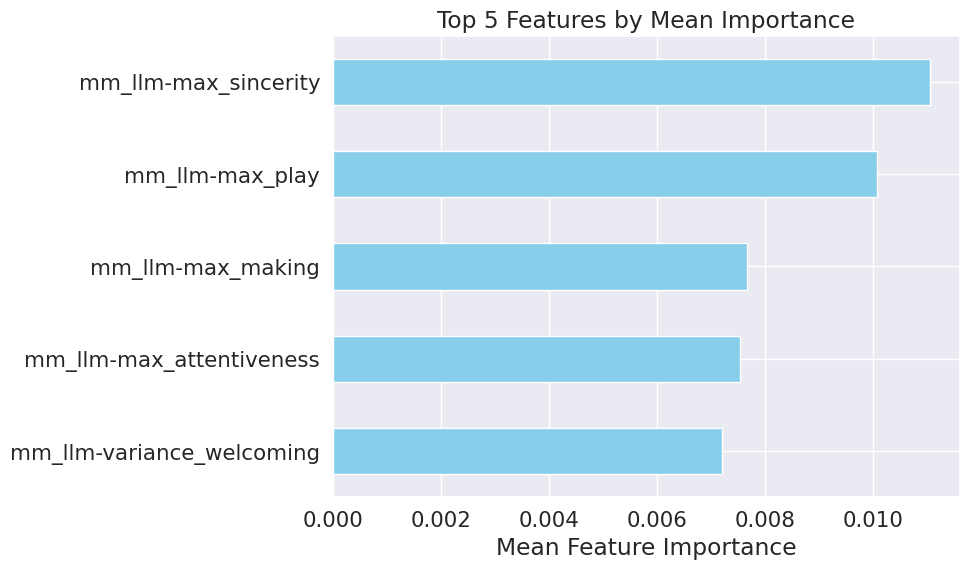

random_state:1
Total Accuracy: 0.56
Total Recall: 0.56
Total F1 Score: 0.554198238617481


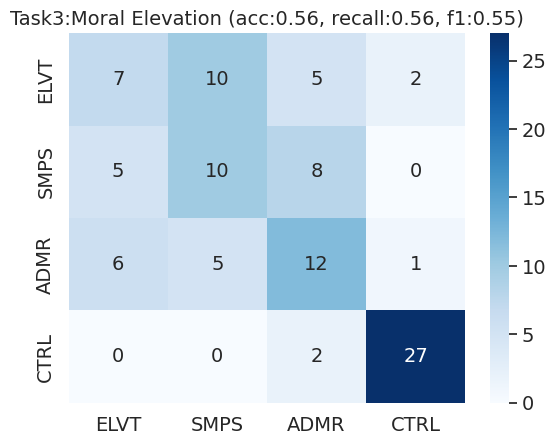

Top 5 Features by Mean Importance:['mm_llm-max_overall', 'mm_llm-variance_welcoming', 'mm_llm-variance_associated', 'mm_llm-max_associated', 'mm_llm-variance_cue']


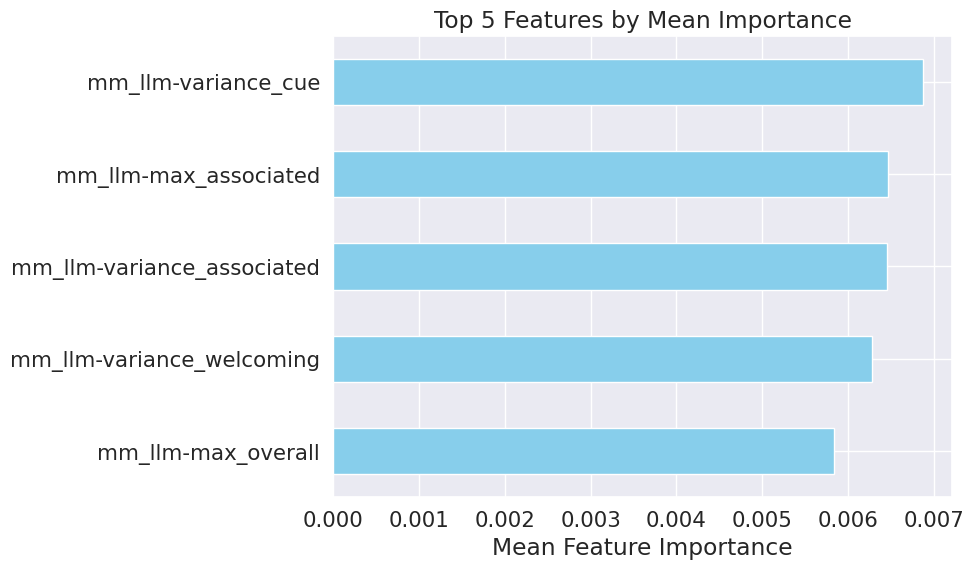

In [44]:
# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df, df_name, param_combinations)

df_multimodal_evaluations = pd.concat([df_multimodal_evaluations, df_all_evaluations], ignore_index=True)
df_multimodal_predictions = pd.concat([df_multimodal_predictions, df_all_predictions], ignore_index=True)   


### Save or Load Cache

In [ ]:
if os.path.exists(path_pickle_df_predictions) and os.path.exists(path_pickle_df_evaluations):
    try:
        df_multimodal_evaluations = load_from_cache(df_multimodal_evaluations)
        df_multimodal_predictions = load_from_cache(path_pickle_df_predictions)
        print("Pickle files loaded successfully.")
    except Exception as e:
        print(f"Failed to load pickle files: {e}. Re-running processing.")
        df_multimodal_evaluations = None
        df_multimodal_predictions = None
else:
    save_to_cache(df_multimodal_evaluations, path_pickle_df_evaluations)
    save_to_cache(df_multimodal_predictions, path_pickle_df_predictions)

## Early Fusion

### All Modalities

=== Task: Early Fusion With All Modalities, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.7766990291262136
Total Recall: 0.7766990291262136
Total F1 Score: 0.776825366309169


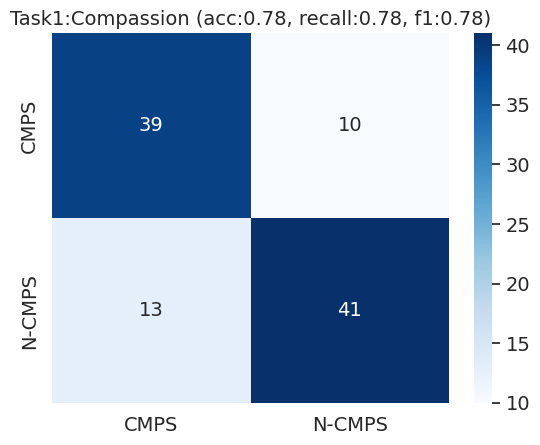

ROC-AUC for Task1:Compassion: 0.8398


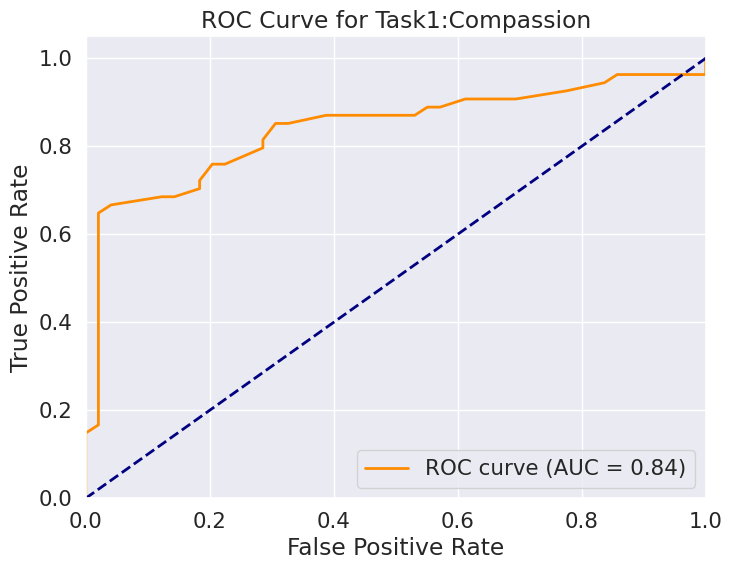

Top 5 Features by Mean Importance:['mm_llm-end_to_begin_sitting', 'mm_llm-variance_often', 'mm_llm-max_may', 'mm_llm-max_rather', 'mm_llm-max_associated']


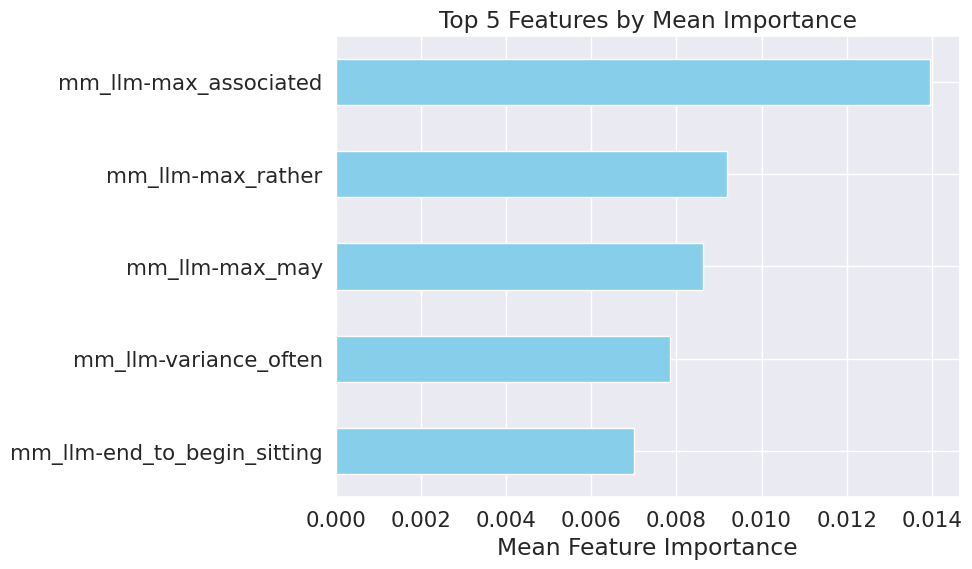

random_state:1
Total Accuracy: 0.6116504854368932
Total Recall: 0.6116504854368932
Total F1 Score: 0.6071626250991069


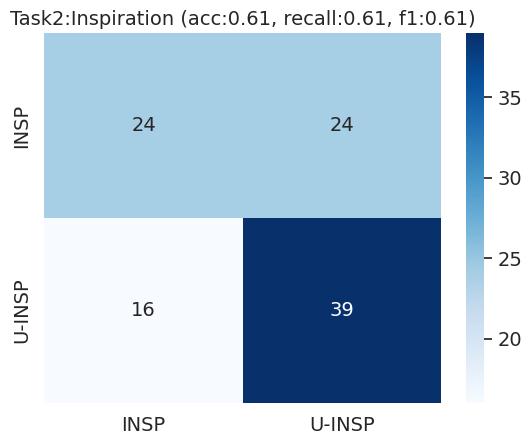

ROC-AUC for Task2:Inspiration: 0.6432


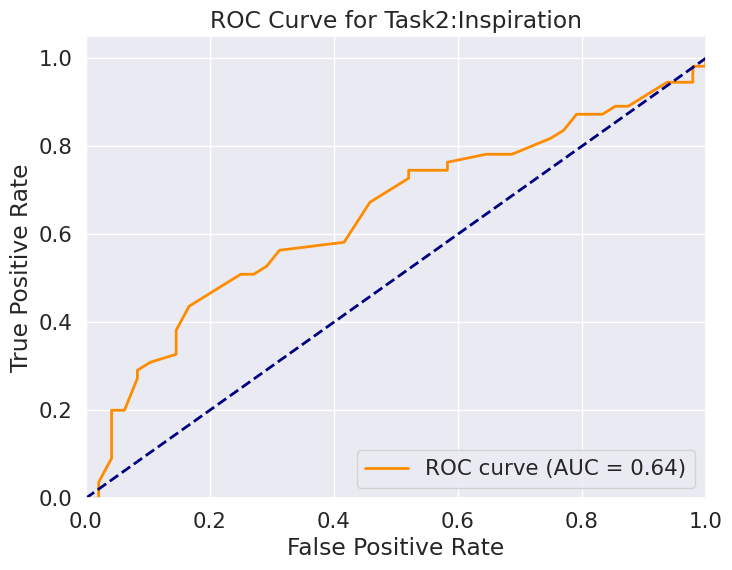

Top 5 Features by Mean Importance:['mm_llm-max_sincerity', 'pose-max_ear_to_ear_difference_x', 'mm_llm-variance_indicating', 'max_FaceRectHeight', 'mm_llm-mean_associated']


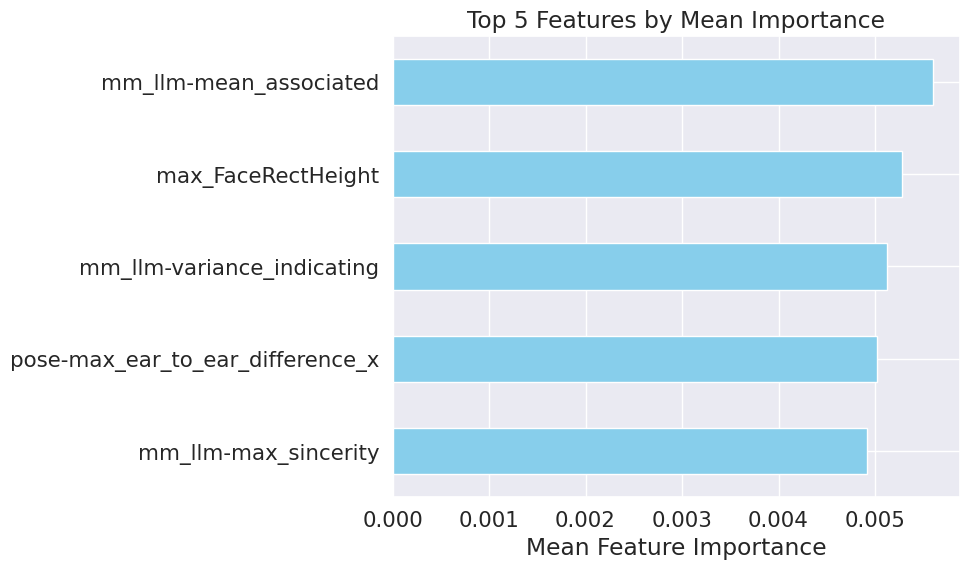

random_state:1
Total Accuracy: 0.5533980582524272
Total Recall: 0.5533980582524272
Total F1 Score: 0.5477466068679652


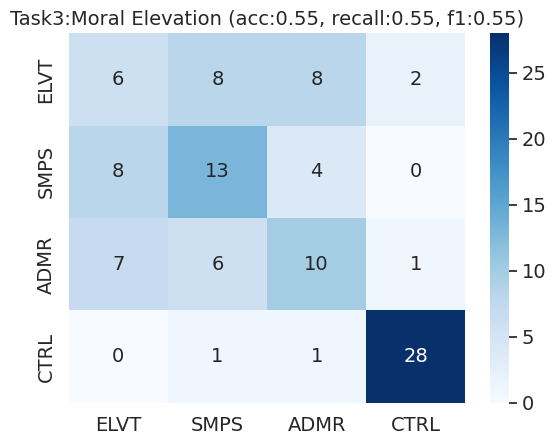

Top 5 Features by Mean Importance:['mm_llm-max_emotional', 'mm_llm-max_may', 'mm_llm-mean_associated', 'mm_llm-variance_often', 'mm_llm-max_associated']


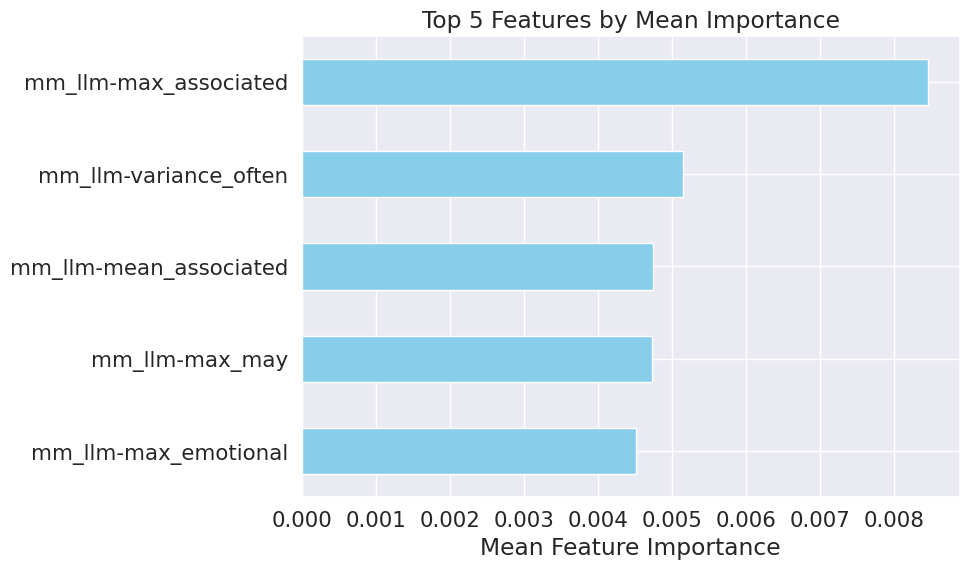

=== Task: Early Fusion With All Modalities, Model: MLP, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.7281553398058253
Total Recall: 0.7281553398058253
Total F1 Score: 0.7280015815138602


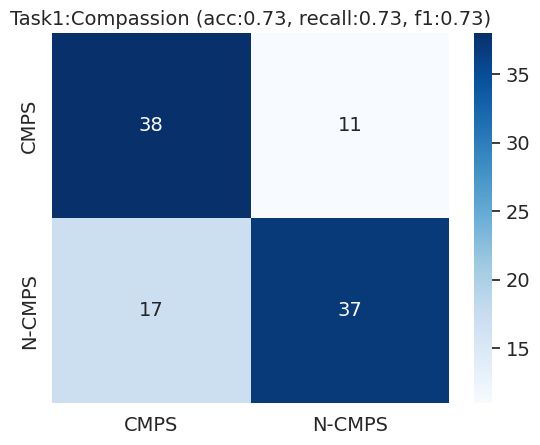

ROC-AUC for Task1:Compassion: 0.7982


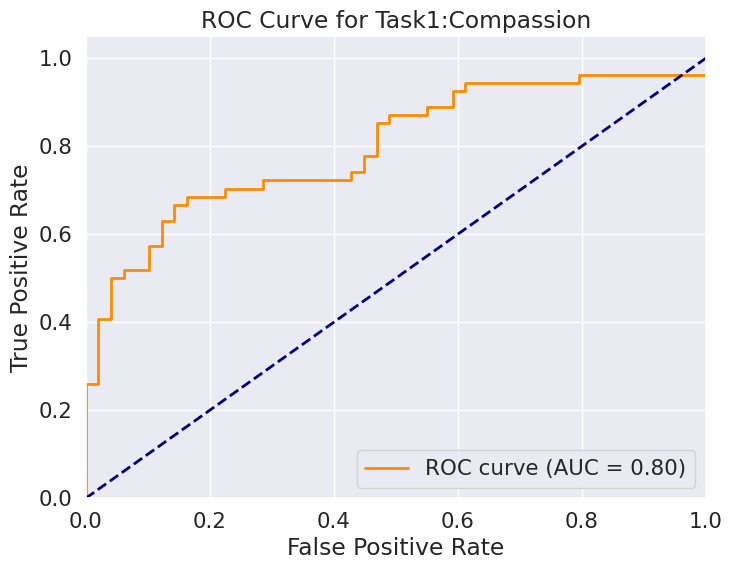

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.6213592233009708
Total Recall: 0.6213592233009708
Total F1 Score: 0.6217881564946259


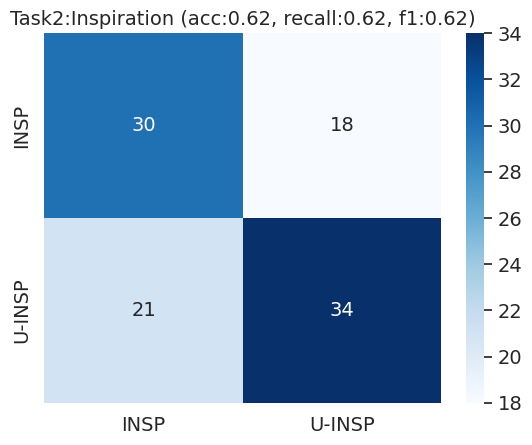

ROC-AUC for Task2:Inspiration: 0.6777


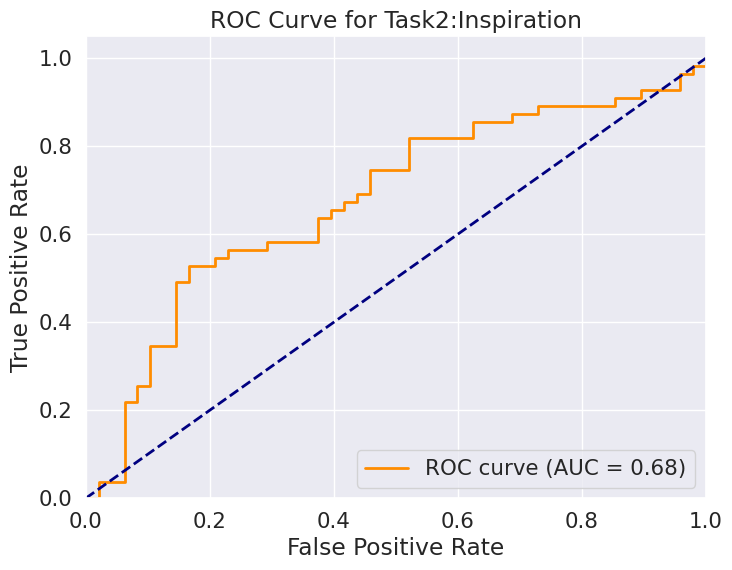

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.5631067961165048
Total Recall: 0.5631067961165048
Total F1 Score: 0.5681613079963324


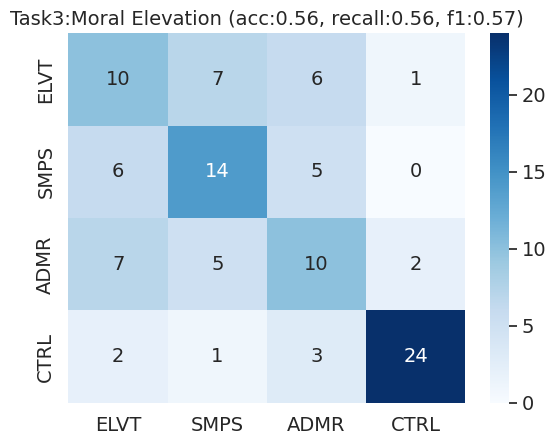

                            df_name     model_name  do_rfe rfe_model_name  \
0  Early Fusion With All Modalities  Random Forest   False            SVM   
1  Early Fusion With All Modalities            MLP   False            SVM   

   n_kept  do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0      15                 False     False   0.776699   0.611650   0.553398  
1      15                 False     False   0.728155   0.621359   0.563107  


In [45]:
data_helper = local_utilities.DataHelper()
data_loader = local_data_loader.DataLoader()

df_merged = data_helper.merge_dataframe(all_df)
df = df_merged
df_name = "Early Fusion With All Modalities"

data_prepare_helper = psychai.data_preparation.data_preparation.DataPreparationHelper(df_merged.copy())
parameter = {
    "remove_all_nan_rows": True,
    "replace_missing_data_with_median":True
}
df_prepared = data_prepare_helper.prepare_data(parameter)

# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest", "MLP"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df_prepared, df_name, param_combinations, random_state=random_state)

print(df_all_evaluations)


### Selected Modalities - five

In [53]:
data_helper = local_utilities.DataHelper()
data_loader = local_data_loader.DataLoader()

selected_columns = [0,1,2,5,7]  # Index positions for 2nd, 3rd, 5th, and 9th columns
df_list = [all_df[i] for i in selected_columns]
df_names_list = [all_df_name[i] for i in selected_columns]

df_merged = data_helper.merge_dataframe(df_list)
df = df_merged
df_name = "early fused"

data_prepare_helper = psychai.data_preparation.data_preparation.DataPreparationHelper(df_merged.copy())
parameter = {
    "remove_all_nan_rows": True,
    "replace_missing_data_with_median":True
}
df_prepared = data_prepare_helper.prepare_data(parameter)

# Find rows with NaN values
rows_with_nan = df_prepared[df_prepared.isnull().any(axis=1)]
rows_with_nan

,user_id,Group,median_acoustics-zero_crossing_rate_mu,median_acoustics-zero_crossing_rate_std,median_acoustics-spectral_centroid_mu,median_acoustics-spectral_centroid_std,median_acoustics-spectral_bandwidth_mu,median_acoustics-spectral_bandwidth_std,median_acoustics-mfcc_1_mu,median_acoustics-mfcc_1_std,...,mm_llm-end_to_begin_world,mm_llm-end_to_begin_worry,mm_llm-end_to_begin_would,mm_llm-end_to_begin_wrist,mm_llm-end_to_begin_writing,mm_llm-end_to_begin_written,mm_llm-end_to_begin_year,mm_llm-end_to_begin_yellow,mm_llm-end_to_begin_yet,mm_llm-end_to_begin_young


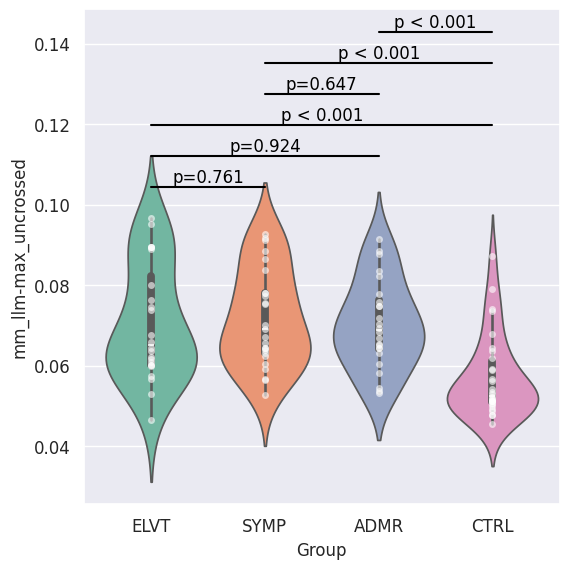

mm_llm-max_uncrossed: F(3, 99) = 9.455, p < 0.001


In [54]:
chart_helper = psychai.data_visualization.chart.Chart()
# features_to_plot= ['max_eye_move-variance_left_eye_width','max_eye_move-mean_right_iris_relative_x', 'median_eye_move-mean_right_eye_height', 'max_eye_move-end_to_begin_right_iris_relative_x', 'max_eye_move-mean_left_eye_height']
#features_to_plot = ['thermal-variance_thermal_feature_57', 'thermal-variance_thermal_feature_8', 'thermal-mean_thermal_feature_33', 'thermal-variance_thermal_feature_41', 'thermal-mean_thermal_feature_21', 'thermal-variance_thermal_feature_11']
features_to_plot = ['mm_llm-max_uncrossed']
to_remove_outlier = False
do_within_group_t_test = False
outlier_multiplier = 3
chart_helper.draw_violin(df_prepared, features_to_plot, to_remove_outlier, outlier_multiplier, do_within_group_t_test, group_names = group_names)

=== Task: early fused, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.7766990291262136
Total Recall: 0.7766990291262136
Total F1 Score: 0.776825366309169


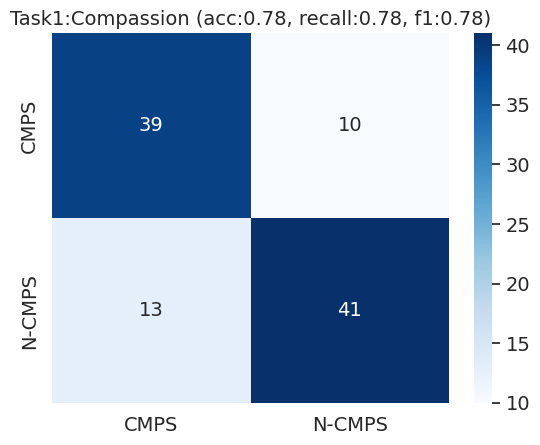

ROC-AUC for Task1:Compassion: 0.8426


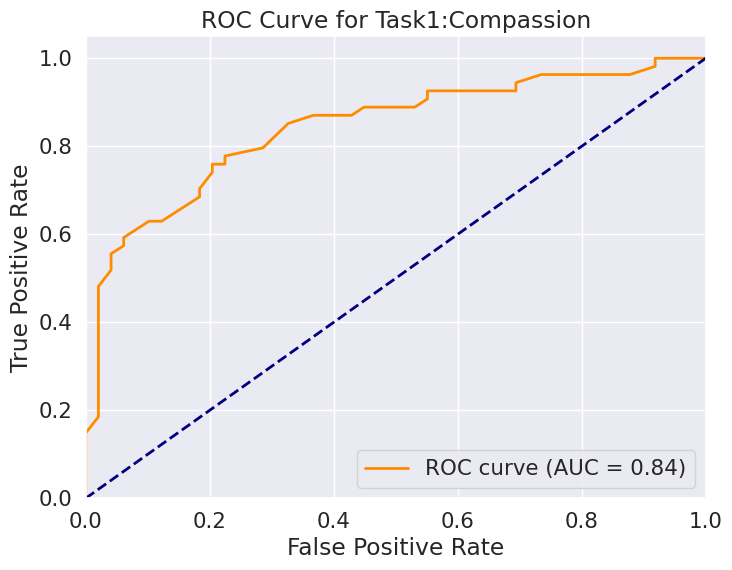

Top 5 Features by Mean Importance:['mm_llm-max_warm', 'mm_llm-max_reach', 'mm_llm-max_hair', 'mm_llm-end_to_begin_black', 'mm_llm-mean_reflect']


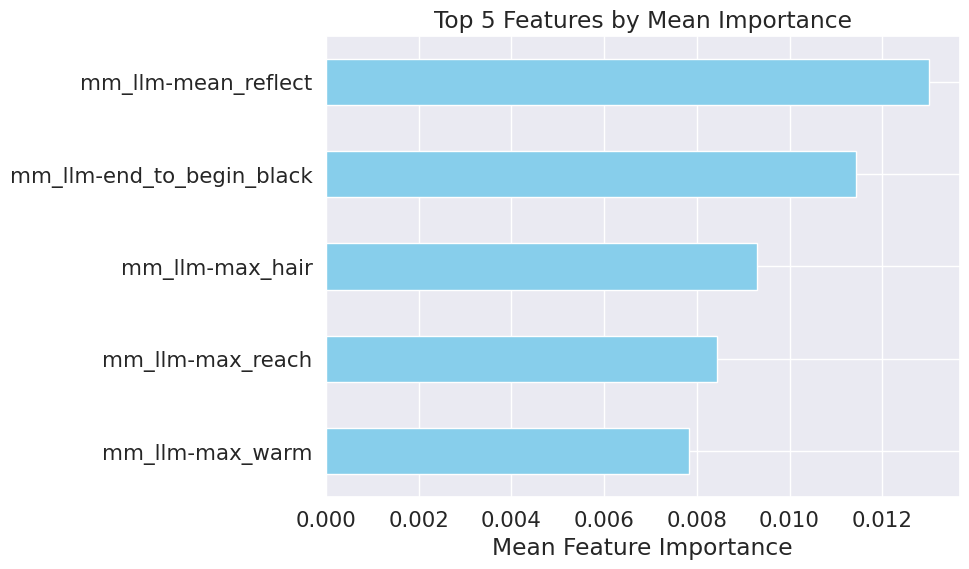

random_state:1
Total Accuracy: 0.6990291262135923
Total Recall: 0.6990291262135923
Total F1 Score: 0.6991999221317534


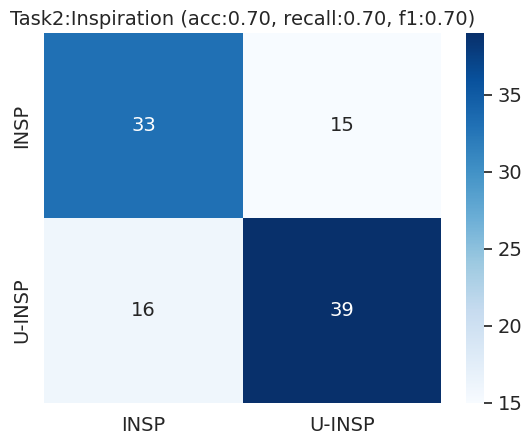

ROC-AUC for Task2:Inspiration: 0.7352


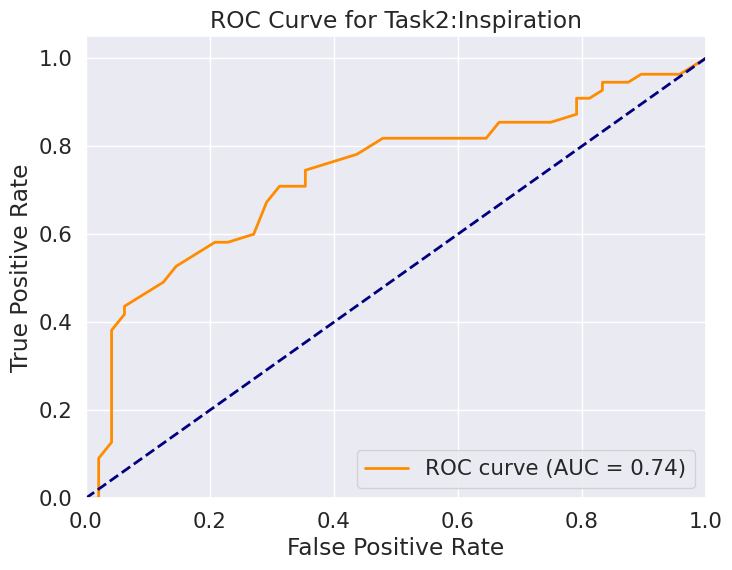

Top 5 Features by Mean Importance:['mm_llm-max_seem', 'mm_llm-max_warm', 'mm_llm-variance_sincerity', 'mm_llm-max_bent', 'mm_llm-max_stance']


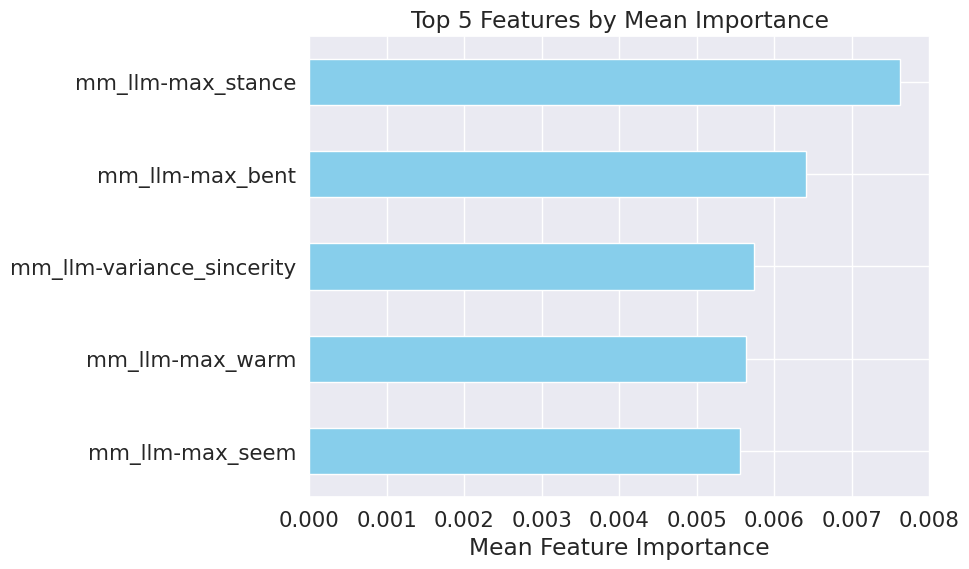

random_state:1
Total Accuracy: 0.6213592233009708
Total Recall: 0.6213592233009708
Total F1 Score: 0.6163738052877193


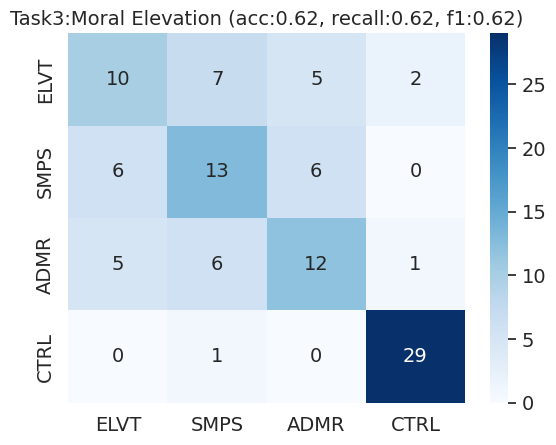

Top 5 Features by Mean Importance:['max_FaceRectY', 'mm_llm-max_warm', 'mm_llm-mean_reflect', 'mm_llm-max_demeanor', 'mm_llm-max_uncrossed']


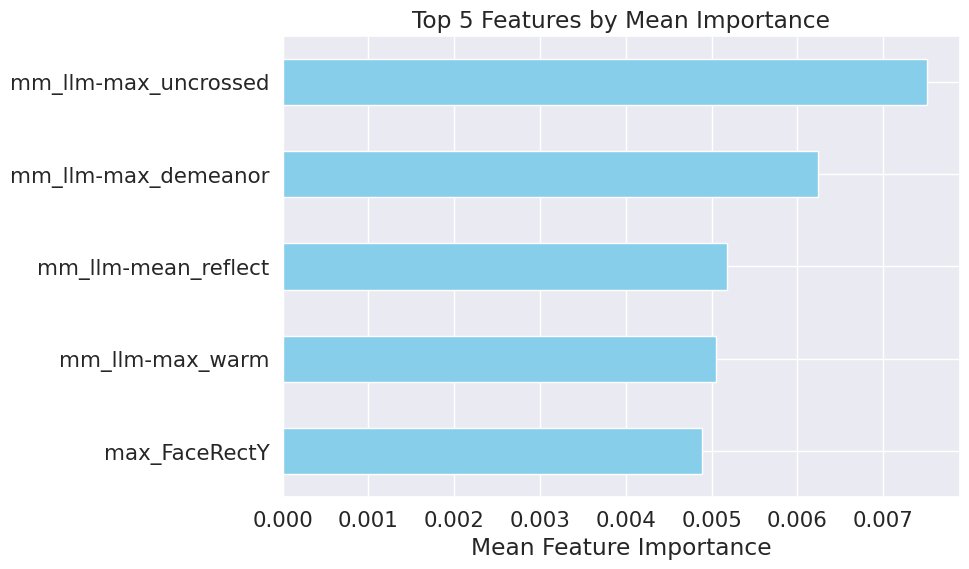

=== Task: early fused, Model: MLP, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.6990291262135923
Total Recall: 0.6990291262135923
Total F1 Score: 0.6986318049280656


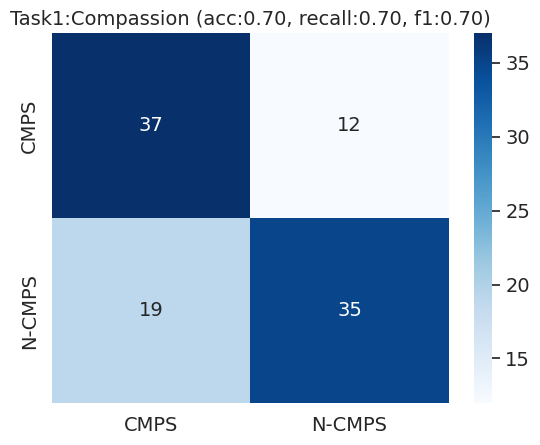

ROC-AUC for Task1:Compassion: 0.7933


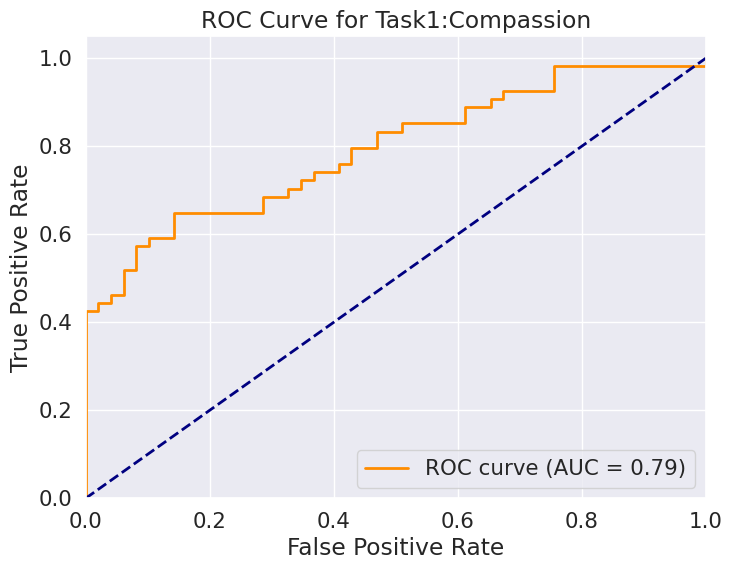

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.6796116504854369
Total Recall: 0.6796116504854369
Total F1 Score: 0.6799137611403305


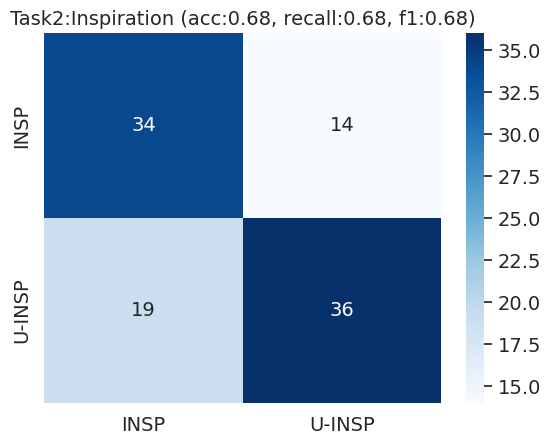

ROC-AUC for Task2:Inspiration: 0.7309


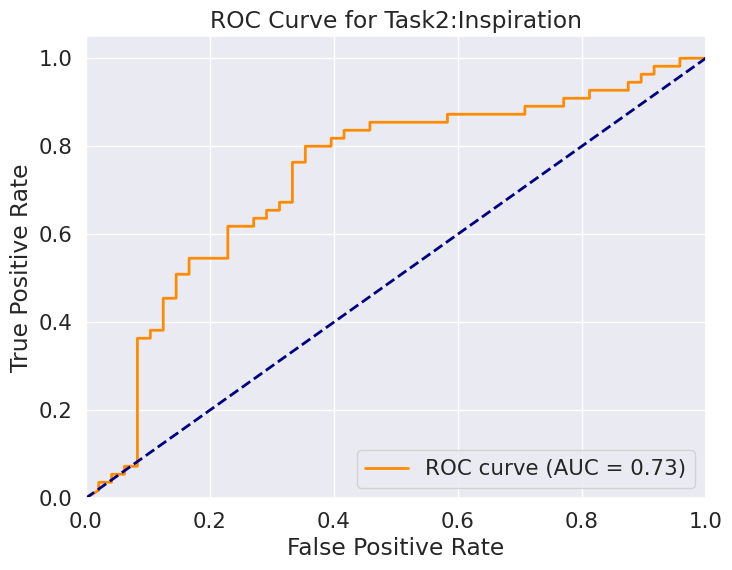

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.5242718446601942
Total Recall: 0.5242718446601942
Total F1 Score: 0.5118478175073012


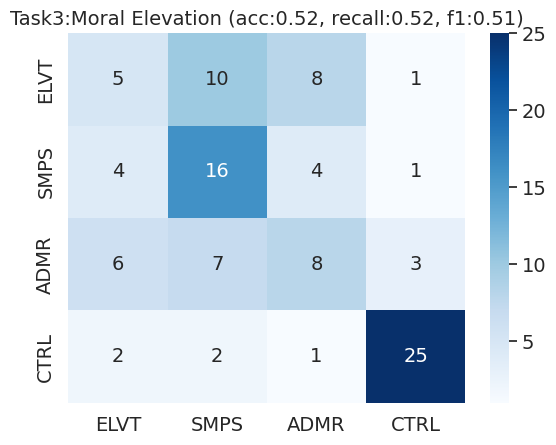

       df_name     model_name  do_rfe rfe_model_name  n_kept  \
0  early fused  Random Forest   False            SVM      15   
1  early fused            MLP   False            SVM      15   

   do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0                 False     False   0.776699   0.699029   0.621359  
1                 False     False   0.699029   0.679612   0.524272  


In [55]:
import itertools
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest", "MLP"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df_prepared, df_name, param_combinations, random_state=random_state)

print(df_all_evaluations)


### Selected Modalities - 2

=== Task: early fused, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.7961165048543689
Total Recall: 0.7961165048543689
Total F1 Score: 0.7958473517254638


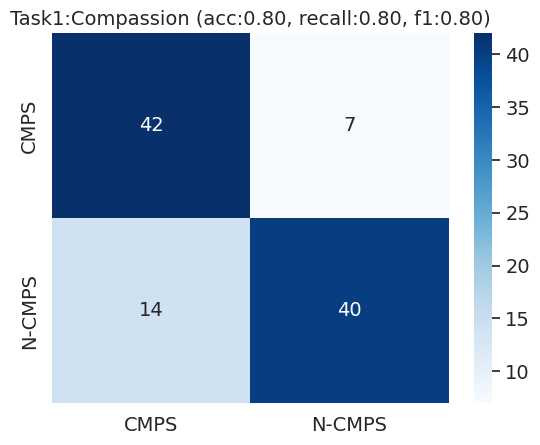

ROC-AUC for Task1:Compassion: 0.8766


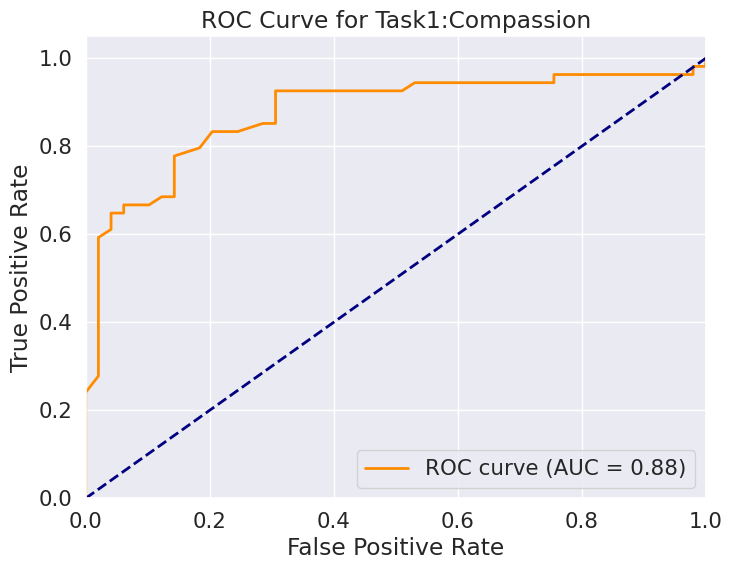

Top 5 Features by Mean Importance:['mm_llm-mean_reach', 'mm_llm-max_attentiveness', 'mm_llm-max_warm', 'mm_llm-max_reflect', 'mm_llm-end_to_begin_reaching']


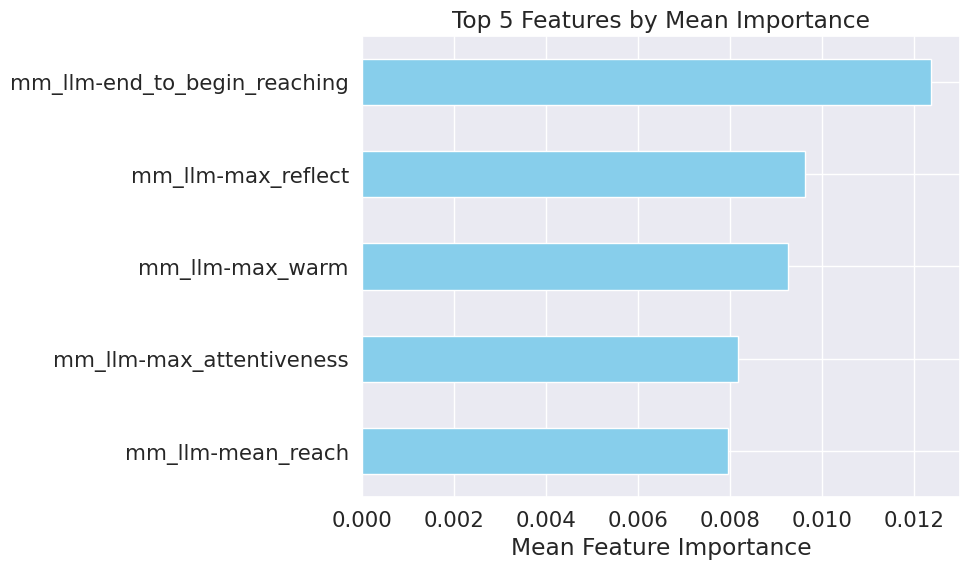

random_state:1
Total Accuracy: 0.6504854368932039
Total Recall: 0.6504854368932039
Total F1 Score: 0.6504854368932039


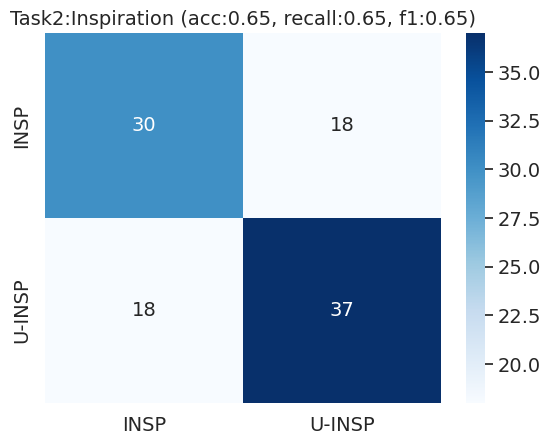

ROC-AUC for Task2:Inspiration: 0.7167


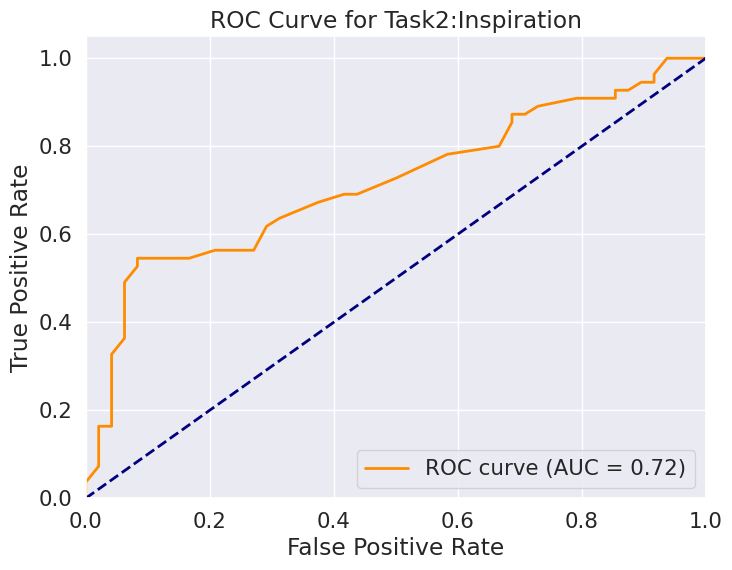

Top 5 Features by Mean Importance:['mm_llm-variance_suggesting', 'mm_llm-variance_attentiveness', 'mm_llm-variance_connection', 'mm_llm-max_making', 'mm_llm-max_attentiveness']


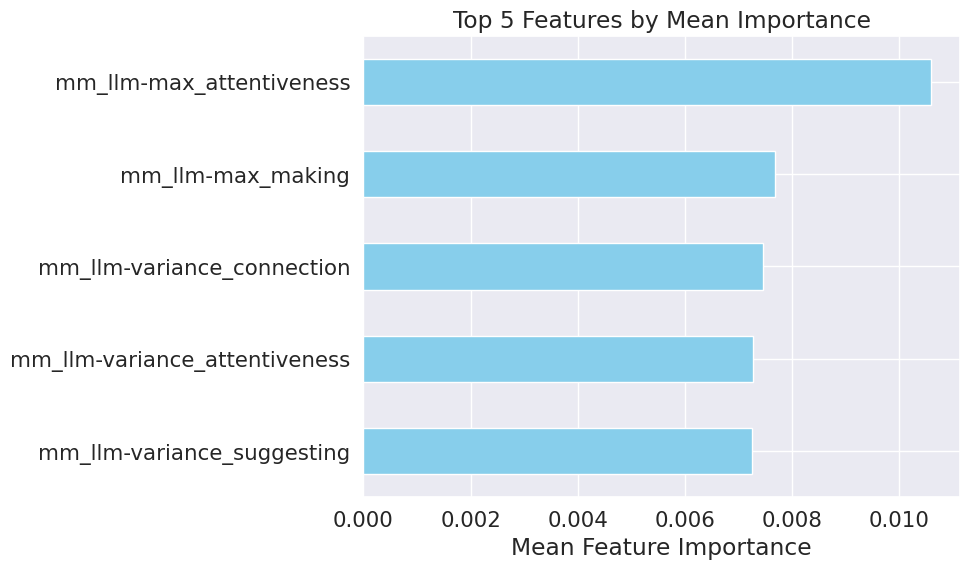

random_state:1
Total Accuracy: 0.6116504854368932
Total Recall: 0.6116504854368932
Total F1 Score: 0.6042472342839762


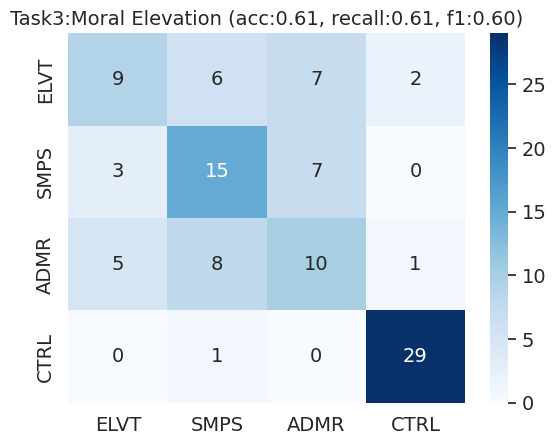

Top 5 Features by Mean Importance:['mm_llm-max_young', 'mm_llm-max_perhaps', 'mm_llm-max_comfort', 'mm_llm-max_demeanor', 'mm_llm-max_attentiveness']


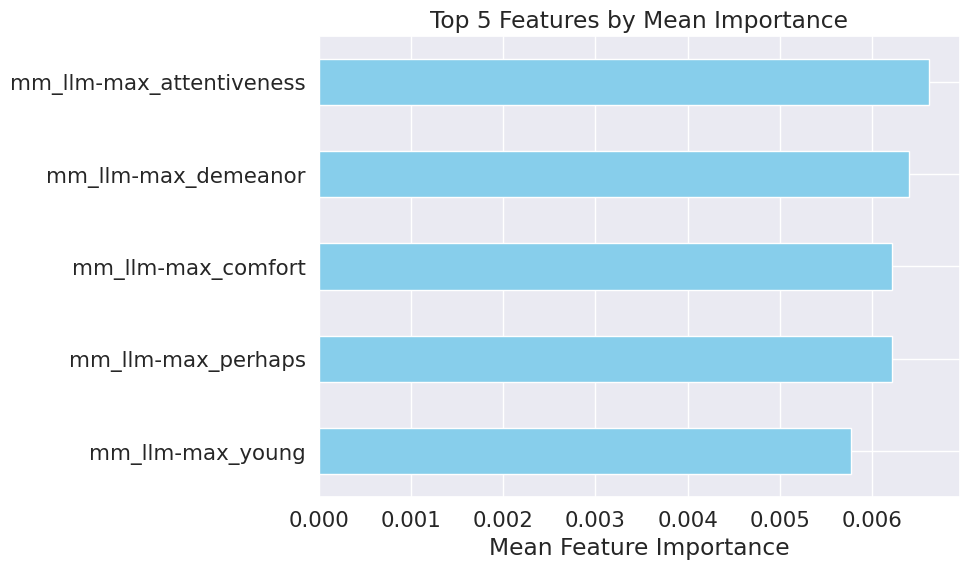

=== Task: early fused, Model: MLP, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.7669902912621359
Total Recall: 0.7669902912621359
Total F1 Score: 0.7664627221102767


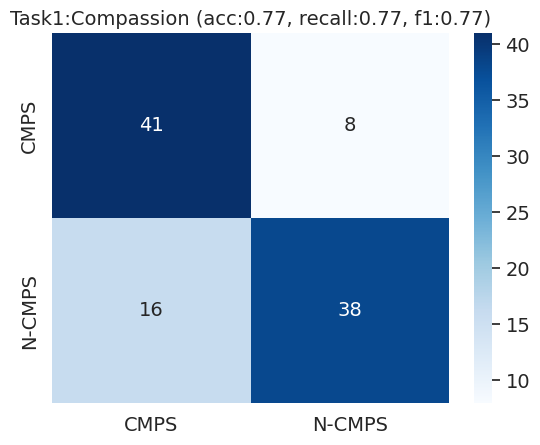

ROC-AUC for Task1:Compassion: 0.8193


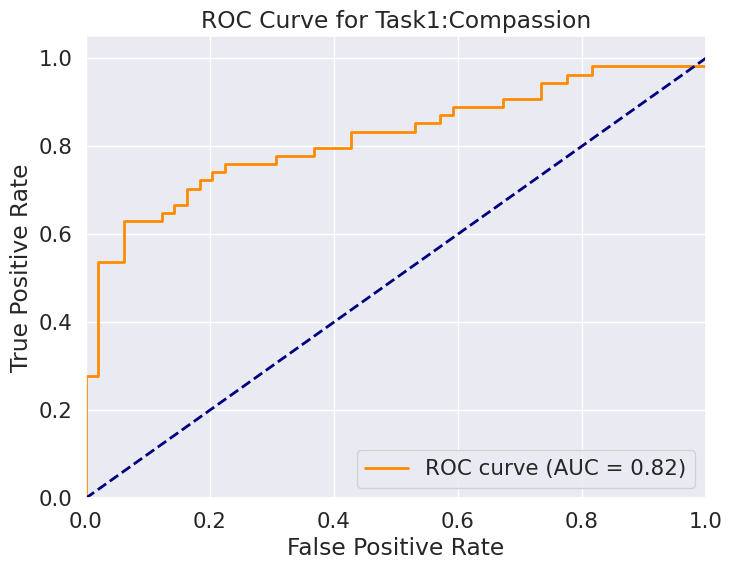

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.6213592233009708
Total Recall: 0.6213592233009708
Total F1 Score: 0.6217162631658449


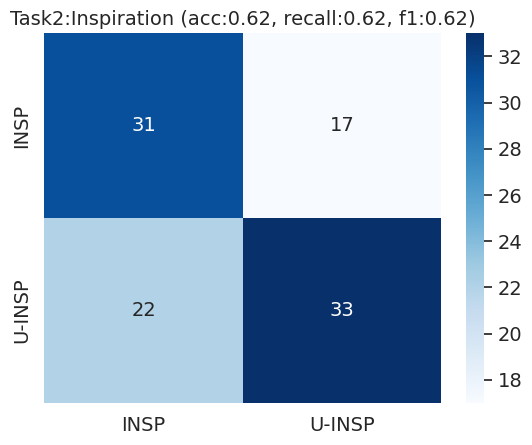

ROC-AUC for Task2:Inspiration: 0.6557


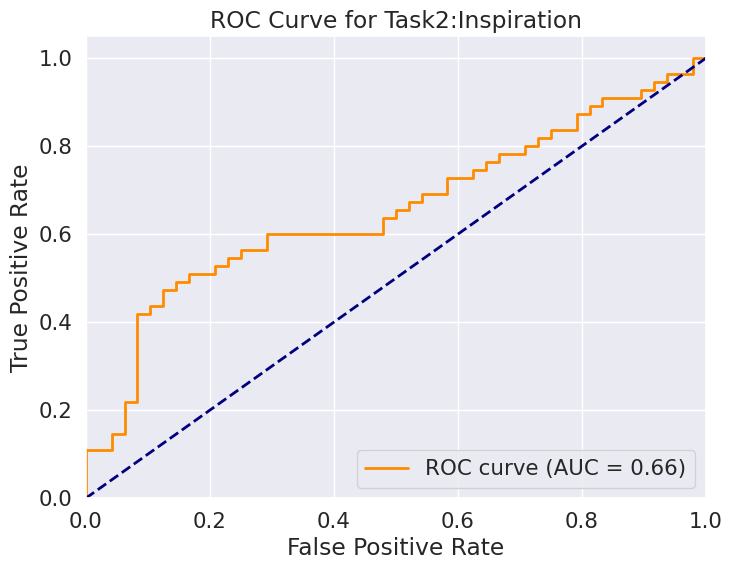

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.46601941747572817
Total Recall: 0.46601941747572817
Total F1 Score: 0.4664202039682121


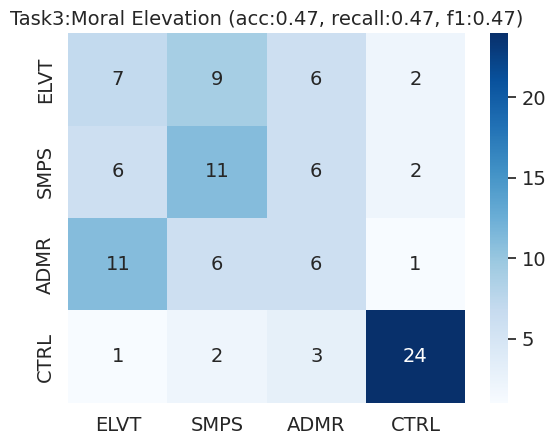

       df_name     model_name  do_rfe rfe_model_name  n_kept  \
0  early fused  Random Forest   False            SVM      15   
1  early fused            MLP   False            SVM      15   

   do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0                 False     False   0.796117   0.650485   0.611650  
1                 False     False   0.766990   0.621359   0.466019  


In [47]:
data_helper = local_utilities.DataHelper()
data_loader = local_data_loader.DataLoader()

selected_columns = [1,7]  # Index positions for 2nd, 3rd, 5th, and 9th columns
df_list = [all_df[i] for i in selected_columns]
df_names_list = [all_df_name[i] for i in selected_columns]

df_merged = data_helper.merge_dataframe(df_list)
df = df_merged
df_name = "early fused"

data_prepare_helper = psychai.data_preparation.data_preparation.DataPreparationHelper(df_merged.copy())
parameter = {
    "remove_all_nan_rows": True,
    "replace_missing_data_with_median":True
}
df_prepared = data_prepare_helper.prepare_data(parameter)


# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest", "MLP"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df_prepared, df_name, param_combinations, random_state=random_state)

print(df_all_evaluations)

### Selected Modalities - 3

=== Task: early fused, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.8252427184466019
Total Recall: 0.8252427184466019
Total F1 Score: 0.8251438738303387


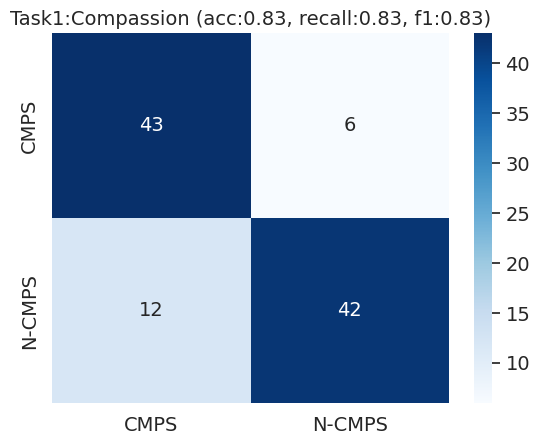

ROC-AUC for Task1:Compassion: 0.8757


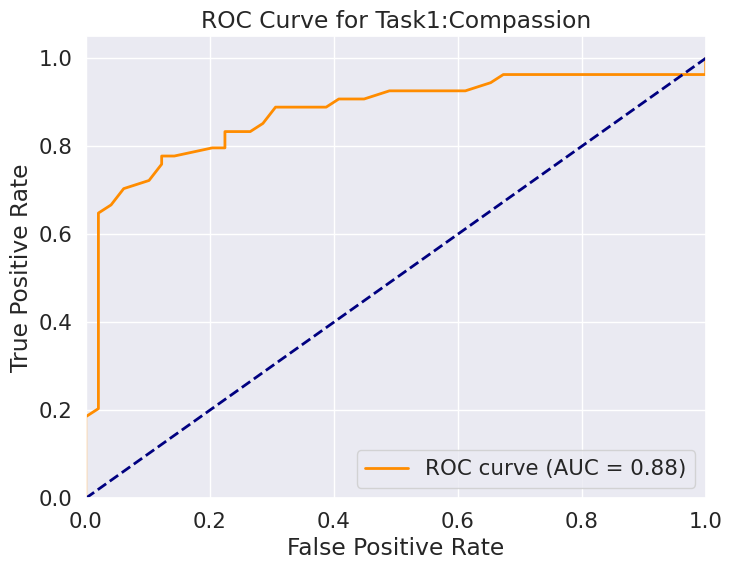

Top 5 Features by Mean Importance:['mm_llm-variance_palm', 'mm_llm-max_term', 'mm_llm-max_associated', 'mm_llm-max_reflect', 'mm_llm-max_reach']


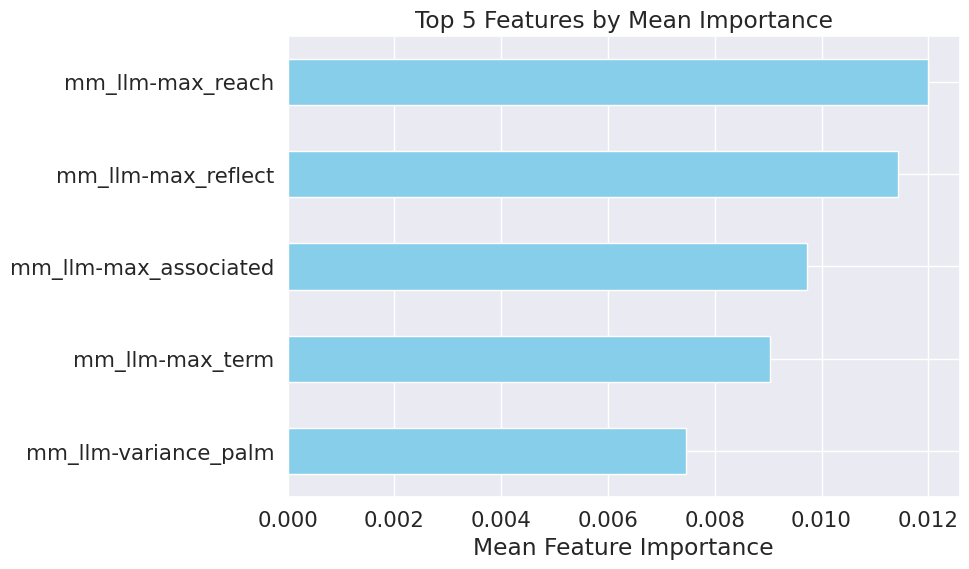

random_state:1
Total Accuracy: 0.6504854368932039
Total Recall: 0.6504854368932039
Total F1 Score: 0.6502218512498353


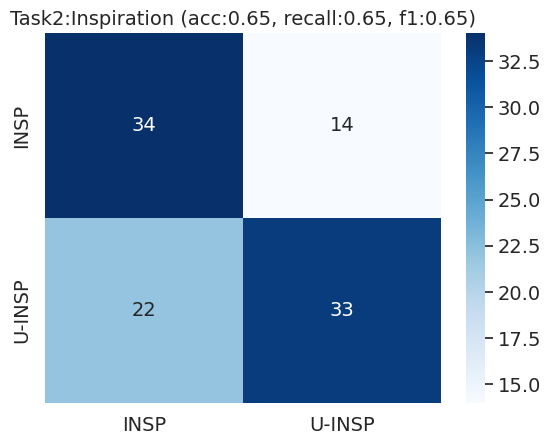

ROC-AUC for Task2:Inspiration: 0.7051


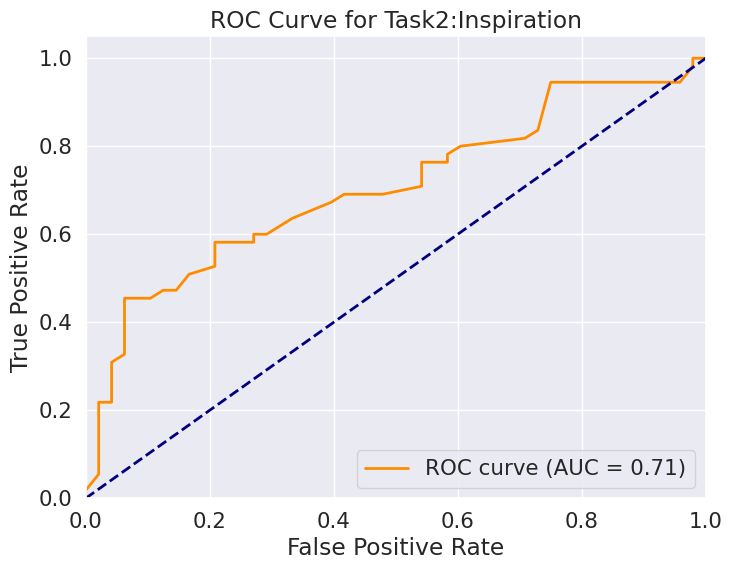

Top 5 Features by Mean Importance:['mm_llm-variance_sincerity', 'mm_llm-variance_warmth', 'mm_llm-max_tilted', 'mm_llm-max_making', 'mm_llm-variance_welcoming']


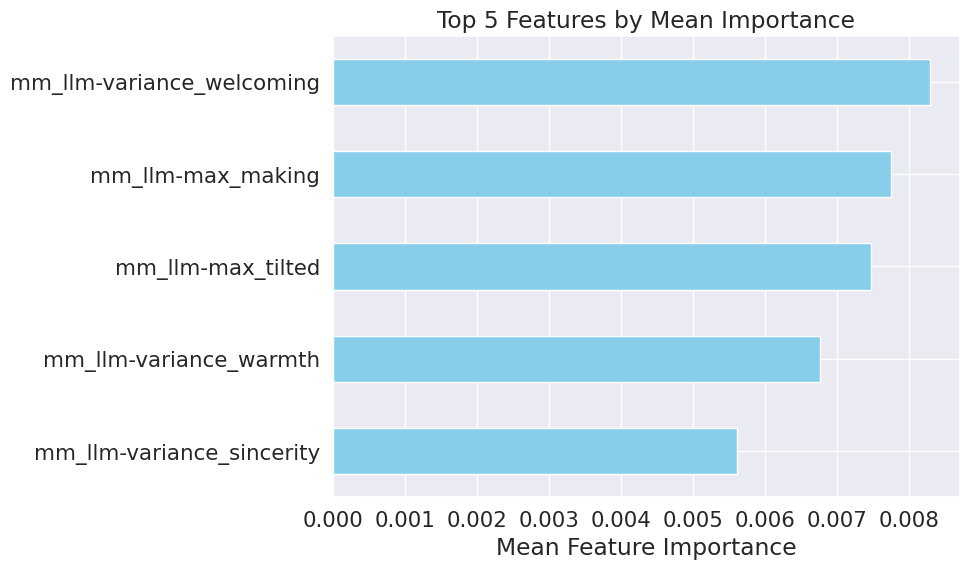

random_state:1
Total Accuracy: 0.6310679611650486
Total Recall: 0.6310679611650486
Total F1 Score: 0.6312731931100849


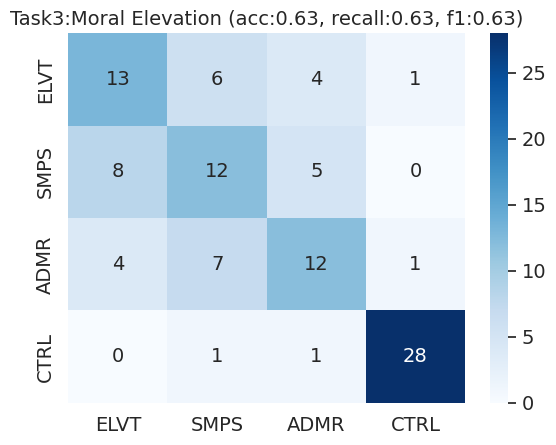

Top 5 Features by Mean Importance:['mm_llm-max_arm', 'mm_llm-max_slight', 'mm_llm-max_individual', 'mm_llm-variance_arm', 'mm_llm-variance_welcoming']


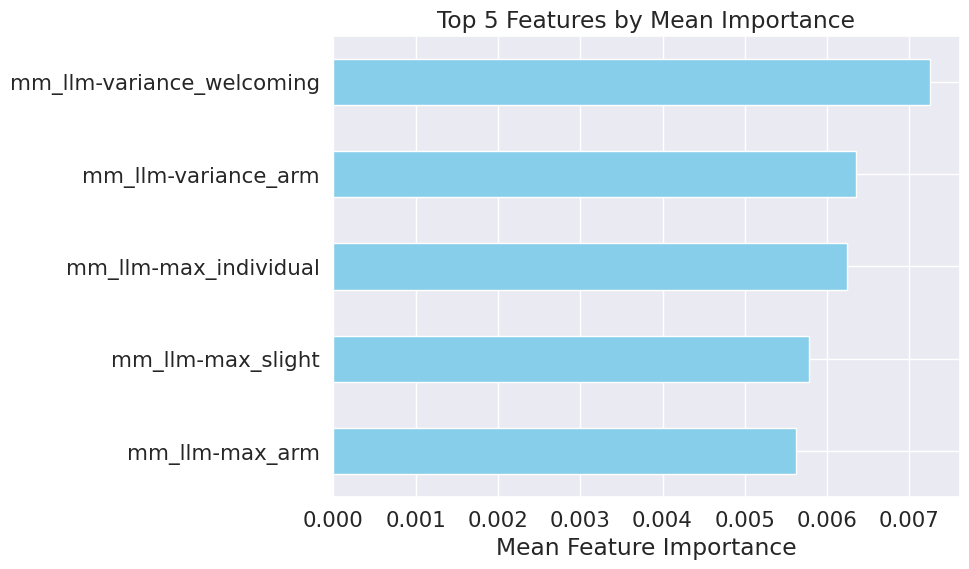

=== Task: early fused, Model: MLP, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.7475728155339806
Total Recall: 0.7475728155339806
Total F1 Score: 0.7463803212762992


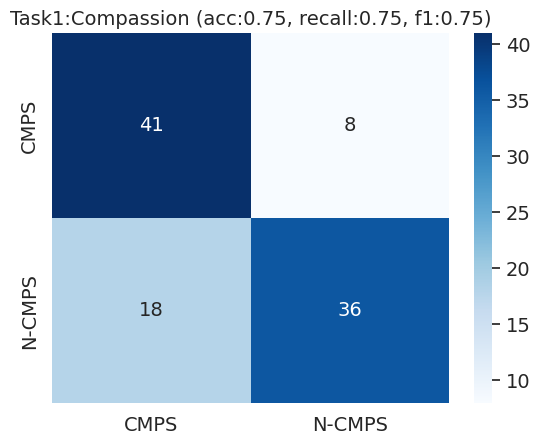

ROC-AUC for Task1:Compassion: 0.7982


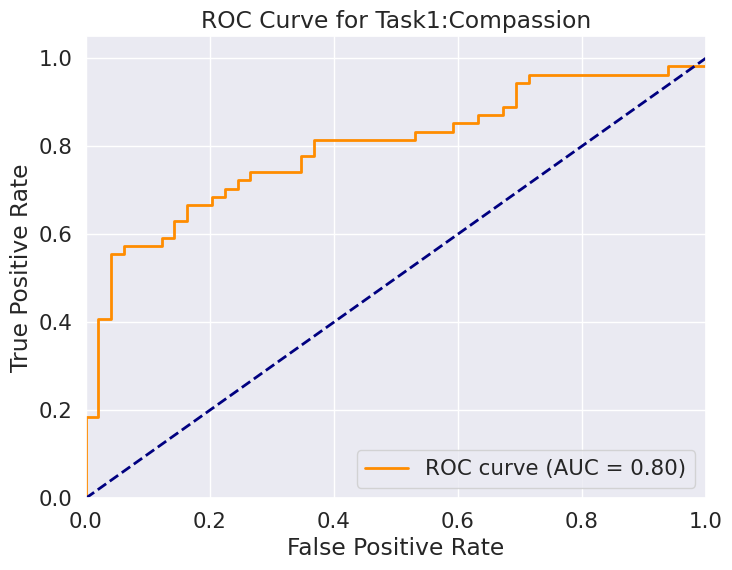

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.6310679611650486
Total Recall: 0.6310679611650486
Total F1 Score: 0.6314856200769372


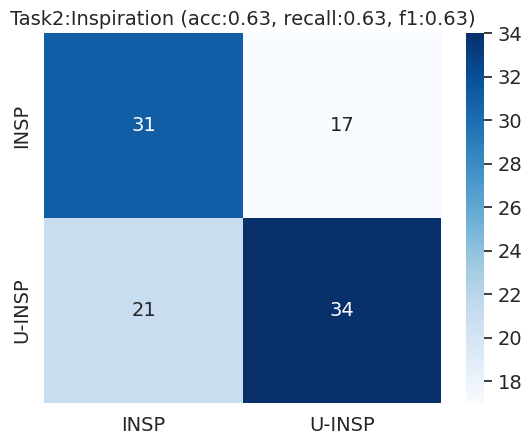

ROC-AUC for Task2:Inspiration: 0.6667


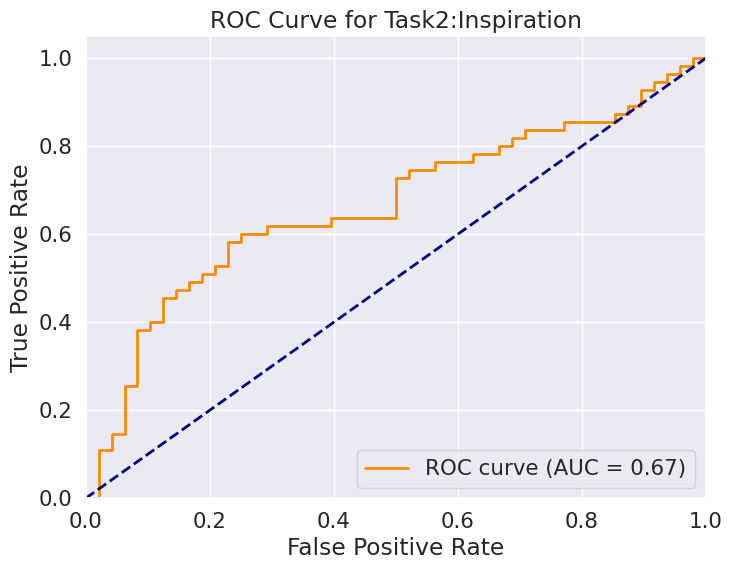

random_state:1
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
hidden_layer_sizes:(128, 64)
Total Accuracy: 0.5339805825242718
Total Recall: 0.5339805825242718
Total F1 Score: 0.5324749493795753


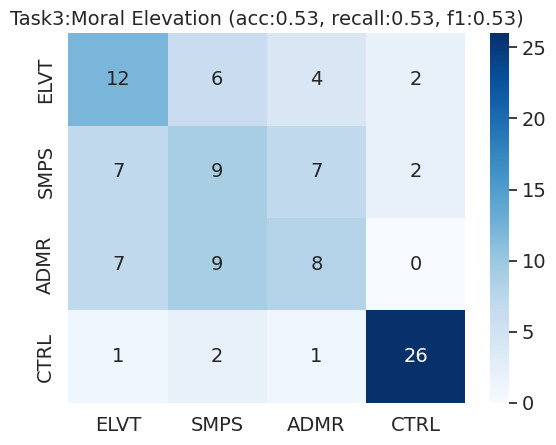

       df_name     model_name  do_rfe rfe_model_name  n_kept  \
0  early fused  Random Forest   False            SVM      15   
1  early fused            MLP   False            SVM      15   

   do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0                 False     False   0.825243   0.650485   0.631068  
1                 False     False   0.747573   0.631068   0.533981  


In [48]:
data_helper = local_utilities.DataHelper()
data_loader = local_data_loader.DataLoader()

selected_columns = [1,3, 7]  # Index positions for 2nd, 3rd, 5th, and 9th columns
df_list = [all_df[i] for i in selected_columns]
df_names_list = [all_df_name[i] for i in selected_columns]

df_merged = data_helper.merge_dataframe(df_list)
df = df_merged
df_name = "early fused"

data_prepare_helper = psychai.data_preparation.data_preparation.DataPreparationHelper(df_merged.copy())
parameter = {
    "remove_all_nan_rows": True,
    "replace_missing_data_with_median":True
}
df_prepared = data_prepare_helper.prepare_data(parameter)


# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [15]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [False]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest", "MLP"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df_prepared, df_name, param_combinations, random_state=random_state)

print(df_all_evaluations)

### Selected 2 Modalities without MLLM

=== Task: early fused, Model: Random Forest, RFE Model: SVM, n_kept: 6, ANOVA: False, RFE: True, Grid Search: False ===
random_state:1
Total Accuracy: 0.5922330097087378
Total Recall: 0.5922330097087378
Total F1 Score: 0.5922330097087378


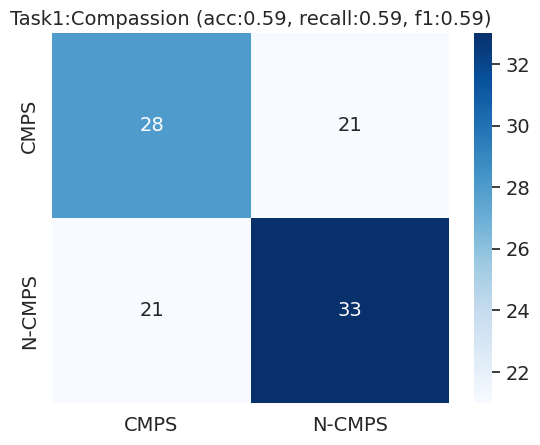

ROC-AUC for Task1:Compassion: 0.6330


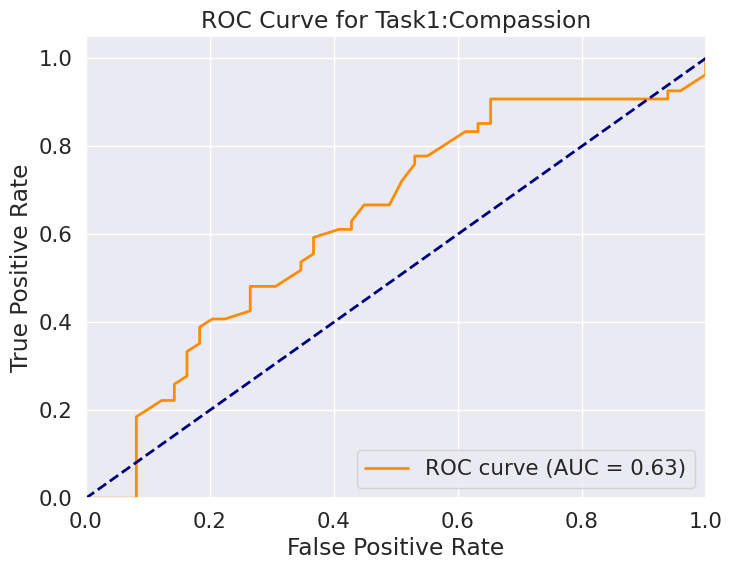

Top 5 Features by Mean Importance:['max_speech_text-caring', 'max_speech_text-grief', 'median_speech_text-gratitude', 'pose-mean_ear_to_ear_difference_z', 'pose-max_left_head_angle']


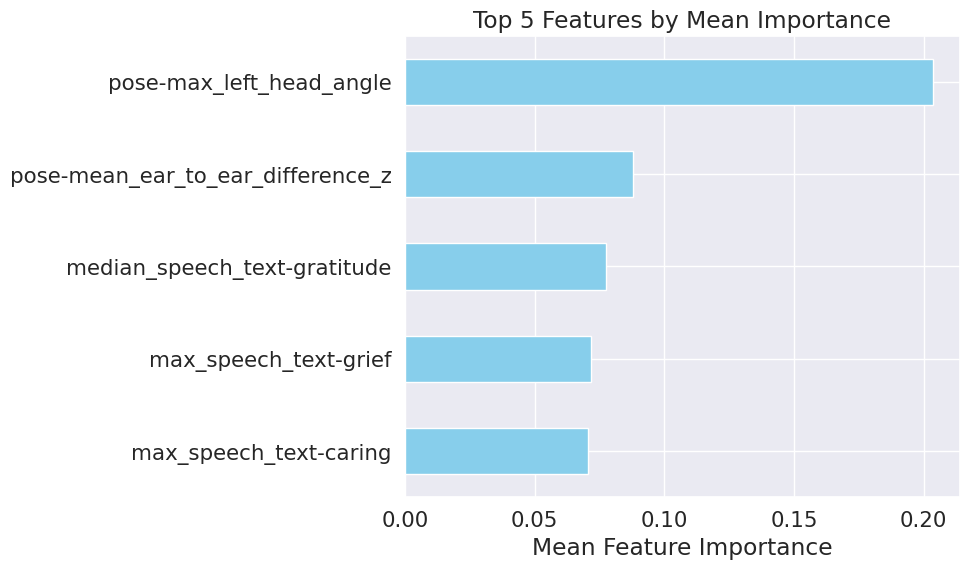

random_state:1
Total Accuracy: 0.5825242718446602
Total Recall: 0.5825242718446602
Total F1 Score: 0.5807902085916784


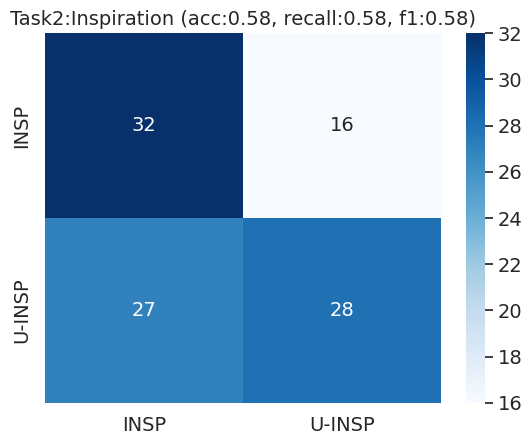

ROC-AUC for Task2:Inspiration: 0.6311


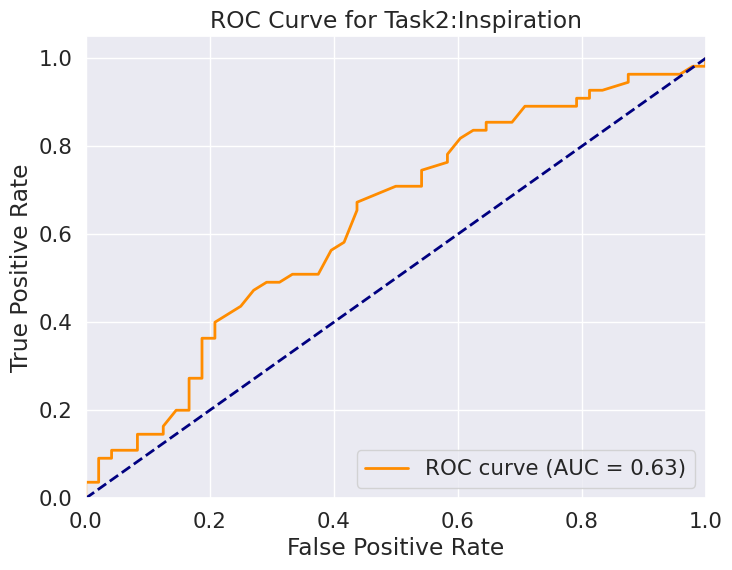

Top 5 Features by Mean Importance:['max_speech_text-optimism', 'median_speech_text-remorse', 'max_speech_text-annoyance', 'max_speech_text-relief', 'pose-max_ear_to_ear_difference_x']


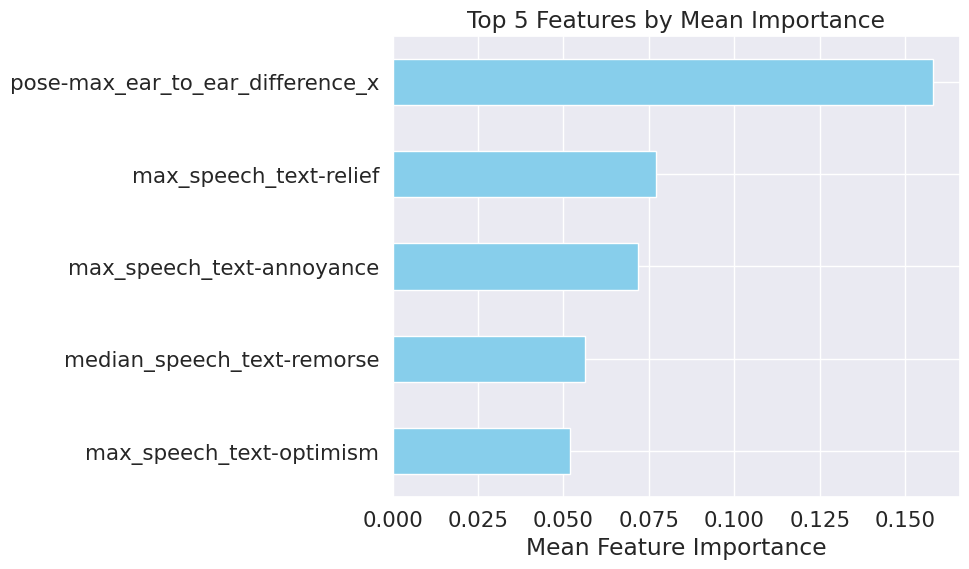

random_state:1
Total Accuracy: 0.2912621359223301
Total Recall: 0.2912621359223301
Total F1 Score: 0.2871395415084735


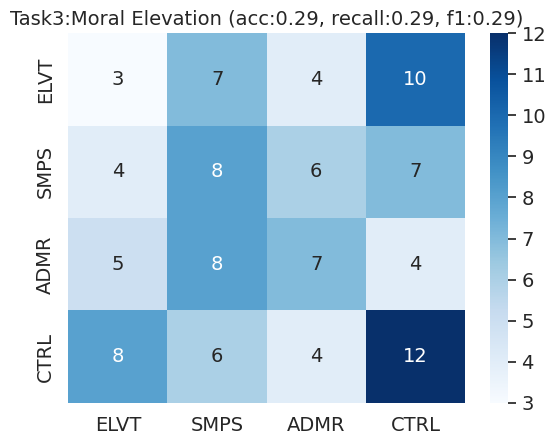

Top 5 Features by Mean Importance:['variance_speech_text-optimism', 'pose-max_ear_to_ear_difference_z', 'pose-mean_ear_to_ear_difference_x', 'pose-max_nose_to_lip_difference_x', 'pose-variance_nose_to_lip_difference_y']


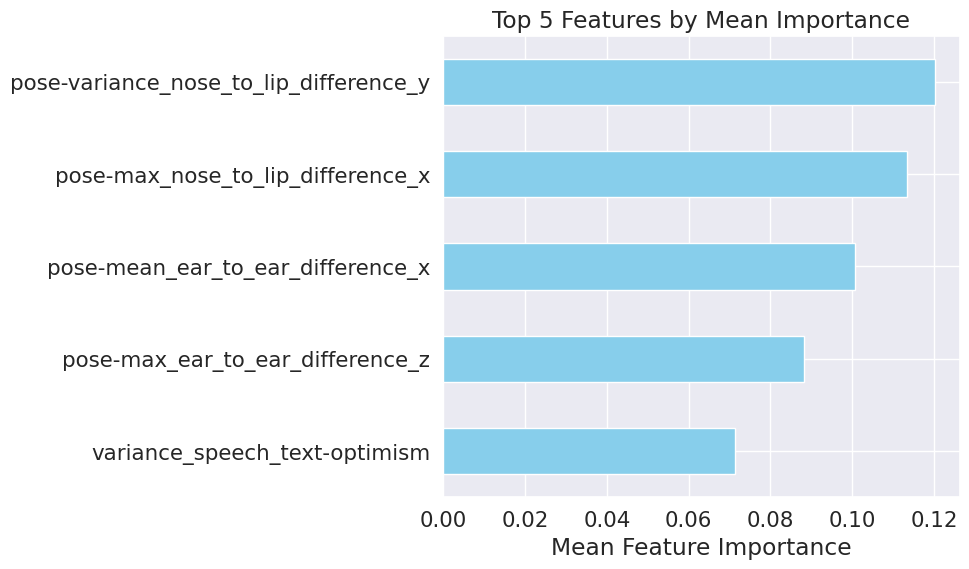

=== Task: early fused, Model: Random Forest, RFE Model: SVM, n_kept: 10, ANOVA: False, RFE: True, Grid Search: False ===
random_state:1
Total Accuracy: 0.6310679611650486
Total Recall: 0.6310679611650486
Total F1 Score: 0.6305788467196233


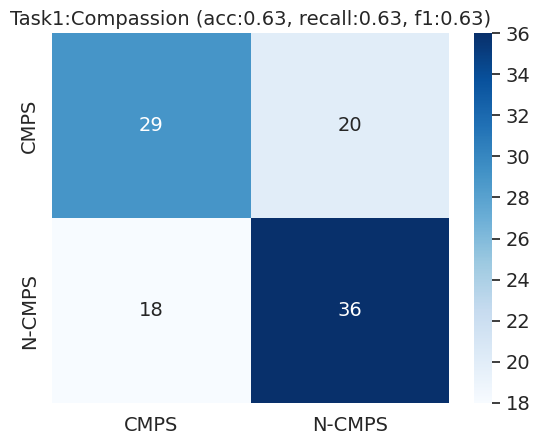

ROC-AUC for Task1:Compassion: 0.6515


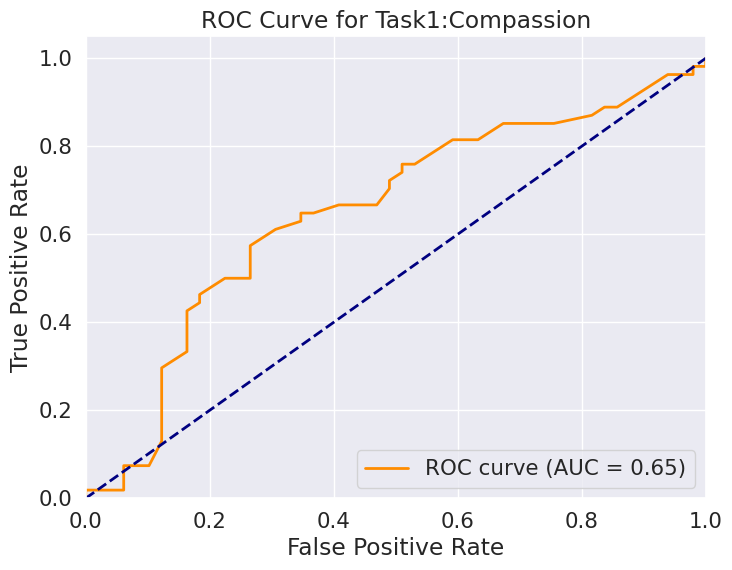

Top 5 Features by Mean Importance:['pose-mean_ear_to_ear_difference_z', 'max_speech_text-amusement', 'pose-variance_nose_to_lip_difference_z', 'pose-max_right_head_angle', 'pose-max_left_head_angle']


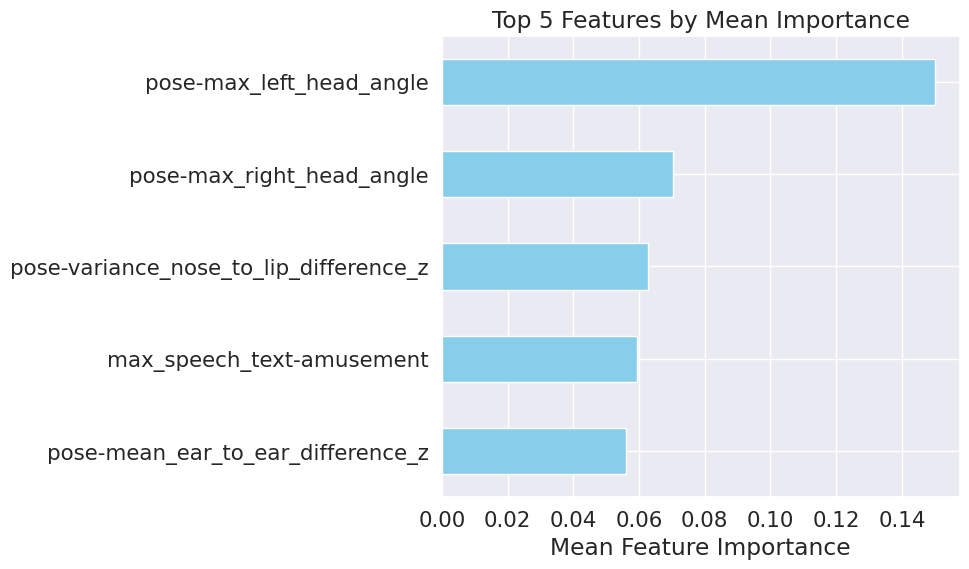

random_state:1
Total Accuracy: 0.5631067961165048
Total Recall: 0.5631067961165048
Total F1 Score: 0.5631067961165048


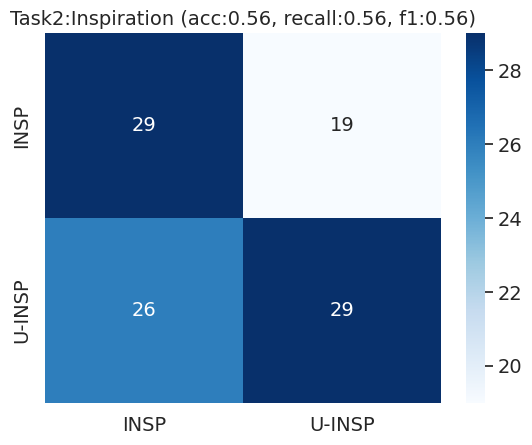

ROC-AUC for Task2:Inspiration: 0.6097


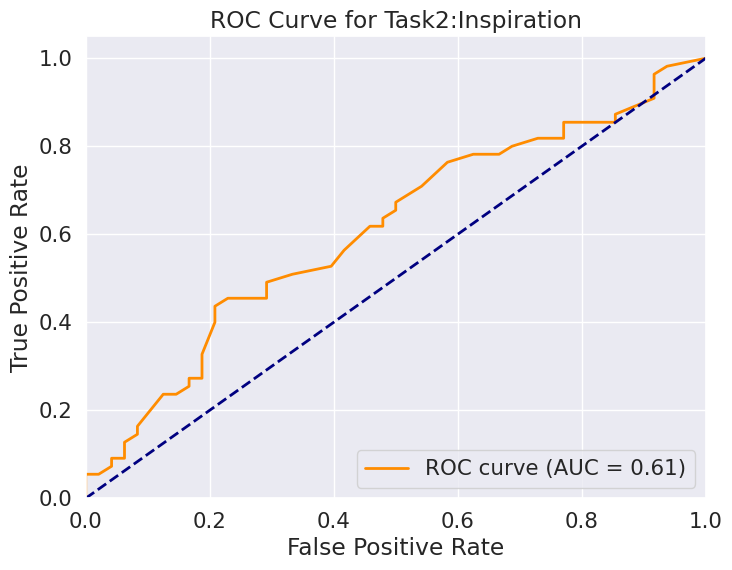

Top 5 Features by Mean Importance:['max_speech_text-annoyance', 'median_speech_text-remorse', 'max_speech_text-optimism', 'max_speech_text-relief', 'pose-max_ear_to_ear_difference_x']


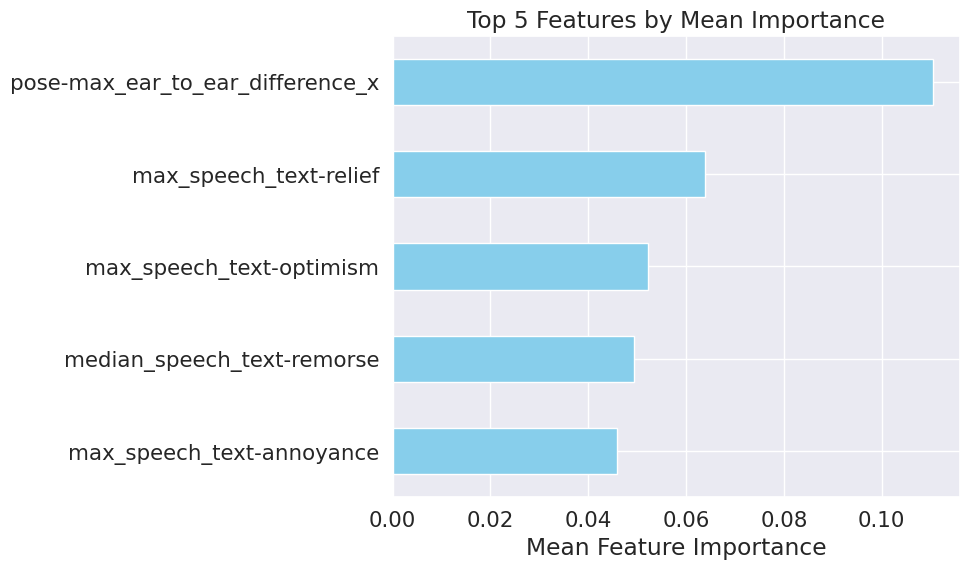

random_state:1
Total Accuracy: 0.3883495145631068
Total Recall: 0.3883495145631068
Total F1 Score: 0.3885128620818825


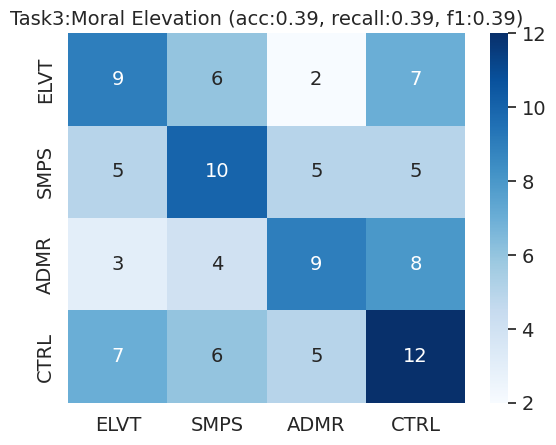

Top 5 Features by Mean Importance:['pose-max_nose_to_lip_difference_x', 'median_speech_text-surprise', 'variance_speech_text-optimism', 'pose-mean_ear_to_ear_difference_x', 'pose-variance_nose_to_lip_difference_y']


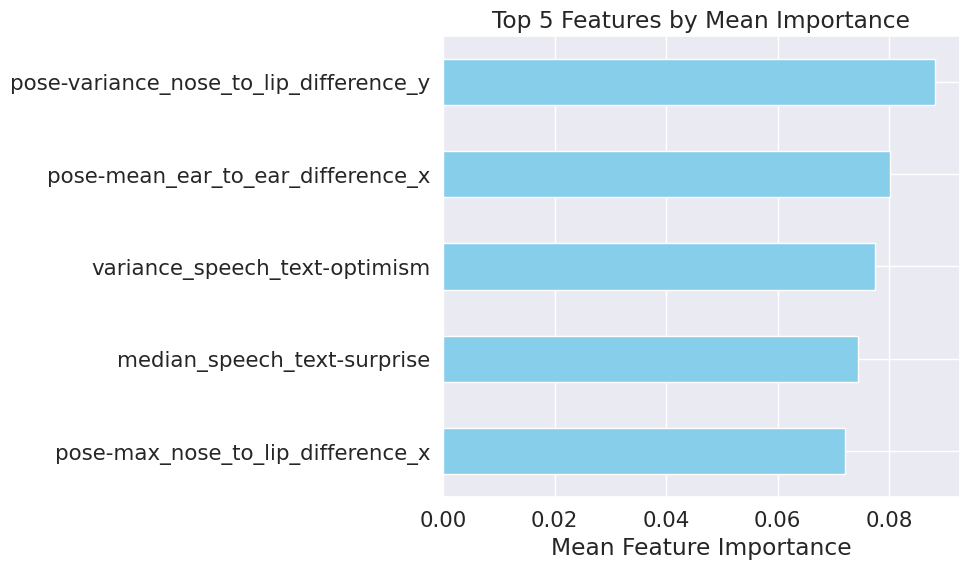

=== Task: early fused, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: True, Grid Search: False ===
random_state:1
Total Accuracy: 0.6699029126213593
Total Recall: 0.6699029126213593
Total F1 Score: 0.6694652839070316


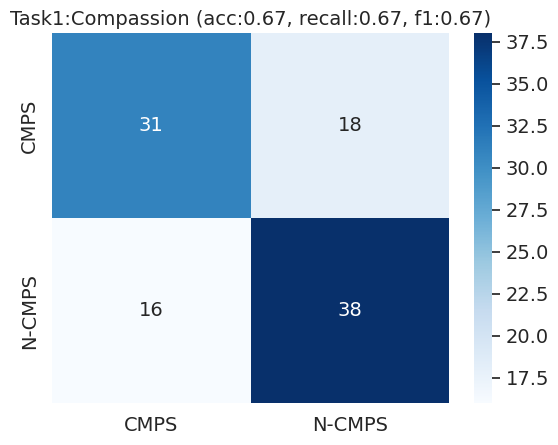

ROC-AUC for Task1:Compassion: 0.6578


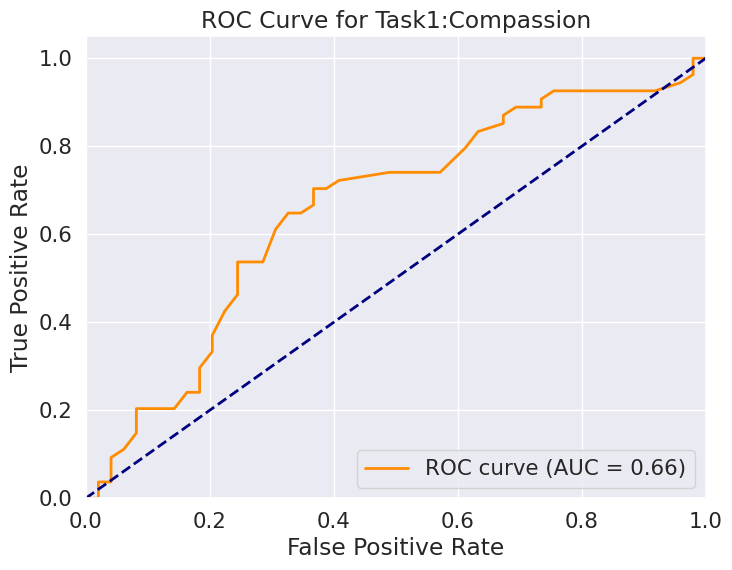

Top 5 Features by Mean Importance:['variance_speech_text-fear', 'max_speech_text-amusement', 'median_speech_text-gratitude', 'pose-max_right_head_angle', 'pose-max_left_head_angle']


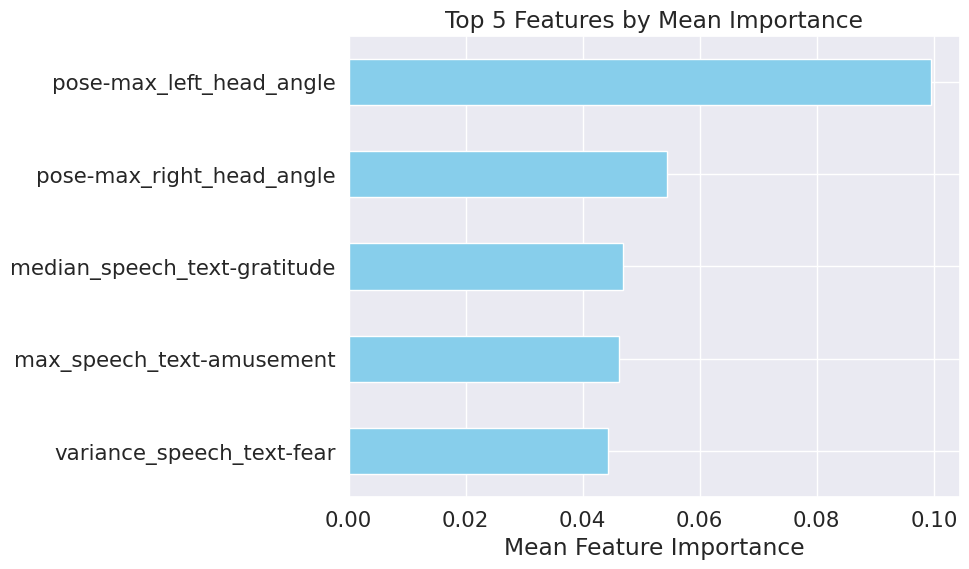

random_state:1
Total Accuracy: 0.5825242718446602
Total Recall: 0.5825242718446602
Total F1 Score: 0.5822075524681554


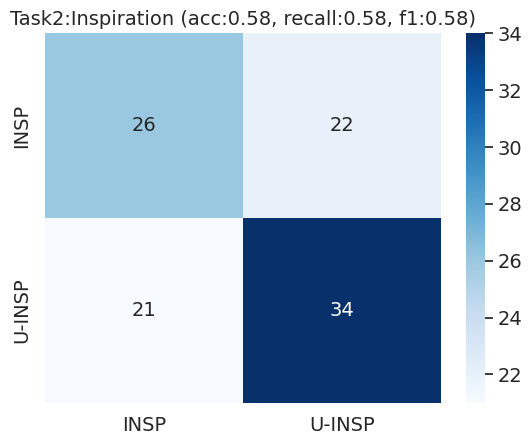

ROC-AUC for Task2:Inspiration: 0.5884


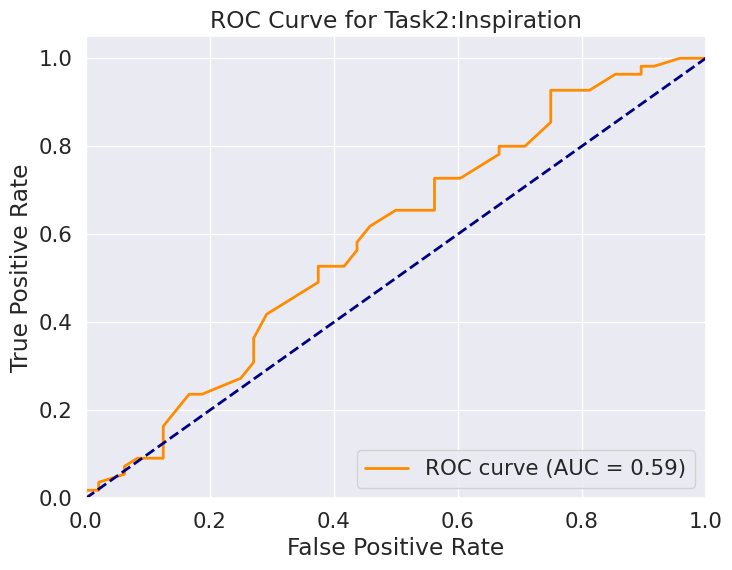

Top 5 Features by Mean Importance:['max_speech_text-annoyance', 'max_speech_text-relief', 'max_speech_text-optimism', 'median_speech_text-remorse', 'pose-max_ear_to_ear_difference_x']


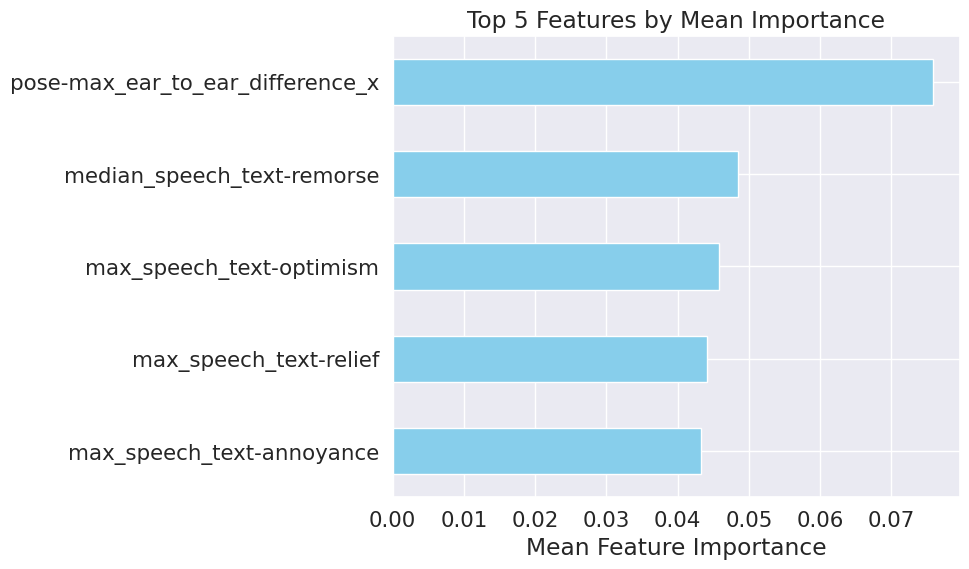

random_state:1
Total Accuracy: 0.3786407766990291
Total Recall: 0.3786407766990291
Total F1 Score: 0.37558945908460467


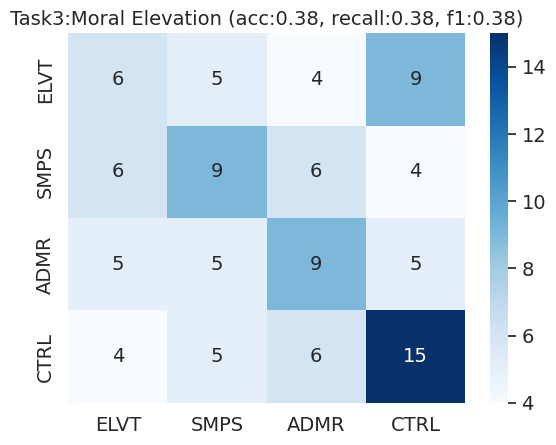

Top 5 Features by Mean Importance:['pose-max_ear_to_ear_difference_z', 'pose-variance_nose_to_lip_difference_y', 'pose-mean_ear_to_ear_difference_x', 'pose-max_nose_to_lip_difference_x', 'variance_speech_text-optimism']


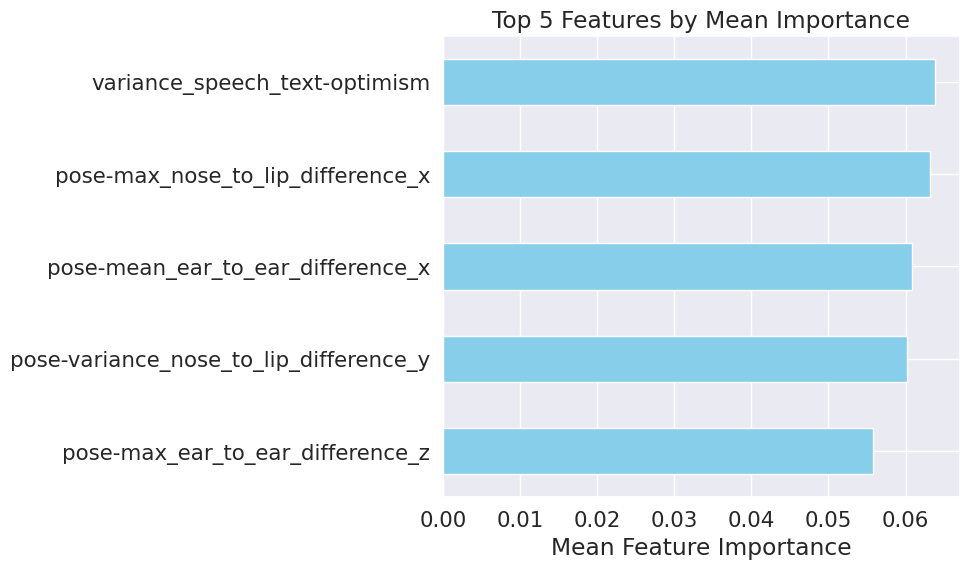

=== Task: early fused, Model: Random Forest, RFE Model: SVM, n_kept: 20, ANOVA: False, RFE: True, Grid Search: False ===
random_state:1
Total Accuracy: 0.6407766990291263
Total Recall: 0.6407766990291263
Total F1 Score: 0.6399591211037302


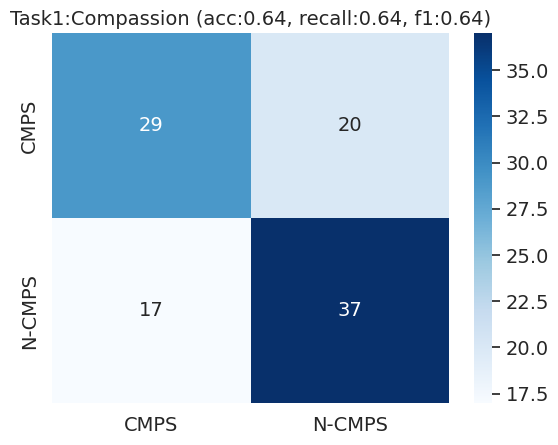

ROC-AUC for Task1:Compassion: 0.6935


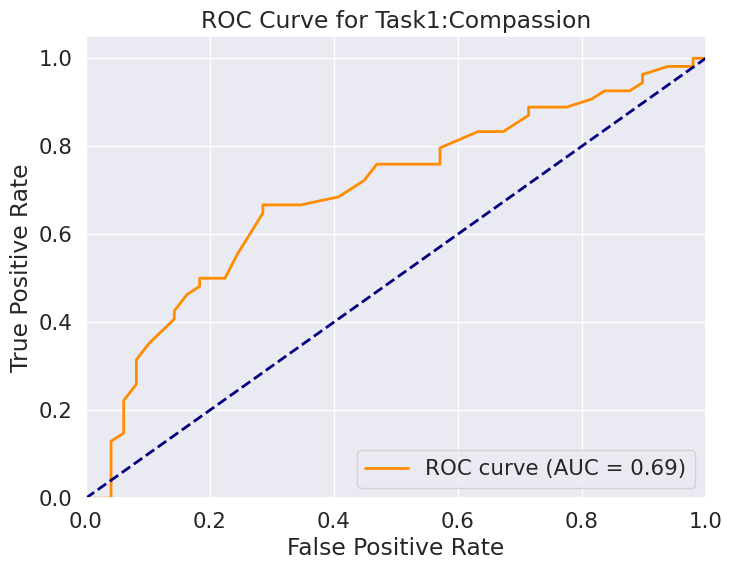

Top 5 Features by Mean Importance:['max_speech_text-sadness', 'max_speech_text-caring', 'variance_speech_text-fear', 'pose-max_right_head_angle', 'pose-max_left_head_angle']


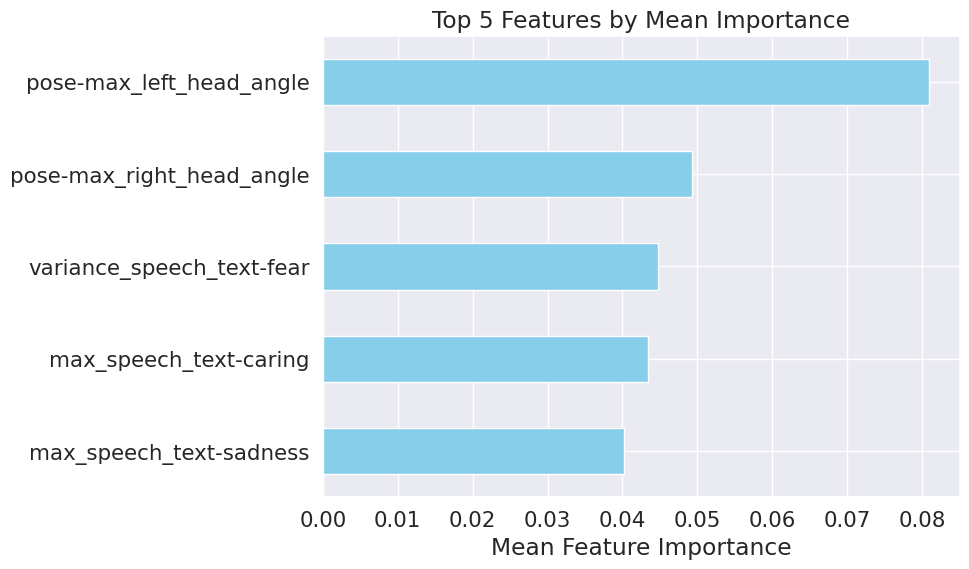

random_state:1
Total Accuracy: 0.5631067961165048
Total Recall: 0.5631067961165048
Total F1 Score: 0.5627753456062091


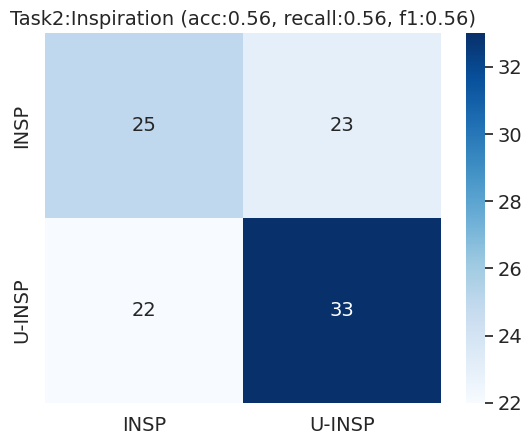

ROC-AUC for Task2:Inspiration: 0.5795


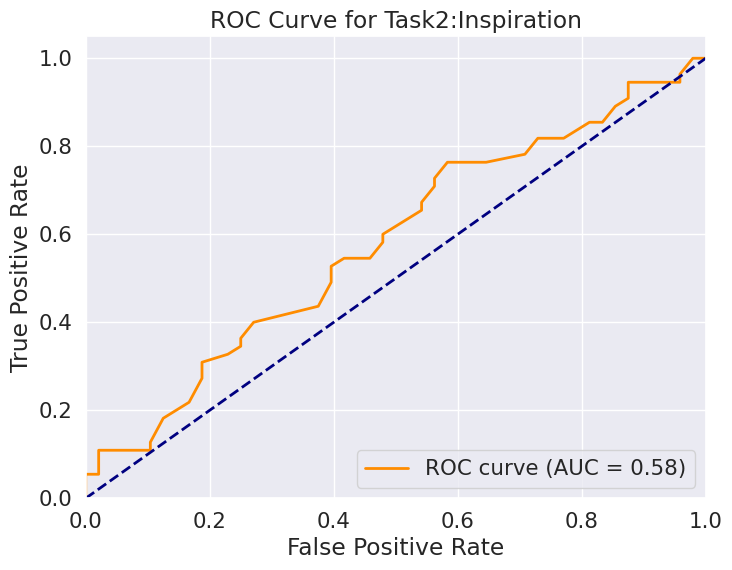

Top 5 Features by Mean Importance:['max_speech_text-optimism', 'median_speech_text-surprise', 'max_speech_text-annoyance', 'median_speech_text-remorse', 'pose-max_ear_to_ear_difference_x']


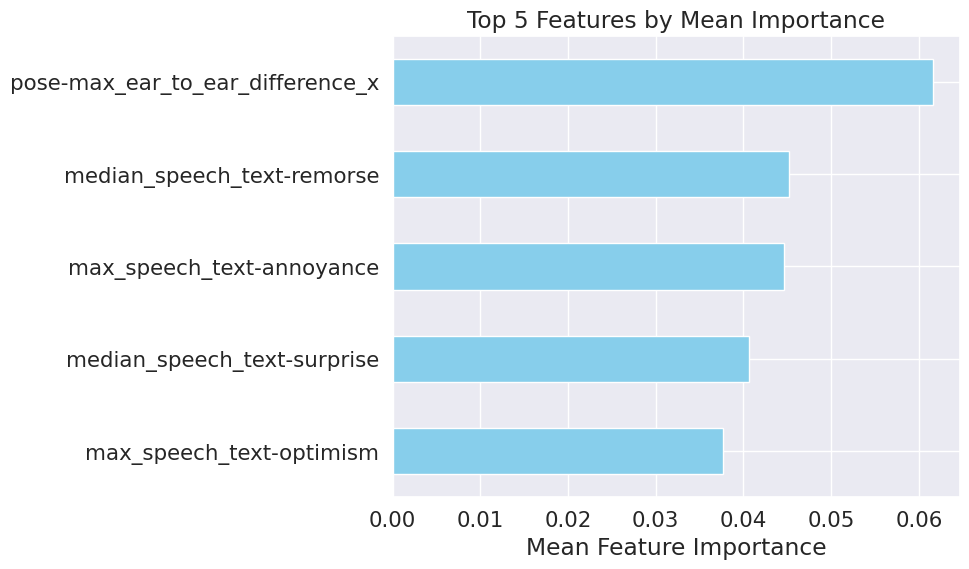

random_state:1
Total Accuracy: 0.4368932038834951
Total Recall: 0.4368932038834951
Total F1 Score: 0.43308438283953793


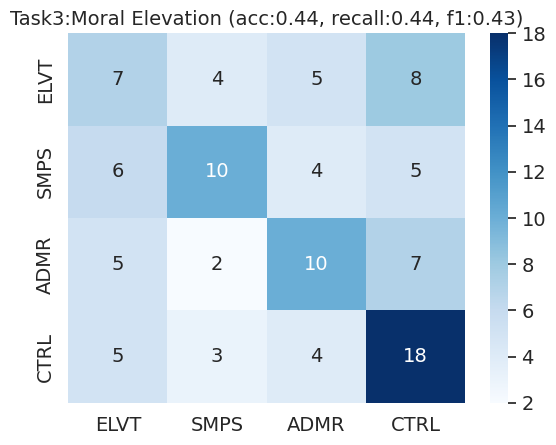

Top 5 Features by Mean Importance:['pose-max_left_head_angle', 'pose-max_nose_to_lip_difference_x', 'pose-max_ear_to_ear_difference_z', 'variance_speech_text-optimism', 'pose-variance_nose_to_lip_difference_y']


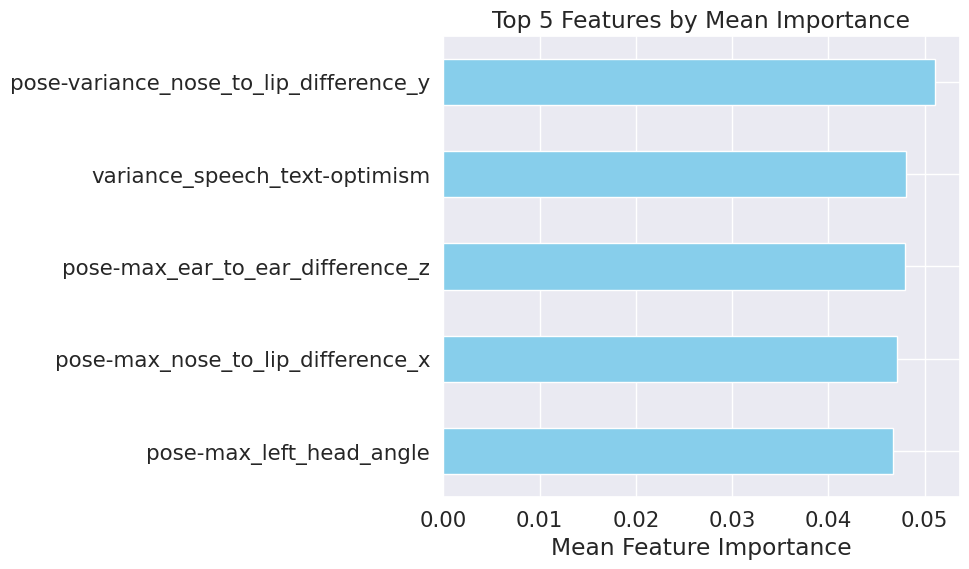

       df_name     model_name  do_rfe rfe_model_name  n_kept  \
0  early fused  Random Forest    True            SVM       6   
1  early fused  Random Forest    True            SVM      10   
2  early fused  Random Forest    True            SVM      15   
3  early fused  Random Forest    True            SVM      20   

   do_model_grid_search  do_anova  Accuracy1  Accuracy2  Accuracy3  
0                 False     False   0.592233   0.582524   0.291262  
1                 False     False   0.631068   0.563107   0.388350  
2                 False     False   0.669903   0.582524   0.378641  
3                 False     False   0.640777   0.563107   0.436893  


In [59]:
data_helper = local_utilities.DataHelper()
data_loader = local_data_loader.DataLoader()

selected_columns = [1,3]  # Index positions for 2nd, 3rd, 5th, and 9th columns
df_list = [all_df[i] for i in selected_columns]
df_names_list = [all_df_name[i] for i in selected_columns]

df_merged = data_helper.merge_dataframe(df_list)
df = df_merged
df_name = "early fused"

data_prepare_helper = psychai.data_preparation.data_preparation.DataPreparationHelper(df_merged.copy())
parameter = {
    "remove_all_nan_rows": True,
    "replace_missing_data_with_median":True
}
df_prepared = data_prepare_helper.prepare_data(parameter)


# Set a fixed random state for reproducibility
# This ensures that the results are consistent across runs by initializing the random seed
random_state = 1

group_column_list = ["user_id"]

# Define parameter options
# Number of features to retain after feature selection
n_kept_list = [6, 10, 15, 20]  # This can be adjusted to include more values for experimentation

# Boolean flags indicating whether to perform specific preprocessing steps
# Whether to perform ANOVA (Analysis of Variance) feature selection

do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

# Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
do_RFE_list = [True]

# Whether to perform model hyperparameter tuning using Grid Search
do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

# List of models to use for RFE (Recursive Feature Elimination)
RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

# List of models to use for the final classification task
default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

# Generate all combinations of parameter values using Cartesian product
# This ensures we test all combinations of the hyperparameters defined above
param_combinations = list(itertools.product(
    n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
))

df_all_evaluations, df_all_predictions = run_analysis(df_prepared, df_name, param_combinations, random_state=random_state)

print(df_all_evaluations)

### Try All Combinations

In [ ]:
file_path = r"/mnt/c/Working/Programming/Python/wsl/wsl2/examples/paper5_mmer_moral/emotion_recognition/temp.csv"

Processing combination: df_acoustics, df_speech_text, df_facial, df_pose
=== Task: df_acoustics, df_speech_text, df_facial, df_pose, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.6138613861386139
Total Recall: 0.6138613861386139
Total F1 Score: 0.6129471781152664


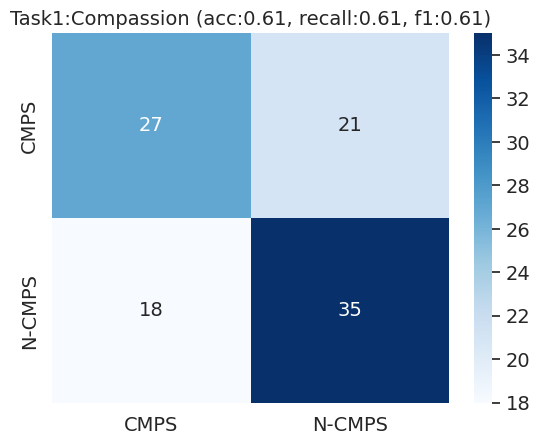

ROC-AUC for Task1:Compassion: 0.6118


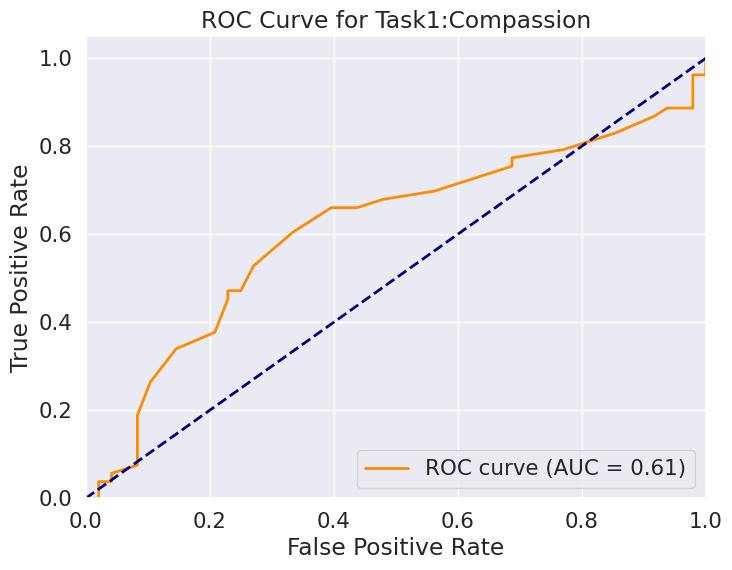

Top 5 Features by Mean Importance:['variance_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_stddevNorm', 'max_acoustics-spectral_centroid_std', 'end_to_begin_anger', 'median_AU09']


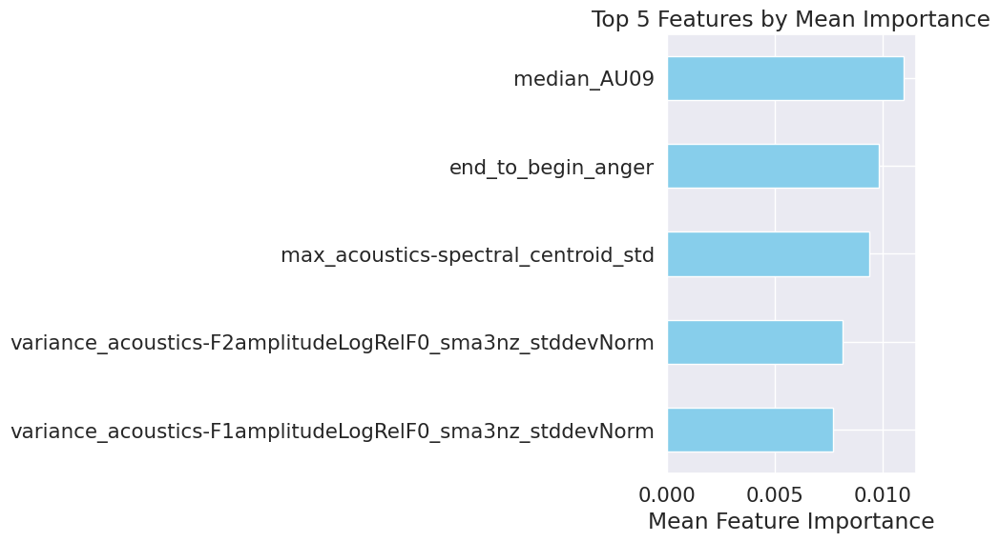

random_state:1
Total Accuracy: 0.504950495049505
Total Recall: 0.504950495049505
Total F1 Score: 0.49645993655055587


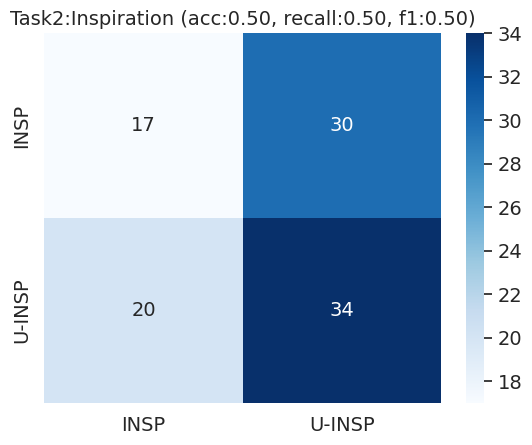

ROC-AUC for Task2:Inspiration: 0.4742


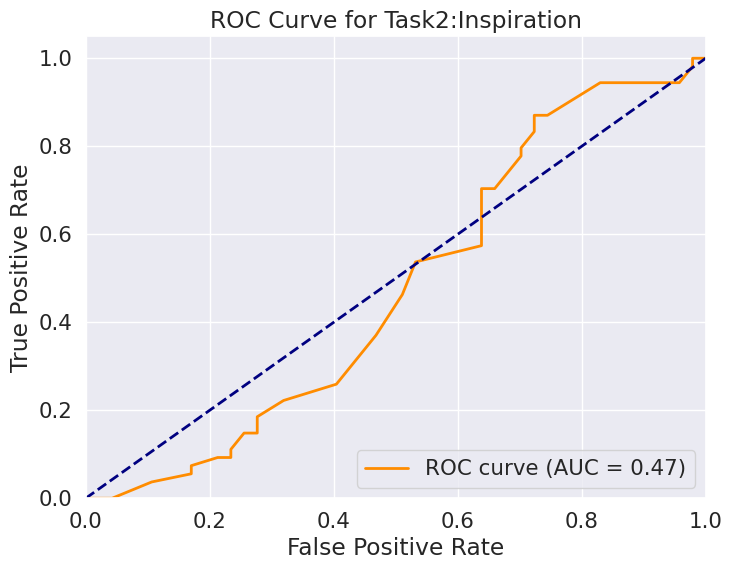

Top 5 Features by Mean Importance:['variance_acoustics-mfcc_12_mu', 'max_speech_text-annoyance', 'median_acoustics-logRelF0-H1-A3_sma3nz_stddevNorm', 'variance_speech_text-annoyance', 'pose-max_nose_to_lip_difference_y']


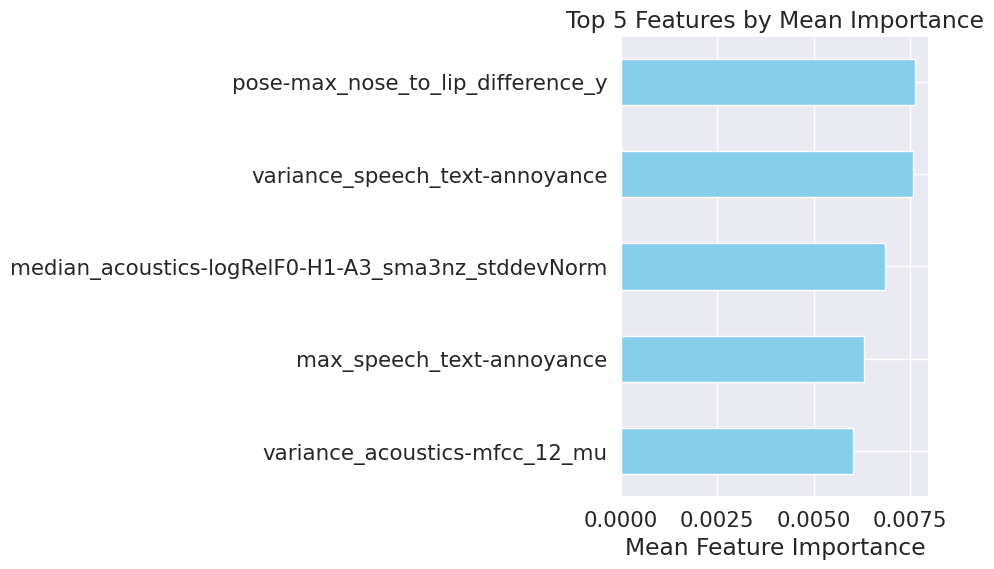

random_state:1
Total Accuracy: 0.297029702970297
Total Recall: 0.297029702970297
Total F1 Score: 0.27367703838292073


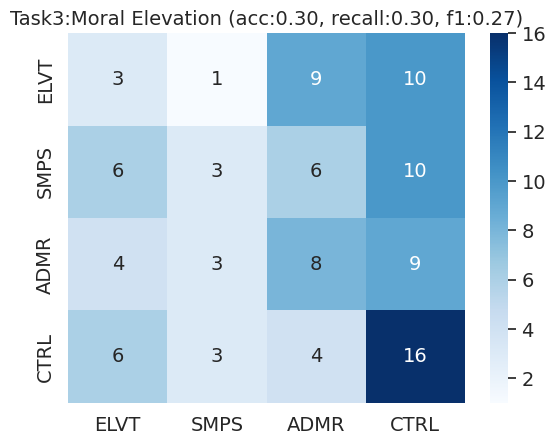

Top 5 Features by Mean Importance:['max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-loudness_sma3_meanRisingSlope', 'median_acoustics-F2frequency_sma3nz_amean', 'max_speech_text-disapproval', 'pose-max_nose_to_lip_difference_y']


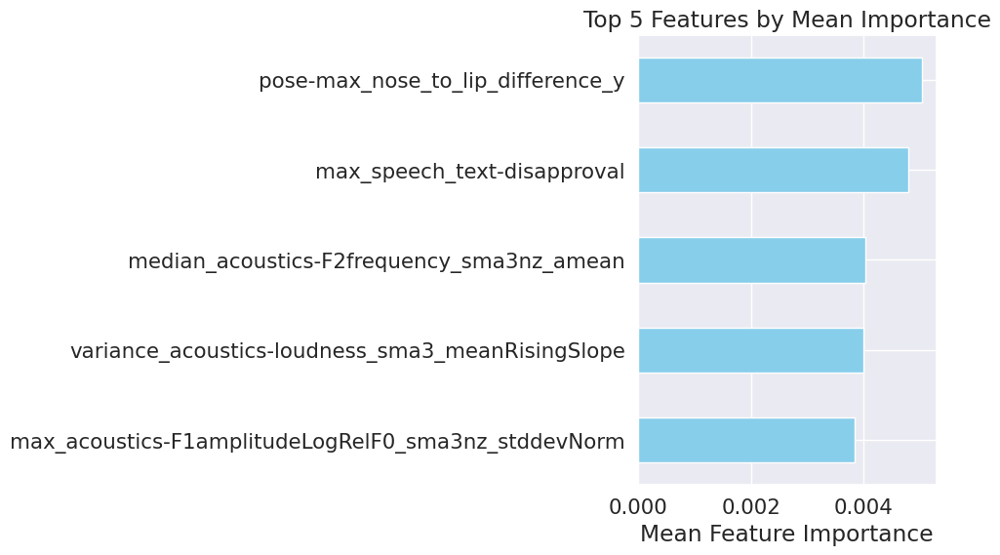

                                            df_name     model_name  do_rfe  \
0  df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   

   Accuracy2  Accuracy3  
0    0.50495    0.29703  
Processing combination: df_acoustics, df_speech_text, df_facial, df_eye_movement
=== Task: df_acoustics, df_speech_text, df_facial, df_eye_movement, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.5346534653465347
Total Recall: 0.5346534653465347
Total F1 Score: 0.5323499976965324


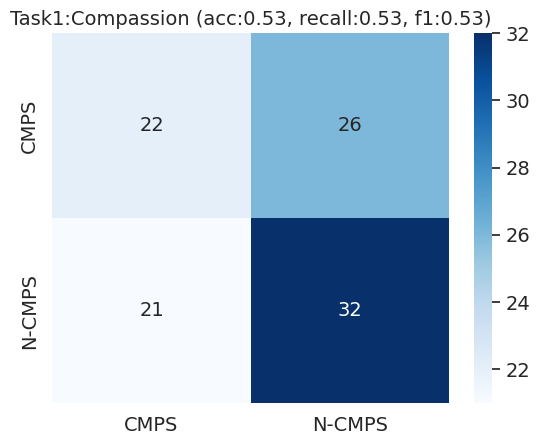

ROC-AUC for Task1:Compassion: 0.5930


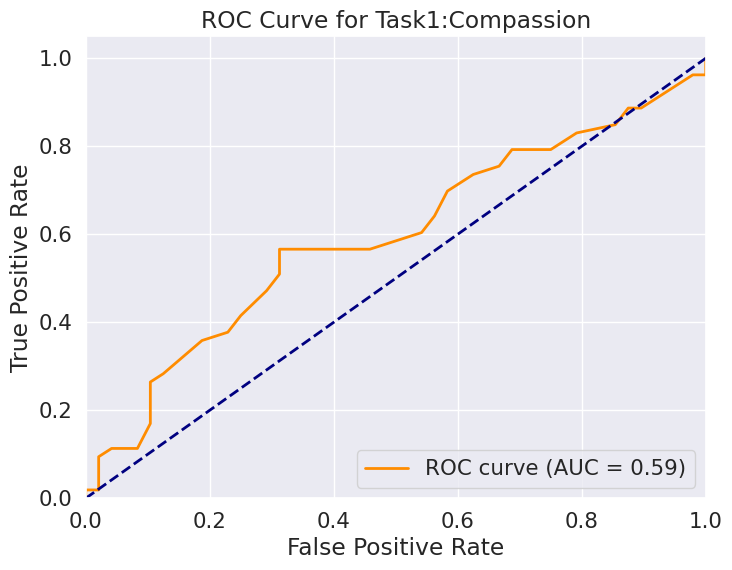

Top 5 Features by Mean Importance:['variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'max_speech_text-caring', 'variance_acoustics-loudness_sma3_percentile20.0', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm']


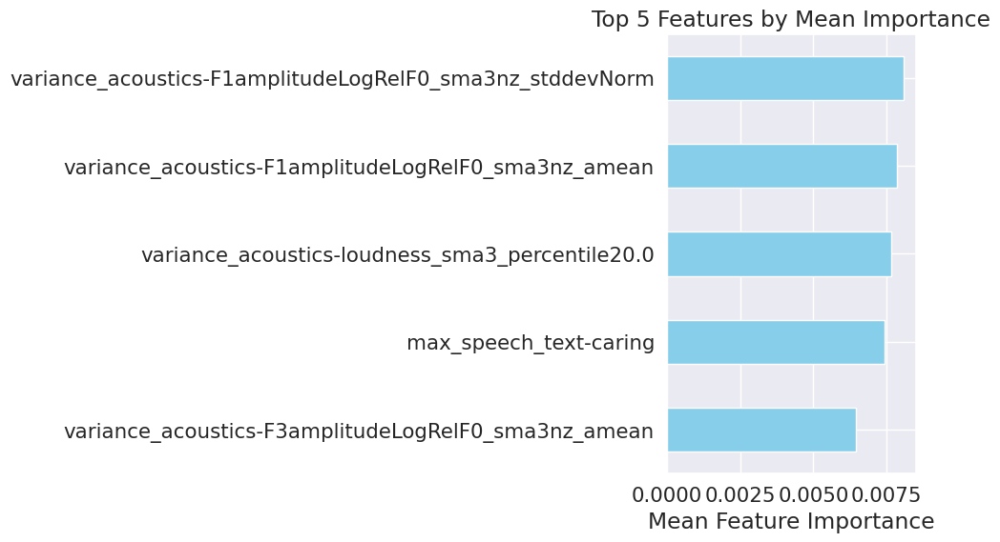

random_state:1
Total Accuracy: 0.5247524752475248
Total Recall: 0.5247524752475248
Total F1 Score: 0.5104366174322351


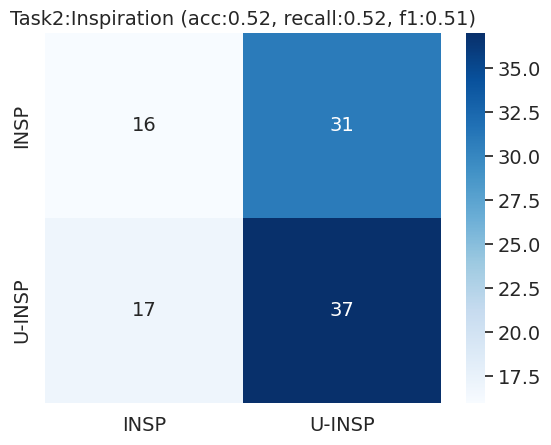

ROC-AUC for Task2:Inspiration: 0.4844


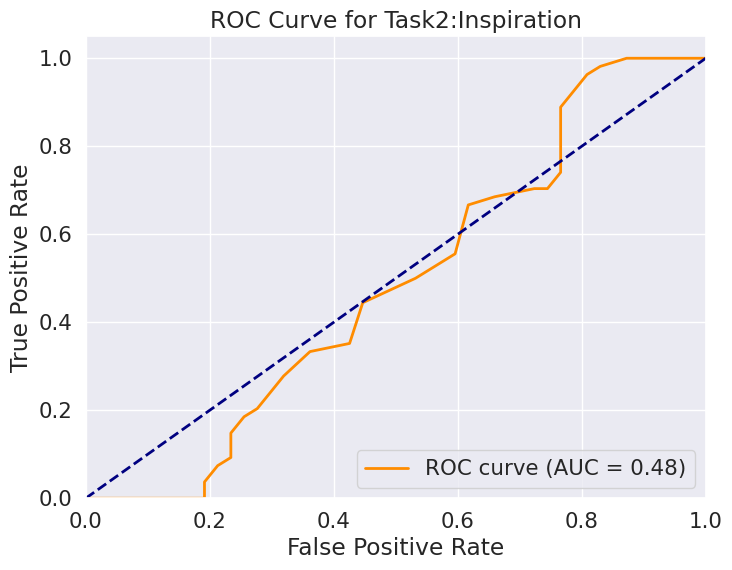

Top 5 Features by Mean Importance:['variance_acoustics-spectral_contrast_5_mu', 'max_acoustics-spectral_contrast_3_std', 'max_acoustics-mfcc_1_mu', 'variance_speech_text-relief', 'variance_happiness']


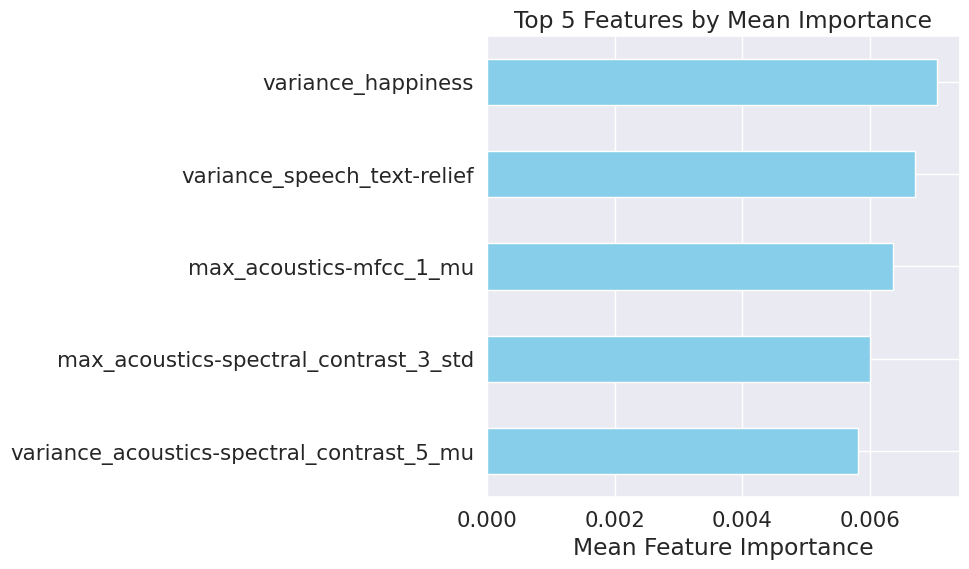

random_state:1
Total Accuracy: 0.297029702970297
Total Recall: 0.297029702970297
Total F1 Score: 0.27483734087694484


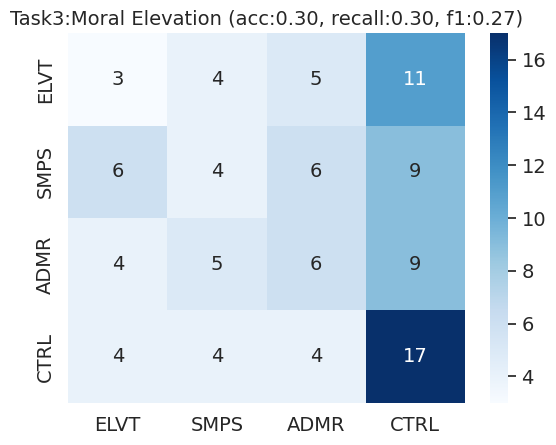

Top 5 Features by Mean Importance:['variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope', 'median_acoustics-tonnetz_3_std', 'variance_speech_text-disapproval', 'max_speech_text-caring']


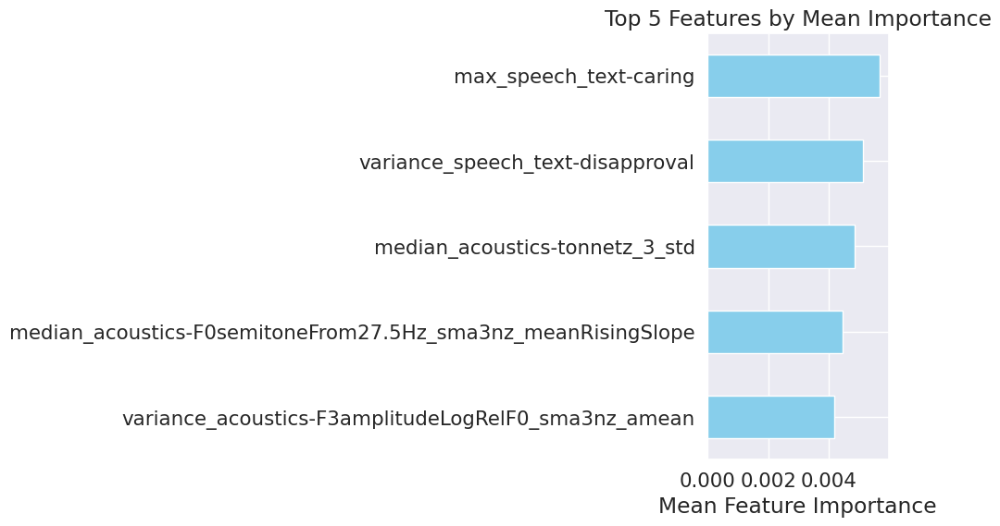

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653   

   Accuracy2  Accuracy3  
0   0.504950    0.29703  
1   0.524752    0.29703  
Processing combination: df_acoustics, df_speech_text, df_facial, df_remote_ppg
=== Task: df_acoustics, df_speech_text, df_facial, df_remote_ppg, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.5742574257425742
Total Recall: 0.5742574257425742
Total F1 Score: 0.5688957501447297


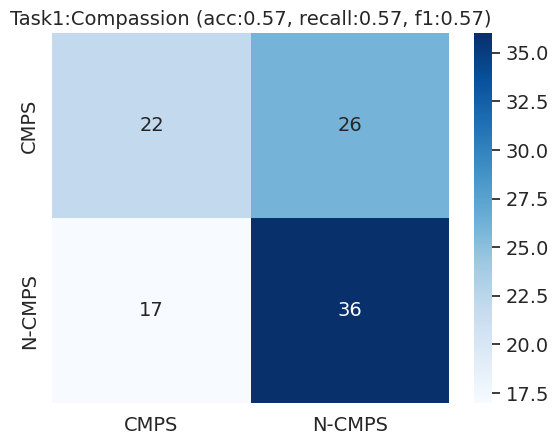

ROC-AUC for Task1:Compassion: 0.6619


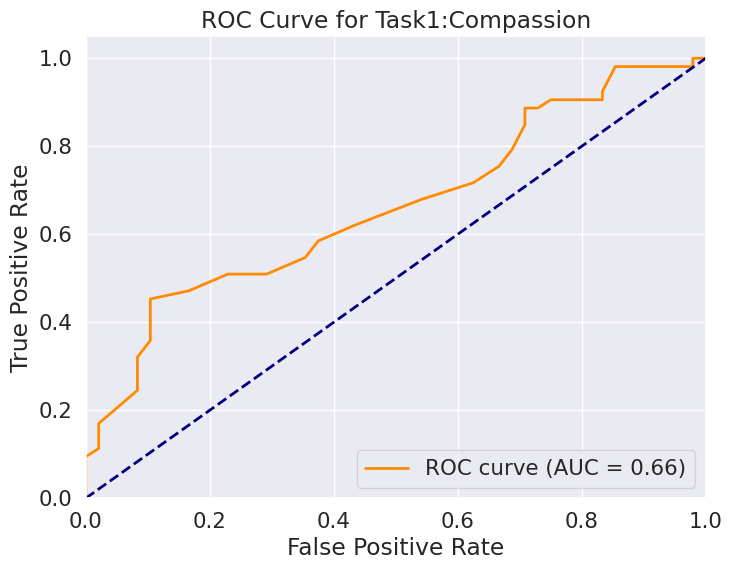

Top 5 Features by Mean Importance:['median_speech_text-grief', 'median_acoustics-chroma_8_std', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'max_acoustics-spectral_centroid_std', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean']


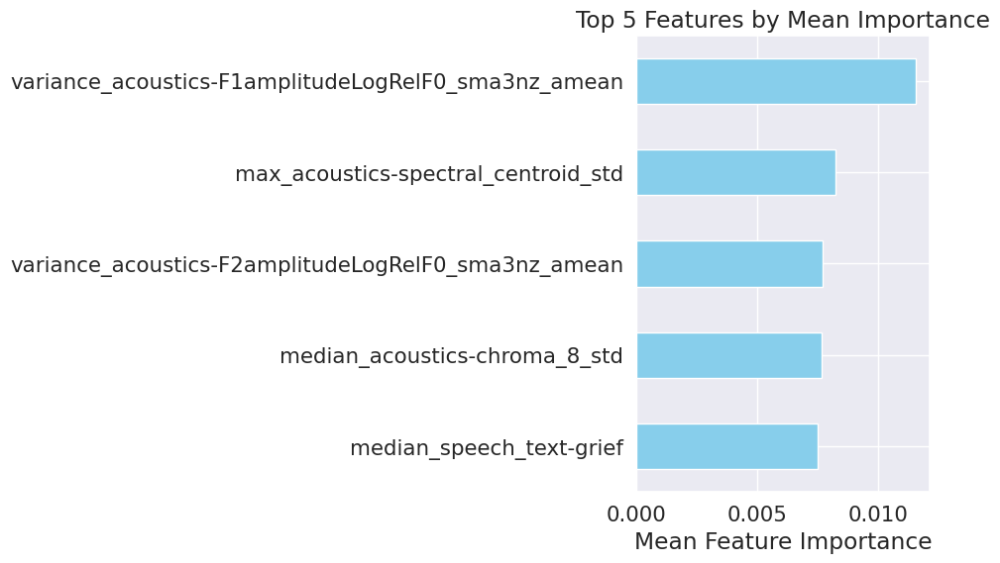

random_state:1
Total Accuracy: 0.504950495049505
Total Recall: 0.504950495049505
Total F1 Score: 0.5011014259320669


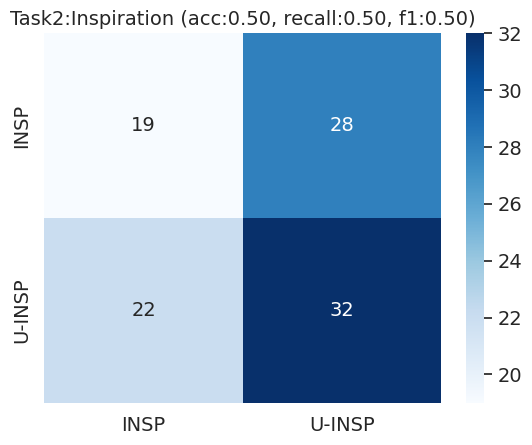

ROC-AUC for Task2:Inspiration: 0.5128


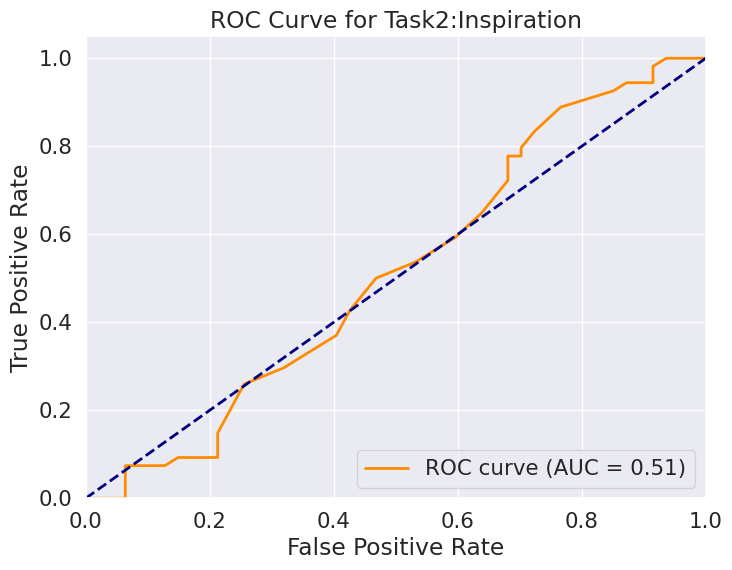

Top 5 Features by Mean Importance:['median_AU10', 'max_AU10', 'median_speech_text-love', 'median_speech_text-optimism', 'median_speech_text-surprise']


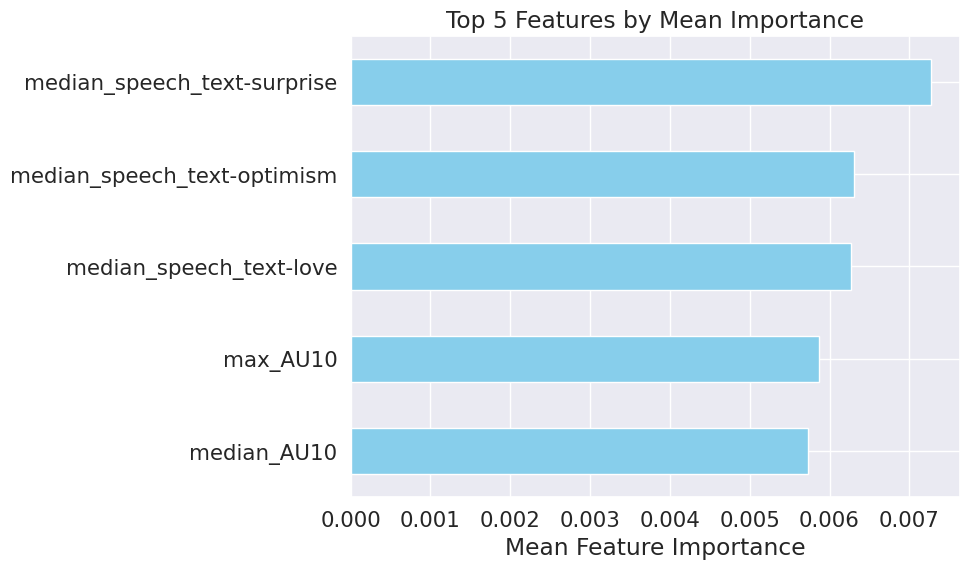

random_state:1
Total Accuracy: 0.3564356435643564
Total Recall: 0.3564356435643564
Total F1 Score: 0.3414128386183304


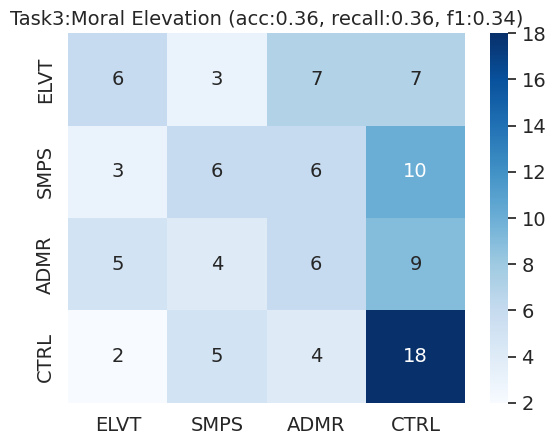

Top 5 Features by Mean Importance:['variance_speech_text-disapproval', 'variance_speech_text-caring', 'median_acoustics-F1frequency_sma3nz_amean', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_amean', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0']


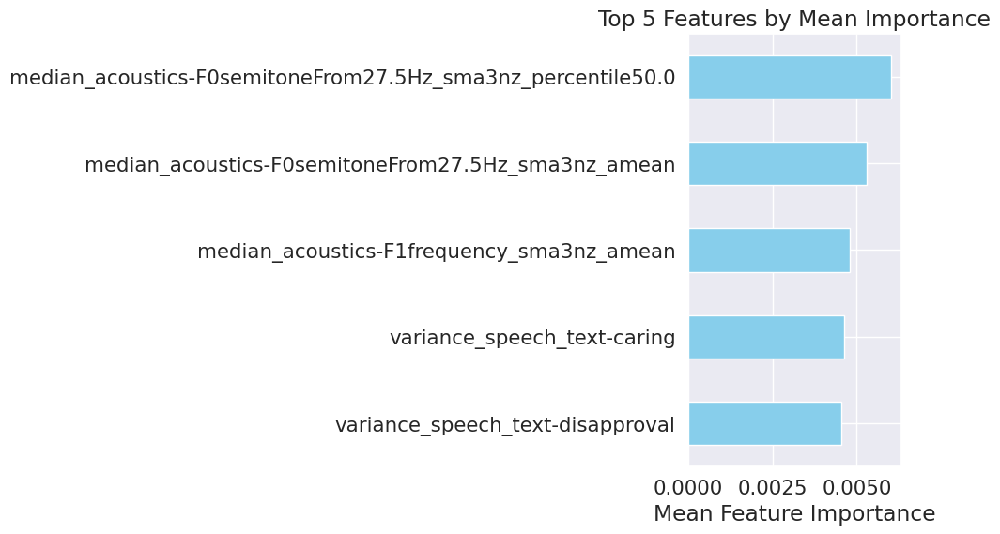

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653   
2            SVM      15                 False     False   0.574257   

   Accuracy2  Accuracy3  
0   0.504950   0.297030  
1   0.524752   0.297030  
2   0.504950   0.356436  
Processing combination: df_acoustics, df_speech_text, df_facial, df_thermal
=== Task: df_acoustics, df_speech_text, df_facial, df_thermal, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.5643564356435643
Total 

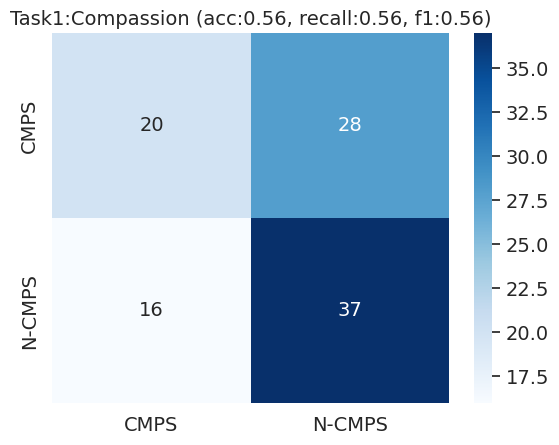

ROC-AUC for Task1:Compassion: 0.6073


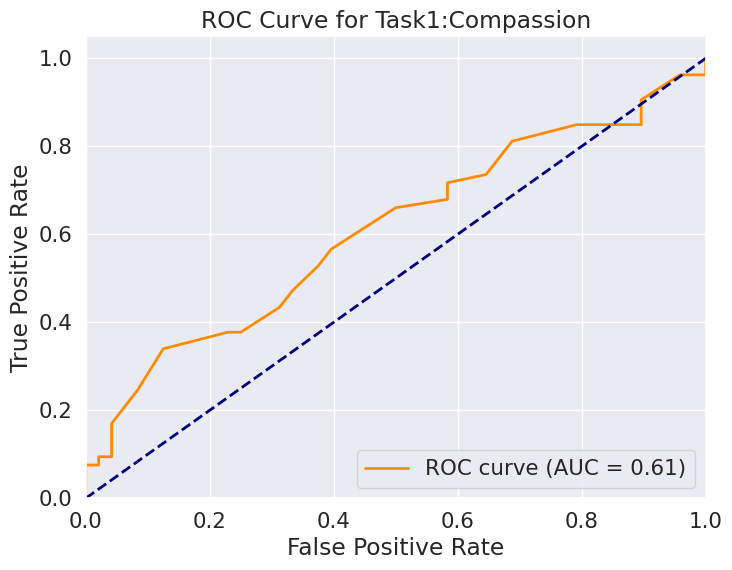

Top 5 Features by Mean Importance:['variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'max_acoustics-spectral_centroid_std', 'end_to_begin_anger', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean']


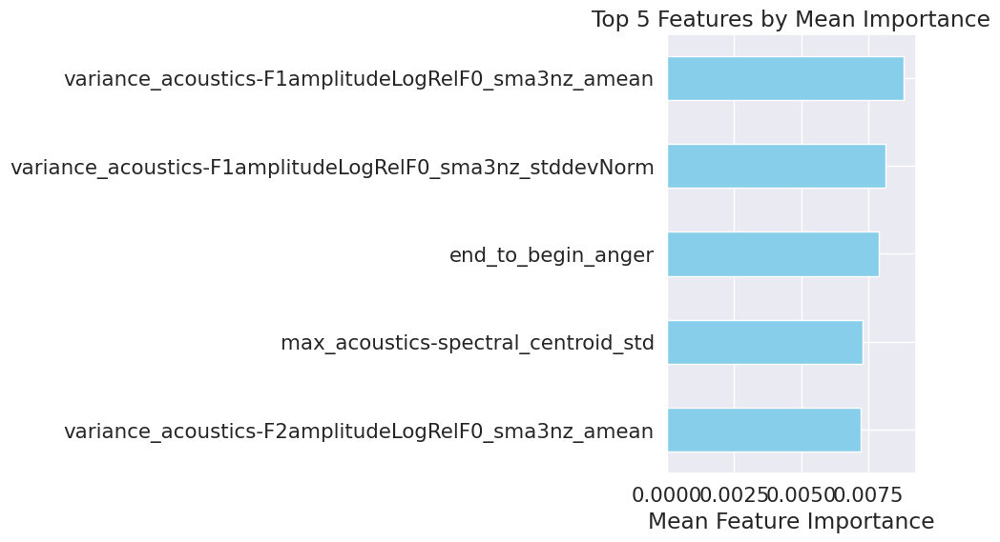

random_state:1
Total Accuracy: 0.45544554455445546
Total Recall: 0.45544554455445546
Total F1 Score: 0.4501115778744291


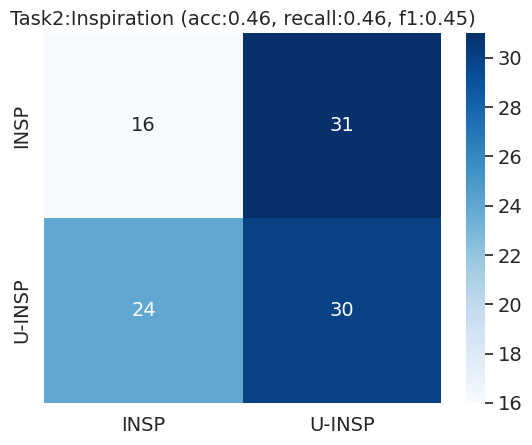

ROC-AUC for Task2:Inspiration: 0.4202


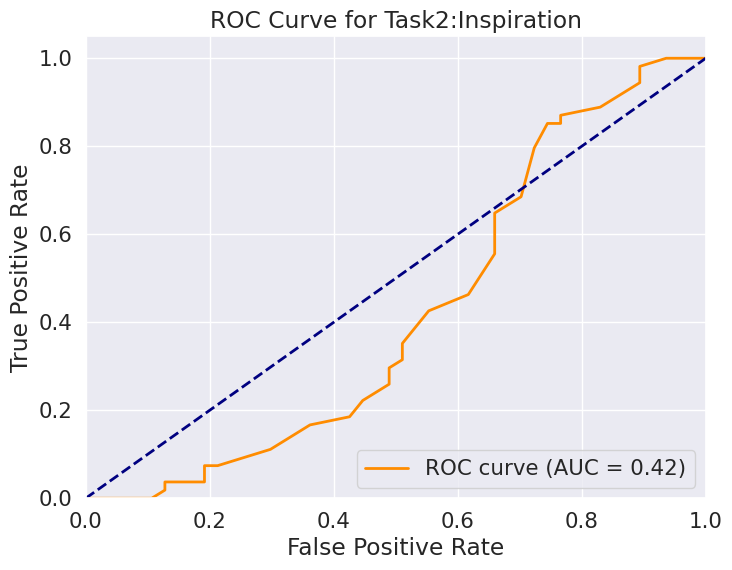

Top 5 Features by Mean Importance:['thermal-variance_thermal_feature_33', 'median_AU10', 'variance_acoustics-spectral_contrast_6_mu', 'max_happiness', 'max_speech_text-caring']


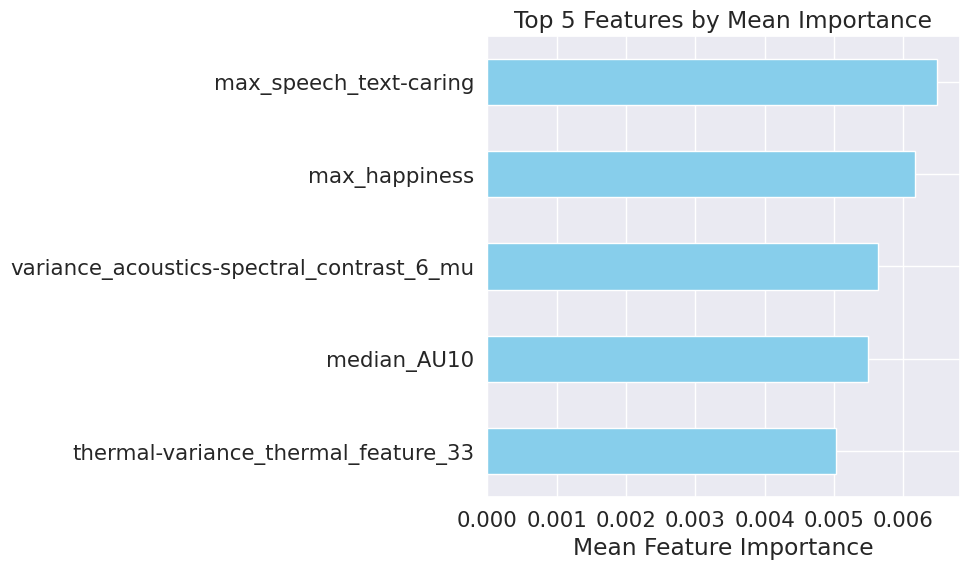

random_state:1
Total Accuracy: 0.297029702970297
Total Recall: 0.297029702970297
Total F1 Score: 0.2676926229208287


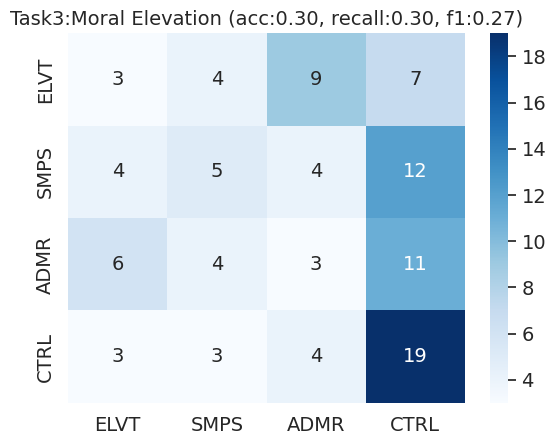

Top 5 Features by Mean Importance:['median_acoustics-F3frequency_sma3nz_amean', 'median_acoustics-tonnetz_3_std', 'max_speech_text-disapproval', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'max_speech_text-caring']


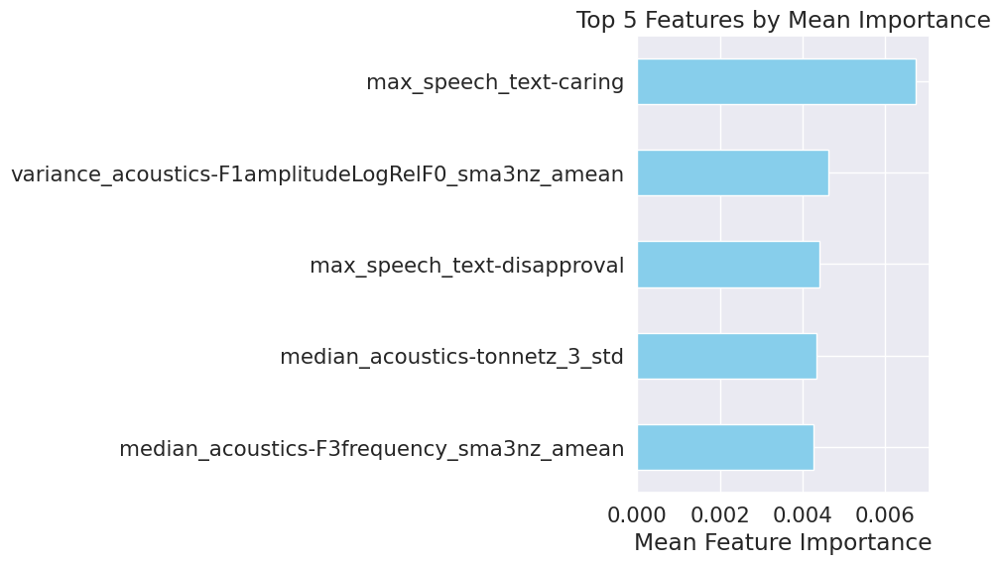

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3  df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653   
2            SVM      15                 False     False   0.574257   
3            SVM      15                 False     False   0.564356   

   Accuracy2  Accuracy3  
0   0.504950   0.297030  
1   0.524752   0.297030  
2   0.504950   0.356436  
3   0.455446   0.297030  
Processing combination: df_acoustics, df_speech_text, df_pose, df_eye_movement
=== Task: df_acoustics, df_speech_text,

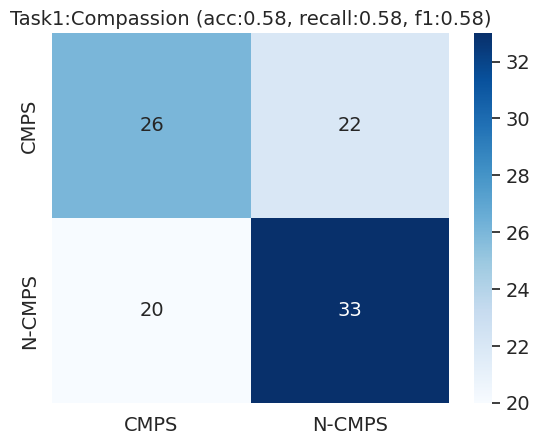

ROC-AUC for Task1:Compassion: 0.6038


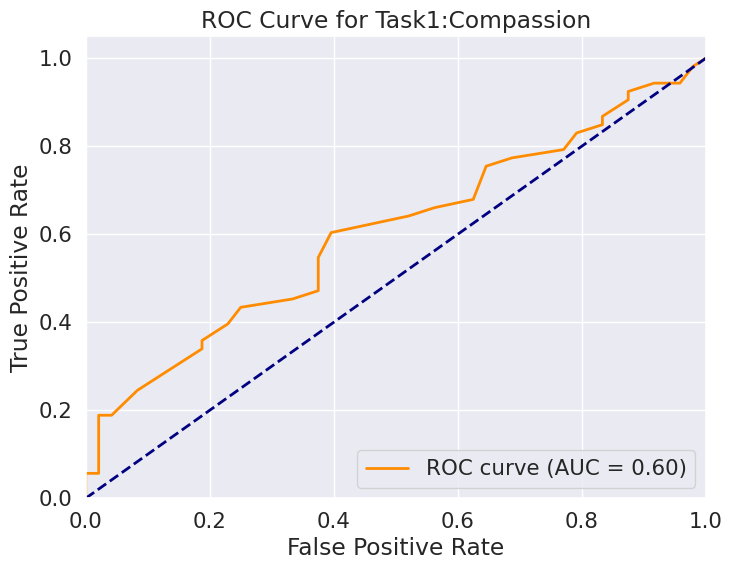

Top 5 Features by Mean Importance:['variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'max_speech_text-caring', 'median_speech_text-grief', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_stddevNorm']


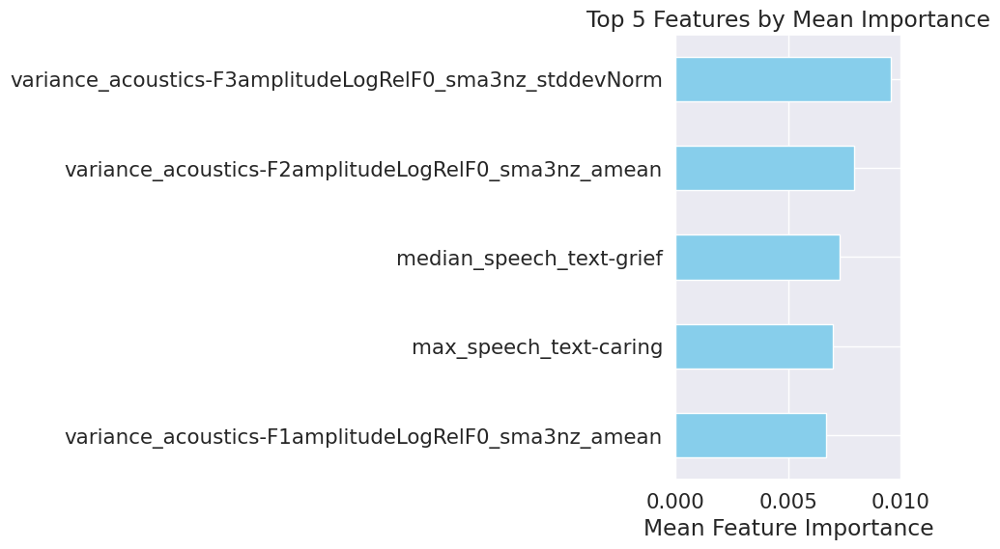

random_state:1
Total Accuracy: 0.49504950495049505
Total Recall: 0.49504950495049505
Total F1 Score: 0.49203697340997893


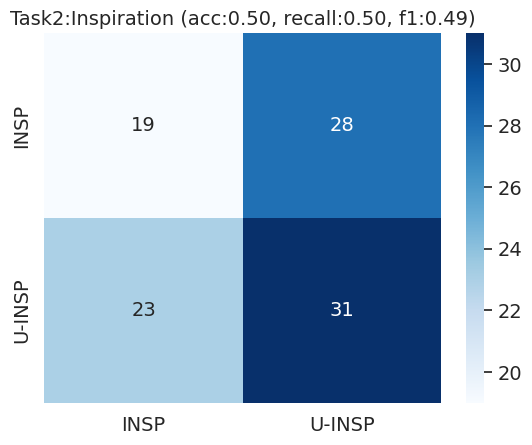

ROC-AUC for Task2:Inspiration: 0.4870


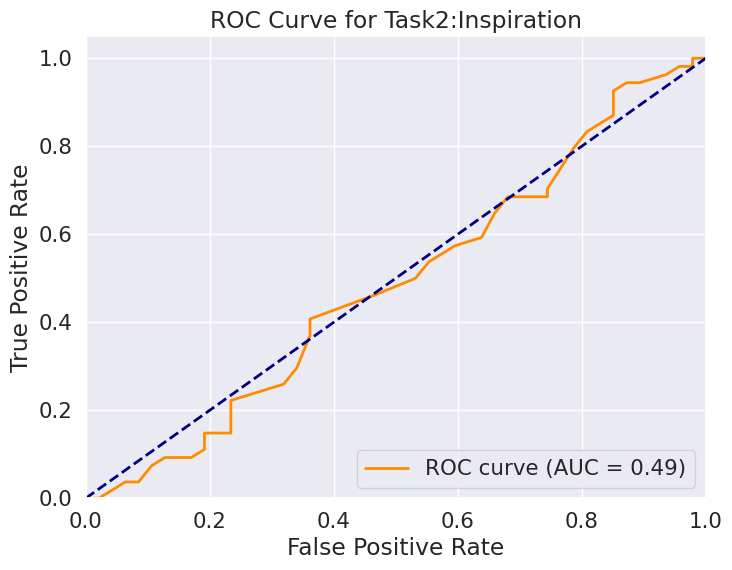

Top 5 Features by Mean Importance:['max_acoustics-hammarbergIndexV_sma3nz_amean', 'median_acoustics-spectralFluxV_sma3nz_stddevNorm', 'variance_acoustics-spectralFluxUV_sma3nz_amean', 'variance_acoustics-tonnetz_4_std', 'variance_acoustics-spectral_contrast_5_mu']


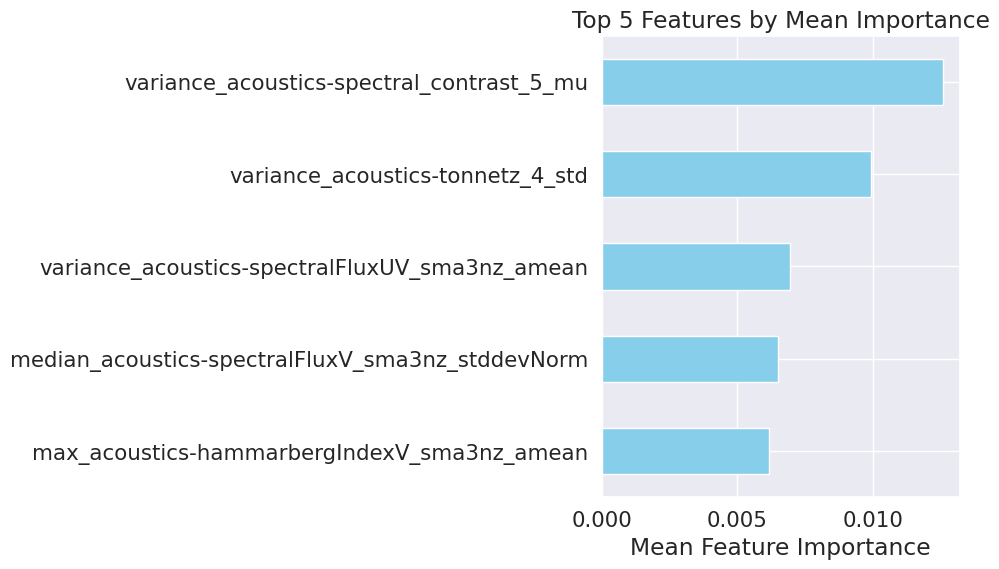

random_state:1
Total Accuracy: 0.36633663366336633
Total Recall: 0.36633663366336633
Total F1 Score: 0.3505173821633945


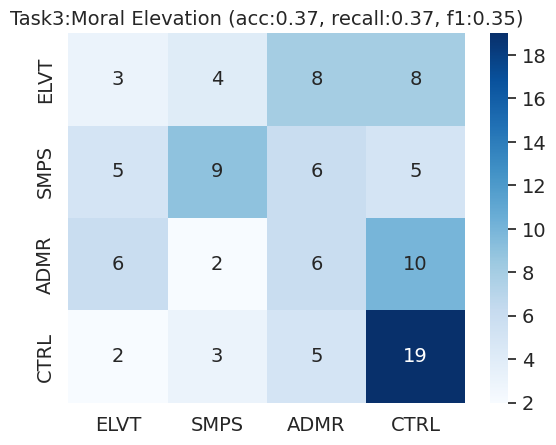

Top 5 Features by Mean Importance:['pose-mean_shoulder_to_shoulder_difference_x', 'variance_speech_text-caring', 'variance_speech_text-disapproval', 'pose-mean_ear_to_ear_difference_x', 'max_speech_text-caring']


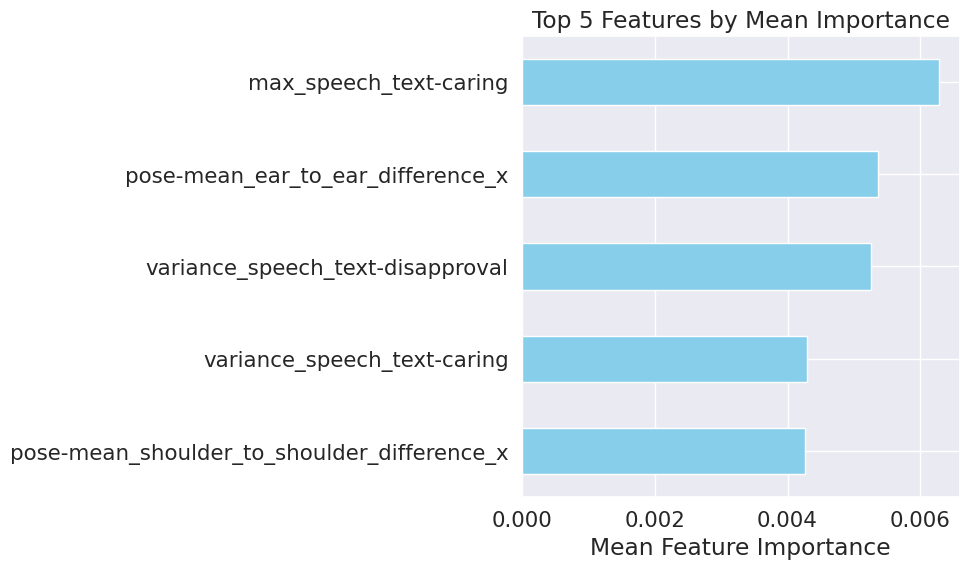

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3  df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4  df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653   
2            SVM      15                 False     False   0.574257   
3            SVM      15                 False     False   0.564356   
4            SVM      15                 False     False   0.584158   

   Accuracy2  Accuracy3  
0   0.504950   0.297030  
1   0.524752   0.297030  
2   0.504950   0.356

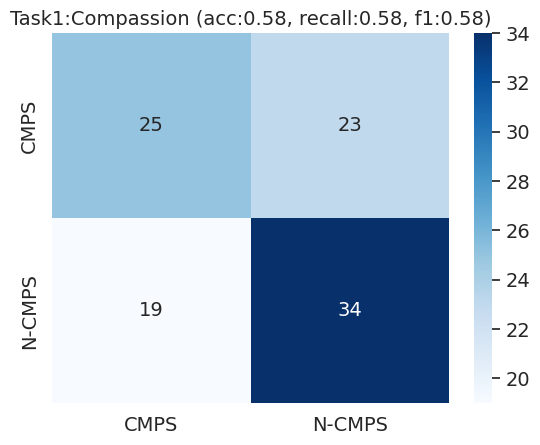

ROC-AUC for Task1:Compassion: 0.6384


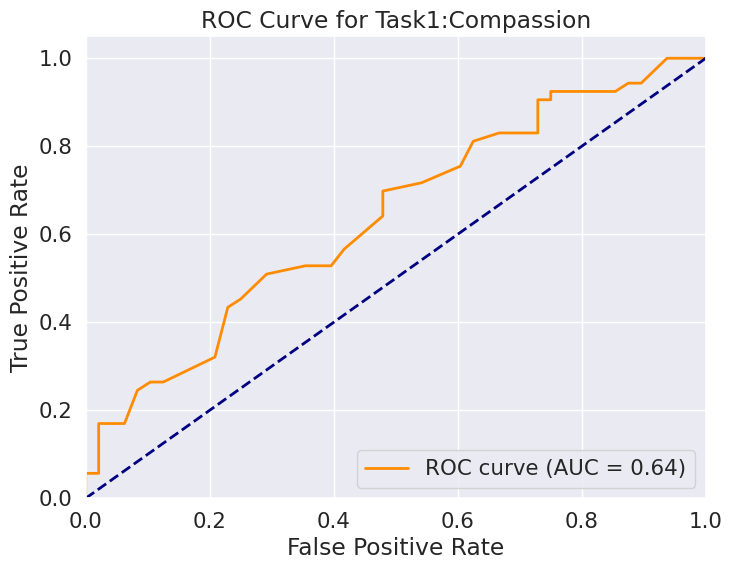

Top 5 Features by Mean Importance:['variance_speech_text-caring', 'max_acoustics-spectral_centroid_std', 'max_speech_text-caring', 'variance_speech_text-grief', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean']


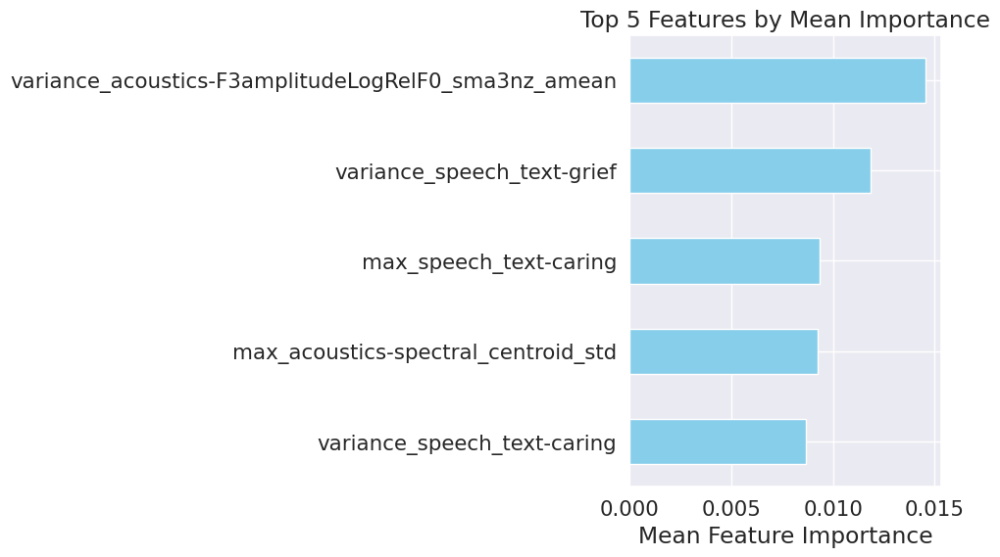

random_state:1
Total Accuracy: 0.4752475247524752
Total Recall: 0.4752475247524752
Total F1 Score: 0.47368900834247374


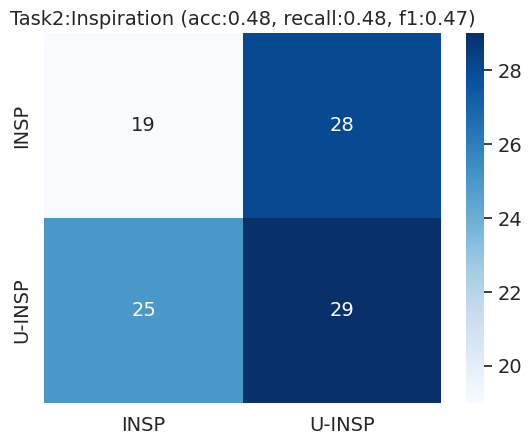

ROC-AUC for Task2:Inspiration: 0.4261


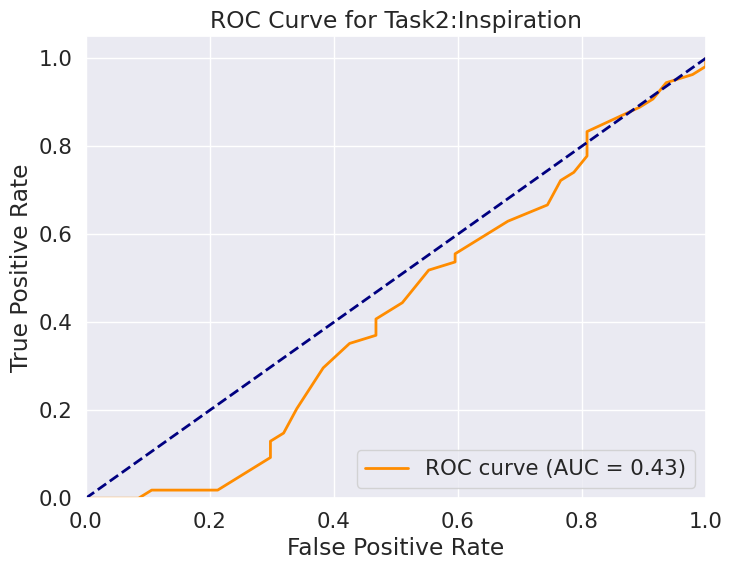

Top 5 Features by Mean Importance:['variance_speech_text-embarrassment', 'variance_acoustics-chroma_3_mu', 'variance_acoustics-chroma_2_mu', 'max_speech_text-annoyance', 'median_speech_text-surprise']


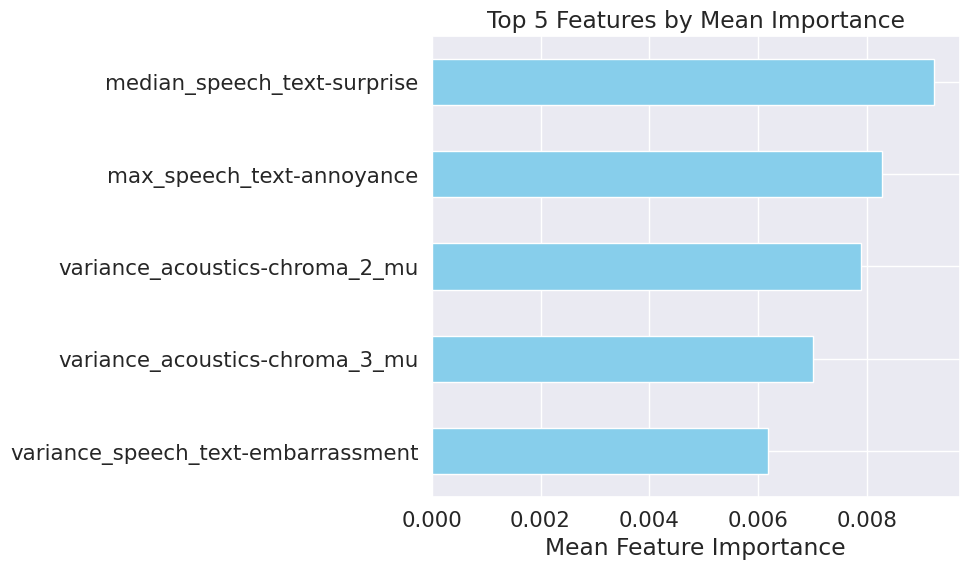

random_state:1
error for: df_acoustics, df_speech_text, df_pose, df_remote_ppg
Processing combination: df_acoustics, df_speech_text, df_pose, df_thermal
=== Task: df_acoustics, df_speech_text, df_pose, df_thermal, Model: Random Forest, RFE Model: SVM, n_kept: 15, ANOVA: False, RFE: False, Grid Search: False ===
random_state:1
Total Accuracy: 0.5445544554455446
Total Recall: 0.5445544554455446
Total F1 Score: 0.5415723715228665


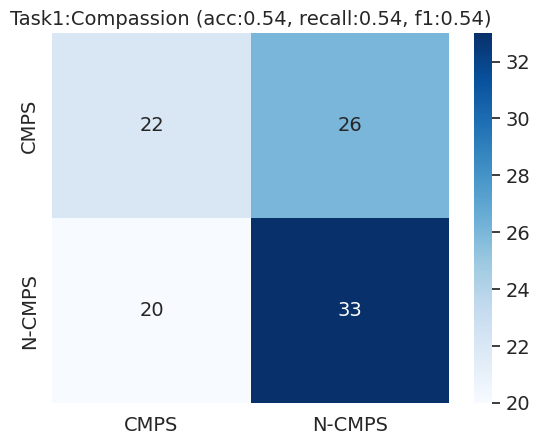

ROC-AUC for Task1:Compassion: 0.5658


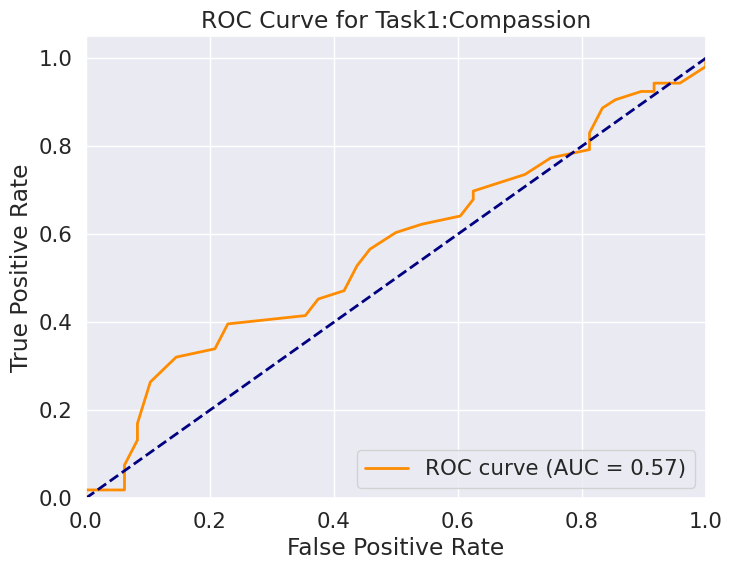

Top 5 Features by Mean Importance:['variance_speech_text-grief', 'max_speech_text-grief', 'max_acoustics-spectral_centroid_std', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_stddevNorm']


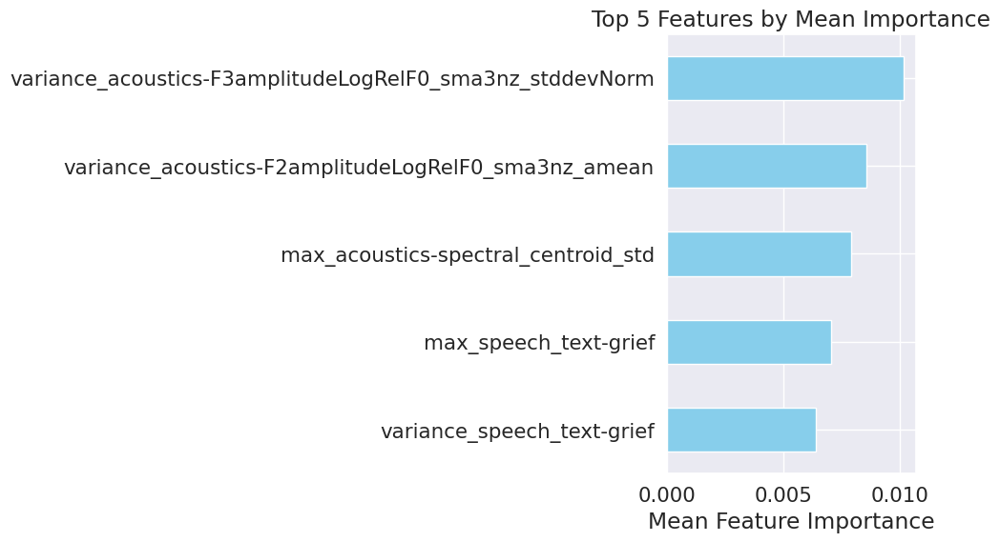

random_state:1
Total Accuracy: 0.48514851485148514
Total Recall: 0.48514851485148514
Total F1 Score: 0.4811454829693496


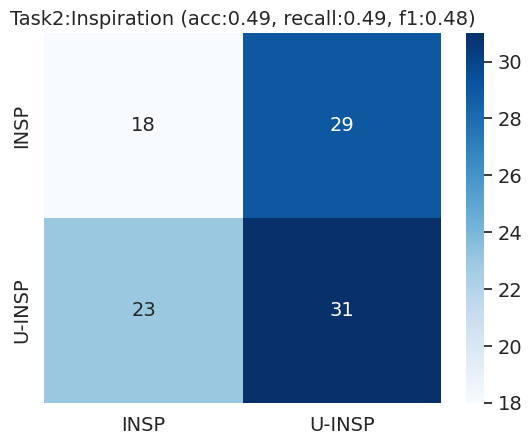

ROC-AUC for Task2:Inspiration: 0.4671


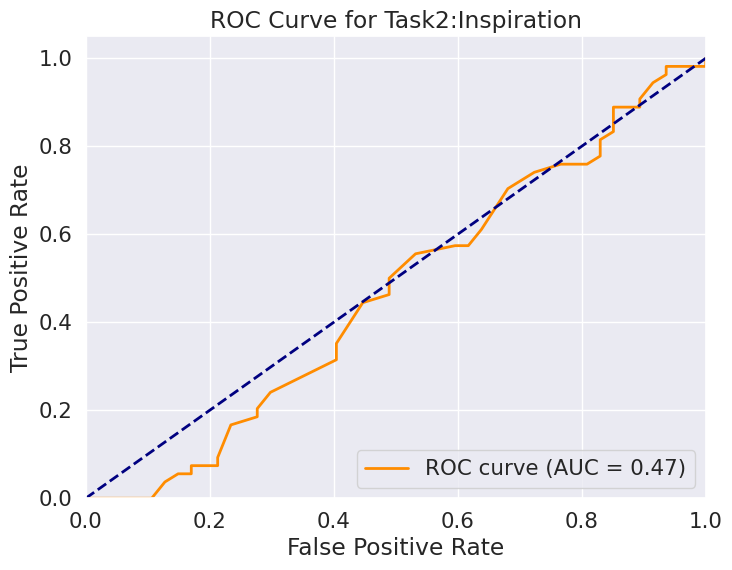

Top 5 Features by Mean Importance:['variance_acoustics-spectralFlux_sma3_amean', 'max_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'variance_acoustics-spectral_contrast_5_mu', 'variance_acoustics-mfcc_12_mu', 'median_speech_text-surprise']


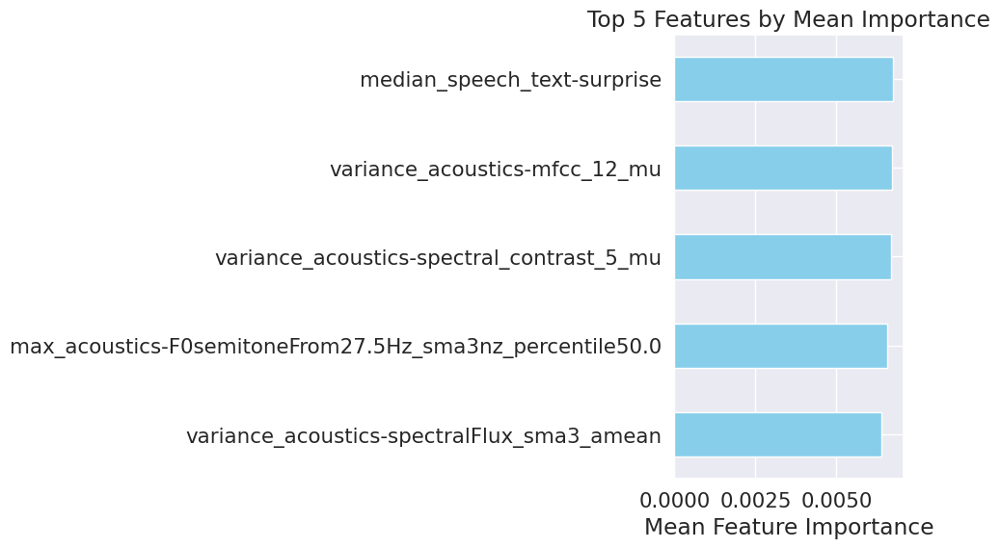

random_state:1
Total Accuracy: 0.27722772277227725
Total Recall: 0.27722772277227725
Total F1 Score: 0.2597428661785097


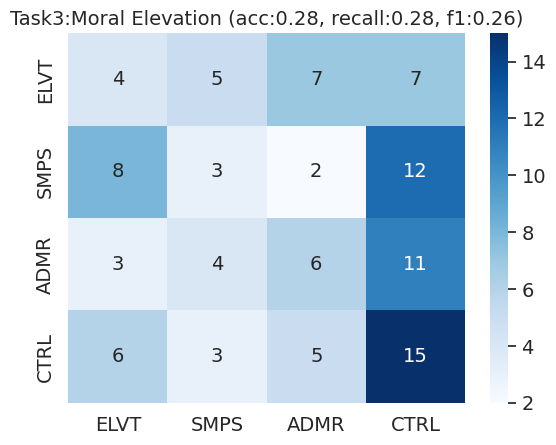

Top 5 Features by Mean Importance:['max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-spectralFlux_sma3_amean', 'max_speech_text-caring', 'max_speech_text-disapproval', 'variance_speech_text-caring']


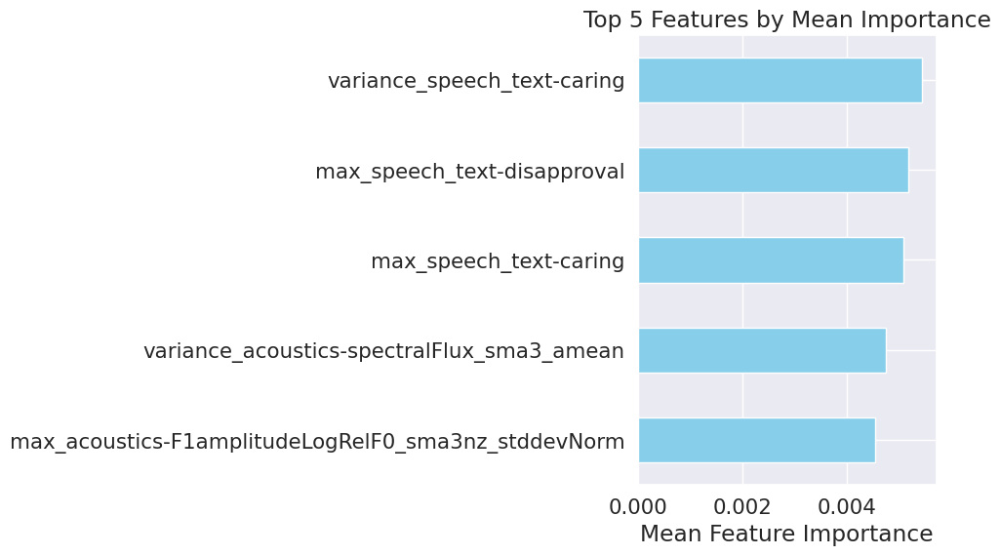

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3  df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4  df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5  df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653   
2            SVM      15                 False     False   0.574257   
3            SVM      15                 False     False   0.564356   
4            SVM      15                 False     False   0.584158   
5            SVM    

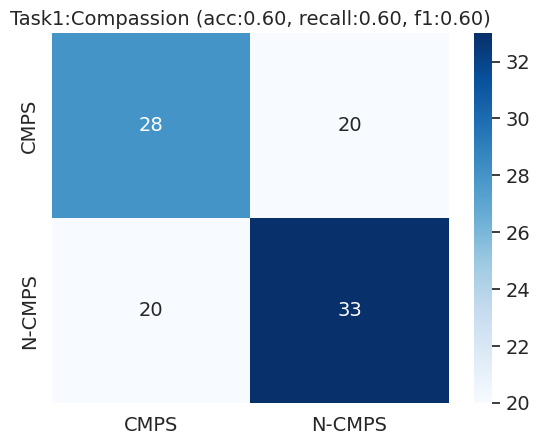

ROC-AUC for Task1:Compassion: 0.6633


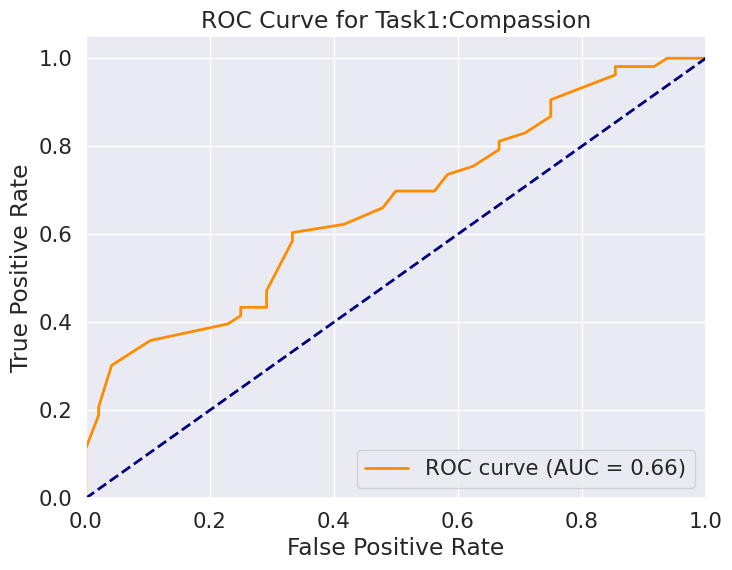

Top 5 Features by Mean Importance:['variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'max_speech_text-grief', 'median_acoustics-chroma_7_std', 'max_acoustics-spectral_centroid_std', 'variance_speech_text-grief']


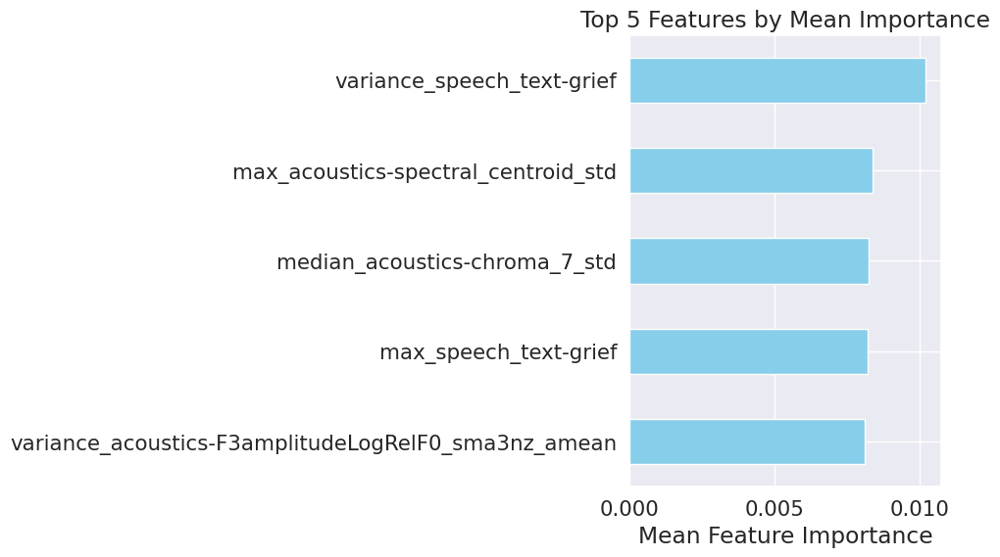

random_state:1
Total Accuracy: 0.5544554455445545
Total Recall: 0.5544554455445545
Total F1 Score: 0.5455238041775221


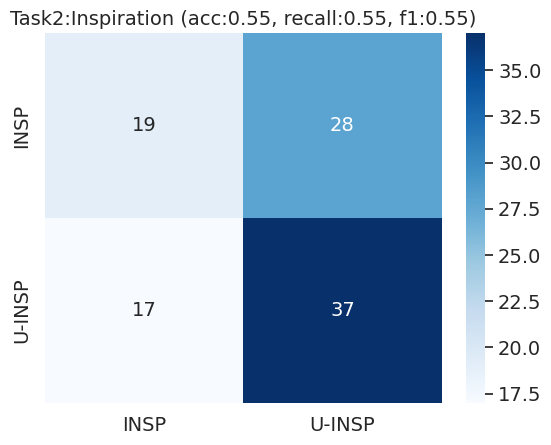

ROC-AUC for Task2:Inspiration: 0.5053


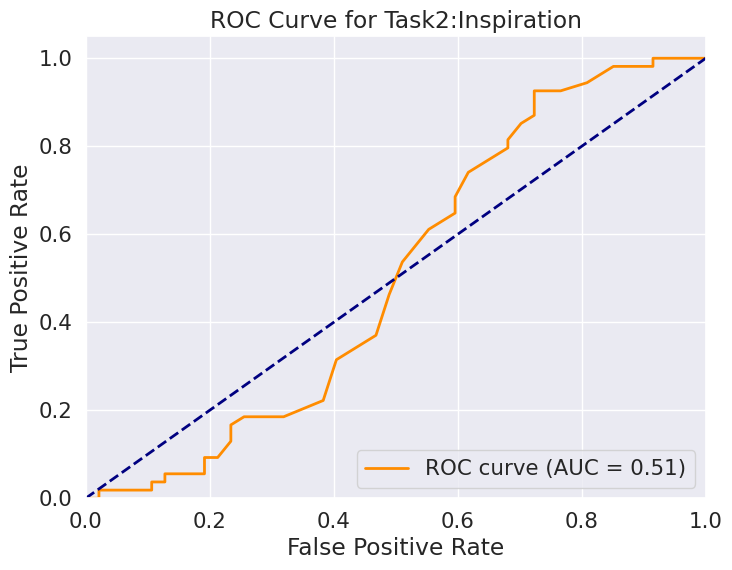

Top 5 Features by Mean Importance:['max_speech_text-optimism', 'variance_acoustics-tonnetz_4_std', 'max_acoustics-hammarbergIndexV_sma3nz_amean', 'variance_acoustics-spectral_contrast_5_mu', 'max_acoustics-spectral_contrast_3_std']


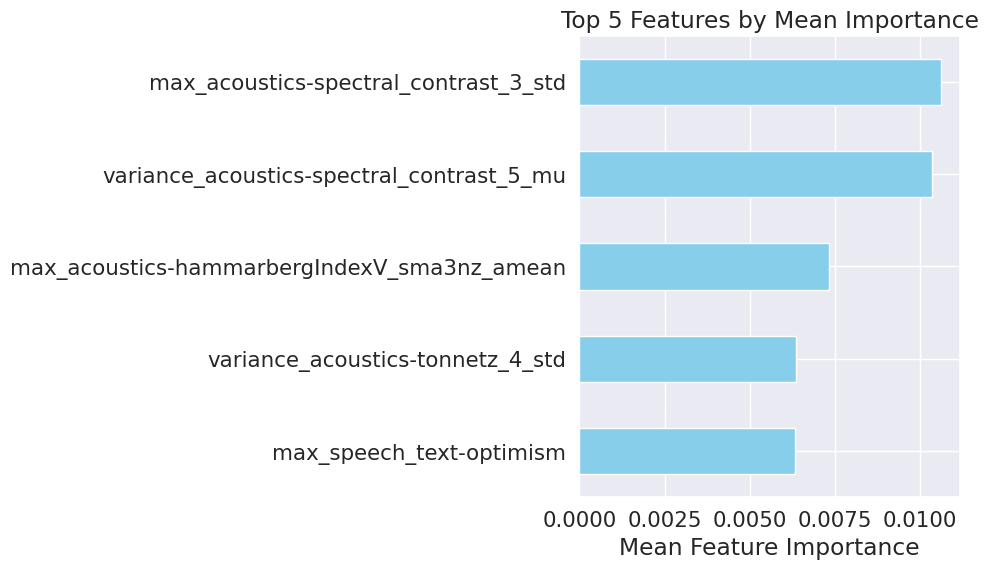

random_state:1
Total Accuracy: 0.32673267326732675
Total Recall: 0.32673267326732675
Total F1 Score: 0.30411244888809663


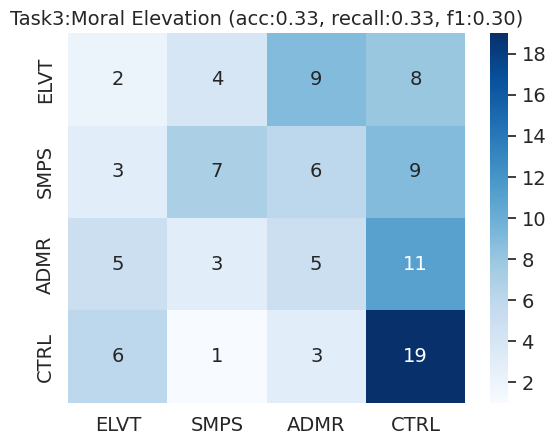

Top 5 Features by Mean Importance:['max_speech_text-caring', 'max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_speech_text-caring', 'median_acoustics-F3frequency_sma3nz_amean', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_amean']


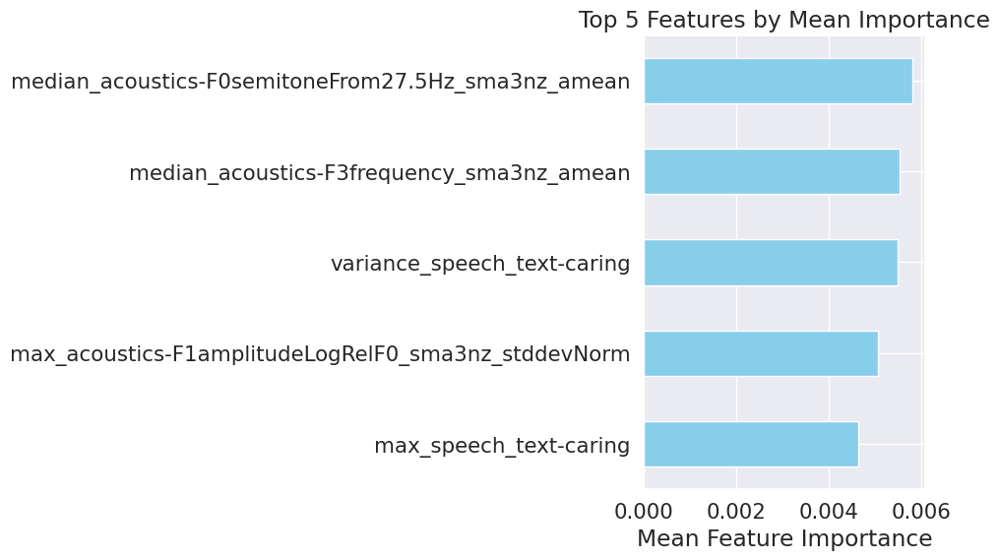

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3  df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4  df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5  df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6  df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653   
2            SVM      15                 False     False   0.574257   
3            SVM      15                 False     False   0.564356   
4           

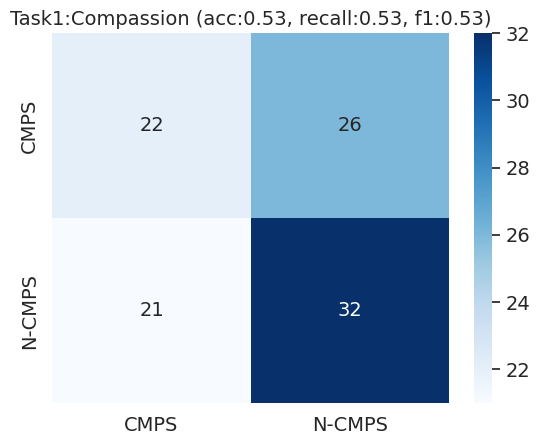

ROC-AUC for Task1:Compassion: 0.5987


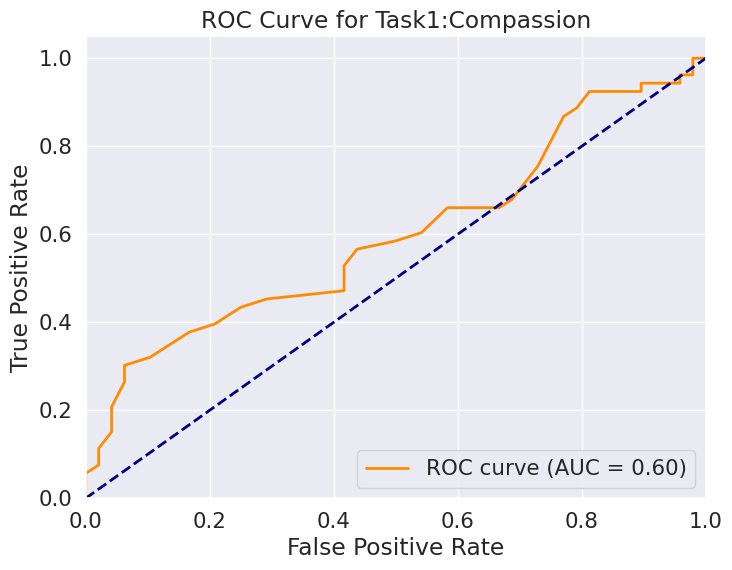

Top 5 Features by Mean Importance:['variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'thermal-end_to_begin_thermal_feature_5', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'max_acoustics-spectral_centroid_std', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean']


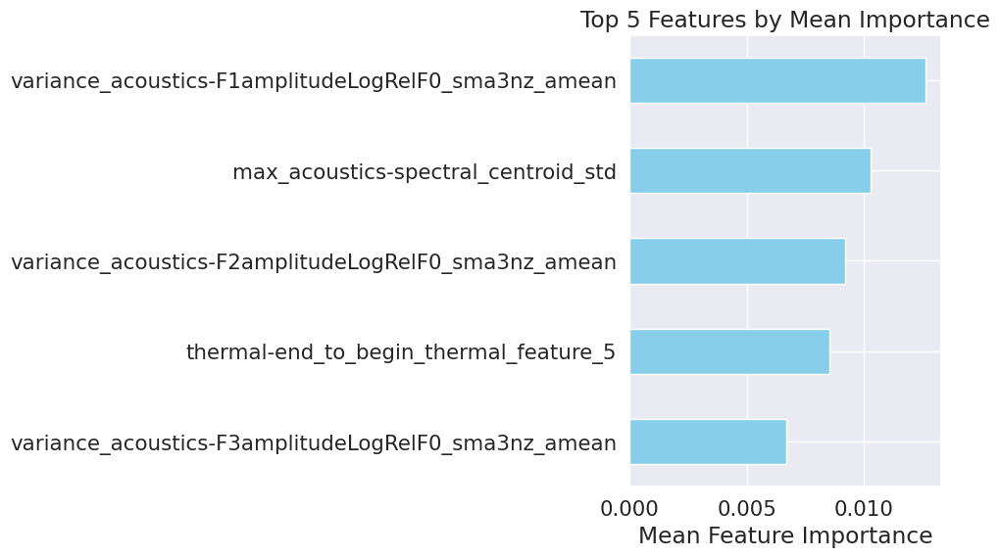

random_state:1
Total Accuracy: 0.5148514851485149
Total Recall: 0.5148514851485149
Total F1 Score: 0.5134105926185134


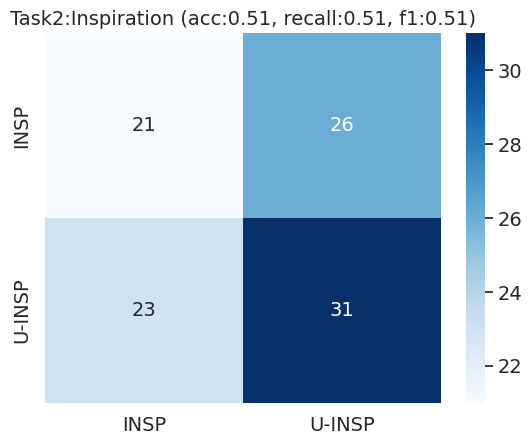

ROC-AUC for Task2:Inspiration: 0.4817


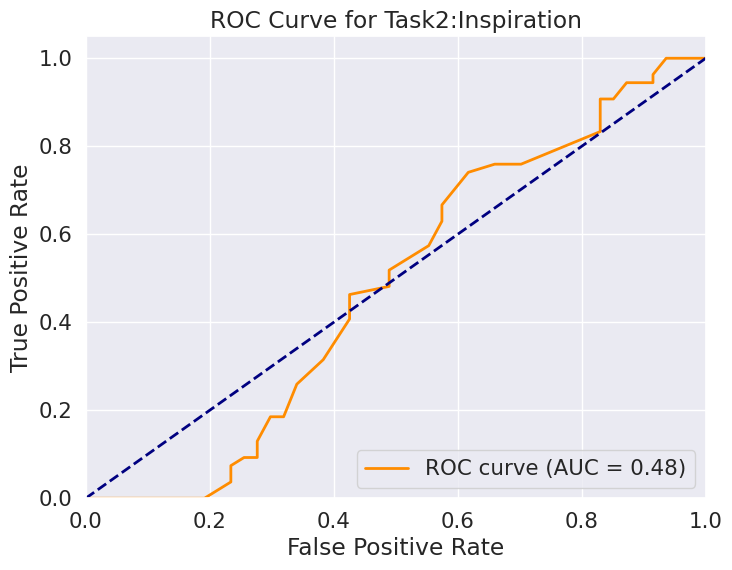

Top 5 Features by Mean Importance:['variance_acoustics-mfcc_12_mu', 'max_acoustics-loudness_sma3_stddevRisingSlope', 'max_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'variance_acoustics-loudness_sma3_pctlrange0-2', 'variance_acoustics-tonnetz_4_std']


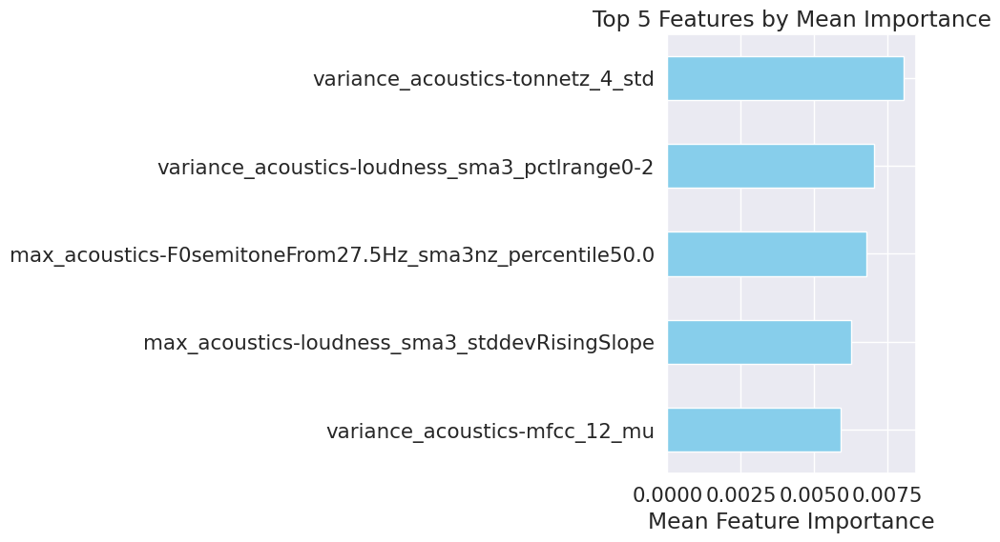

random_state:1
Total Accuracy: 0.26732673267326734
Total Recall: 0.26732673267326734
Total F1 Score: 0.24551789680247388


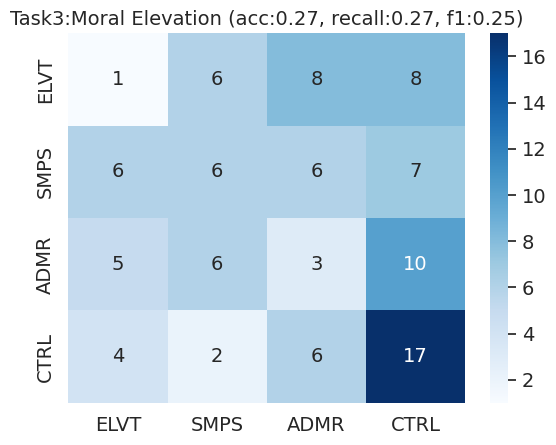

Top 5 Features by Mean Importance:['max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'max_speech_text-caring', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_amean', 'variance_speech_text-caring', 'max_speech_text-disapproval']


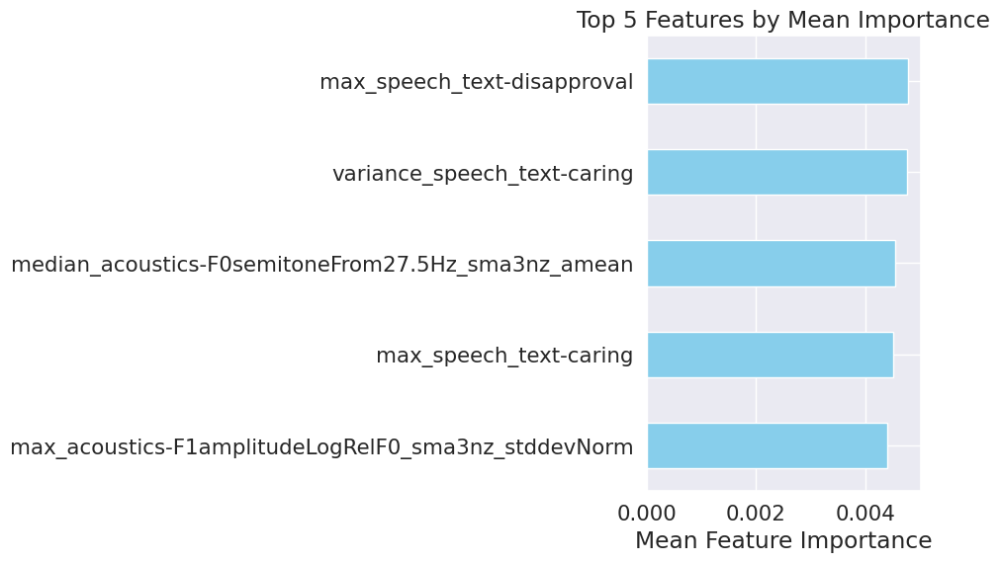

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3  df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4  df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5  df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6  df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7  df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653   
2            SVM      15                 False     False   0.574257   
3   

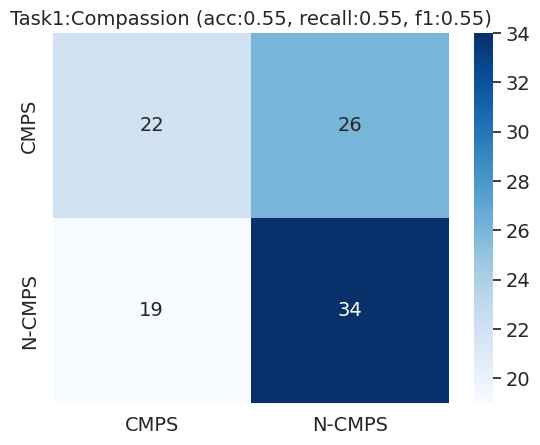

ROC-AUC for Task1:Compassion: 0.5881


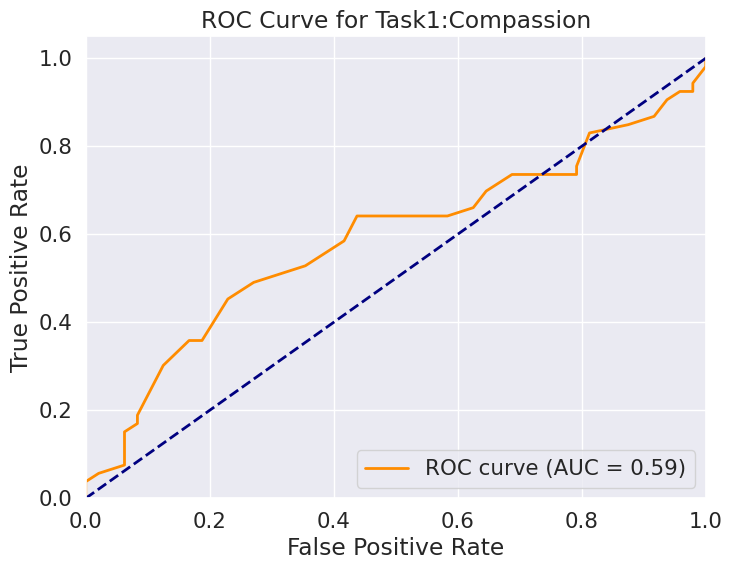

Top 5 Features by Mean Importance:['max_speech_text-sadness', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'max_acoustics-spectral_centroid_std', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean']


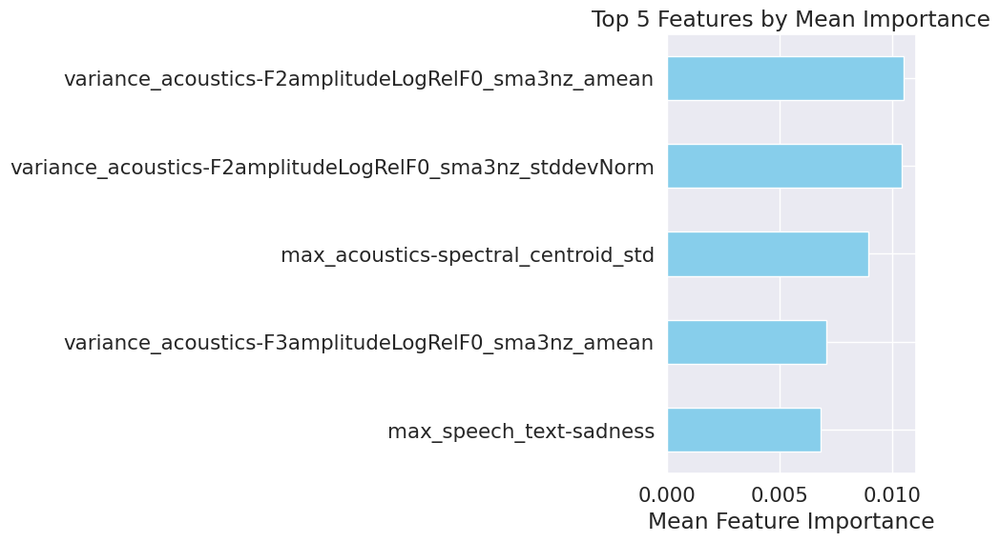

random_state:1
Total Accuracy: 0.5544554455445545
Total Recall: 0.5544554455445545
Total F1 Score: 0.5500912909881693


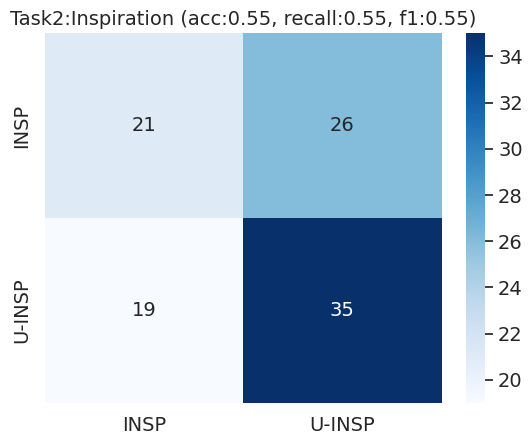

ROC-AUC for Task2:Inspiration: 0.5140


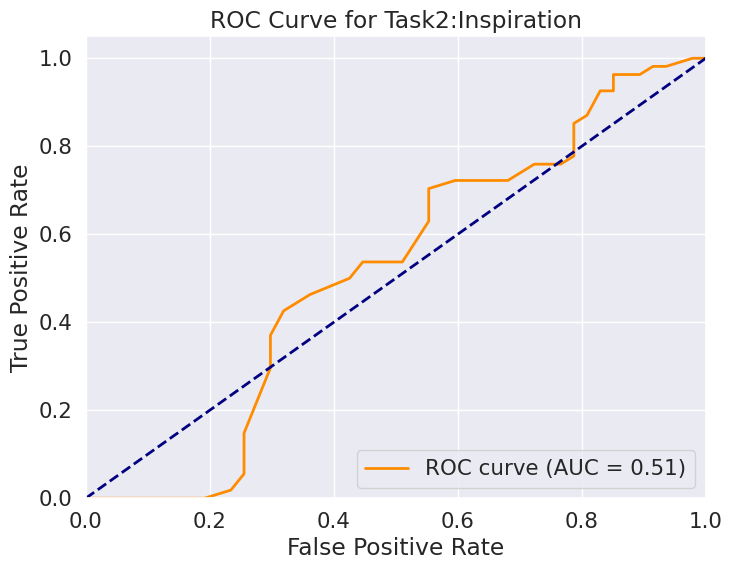

Top 5 Features by Mean Importance:['variance_acoustics-tonnetz_4_std', 'variance_acoustics-loudness_sma3_stddevRisingSlope', 'variance_acoustics-chroma_3_mu', 'thermal-variance_thermal_feature_21', 'max_speech_text-annoyance']


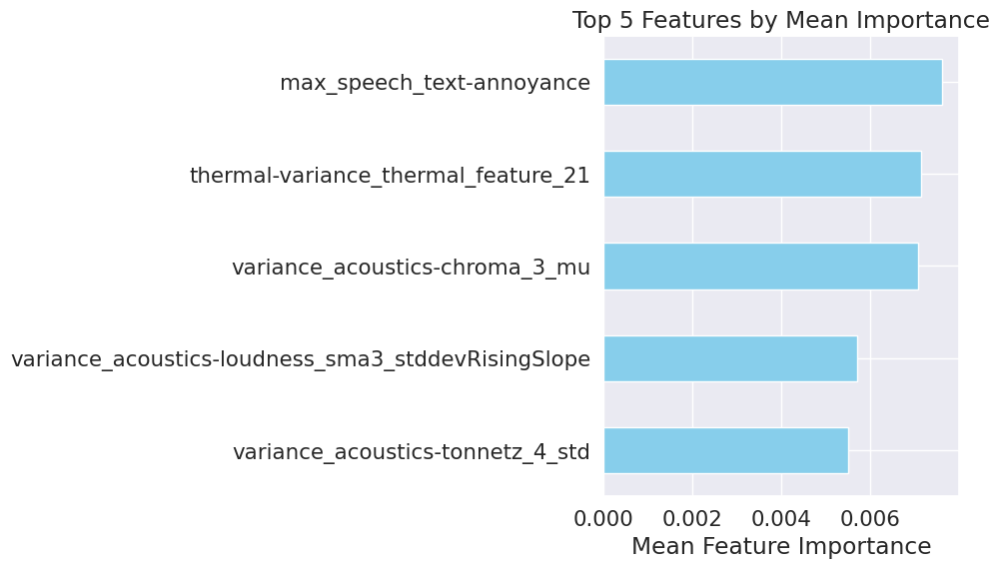

random_state:1
Total Accuracy: 0.2871287128712871
Total Recall: 0.2871287128712871
Total F1 Score: 0.2676418192614855


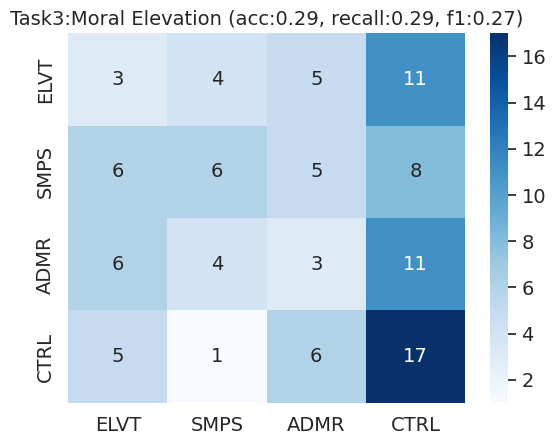

Top 5 Features by Mean Importance:['variance_acoustics-loudness_sma3_pctlrange0-2', 'max_speech_text-caring', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-chroma_3_mu', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope']


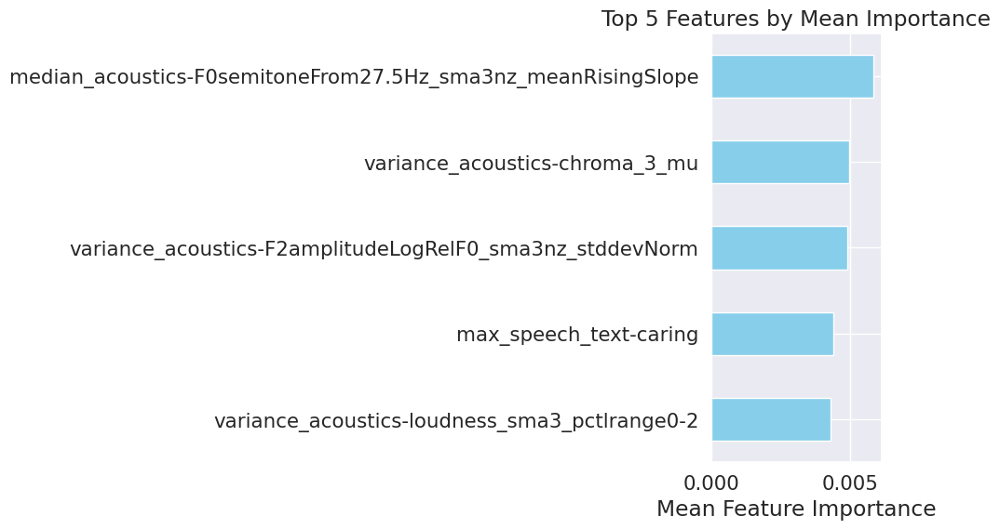

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3  df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4  df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5  df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6  df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7  df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8  df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   0.613861   
1            SVM      15                 False     False   0.534653

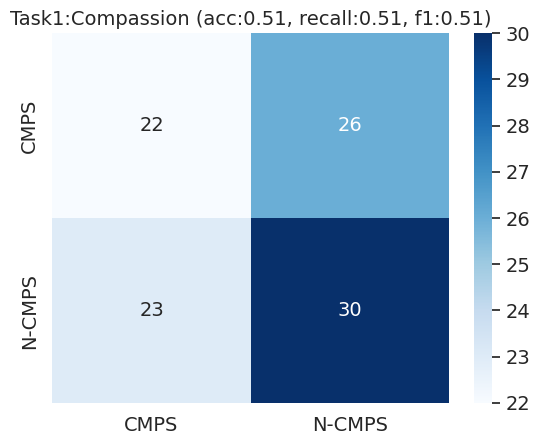

ROC-AUC for Task1:Compassion: 0.5254


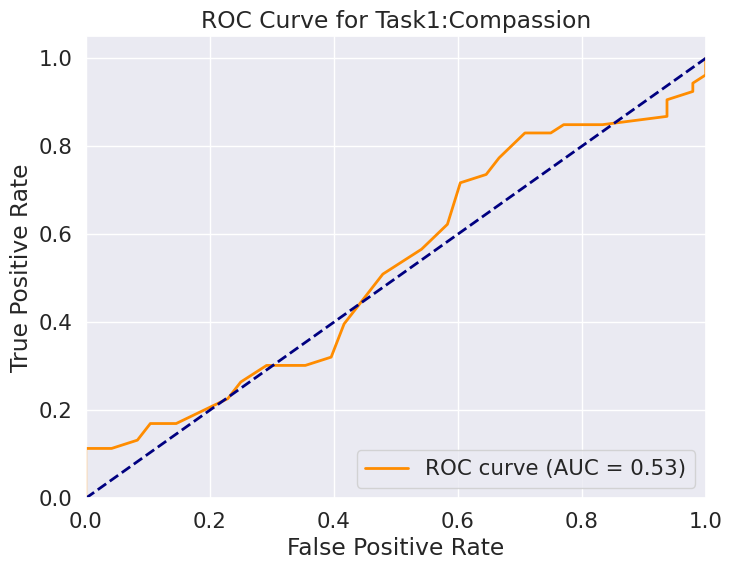

Top 5 Features by Mean Importance:['variance_acoustics-mfcc1_sma3_amean', 'pose-end_to_begin_ear_to_ear_difference_y', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'median_eye_move-max_left_iris_relative_y', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean']


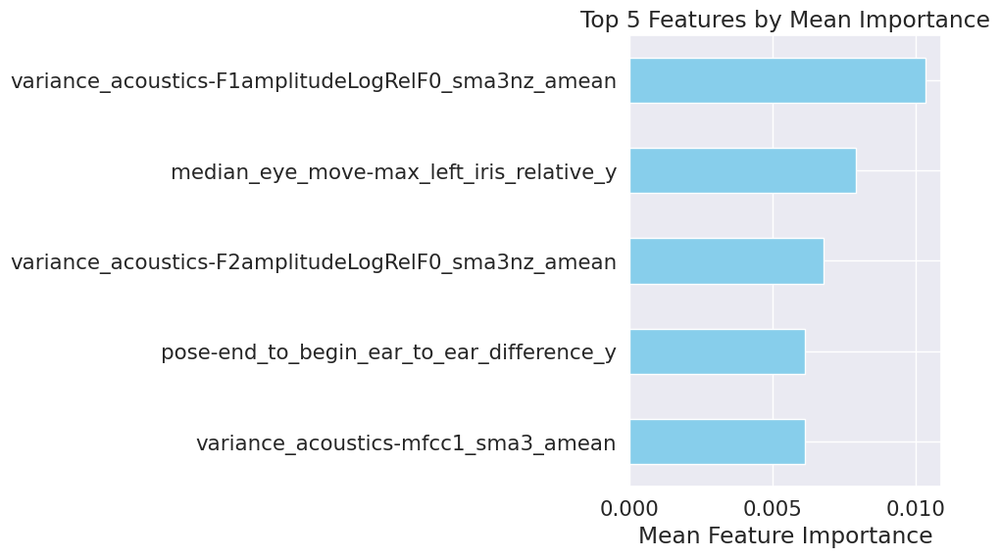

random_state:1
Total Accuracy: 0.4752475247524752
Total Recall: 0.4752475247524752
Total F1 Score: 0.47010752049717713


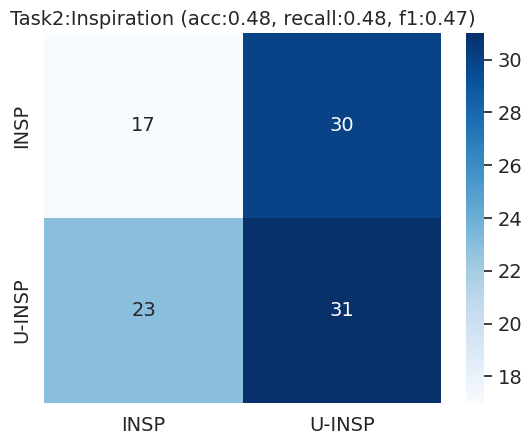

ROC-AUC for Task2:Inspiration: 0.4517


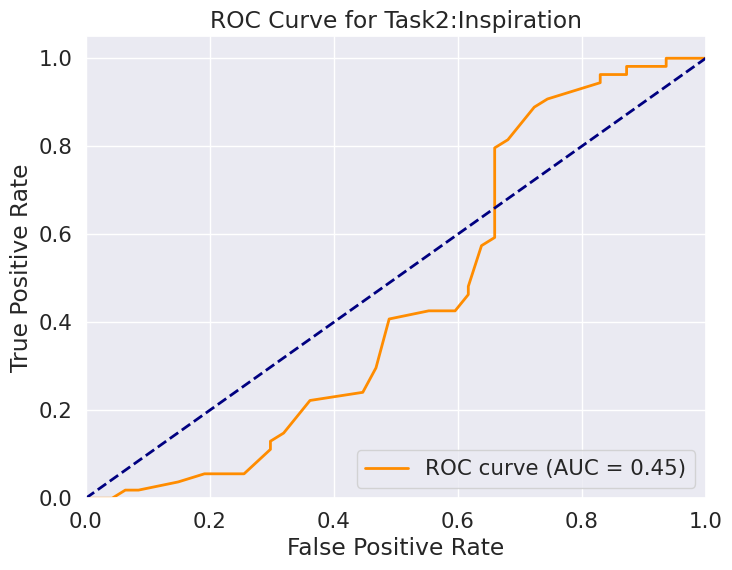

Top 5 Features by Mean Importance:['variance_happiness', 'variance_AU10', 'median_acoustics-alphaRatioUV_sma3nz_amean', 'variance_acoustics-tonnetz_4_std', 'variance_acoustics-spectralFlux_sma3_stddevNorm']


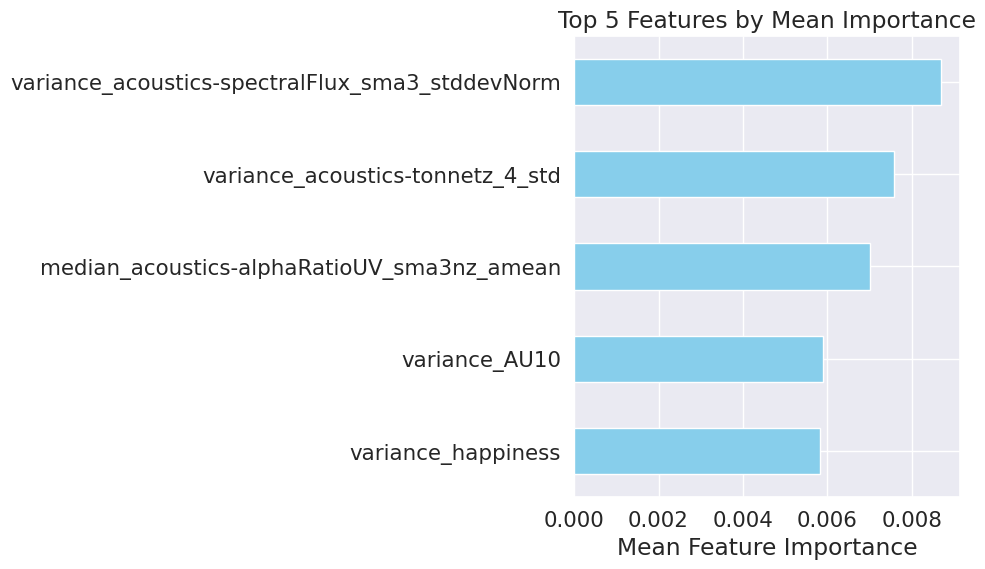

random_state:1
Total Accuracy: 0.26732673267326734
Total Recall: 0.26732673267326734
Total F1 Score: 0.2585695019430752


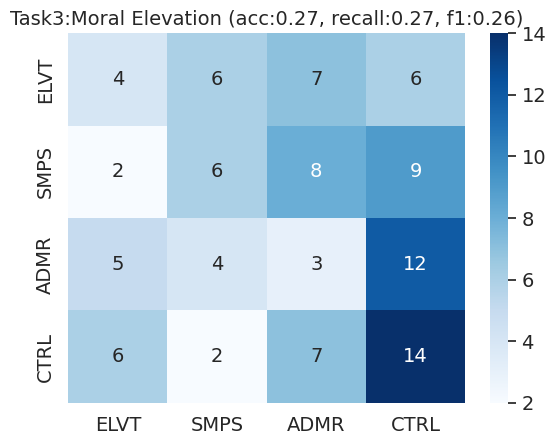

Top 5 Features by Mean Importance:['max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'median_eye_move-variance_left_iris_relative_y', 'variance_acoustics-chroma_3_mu', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'median_acoustics-tonnetz_3_std']


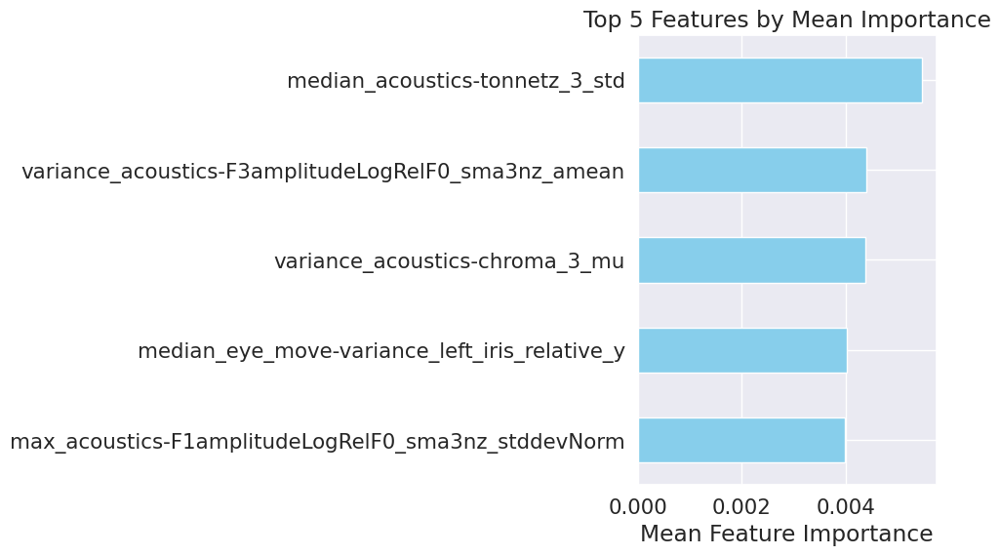

                                             df_name     model_name  do_rfe  \
0   df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1  df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2  df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3  df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4  df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5  df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6  df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7  df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8  df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9  df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   

  rfe_model_name  n_kept  do_model_grid_search  do_anova  Accuracy1  \
0            SVM      15                 False     False   

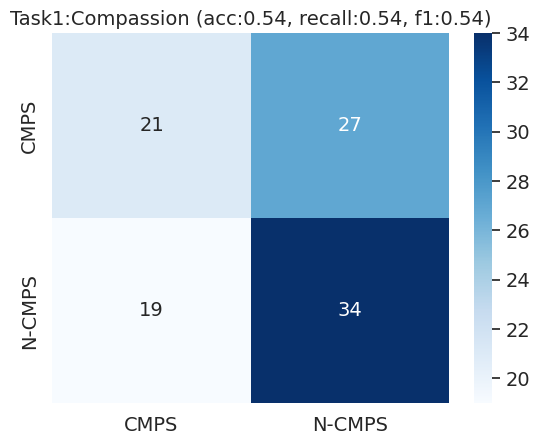

ROC-AUC for Task1:Compassion: 0.5316


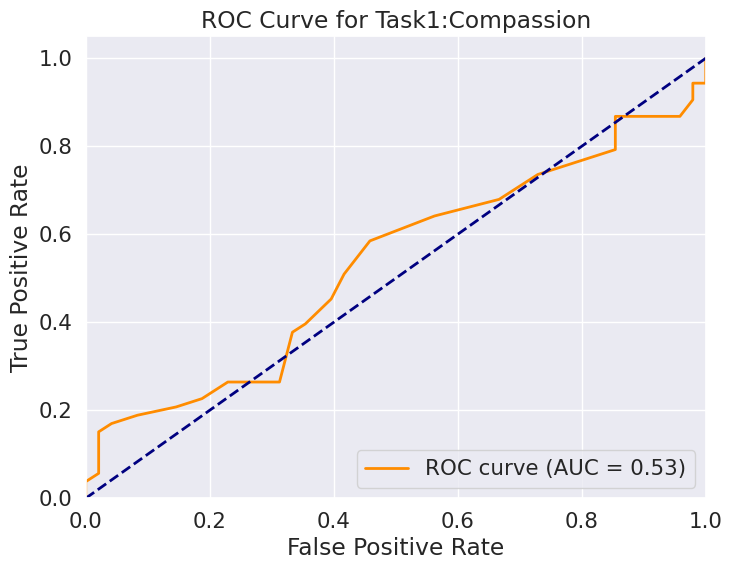

Top 5 Features by Mean Importance:['median_acoustics-mfcc_3_mu', 'max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'pose-end_to_begin_ear_to_ear_difference_y', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean']


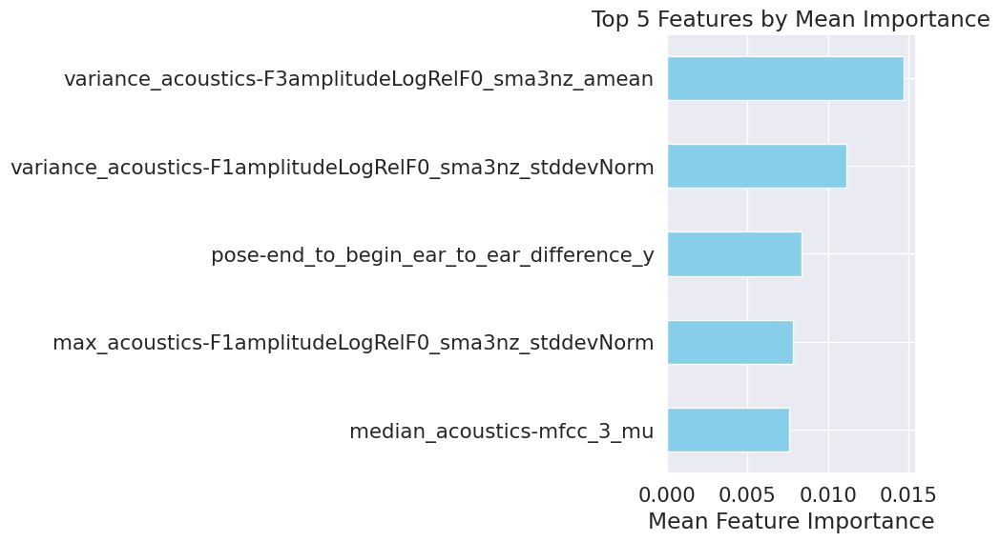

random_state:1
Total Accuracy: 0.48514851485148514
Total Recall: 0.48514851485148514
Total F1 Score: 0.4789554336347829


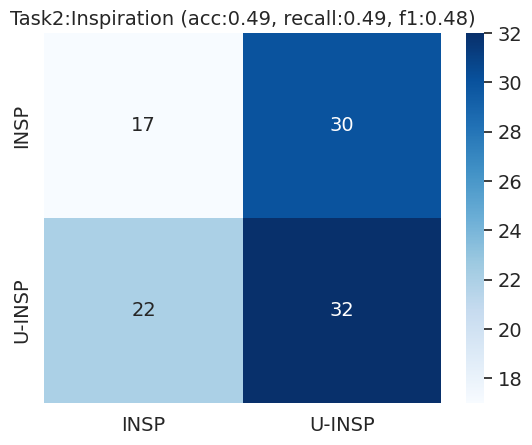

ROC-AUC for Task2:Inspiration: 0.4504


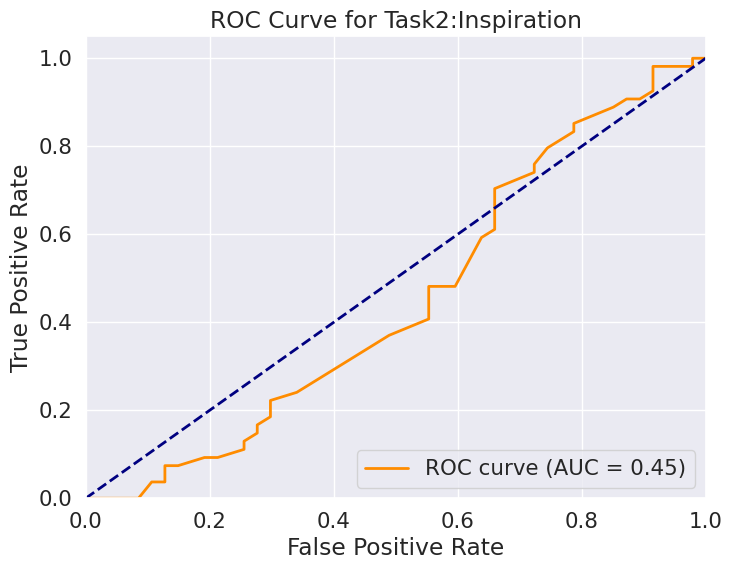

Top 5 Features by Mean Importance:['variance_acoustics-tonnetz_4_std', 'end_to_begin_FaceScore', 'pose-mean_nose_to_lip_difference_y', 'variance_happiness', 'median_acoustics-alphaRatioUV_sma3nz_amean']


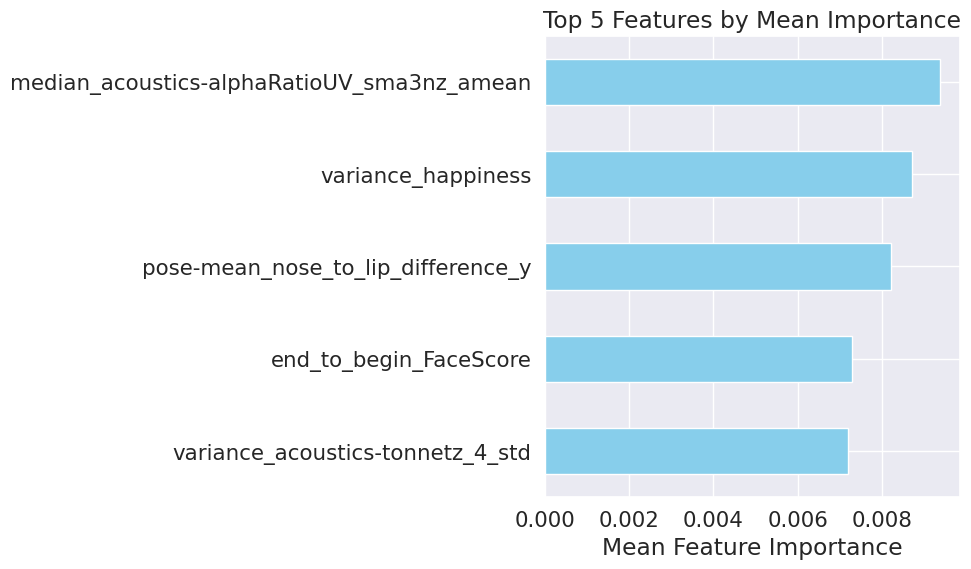

random_state:1
Total Accuracy: 0.26732673267326734
Total Recall: 0.26732673267326734
Total F1 Score: 0.2513961286238514


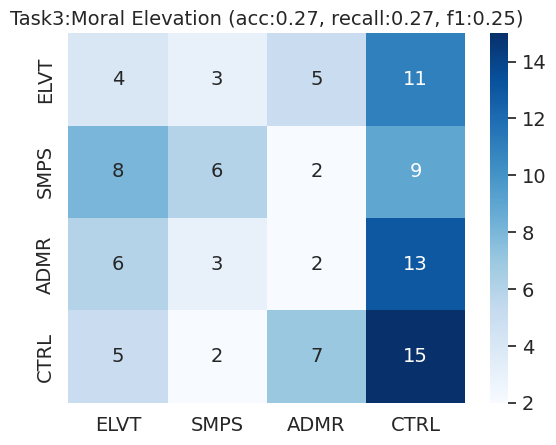

Top 5 Features by Mean Importance:['pose-mean_ear_to_ear_difference_x', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_amean', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'pose-mean_nose_to_lip_difference_y']


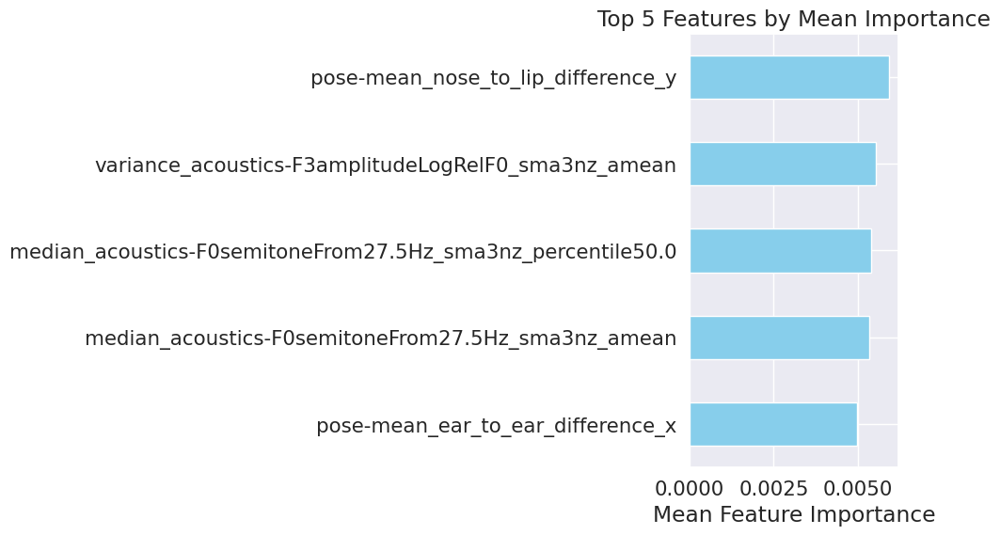

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   

   rfe_model_name  n_kept  do_model_gri

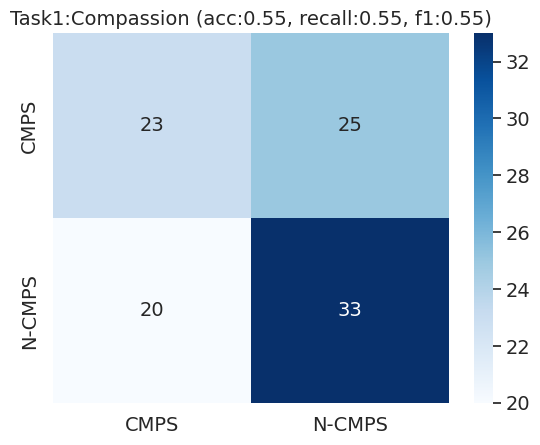

ROC-AUC for Task1:Compassion: 0.5784


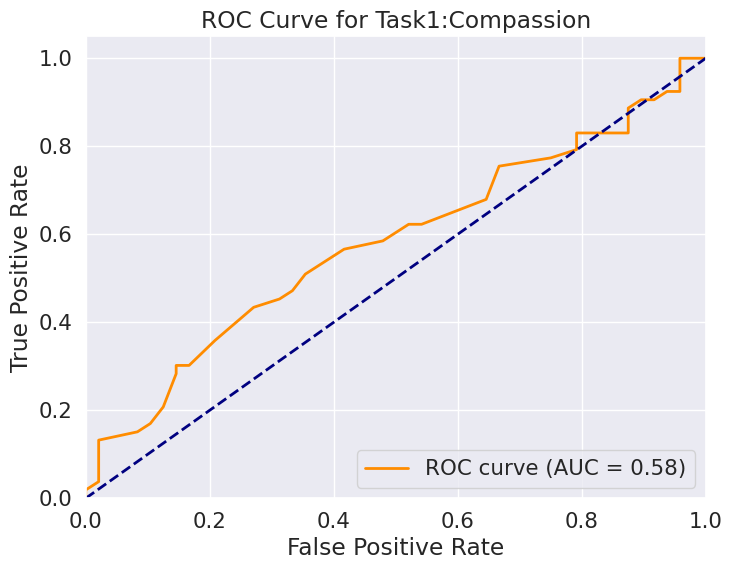

Top 5 Features by Mean Importance:['median_acoustics-chroma_7_std', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'max_acoustics-spectral_centroid_std', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm']


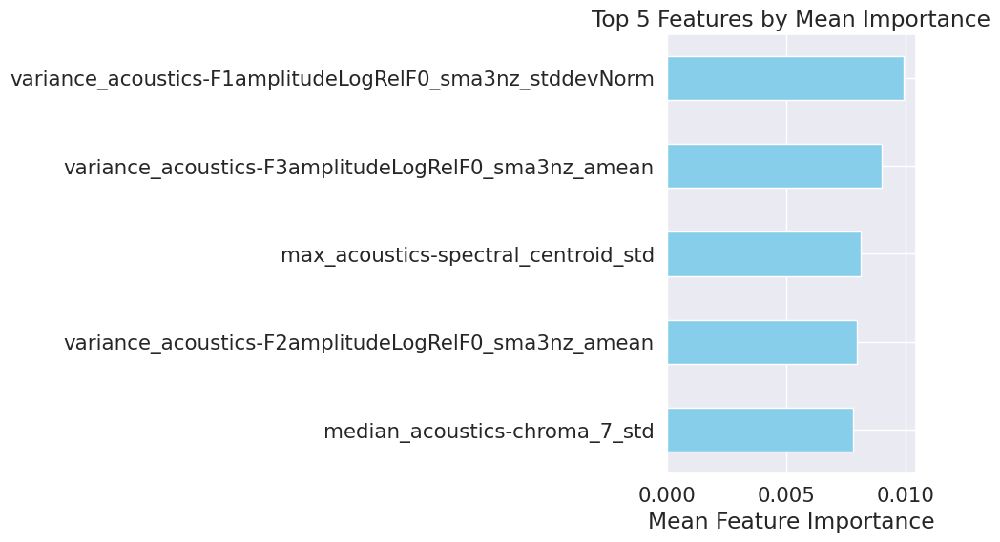

random_state:1
Total Accuracy: 0.4158415841584158
Total Recall: 0.4158415841584158
Total F1 Score: 0.40738318175708976


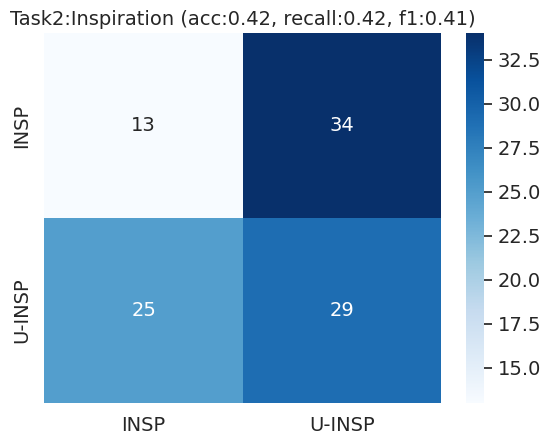

ROC-AUC for Task2:Inspiration: 0.4092


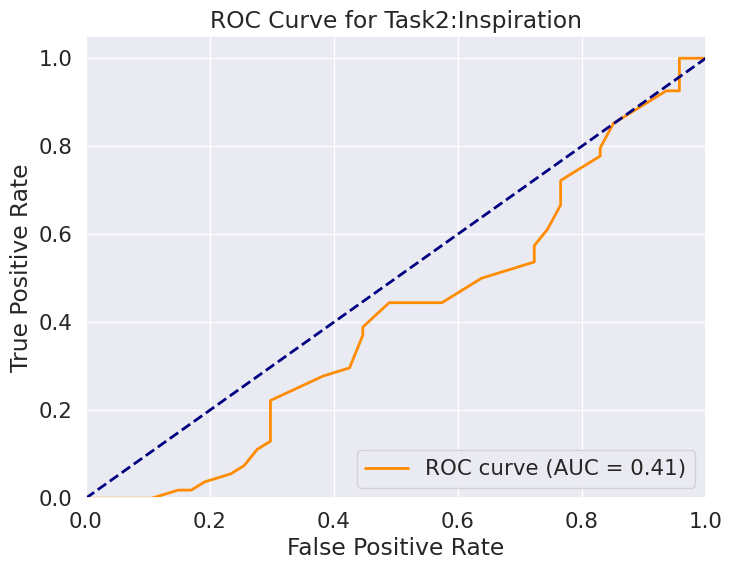

Top 5 Features by Mean Importance:['variance_acoustics-spectralFluxUV_sma3nz_amean', 'thermal-variance_thermal_feature_21', 'max_happiness', 'max_acoustics-spectral_contrast_3_std', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0']


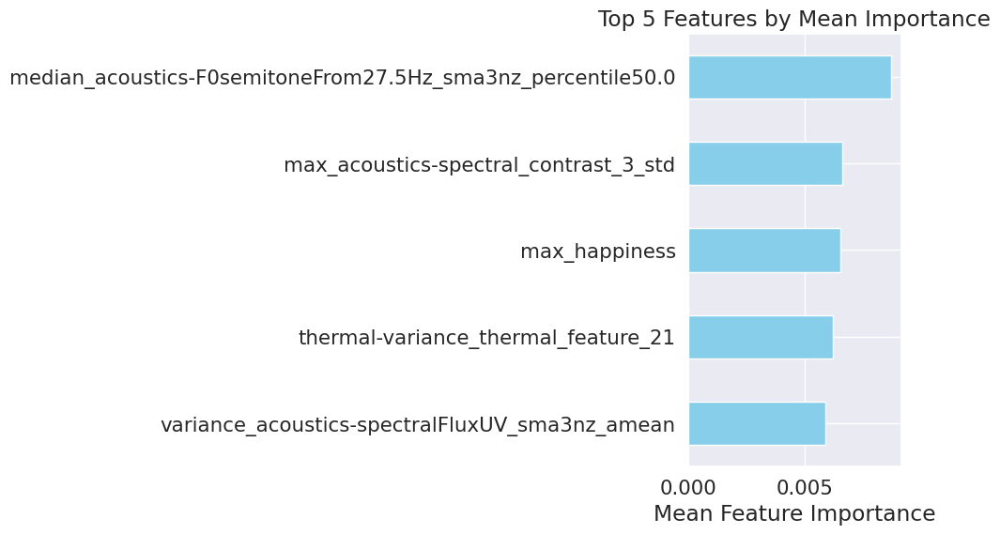

random_state:1
Total Accuracy: 0.3069306930693069
Total Recall: 0.3069306930693069
Total F1 Score: 0.298647167369865


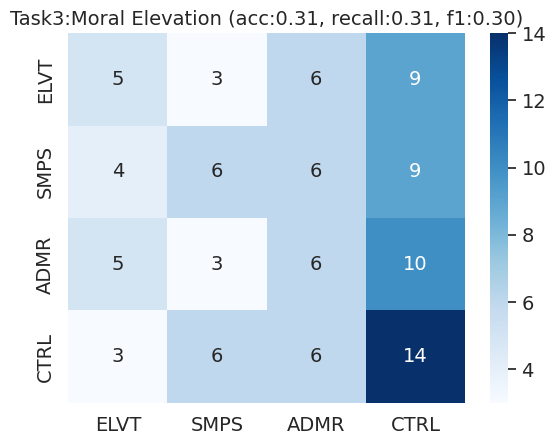

Top 5 Features by Mean Importance:['variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'median_acoustics-tonnetz_3_std', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'variance_acoustics-loudness_sma3_meanRisingSlope', 'pose-mean_ear_to_ear_difference_x']


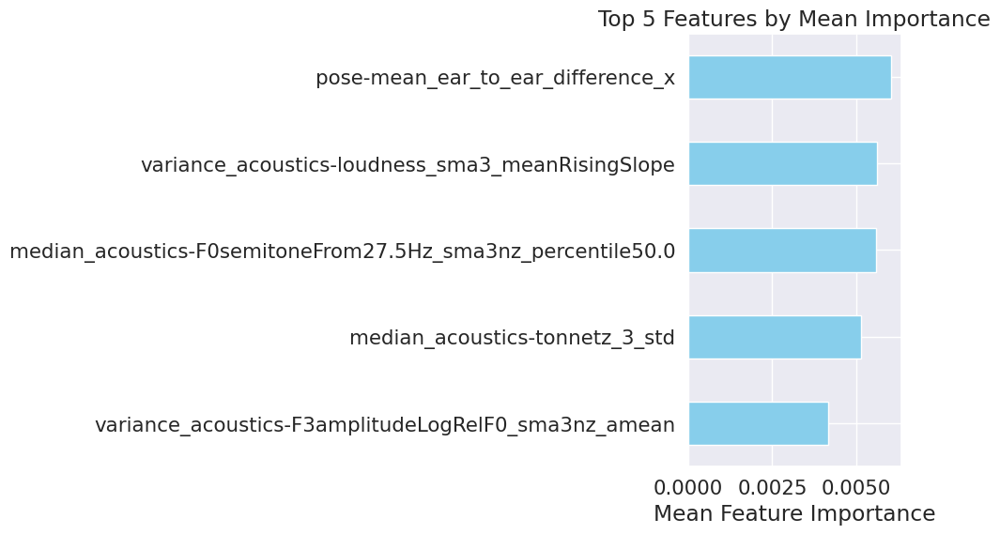

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

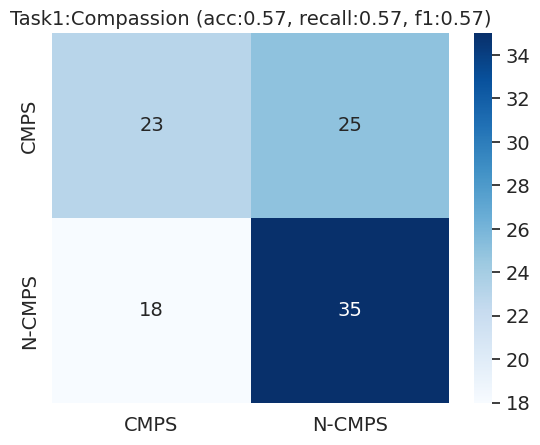

ROC-AUC for Task1:Compassion: 0.6044


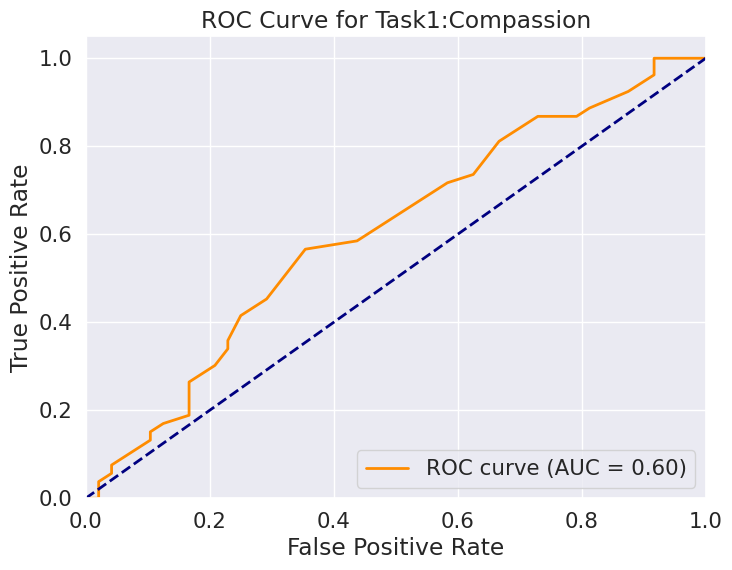

Top 5 Features by Mean Importance:['variance_acoustics-F2amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm']


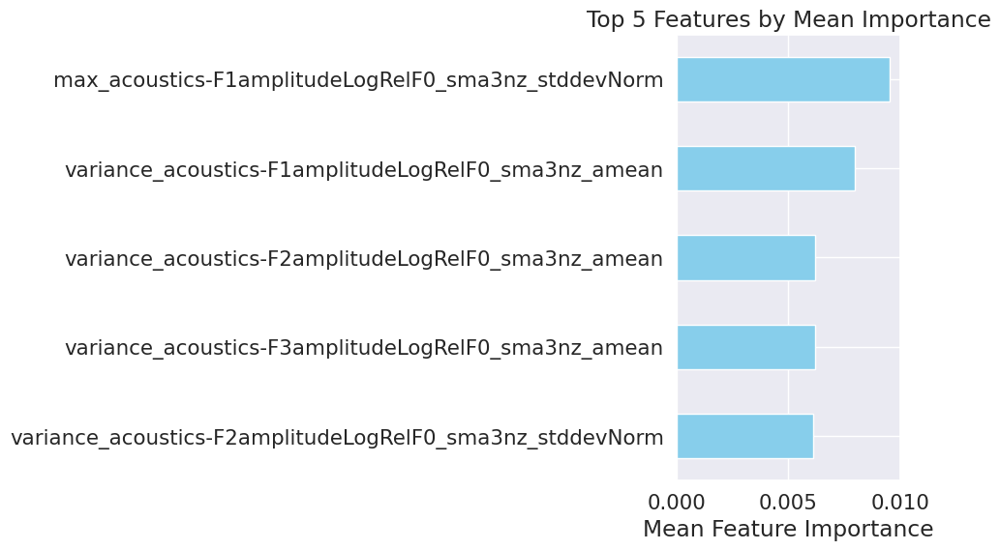

random_state:1
Total Accuracy: 0.5148514851485149
Total Recall: 0.5148514851485149
Total F1 Score: 0.5100994057426732


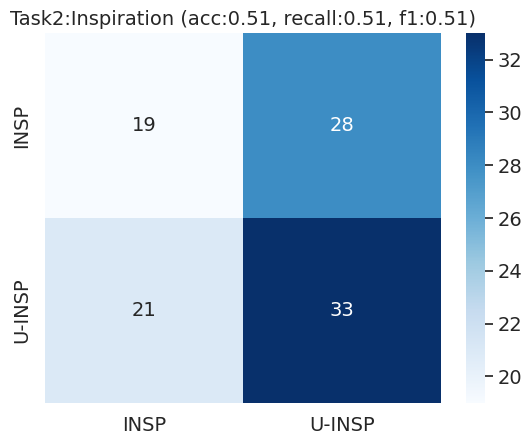

ROC-AUC for Task2:Inspiration: 0.4756


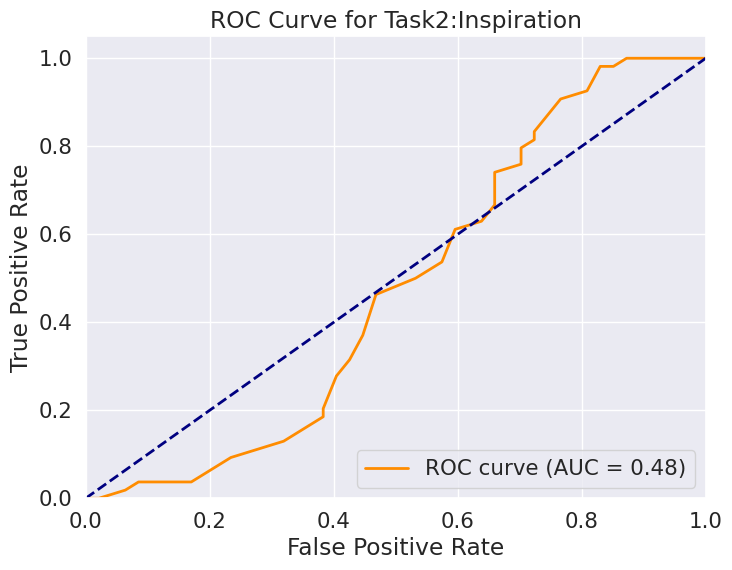

Top 5 Features by Mean Importance:['median_acoustics-F2bandwidth_sma3nz_amean', 'variance_acoustics-mfcc4_sma3_stddevNorm', 'variance_acoustics-spectralFlux_sma3_stddevNorm', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'median_eye_move-mean_right_eye_height']


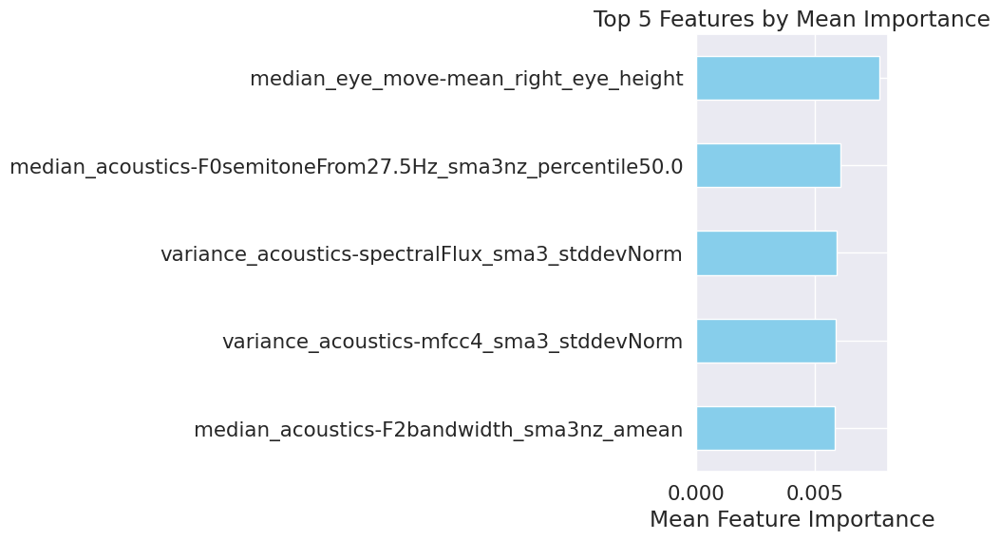

random_state:1
Total Accuracy: 0.297029702970297
Total Recall: 0.297029702970297
Total F1 Score: 0.282332107289657


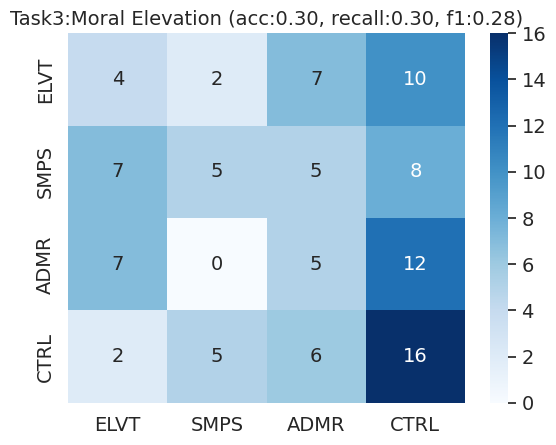

Top 5 Features by Mean Importance:['max_acoustics-jitterLocal_sma3nz_stddevNorm', 'max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'median_acoustics-tonnetz_3_std', 'median_acoustics-F1frequency_sma3nz_amean', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0']


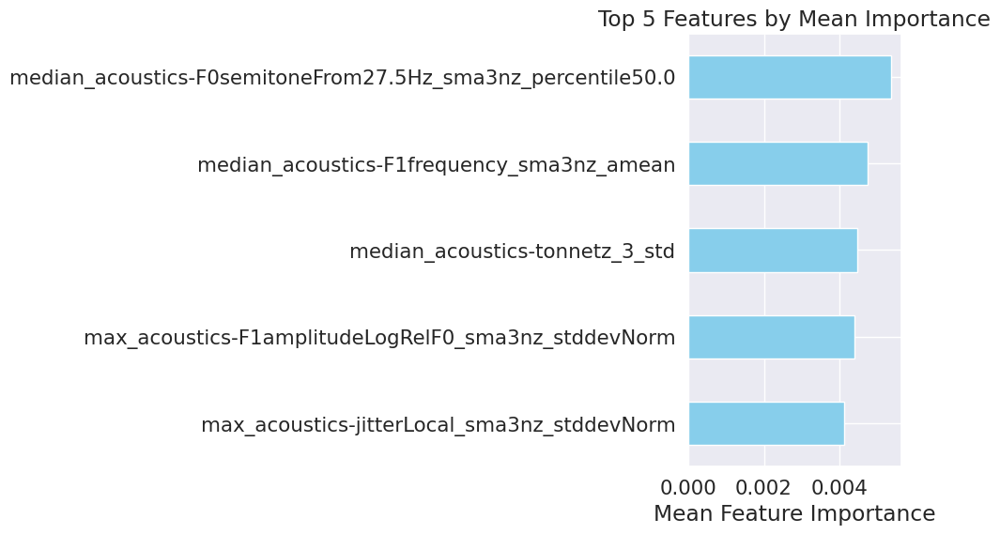

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

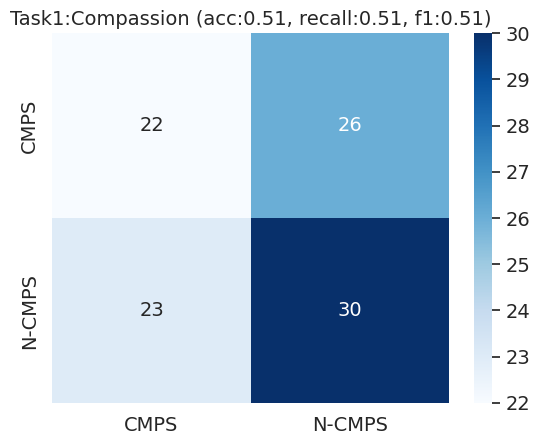

ROC-AUC for Task1:Compassion: 0.5265


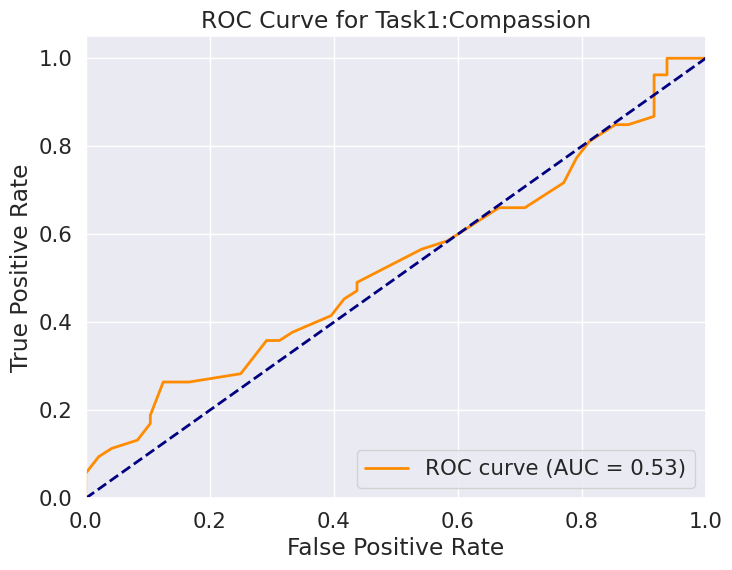

Top 5 Features by Mean Importance:['max_acoustics-spectral_centroid_std', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-loudness_sma3_meanRisingSlope', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean']


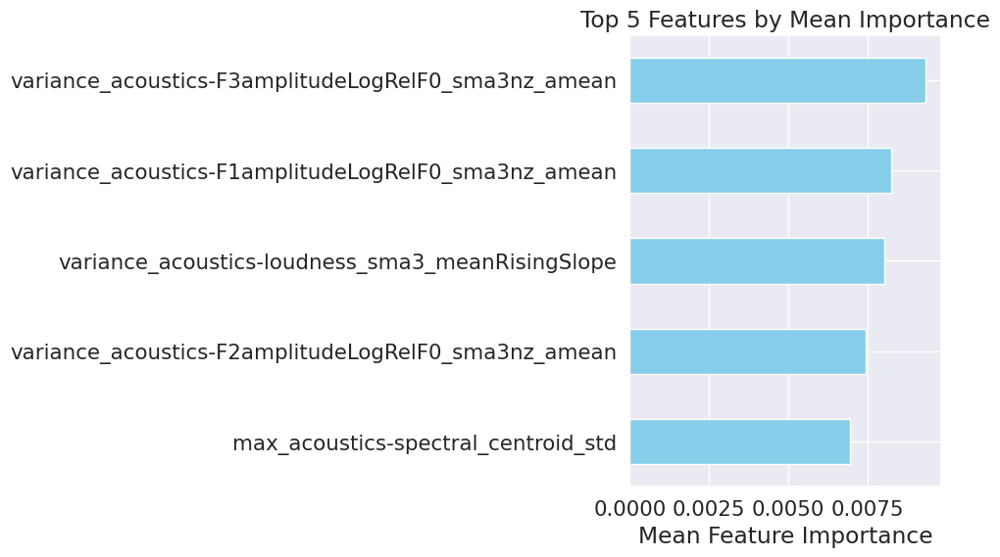

random_state:1
Total Accuracy: 0.49504950495049505
Total Recall: 0.49504950495049505
Total F1 Score: 0.49203697340997893


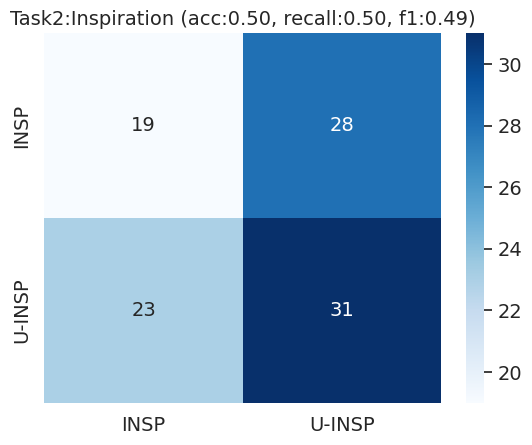

ROC-AUC for Task2:Inspiration: 0.4165


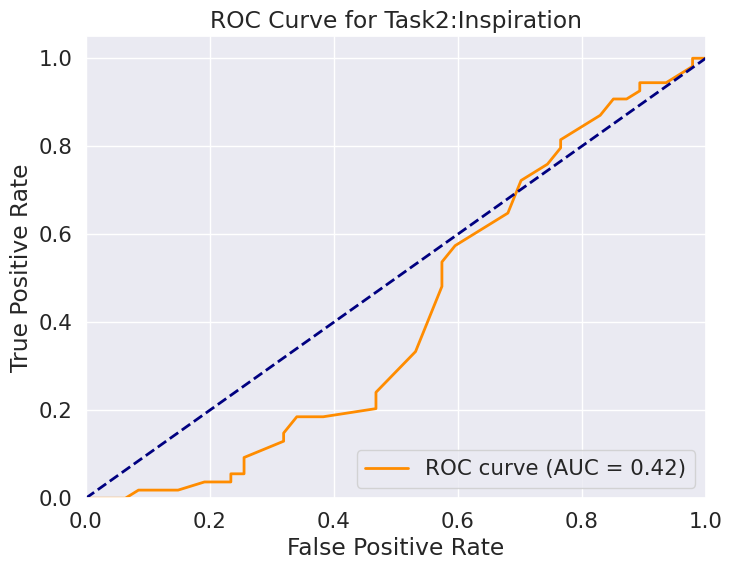

Top 5 Features by Mean Importance:['variance_acoustics-tonnetz_4_std', 'variance_acoustics-loudness_sma3_meanRisingSlope', 'variance_acoustics-loudness_sma3_pctlrange0-2', 'variance_acoustics-spectralFlux_sma3_stddevNorm', 'variance_acoustics-chroma_3_mu']


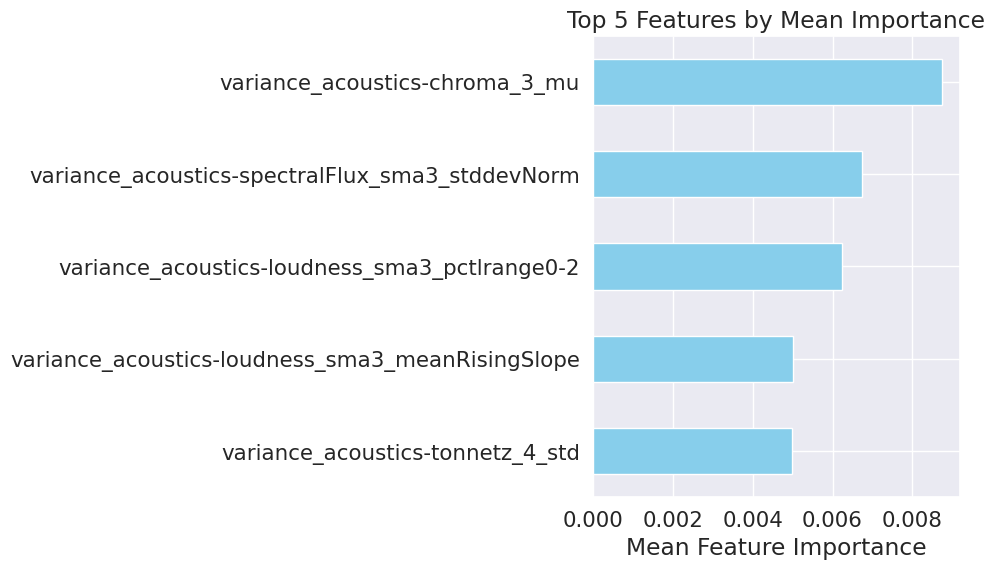

random_state:1
Total Accuracy: 0.27722772277227725
Total Recall: 0.27722772277227725
Total F1 Score: 0.2656765676567656


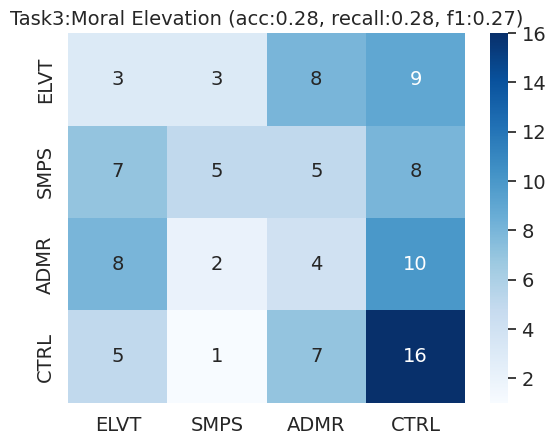

Top 5 Features by Mean Importance:['max_acoustics-spectral_centroid_std', 'median_acoustics-tonnetz_3_std', 'variance_acoustics-spectralFlux_sma3_stddevNorm', 'variance_acoustics-chroma_3_mu', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0']


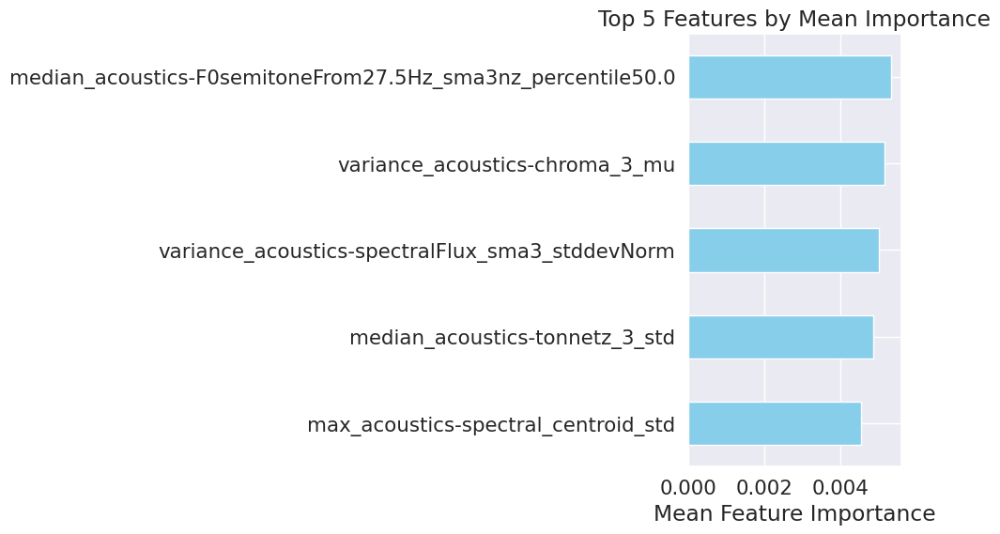

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

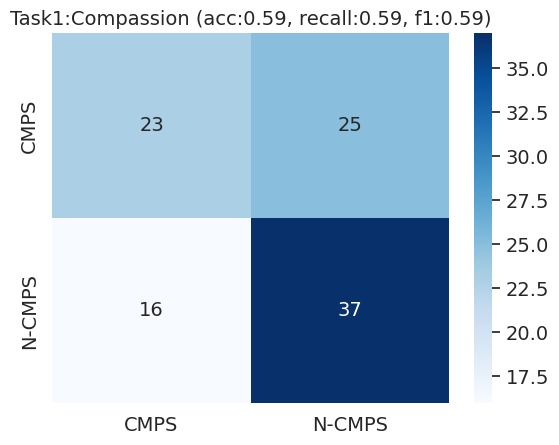

ROC-AUC for Task1:Compassion: 0.6236


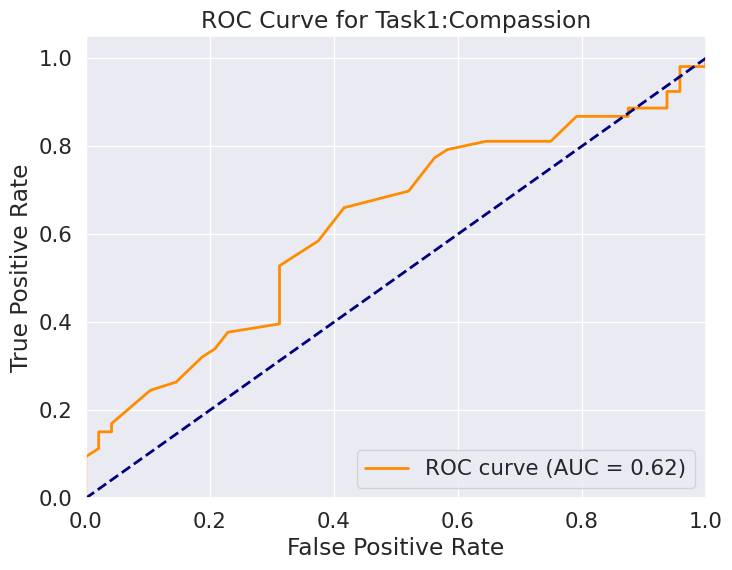

Top 5 Features by Mean Importance:['variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'median_acoustics-chroma_7_std', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-loudness_sma3_meanRisingSlope']


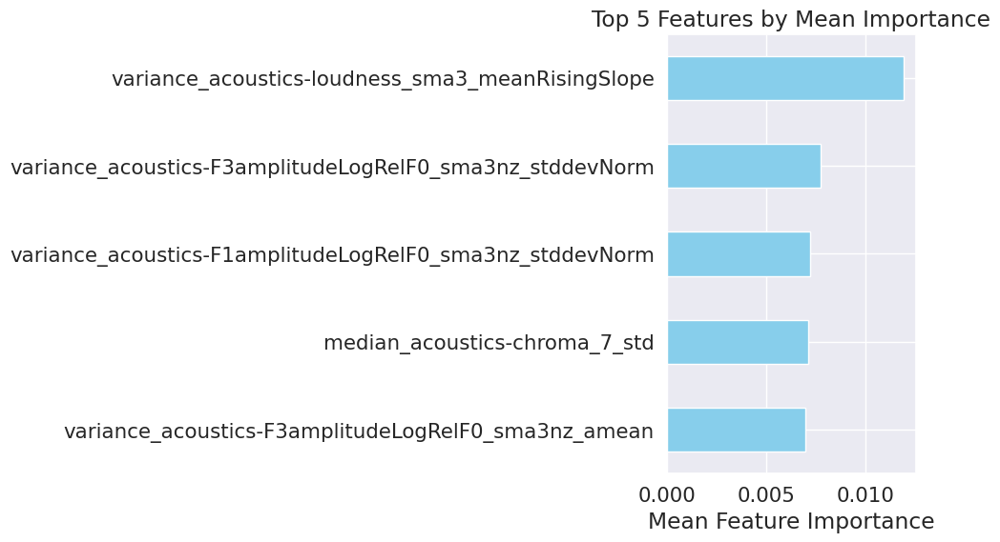

random_state:1
Total Accuracy: 0.44554455445544555
Total Recall: 0.44554455445544555
Total F1 Score: 0.4431243124312432


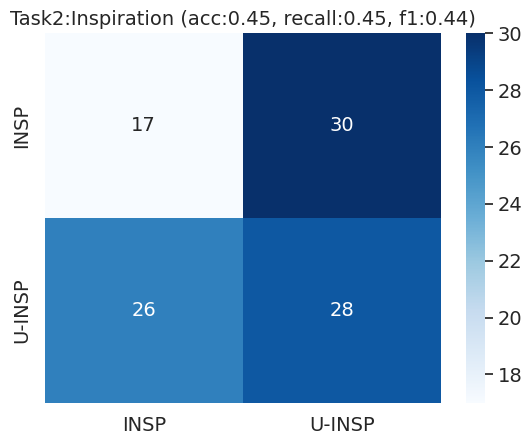

ROC-AUC for Task2:Inspiration: 0.4697


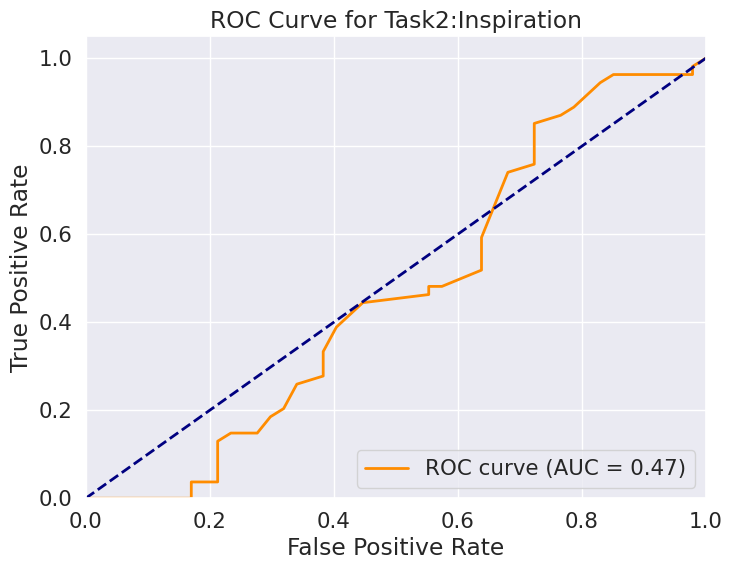

Top 5 Features by Mean Importance:['max_happiness', 'variance_acoustics-spectralFlux_sma3_stddevNorm', 'end_to_begin_FaceScore', 'variance_acoustics-tonnetz_4_std', 'variance_acoustics-loudness_sma3_meanRisingSlope']


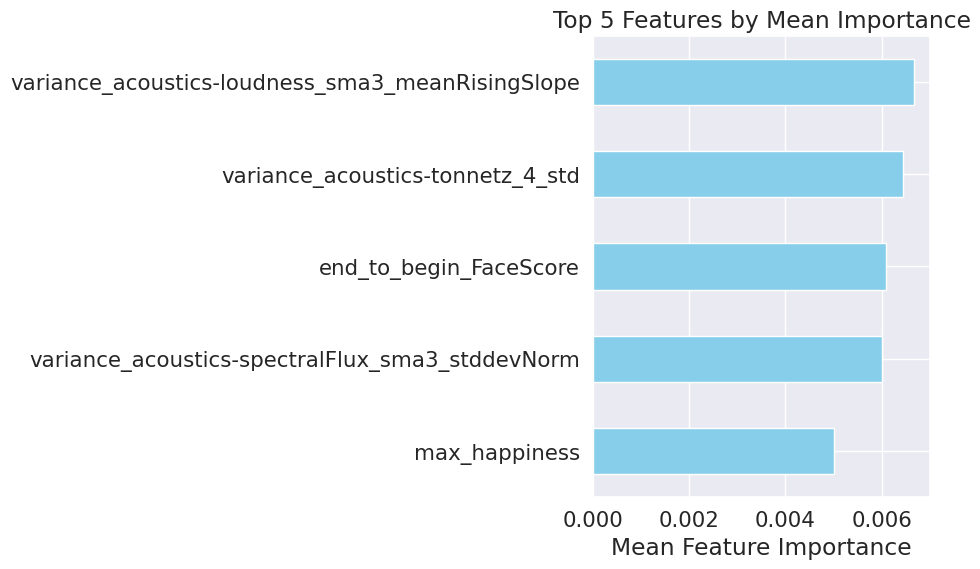

random_state:1
Total Accuracy: 0.2376237623762376
Total Recall: 0.2376237623762376
Total F1 Score: 0.2253485204699579


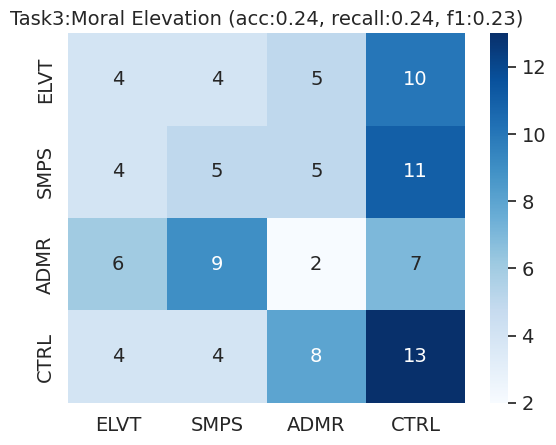

Top 5 Features by Mean Importance:['end_to_begin_FaceScore', 'median_acoustics-F3frequency_sma3nz_amean', 'variance_acoustics-loudness_sma3_pctlrange0-2', 'max_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-loudness_sma3_meanRisingSlope']


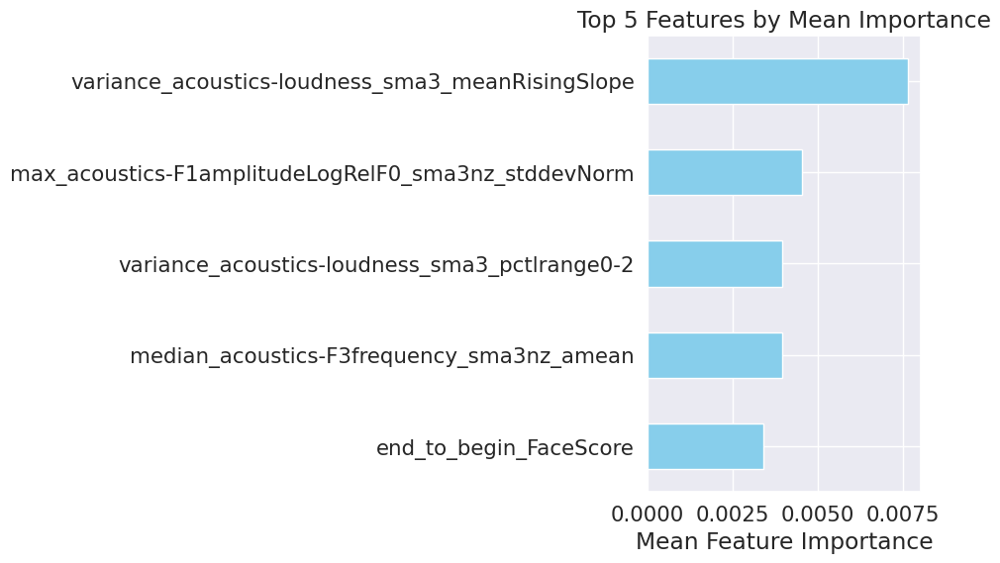

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

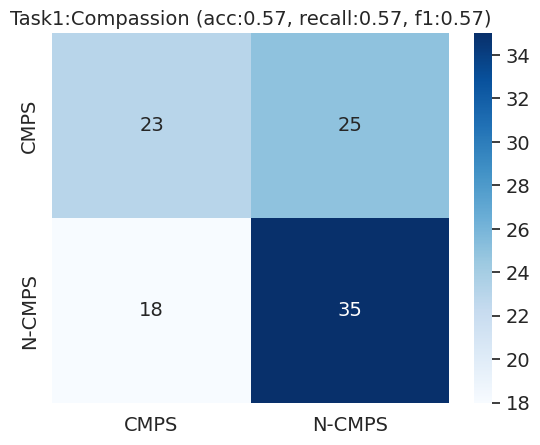

ROC-AUC for Task1:Compassion: 0.6028


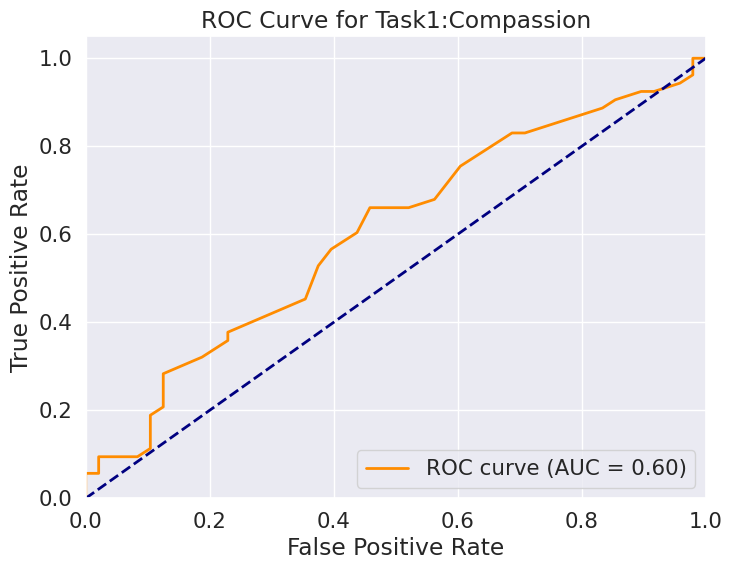

Top 5 Features by Mean Importance:['variance_acoustics-loudness_sma3_meanFallingSlope', 'variance_acoustics-spectral_centroid_mu', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_stddevNorm', 'pose-end_to_begin_ear_to_ear_difference_y']


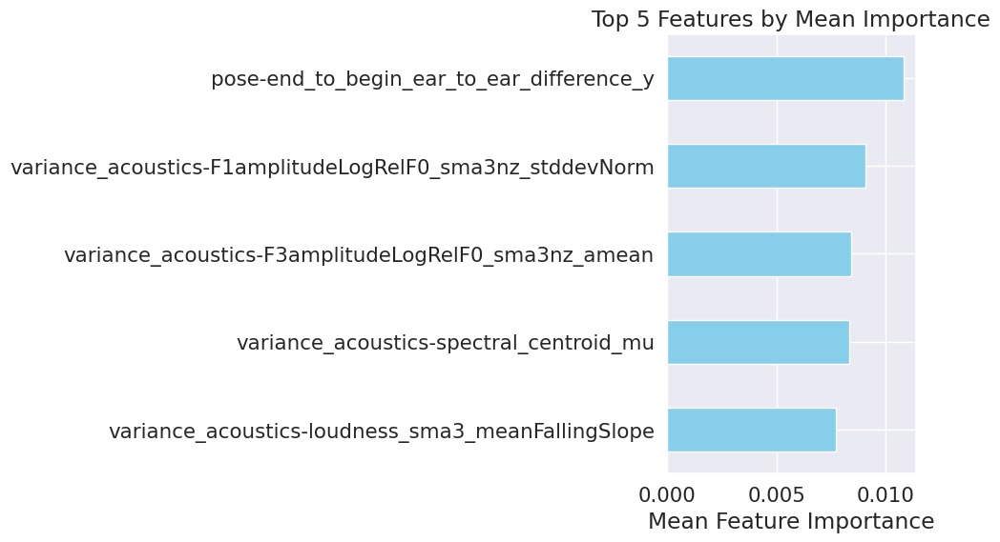

random_state:1
Total Accuracy: 0.5445544554455446
Total Recall: 0.5445544554455446
Total F1 Score: 0.5410133118575015


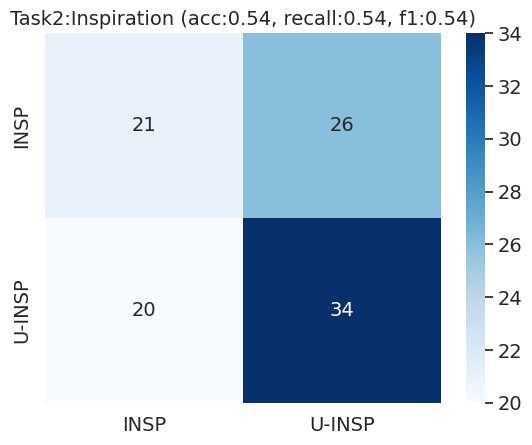

ROC-AUC for Task2:Inspiration: 0.5506


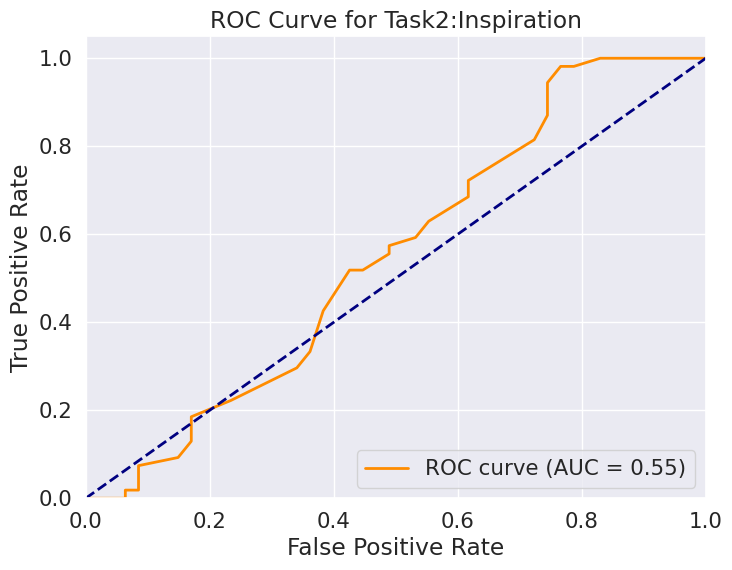

Top 5 Features by Mean Importance:['variance_acoustics-spectral_contrast_5_mu', 'max_acoustics-loudness_sma3_percentile50.0', 'variance_acoustics-tonnetz_4_std', 'pose-variance_shoulder_to_shoulder_difference_x', 'variance_acoustics-loudness_sma3_stddevRisingSlope']


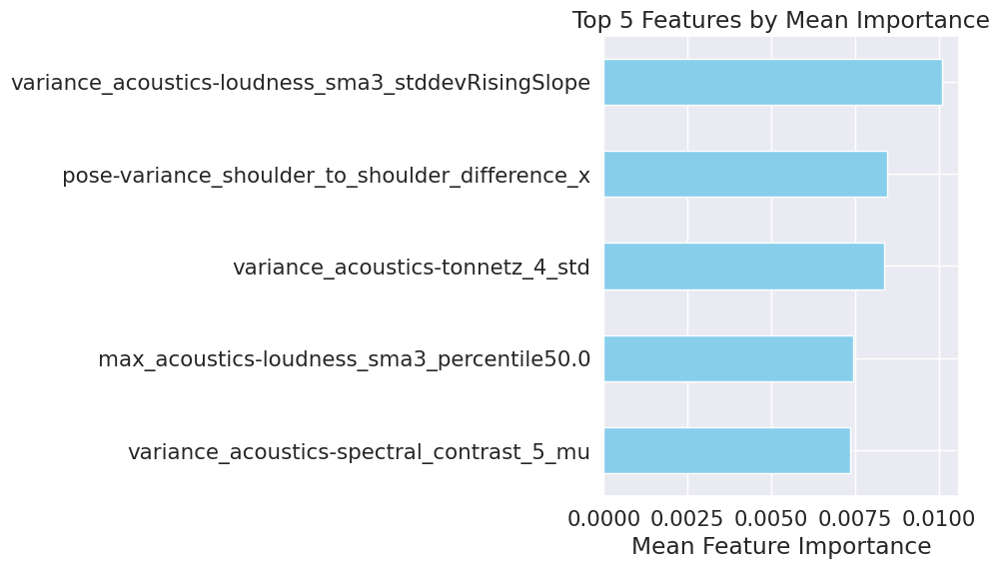

random_state:1
Total Accuracy: 0.2871287128712871
Total Recall: 0.2871287128712871
Total F1 Score: 0.2716627761492662


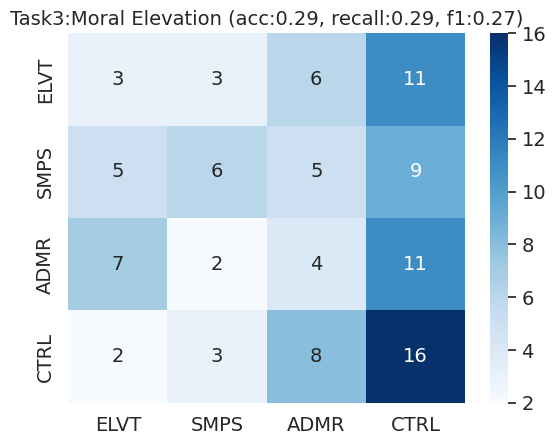

Top 5 Features by Mean Importance:['variance_acoustics-loudness_sma3_stddevRisingSlope', 'median_acoustics-F3frequency_sma3nz_amean', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'variance_acoustics-chroma_3_mu', 'pose-mean_ear_to_ear_difference_x']


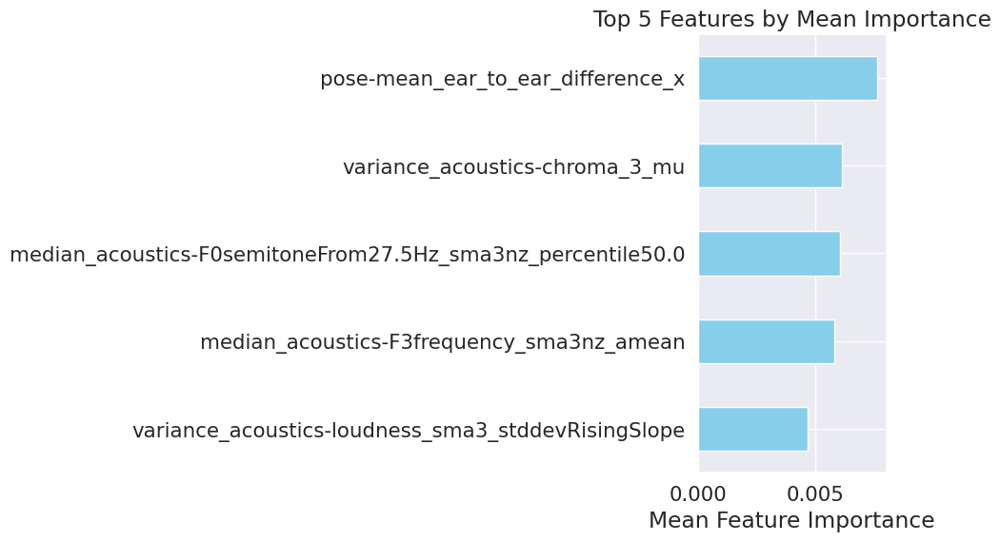

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

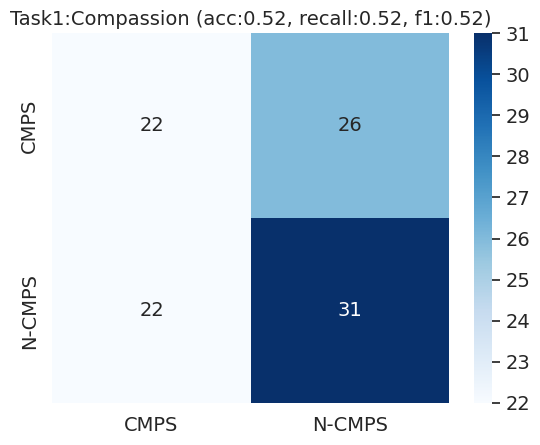

ROC-AUC for Task1:Compassion: 0.5428


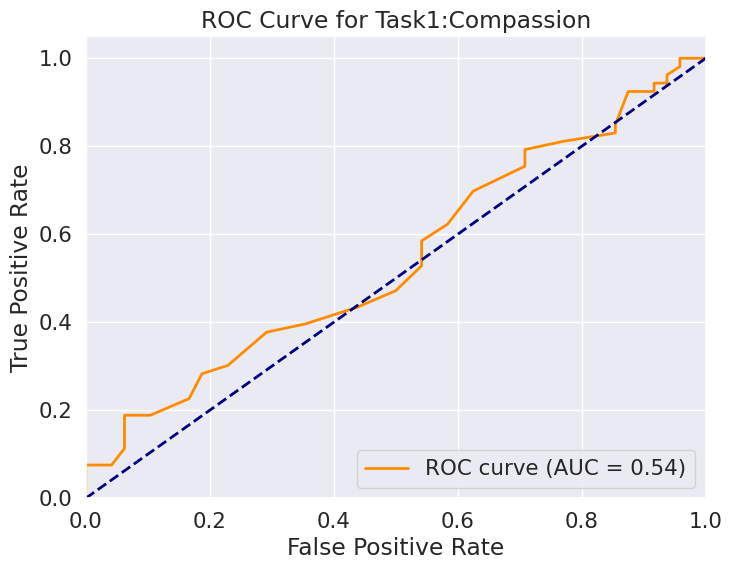

Top 5 Features by Mean Importance:['pose-end_to_begin_ear_to_ear_difference_y', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_stddevNorm', 'variance_acoustics-loudness_sma3_meanRisingSlope']


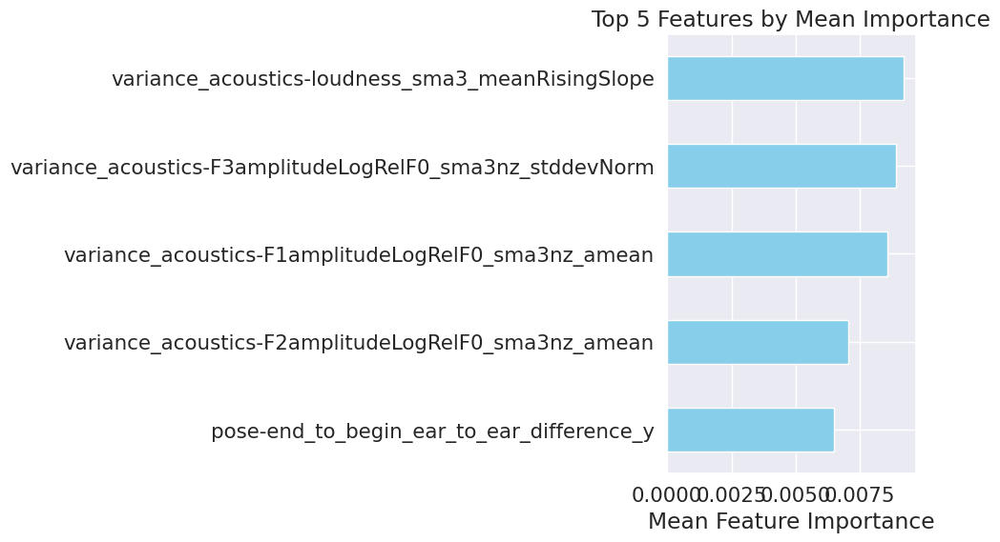

random_state:1
Total Accuracy: 0.45544554455445546
Total Recall: 0.45544554455445546
Total F1 Score: 0.4521967360303694


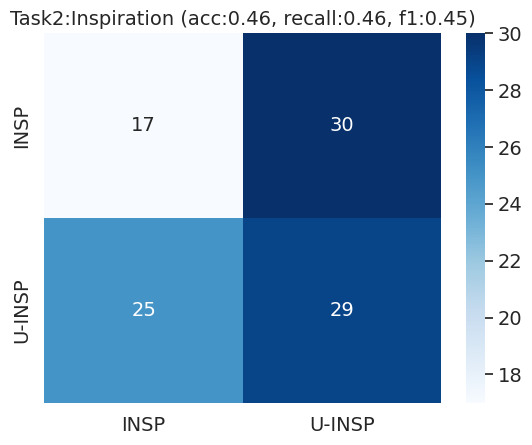

ROC-AUC for Task2:Inspiration: 0.4171


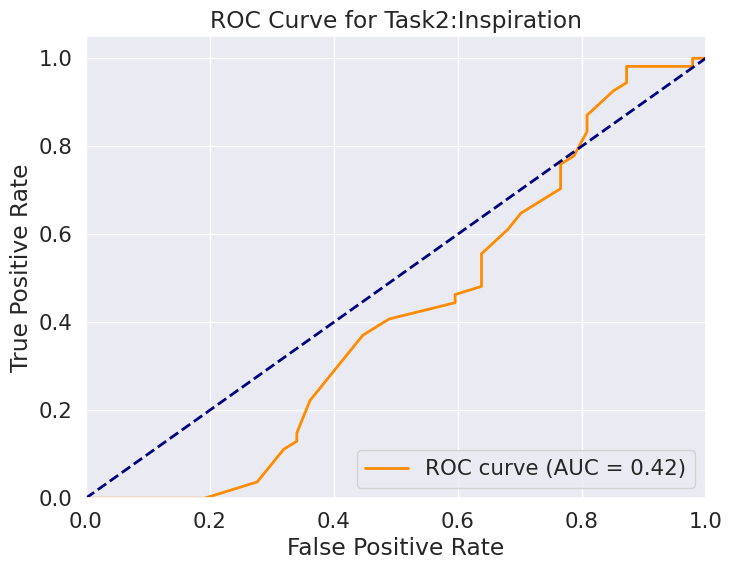

Top 5 Features by Mean Importance:['median_acoustics-logRelF0-H1-A3_sma3nz_stddevNorm', 'variance_acoustics-chroma_3_mu', 'variance_acoustics-tonnetz_4_std', 'variance_acoustics-chroma_6_std', 'median_acoustics-alphaRatioUV_sma3nz_amean']


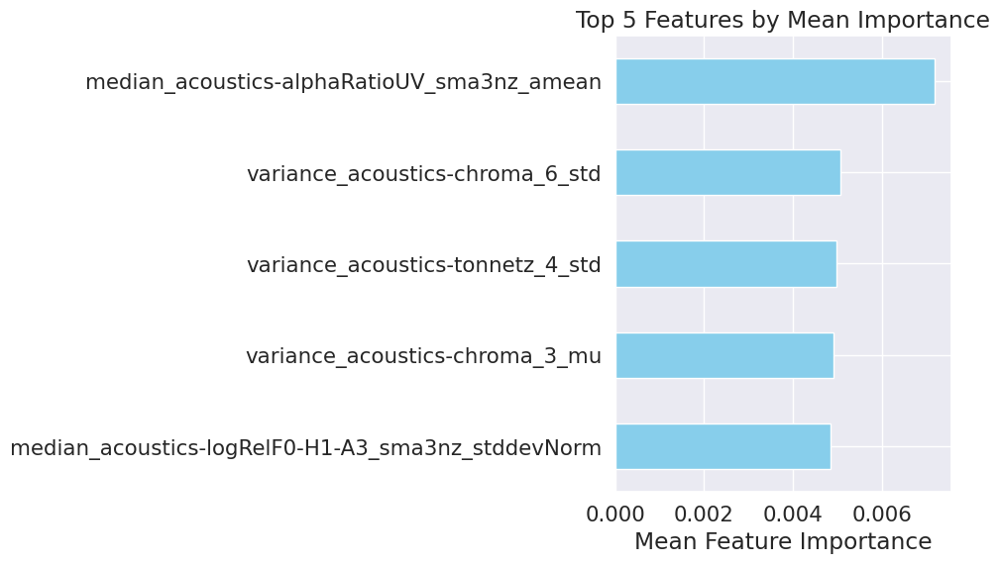

random_state:1
Total Accuracy: 0.24752475247524752
Total Recall: 0.24752475247524752
Total F1 Score: 0.22619820329332682


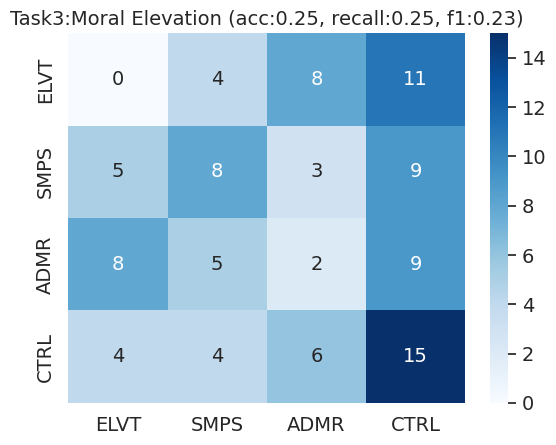

Top 5 Features by Mean Importance:['median_acoustics-F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'pose-end_to_begin_ear_to_ear_difference_y', 'variance_acoustics-chroma_3_mu', 'variance_acoustics-loudness_sma3_meanRisingSlope']


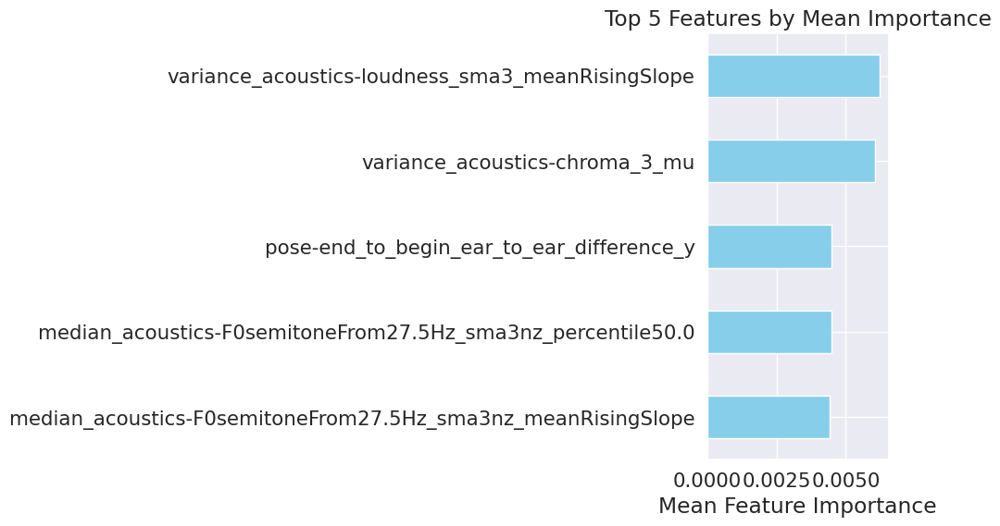

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

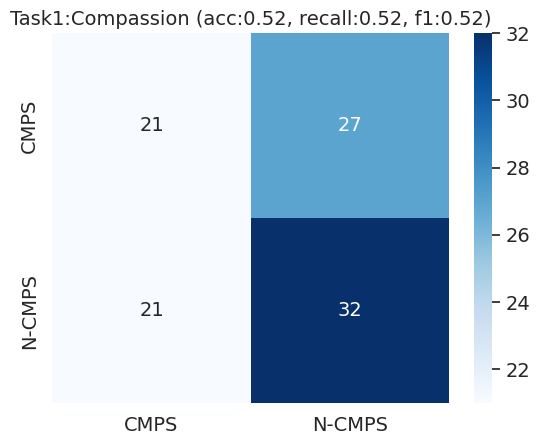

ROC-AUC for Task1:Compassion: 0.5033


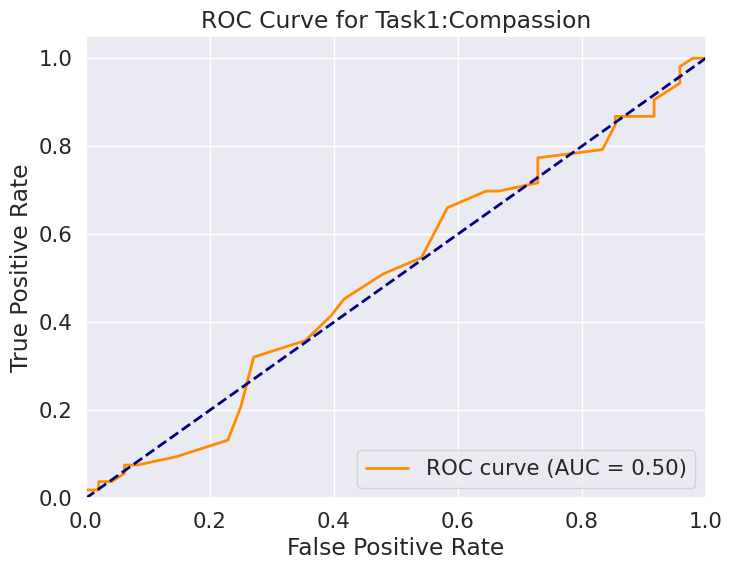

Top 5 Features by Mean Importance:['variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'thermal-end_to_begin_thermal_feature_5', 'thermal-variance_thermal_feature_19', 'variance_acoustics-F2amplitudeLogRelF0_sma3nz_amean', 'pose-end_to_begin_ear_to_ear_difference_y']


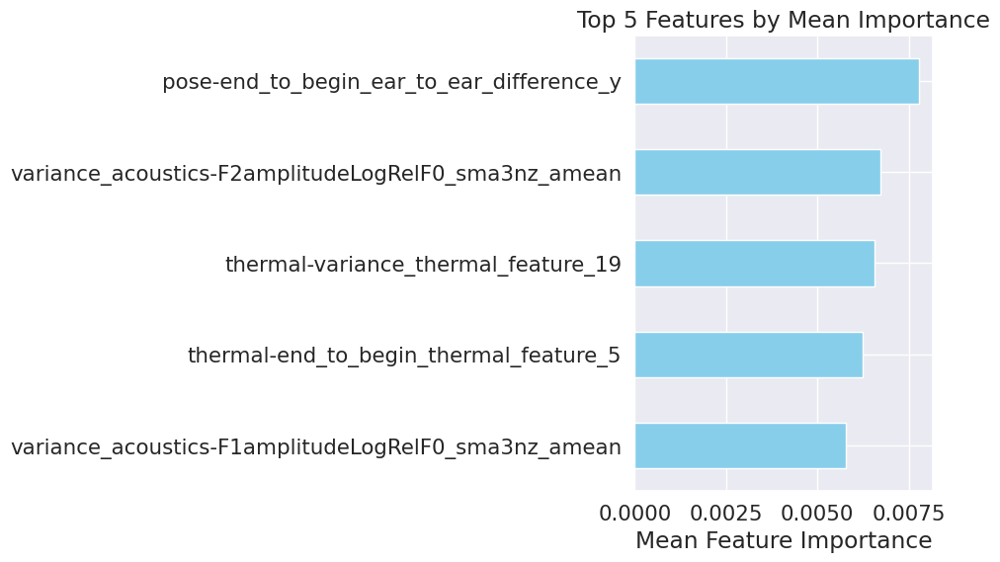

random_state:1
Total Accuracy: 0.48514851485148514
Total Recall: 0.48514851485148514
Total F1 Score: 0.4811454829693496


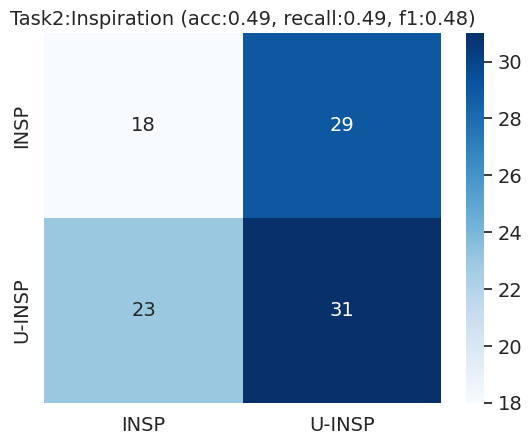

ROC-AUC for Task2:Inspiration: 0.4551


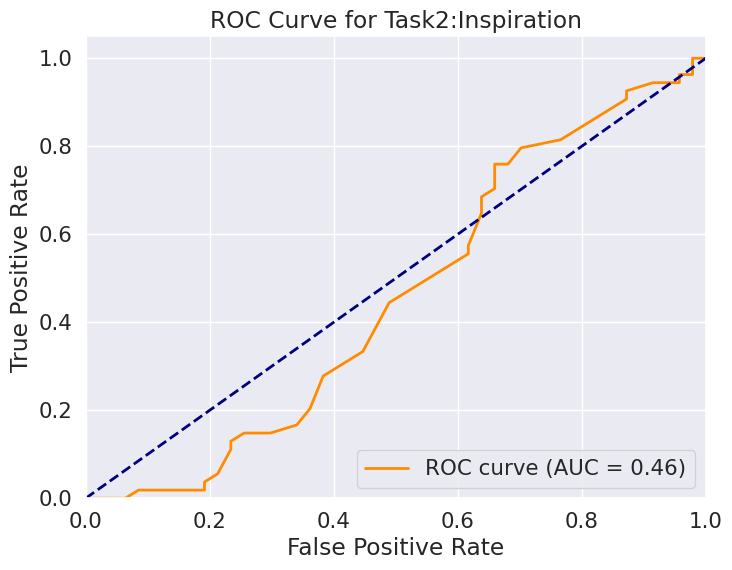

Top 5 Features by Mean Importance:['max_acoustics-loudness_sma3_meanRisingSlope', 'variance_acoustics-loudness_sma3_meanRisingSlope', 'median_acoustics-F0semitoneFrom27.5Hz_sma3nz_percentile50.0', 'max_acoustics-mfcc_3_std', 'variance_acoustics-chroma_3_mu']


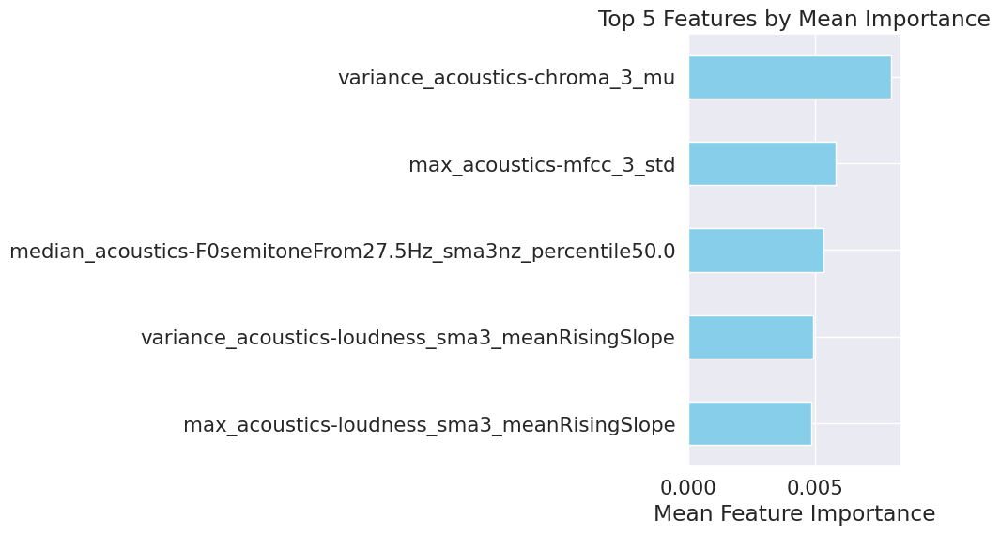

random_state:1
Total Accuracy: 0.22772277227722773
Total Recall: 0.22772277227722773
Total F1 Score: 0.21879468933265817


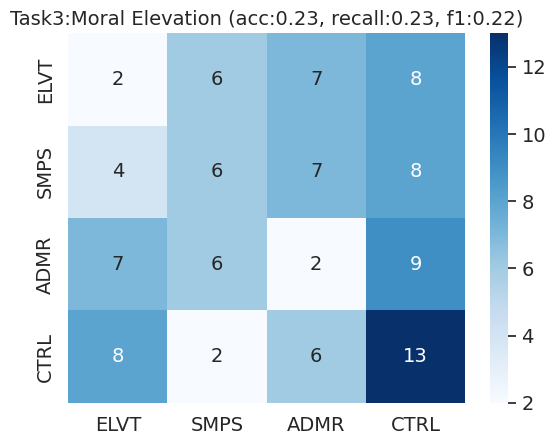

Top 5 Features by Mean Importance:['median_acoustics-tonnetz_3_std', 'pose-max_shoulder_to_shoulder_difference_y', 'variance_acoustics-loudness_sma3_meanRisingSlope', 'variance_acoustics-chroma_3_mu', 'pose-mean_ear_to_ear_difference_x']


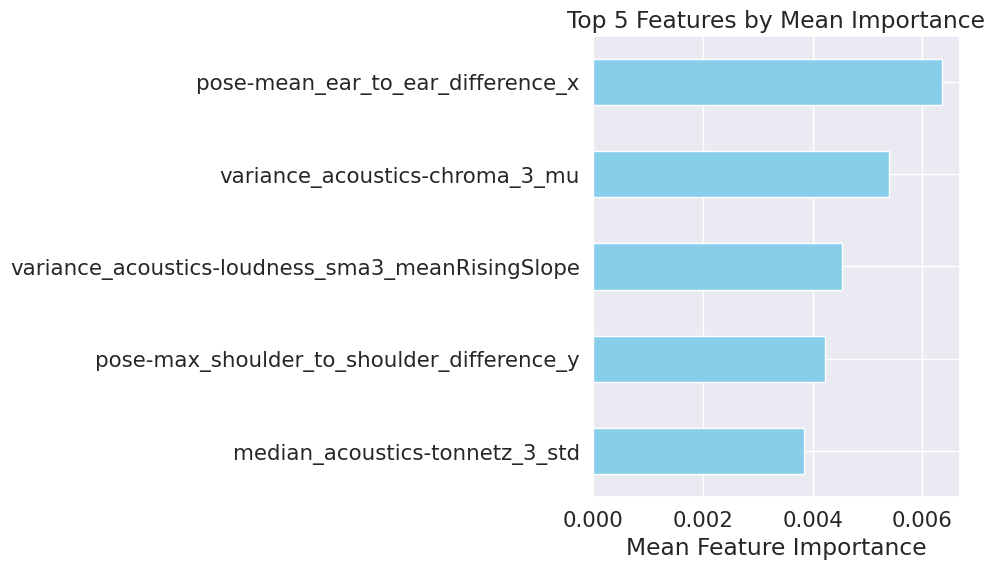

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

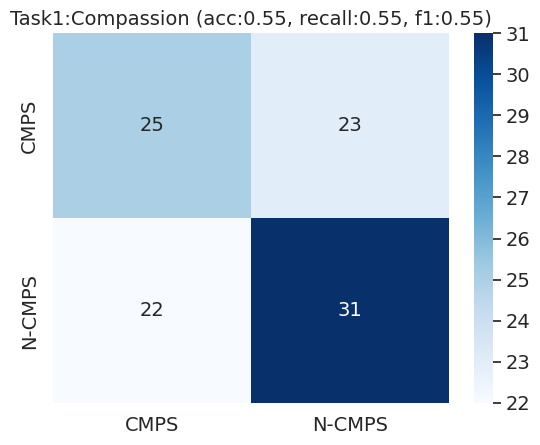

ROC-AUC for Task1:Compassion: 0.5562


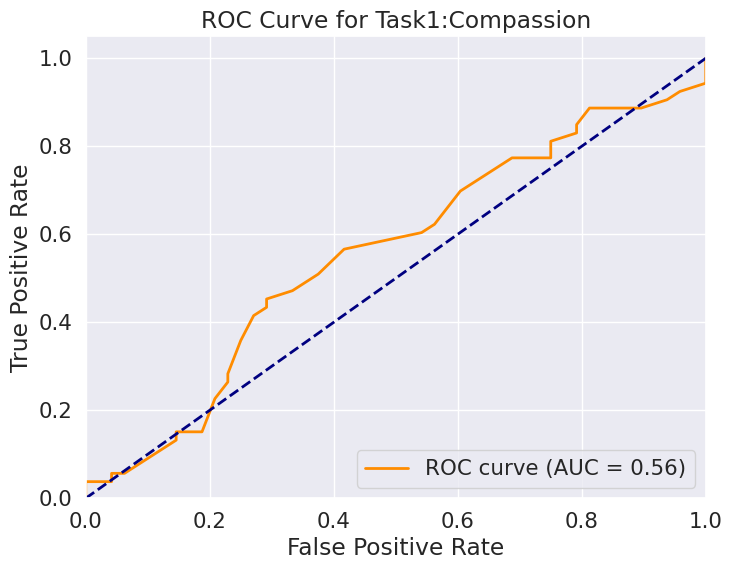

Top 5 Features by Mean Importance:['median_acoustics-chroma_3_std', 'variance_acoustics-F3amplitudeLogRelF0_sma3nz_stddevNorm', 'median_acoustics-chroma_8_std', 'variance_acoustics-F1amplitudeLogRelF0_sma3nz_amean', 'median_acoustics-chroma_7_std']


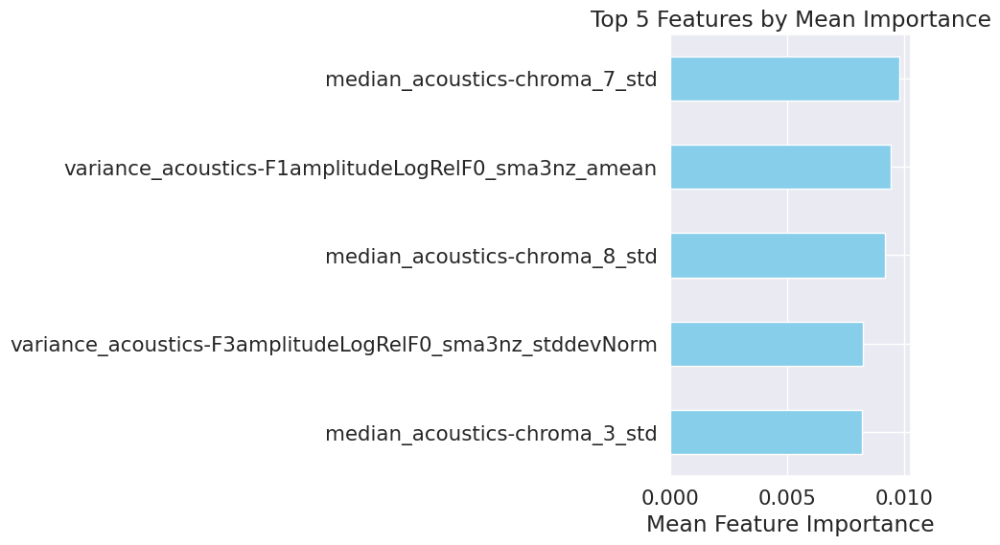

random_state:1
Total Accuracy: 0.504950495049505
Total Recall: 0.504950495049505
Total F1 Score: 0.49899560926421427


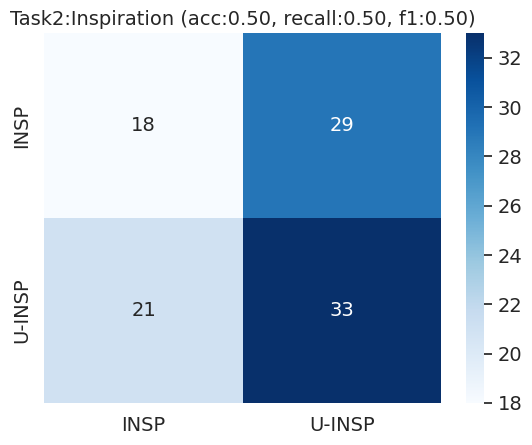

ROC-AUC for Task2:Inspiration: 0.4452


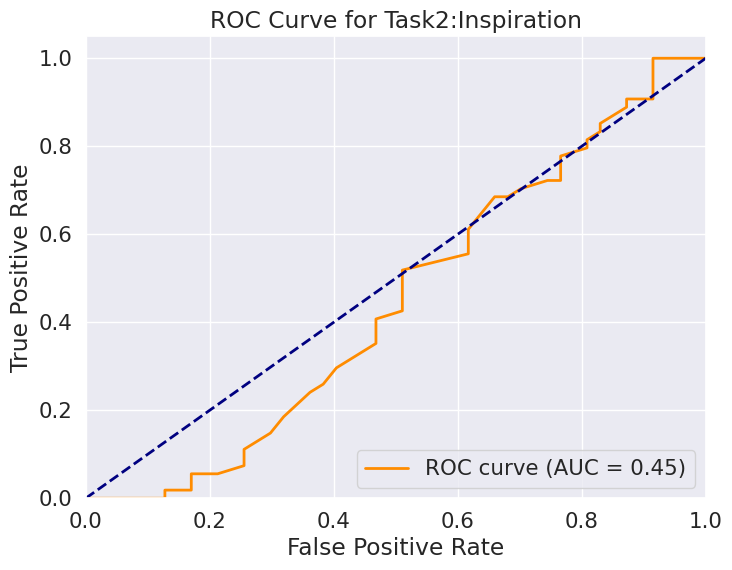

Top 5 Features by Mean Importance:['max_acoustics-spectralFlux_sma3_amean', 'variance_acoustics-tonnetz_4_std', 'max_acoustics-loudness_sma3_amean', 'variance_acoustics-spectralFlux_sma3_stddevNorm', 'variance_acoustics-spectralFluxUV_sma3nz_amean']


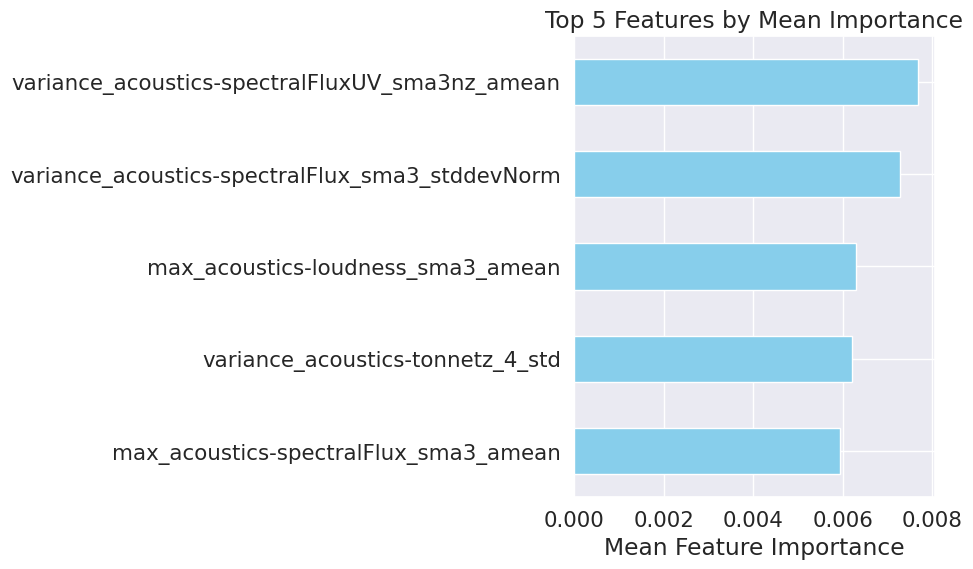

random_state:1
Total Accuracy: 0.25742574257425743
Total Recall: 0.25742574257425743
Total F1 Score: 0.23349112892208146


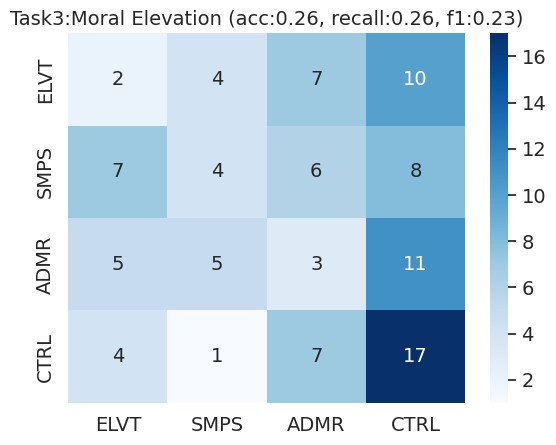

Top 5 Features by Mean Importance:['median_acoustics-F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope', 'median_acoustics-tonnetz_3_std', 'max_acoustics-spectral_centroid_std', 'variance_acoustics-chroma_2_mu', 'variance_acoustics-loudness_sma3_meanFallingSlope']


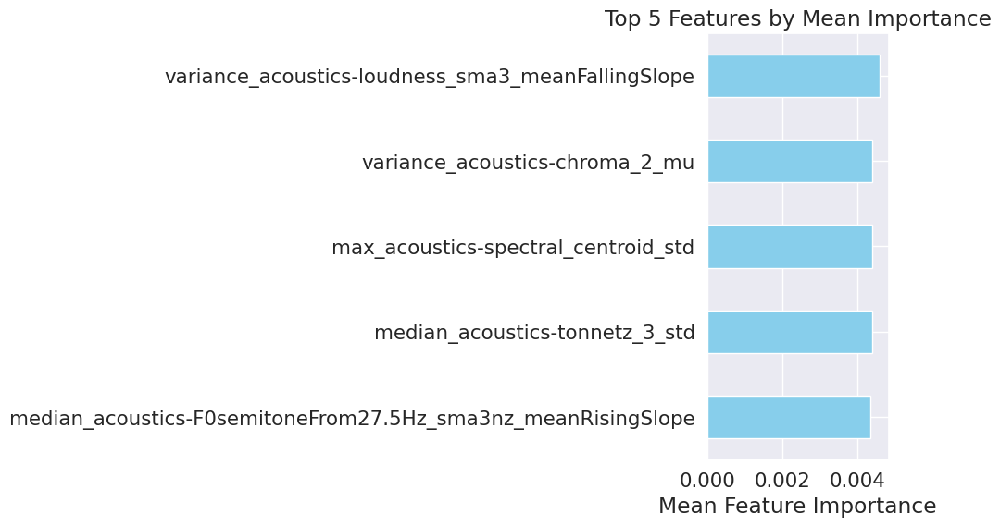

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

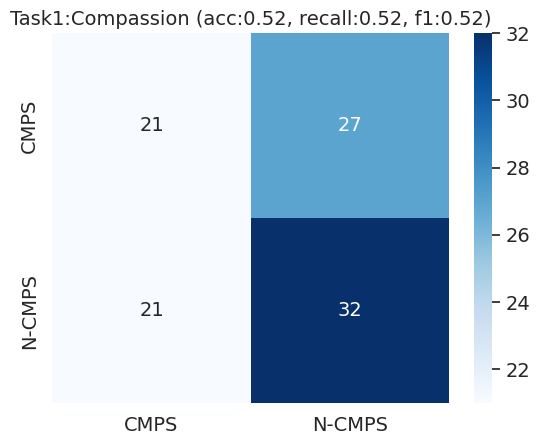

ROC-AUC for Task1:Compassion: 0.5419


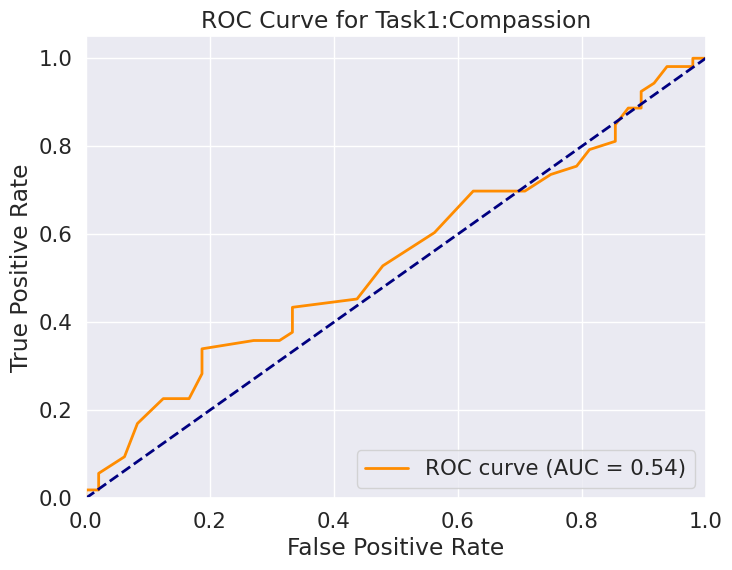

Top 5 Features by Mean Importance:['median_speech_text-disapproval', 'median_AU09', 'max_speech_text-caring', 'variance_speech_text-caring', 'pose-end_to_begin_ear_to_ear_difference_y']


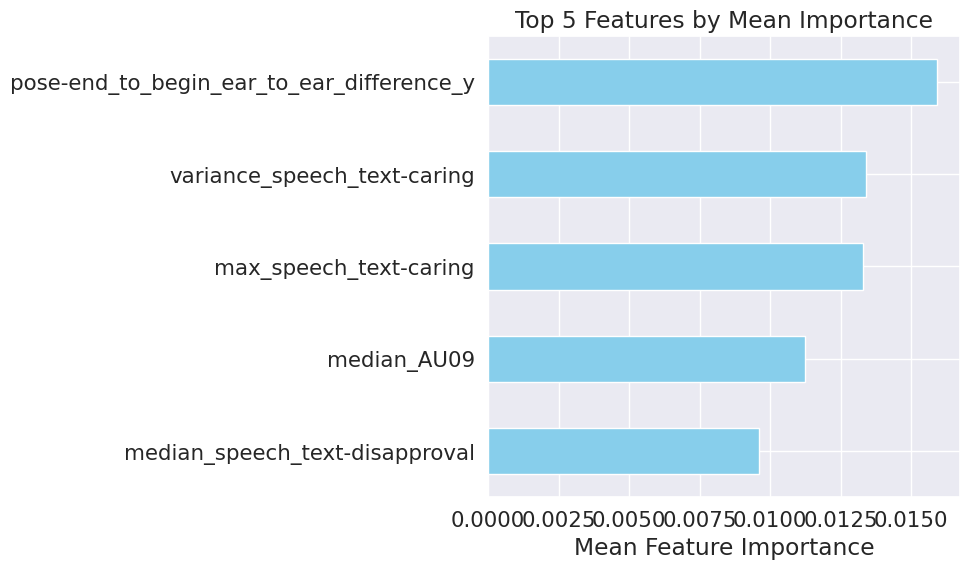

random_state:1
Total Accuracy: 0.504950495049505
Total Recall: 0.504950495049505
Total F1 Score: 0.5040699722146128


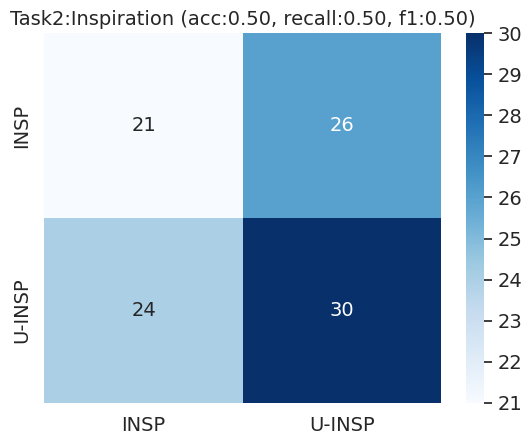

ROC-AUC for Task2:Inspiration: 0.5099


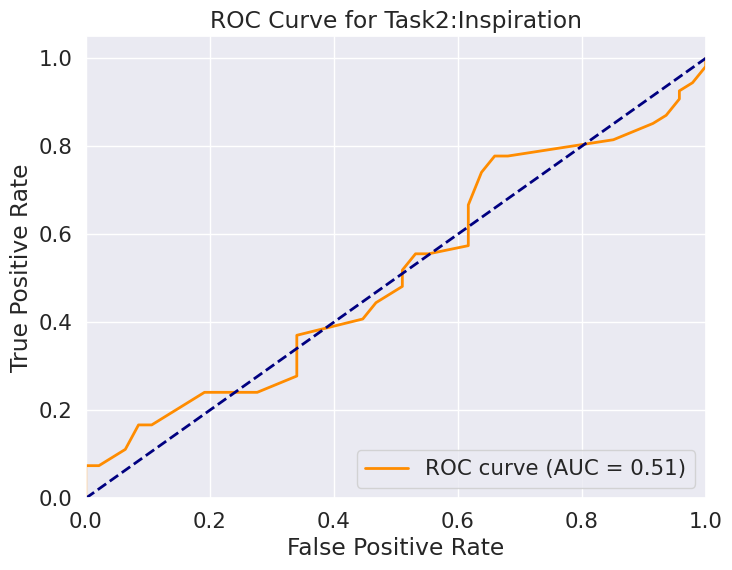

Top 5 Features by Mean Importance:['median_AU10', 'pose-max_nose_to_lip_difference_y', 'max_speech_text-optimism', 'median_speech_text-love', 'median_speech_text-surprise']


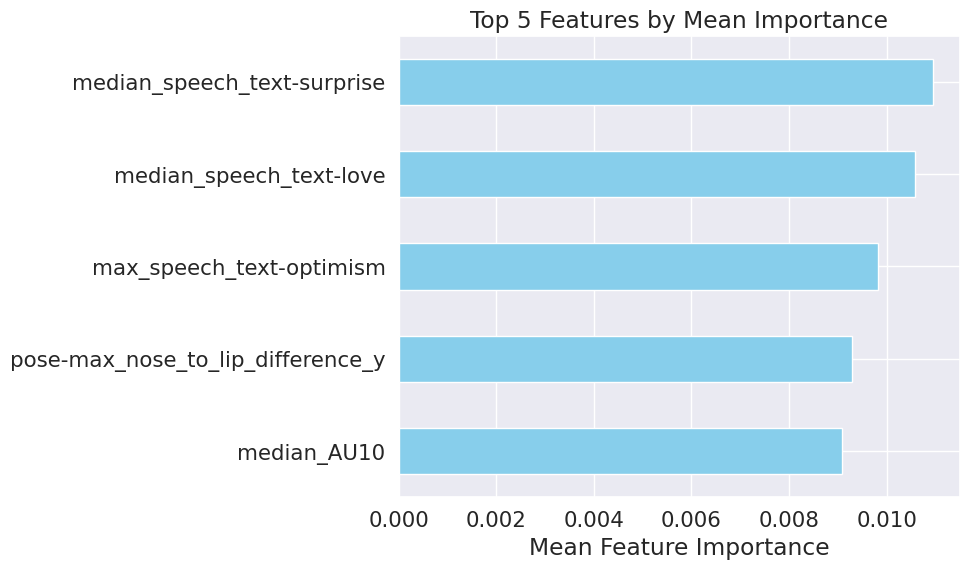

random_state:1
Total Accuracy: 0.36633663366336633
Total Recall: 0.36633663366336633
Total F1 Score: 0.36021604841671173


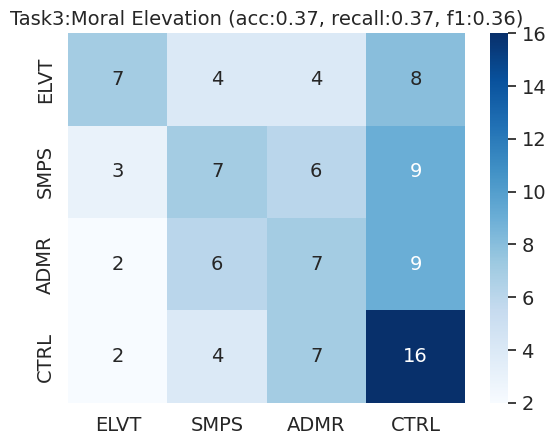

Top 5 Features by Mean Importance:['pose-max_nose_to_lip_difference_y', 'variance_speech_text-caring', 'max_speech_text-caring', 'max_eye_move-variance_left_iris_relative_y', 'pose-mean_ear_to_ear_difference_x']


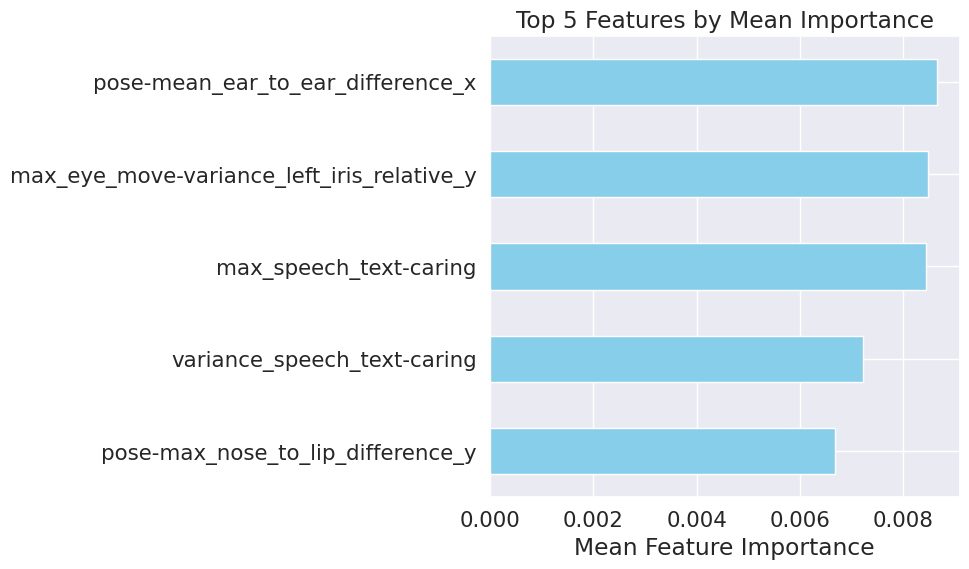

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

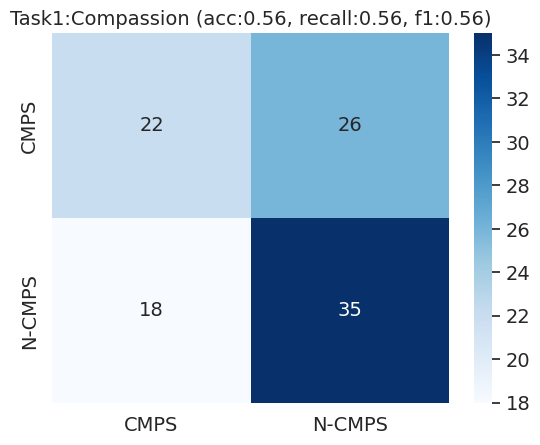

ROC-AUC for Task1:Compassion: 0.5855


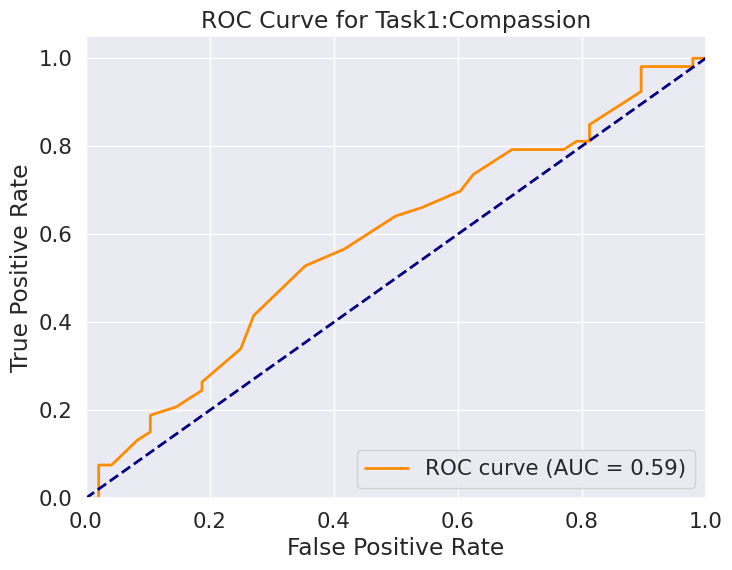

Top 5 Features by Mean Importance:['max_AU02', 'end_to_begin_anger', 'median_surprise', 'max_speech_text-caring', 'max_speech_text-grief']


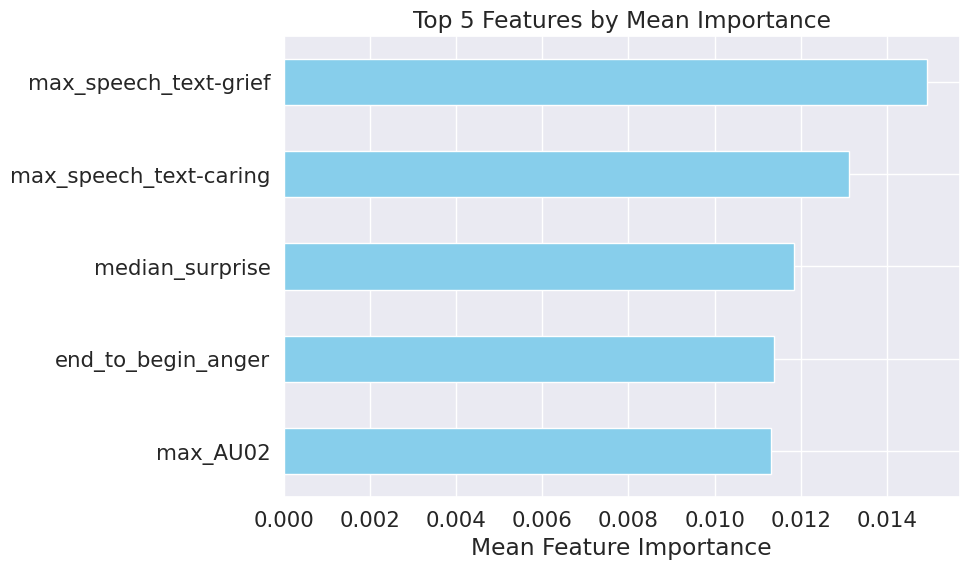

random_state:1
Total Accuracy: 0.5148514851485149
Total Recall: 0.5148514851485149
Total F1 Score: 0.5119570920997837


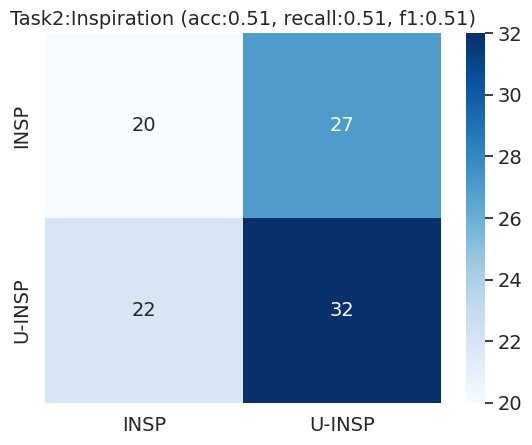

ROC-AUC for Task2:Inspiration: 0.4838


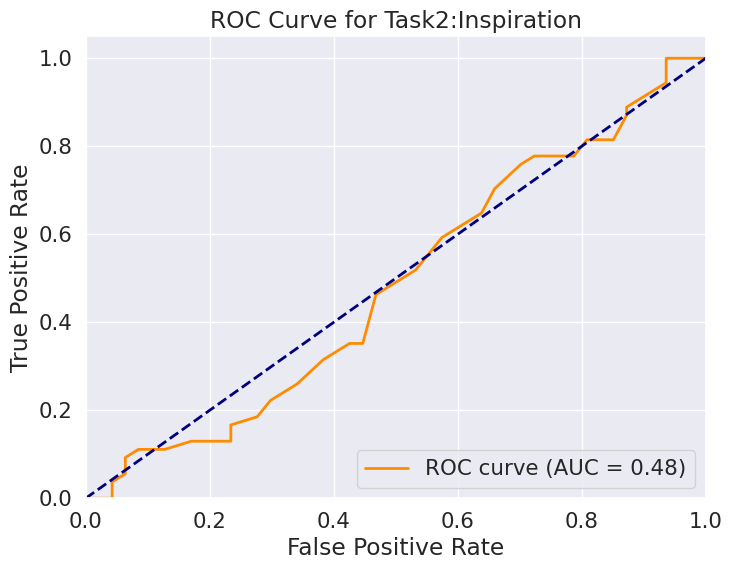

Top 5 Features by Mean Importance:['pose-variance_shoulder_to_shoulder_difference_x', 'end_to_begin_FaceScore', 'max_AU10', 'variance_speech_text-disapproval', 'variance_happiness']


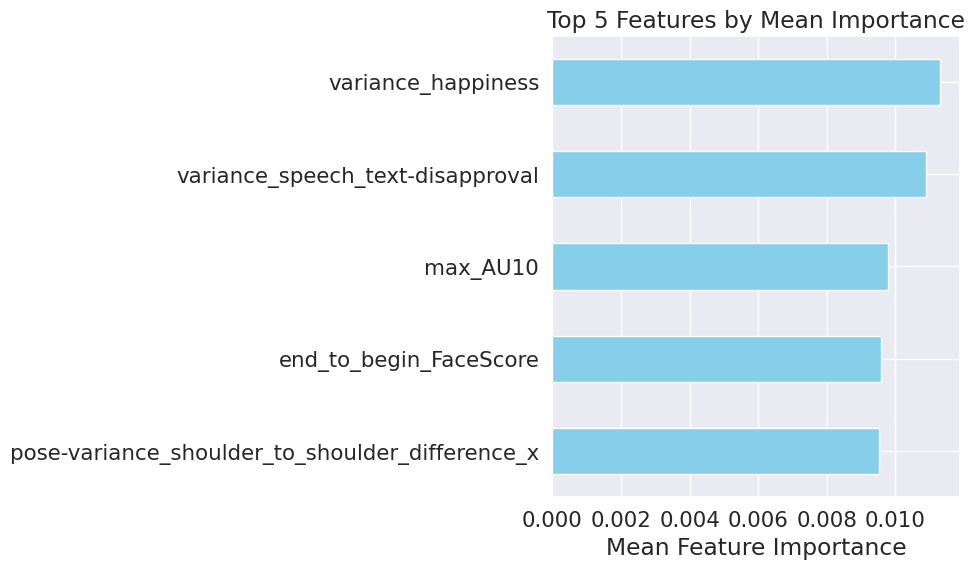

random_state:1
Total Accuracy: 0.39603960396039606
Total Recall: 0.39603960396039606
Total F1 Score: 0.3883766919202041


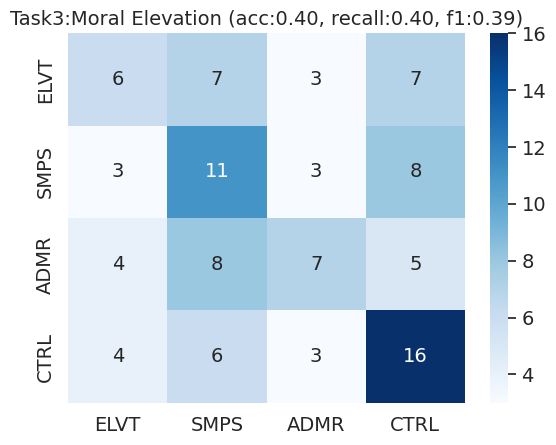

Top 5 Features by Mean Importance:['median_AU12', 'max_speech_text-disapproval', 'pose-max_shoulder_to_shoulder_difference_x', 'max_speech_text-caring', 'pose-mean_ear_to_ear_difference_x']


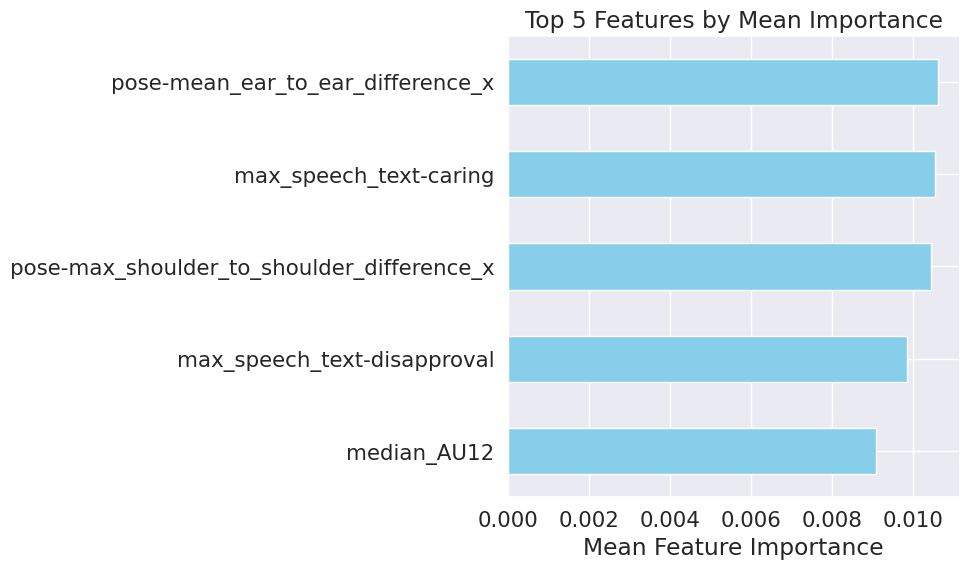

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

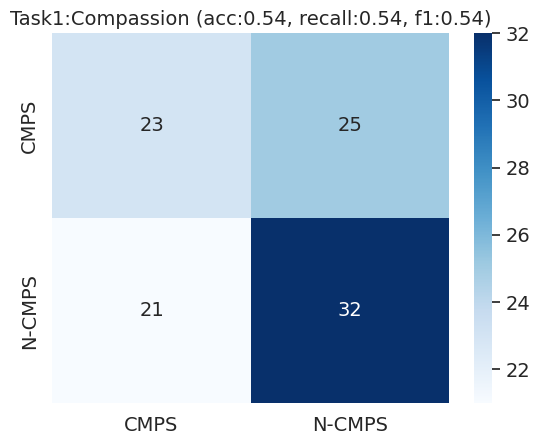

ROC-AUC for Task1:Compassion: 0.5487


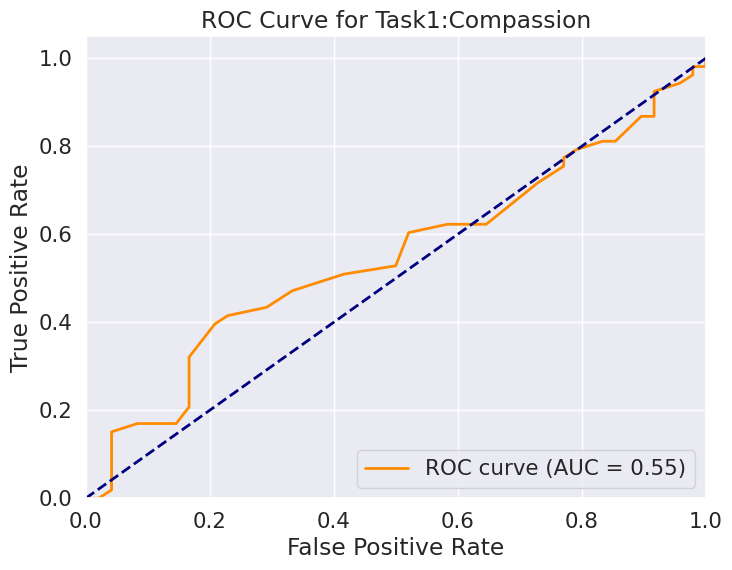

Top 5 Features by Mean Importance:['thermal-end_to_begin_thermal_feature_5', 'max_speech_text-grief', 'variance_speech_text-grief', 'median_AU09', 'median_speech_text-sadness']


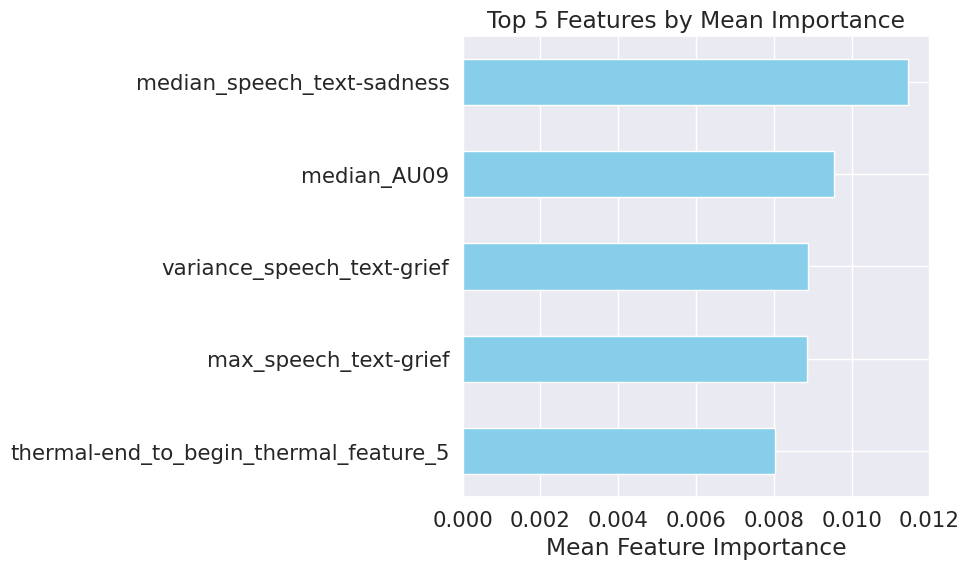

random_state:1
Total Accuracy: 0.48514851485148514
Total Recall: 0.48514851485148514
Total F1 Score: 0.4842327711031973


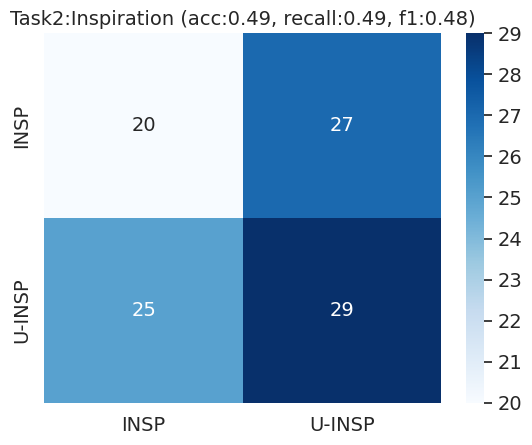

ROC-AUC for Task2:Inspiration: 0.4732


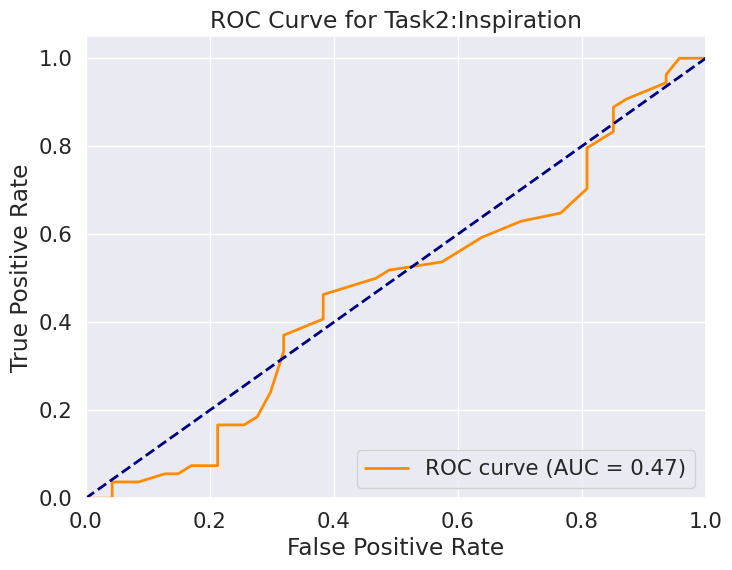

Top 5 Features by Mean Importance:['variance_speech_text-annoyance', 'max_speech_text-relief', 'end_to_begin_FaceScore', 'median_speech_text-surprise', 'variance_happiness']


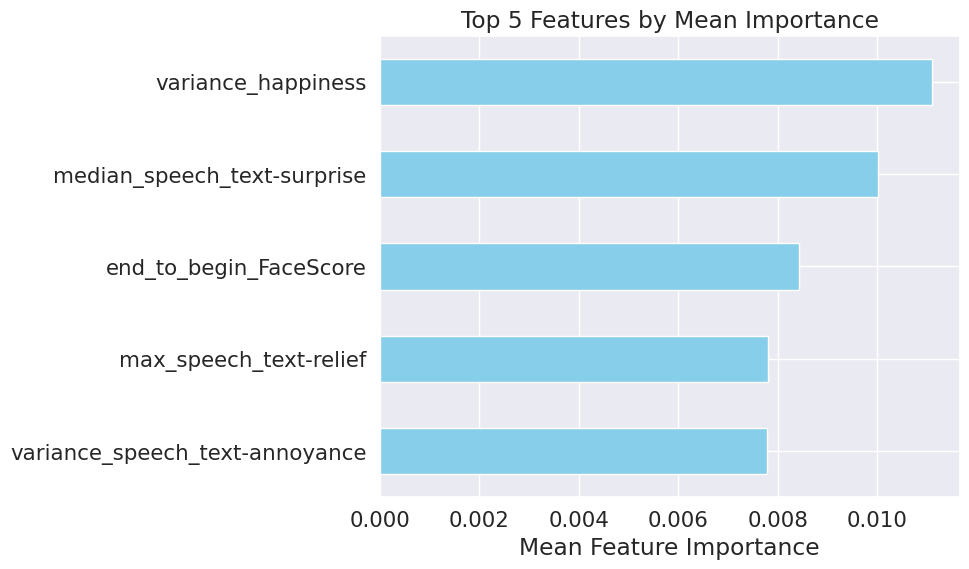

random_state:1
Total Accuracy: 0.26732673267326734
Total Recall: 0.26732673267326734
Total F1 Score: 0.2602161198351377


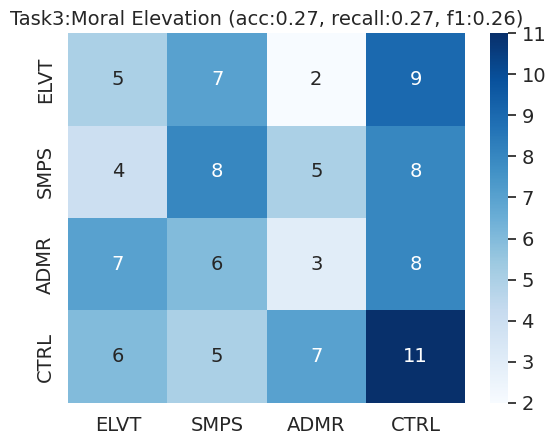

Top 5 Features by Mean Importance:['max_speech_text-disapproval', 'variance_speech_text-annoyance', 'median_speech_text-sadness', 'pose-mean_ear_to_ear_difference_x', 'median_AU12']


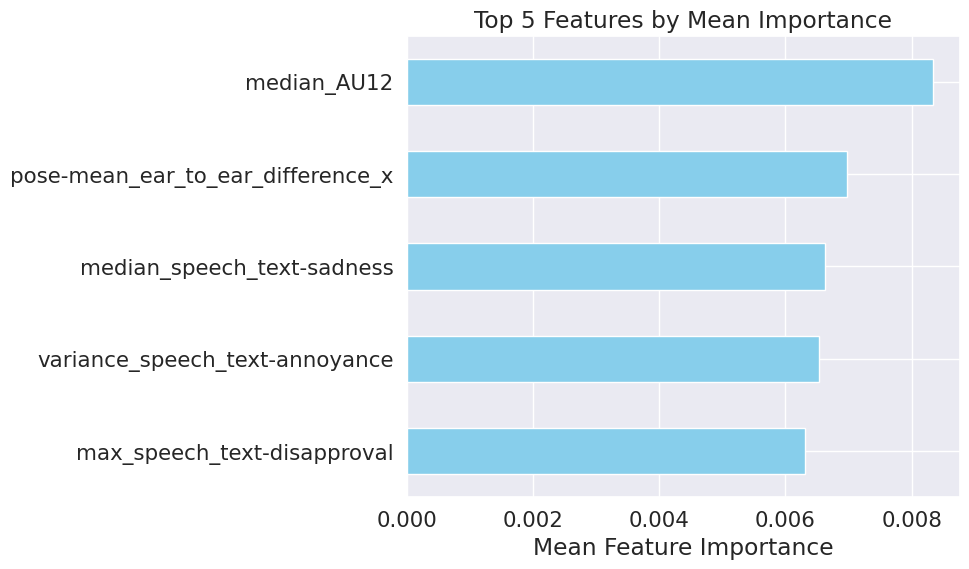

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

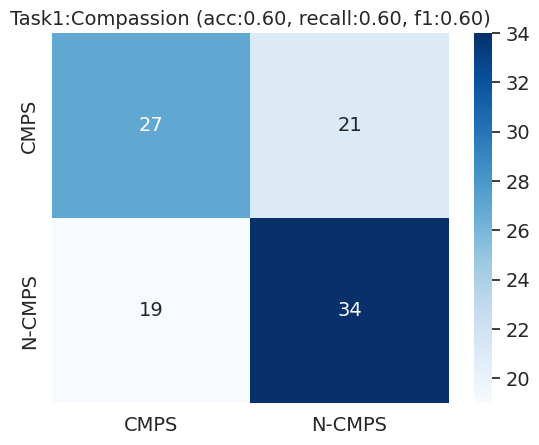

ROC-AUC for Task1:Compassion: 0.6055


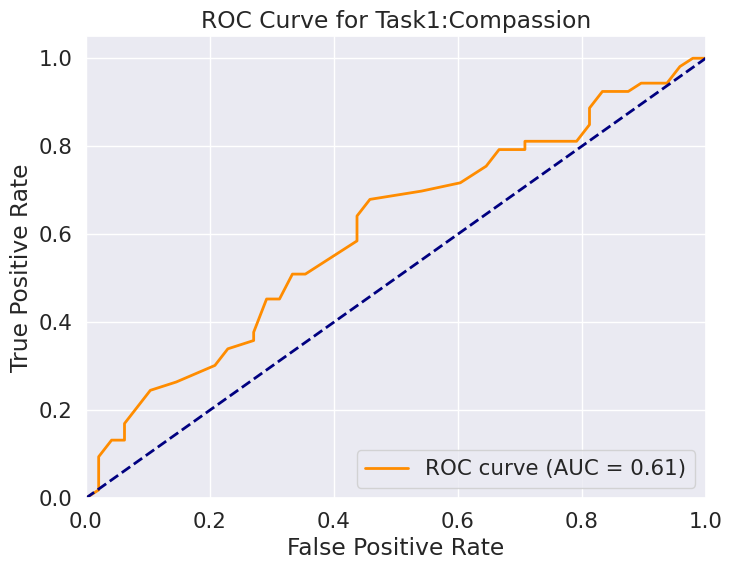

Top 5 Features by Mean Importance:['median_AU09', 'variance_speech_text-sadness', 'median_eye_move-max_left_iris_relative_y', 'end_to_begin_anger', 'variance_speech_text-grief']


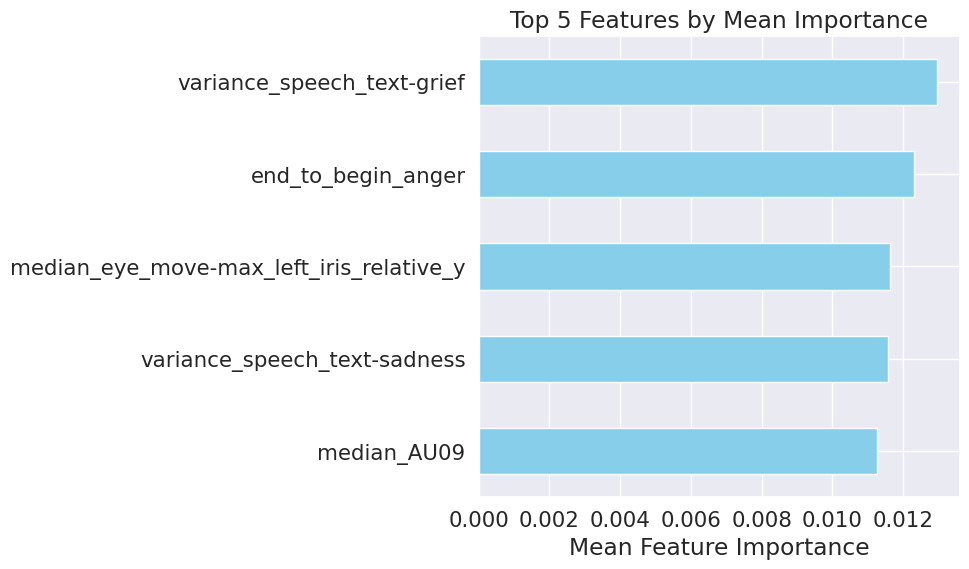

random_state:1
Total Accuracy: 0.5148514851485149
Total Recall: 0.5148514851485149
Total F1 Score: 0.5151378492497553


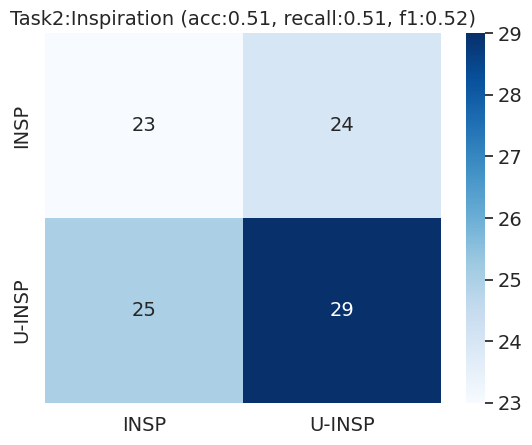

ROC-AUC for Task2:Inspiration: 0.5067


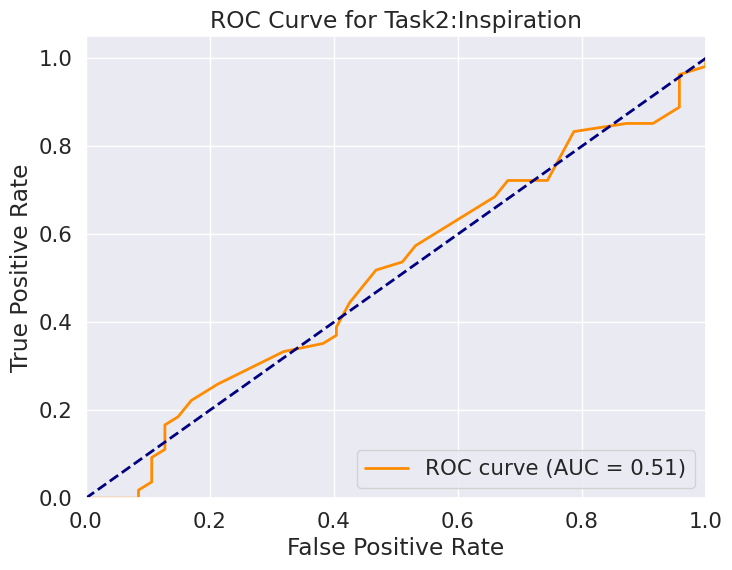

Top 5 Features by Mean Importance:['median_speech_text-love', 'variance_happiness', 'end_to_begin_FaceScore', 'variance_speech_text-disapproval', 'max_speech_text-annoyance']


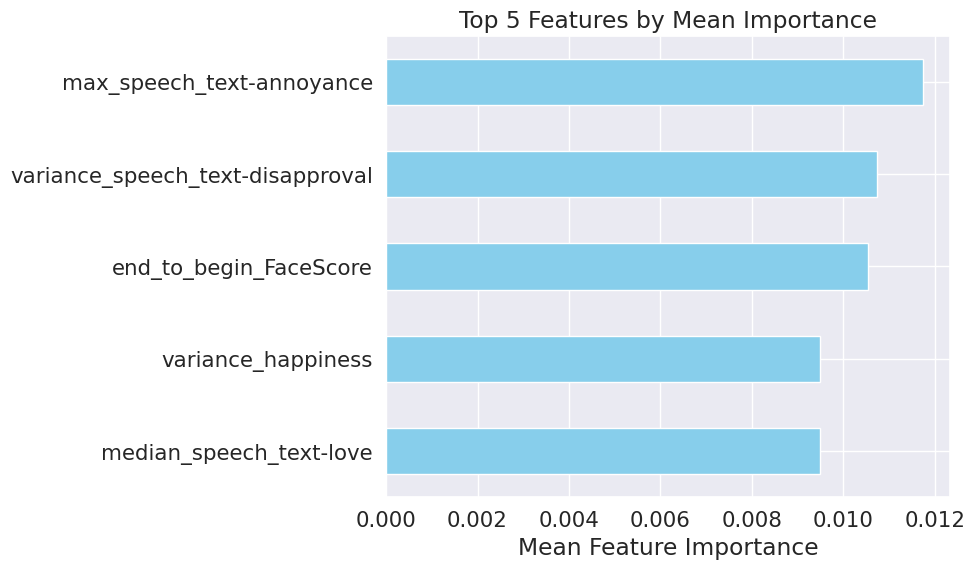

random_state:1
Total Accuracy: 0.36633663366336633
Total Recall: 0.36633663366336633
Total F1 Score: 0.348776914987153


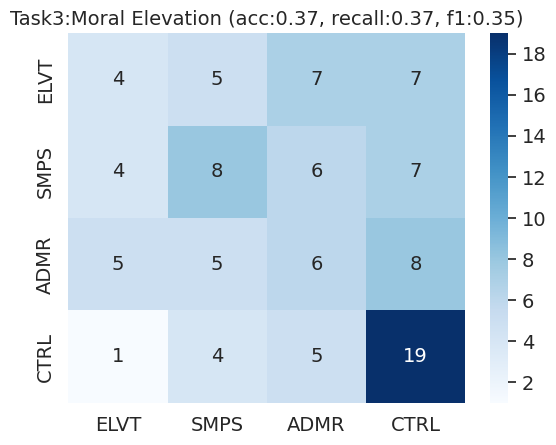

Top 5 Features by Mean Importance:['variance_speech_text-optimism', 'max_speech_text-disapproval', 'end_to_begin_surprise', 'max_speech_text-caring', 'variance_speech_text-disapproval']


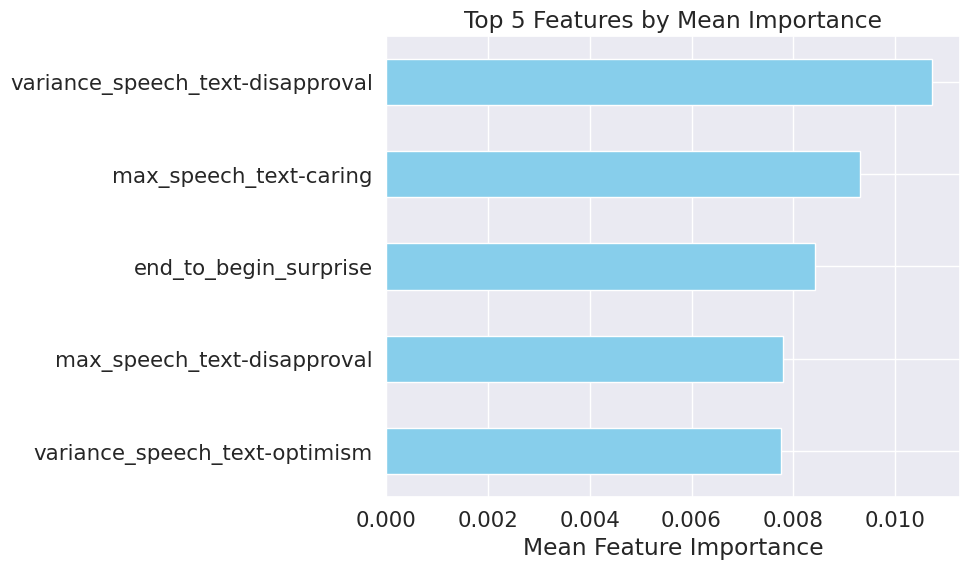

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

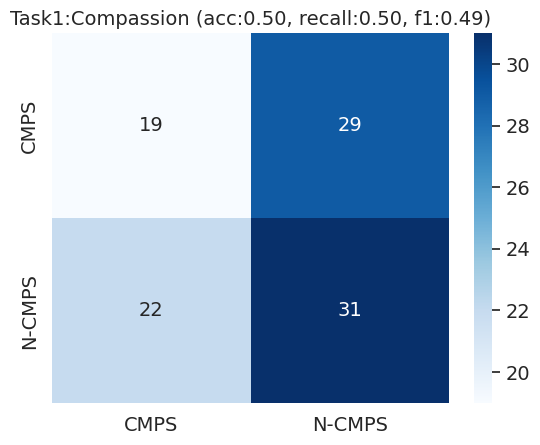

ROC-AUC for Task1:Compassion: 0.5307


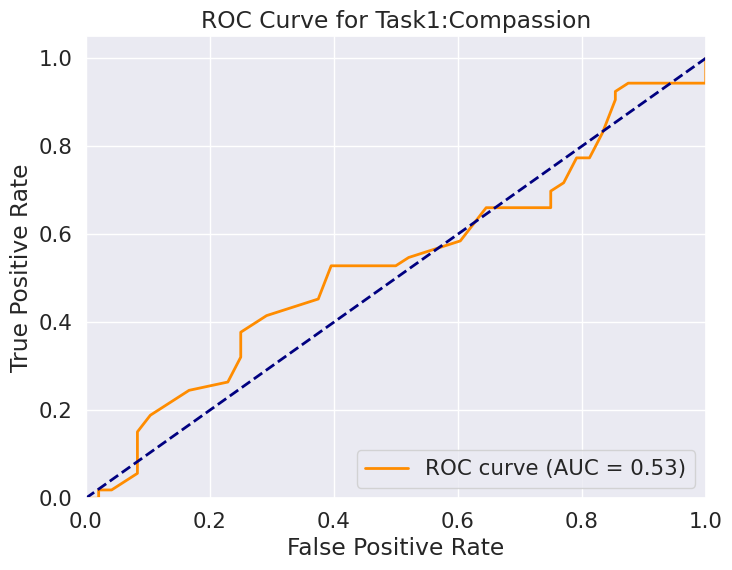

Top 5 Features by Mean Importance:['variance_speech_text-caring', 'median_AU24', 'end_to_begin_anger', 'max_speech_text-caring', 'thermal-end_to_begin_thermal_feature_5']


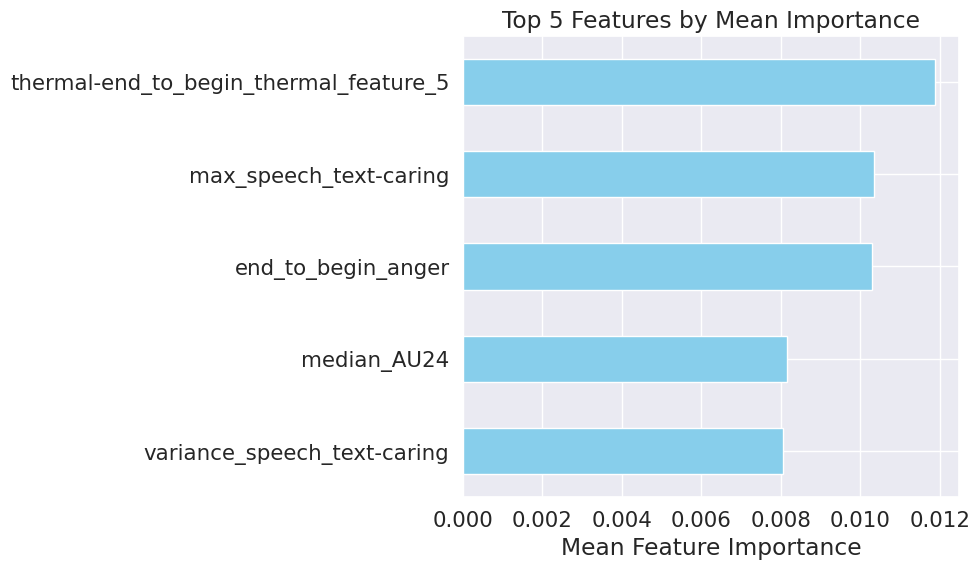

random_state:1
Total Accuracy: 0.504950495049505
Total Recall: 0.504950495049505
Total F1 Score: 0.5011014259320669


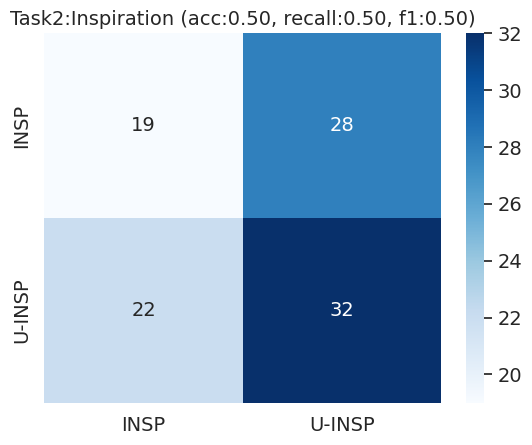

ROC-AUC for Task2:Inspiration: 0.4947


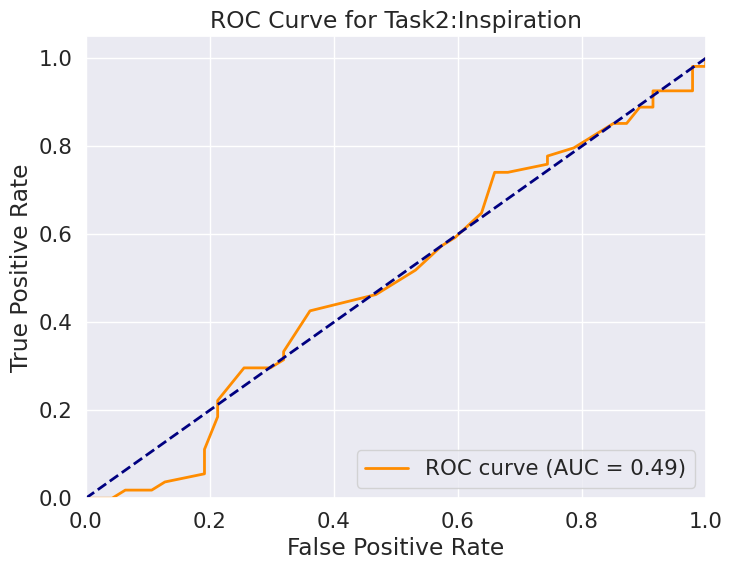

Top 5 Features by Mean Importance:['variance_speech_text-annoyance', 'variance_happiness', 'max_speech_text-caring', 'end_to_begin_FaceScore', 'max_AU10']


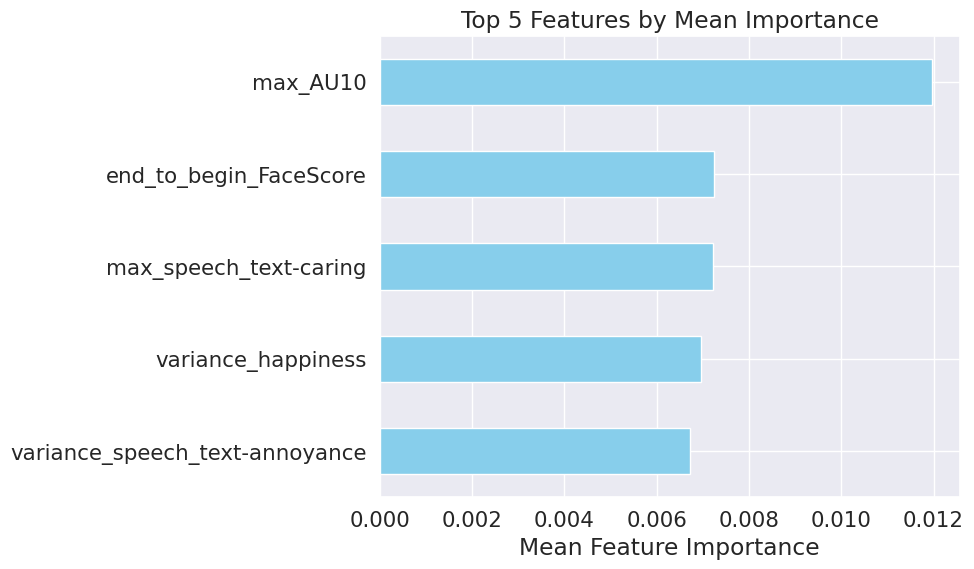

random_state:1
Total Accuracy: 0.26732673267326734
Total Recall: 0.26732673267326734
Total F1 Score: 0.2530159138362815


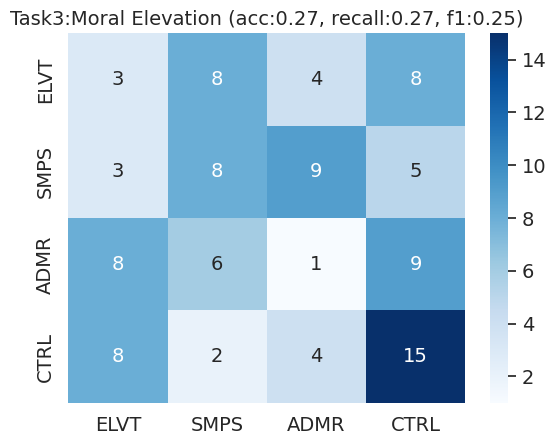

Top 5 Features by Mean Importance:['variance_speech_text-optimism', 'thermal-end_to_begin_thermal_feature_46', 'max_speech_text-disapproval', 'variance_speech_text-caring', 'max_speech_text-caring']


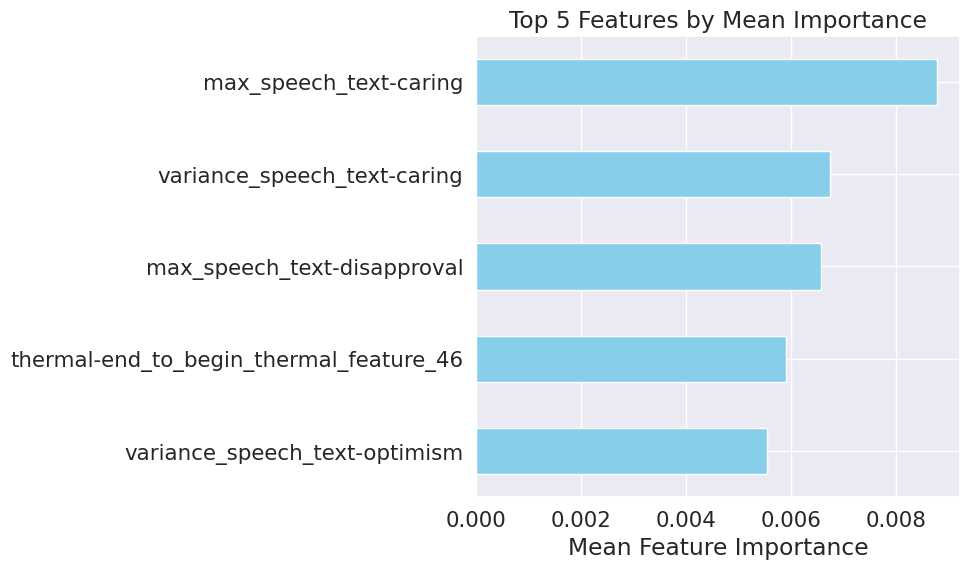

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

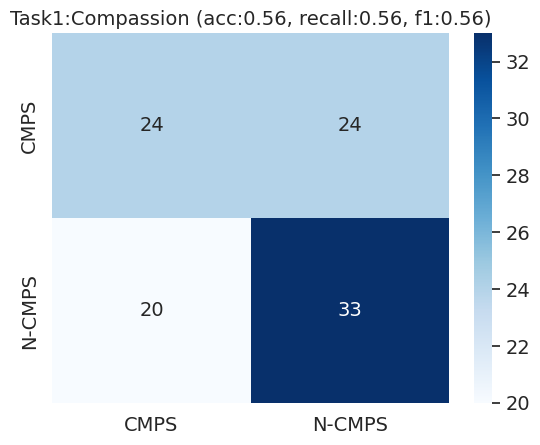

ROC-AUC for Task1:Compassion: 0.5546


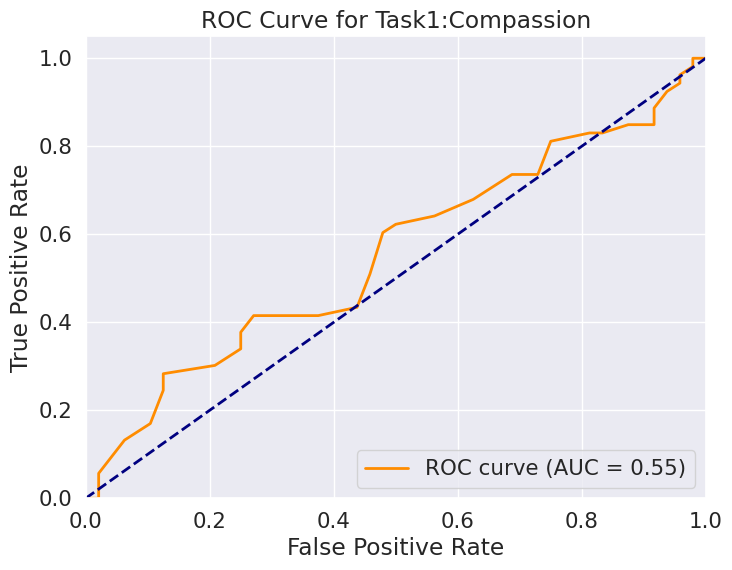

Top 5 Features by Mean Importance:['variance_speech_text-grief', 'median_speech_text-grief', 'max_speech_text-grief', 'thermal-end_to_begin_thermal_feature_5', 'max_speech_text-caring']


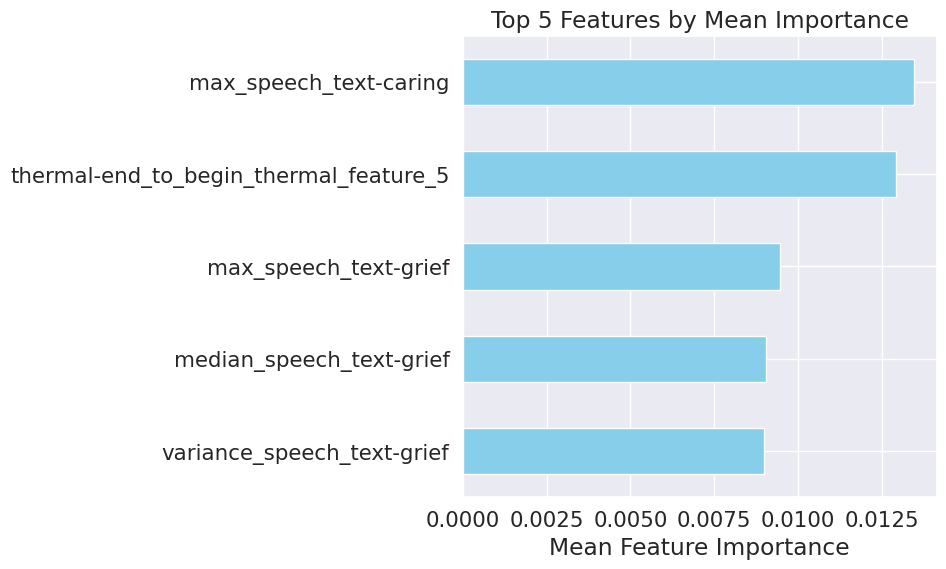

random_state:1
Total Accuracy: 0.49504950495049505
Total Recall: 0.49504950495049505
Total F1 Score: 0.48492697806785845


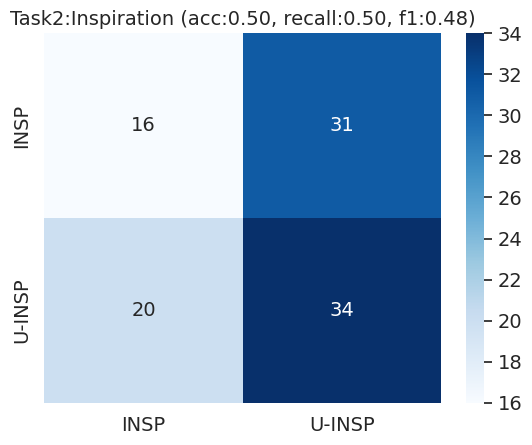

ROC-AUC for Task2:Inspiration: 0.5150


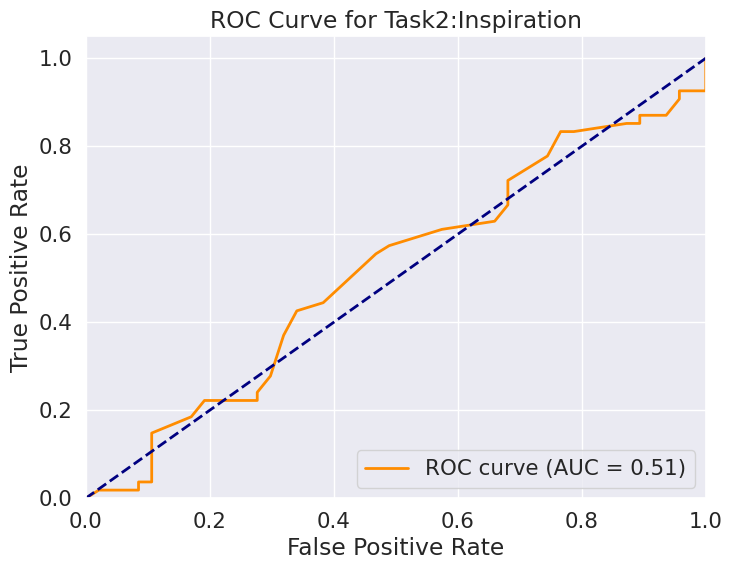

Top 5 Features by Mean Importance:['max_speech_text-annoyance', 'max_speech_text-optimism', 'median_speech_text-surprise', 'median_AU10', 'end_to_begin_FaceScore']


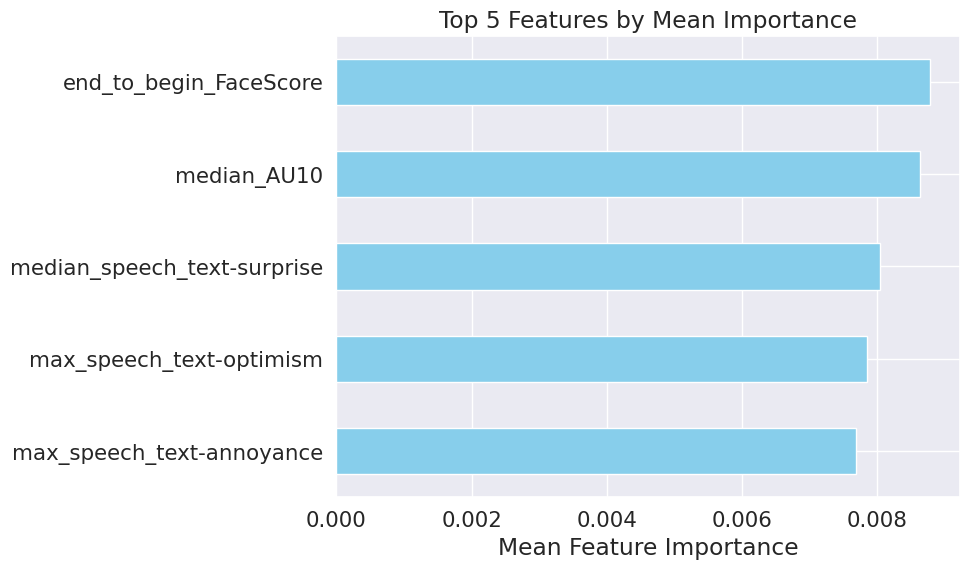

random_state:1
Total Accuracy: 0.26732673267326734
Total Recall: 0.26732673267326734
Total F1 Score: 0.260370892785814


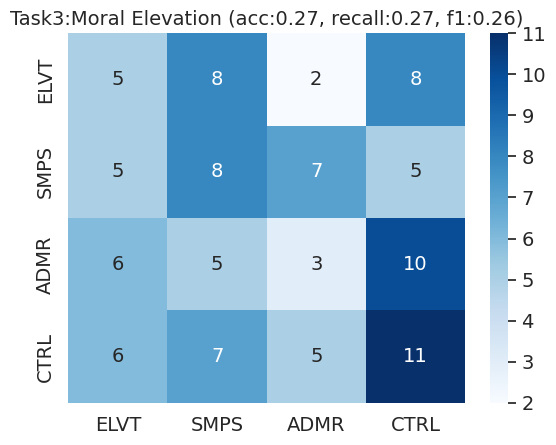

Top 5 Features by Mean Importance:['thermal-end_to_begin_thermal_feature_46', 'median_speech_text-joy', 'variance_speech_text-disapproval', 'max_speech_text-disapproval', 'max_speech_text-caring']


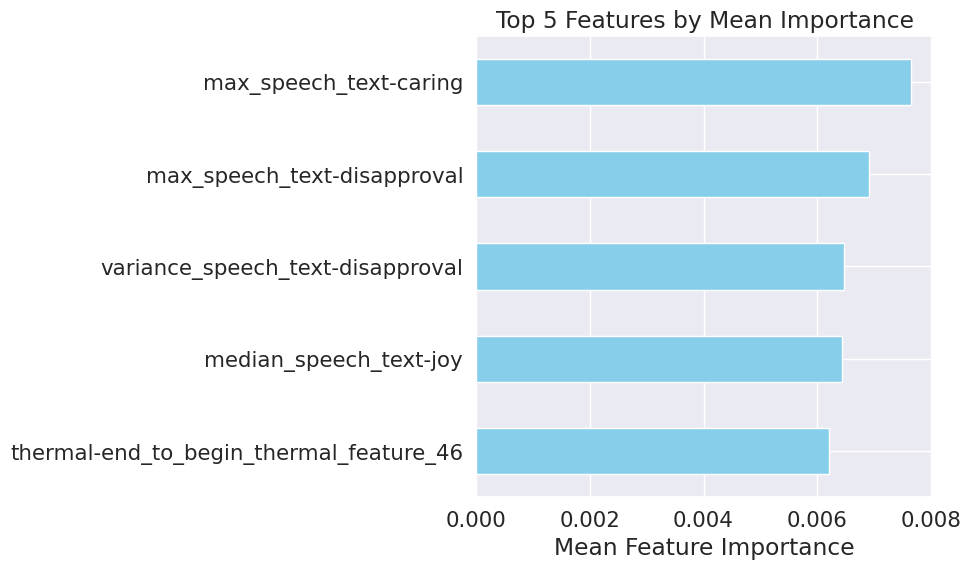

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

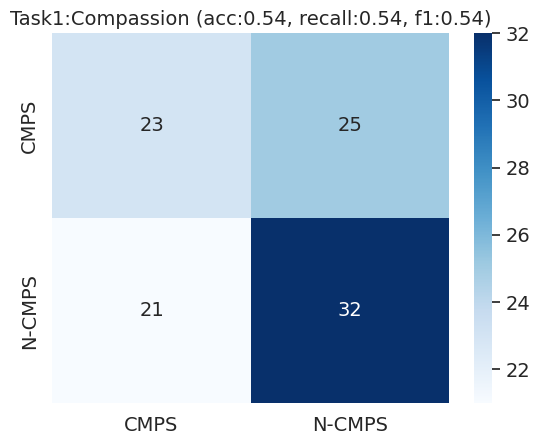

ROC-AUC for Task1:Compassion: 0.5965


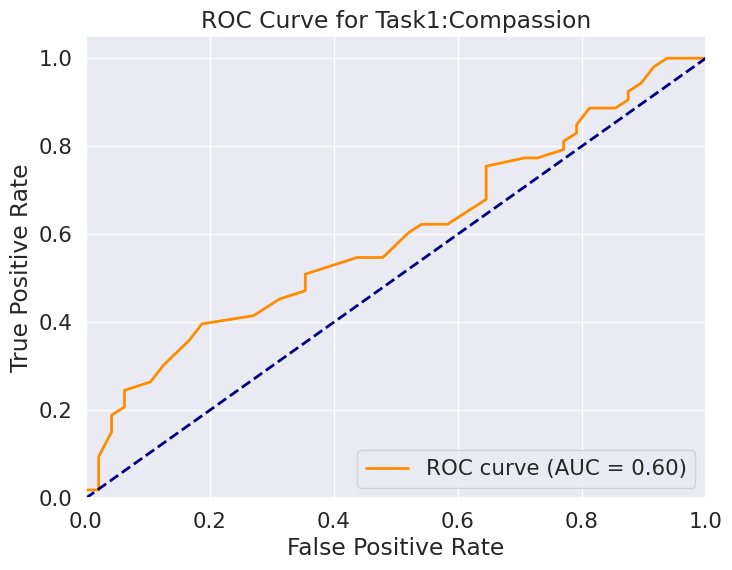

Top 5 Features by Mean Importance:['variance_speech_text-sadness', 'max_speech_text-grief', 'median_eye_move-max_left_iris_relative_y', 'median_speech_text-sadness', 'max_speech_text-caring']


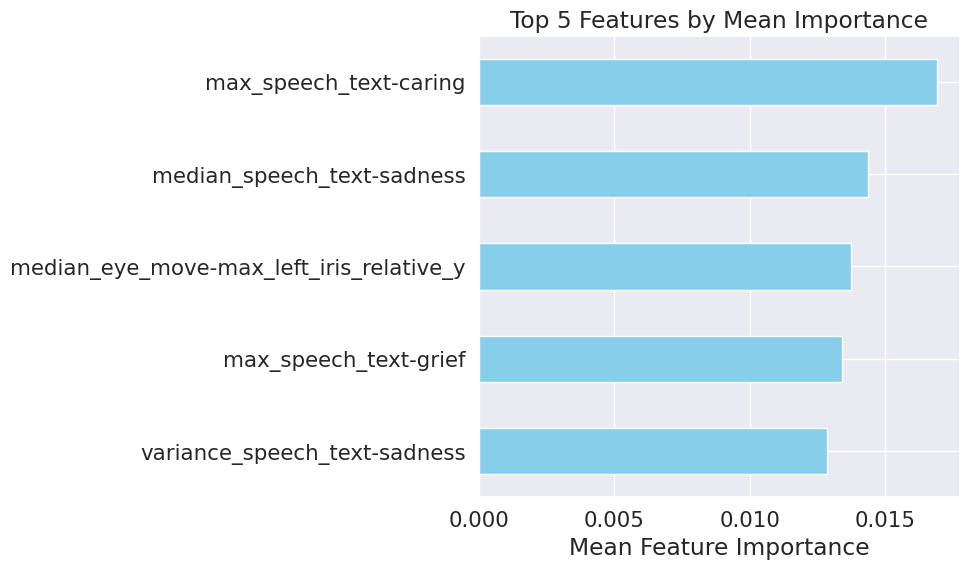

random_state:1
Total Accuracy: 0.5742574257425742
Total Recall: 0.5742574257425742
Total F1 Score: 0.5729929690325729


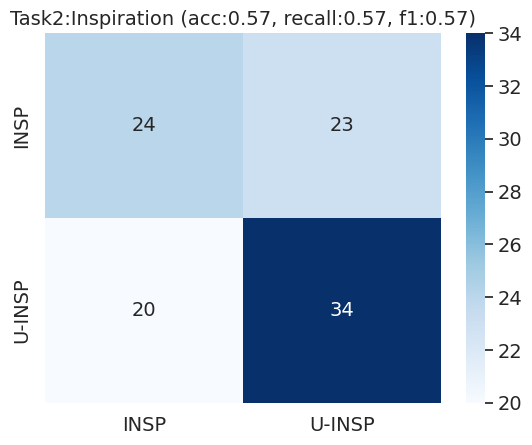

ROC-AUC for Task2:Inspiration: 0.5798


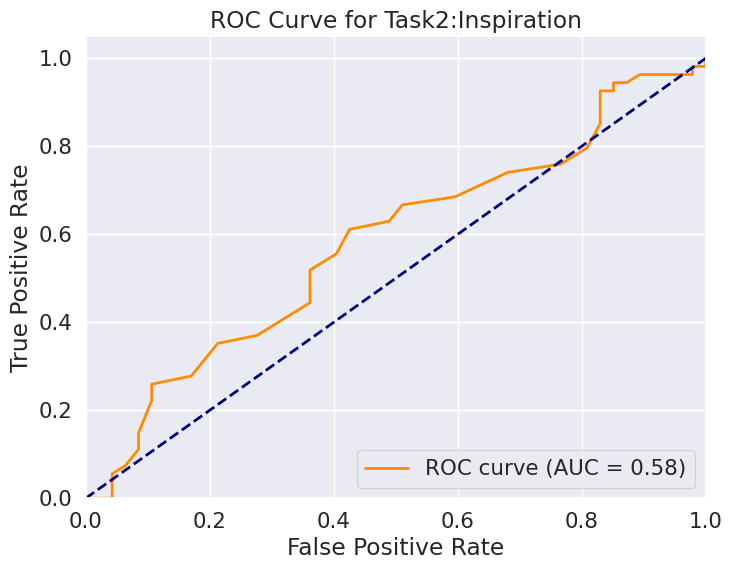

Top 5 Features by Mean Importance:['variance_speech_text-annoyance', 'median_speech_text-sadness', 'pose-max_nose_to_lip_difference_y', 'median_speech_text-surprise', 'median_speech_text-love']


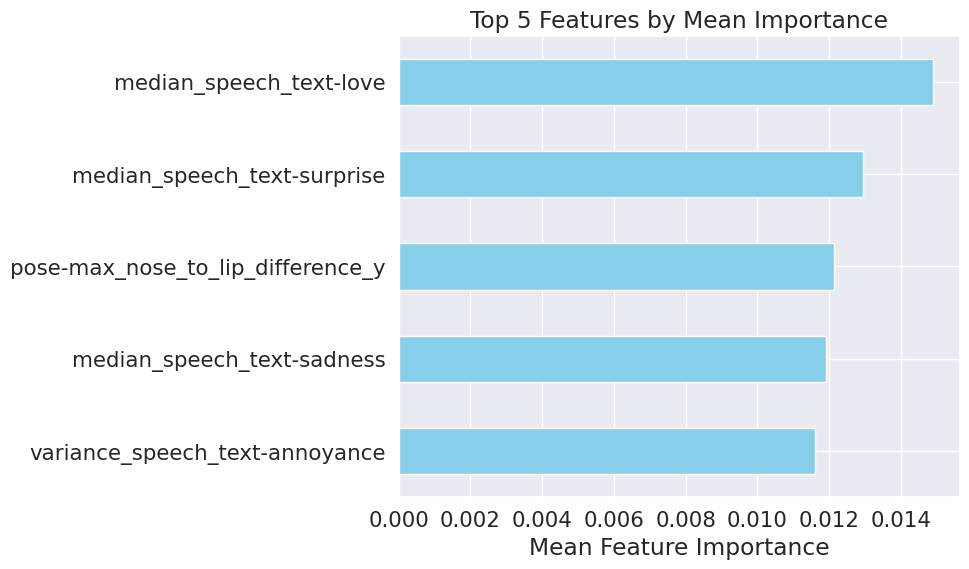

random_state:1
Total Accuracy: 0.32673267326732675
Total Recall: 0.32673267326732675
Total F1 Score: 0.3117569132478859


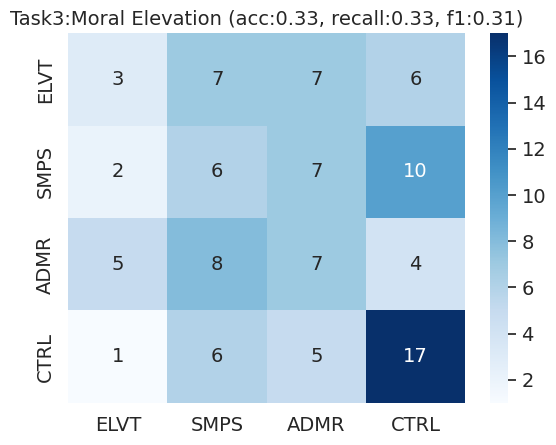

Top 5 Features by Mean Importance:['variance_speech_text-disapproval', 'pose-mean_ear_to_ear_difference_x', 'pose-max_shoulder_to_shoulder_difference_y', 'max_speech_text-caring', 'pose-mean_nose_to_lip_difference_y']


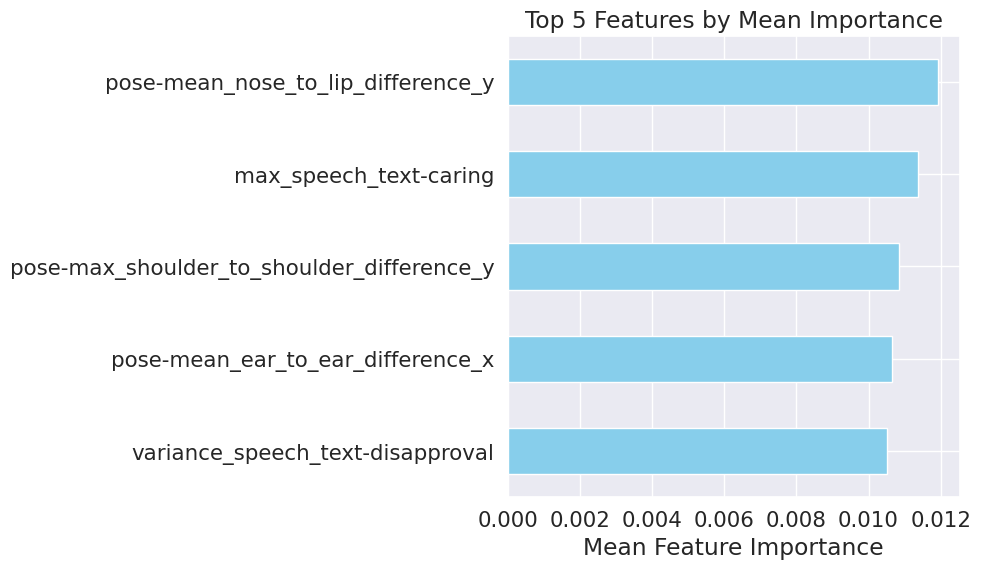

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

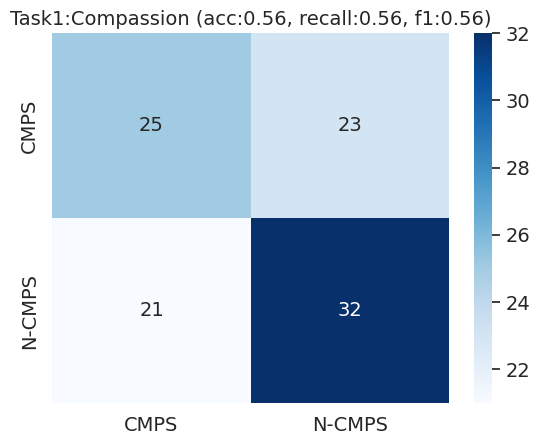

ROC-AUC for Task1:Compassion: 0.5517


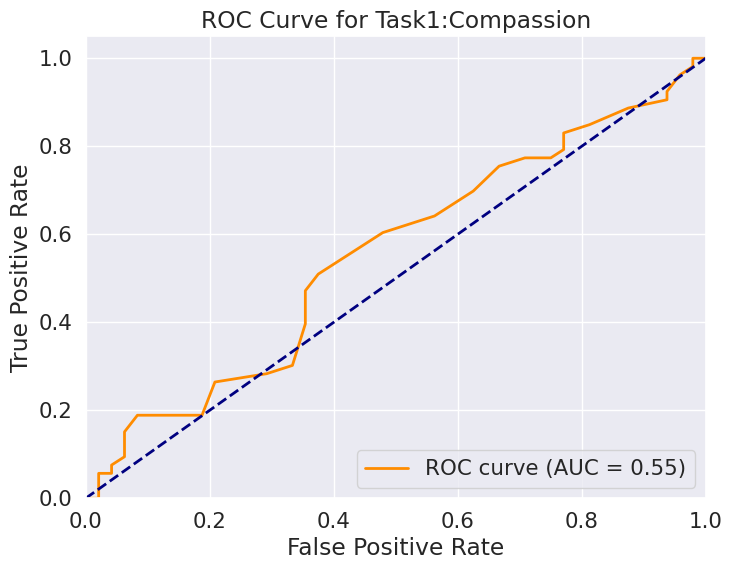

Top 5 Features by Mean Importance:['variance_speech_text-grief', 'max_speech_text-grief', 'variance_speech_text-sadness', 'thermal-end_to_begin_thermal_feature_5', 'max_speech_text-caring']


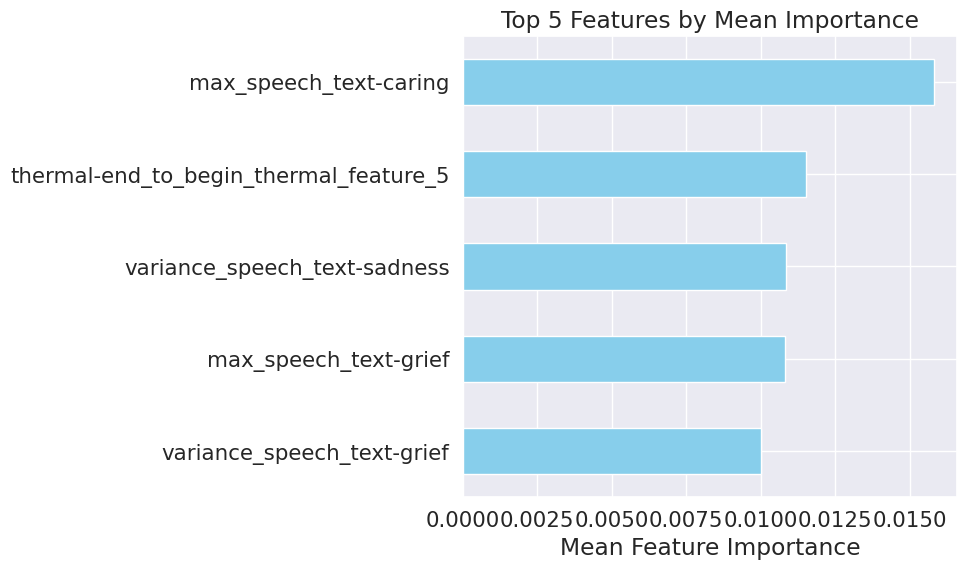

random_state:1
Total Accuracy: 0.43564356435643564
Total Recall: 0.43564356435643564
Total F1 Score: 0.43011563525168106


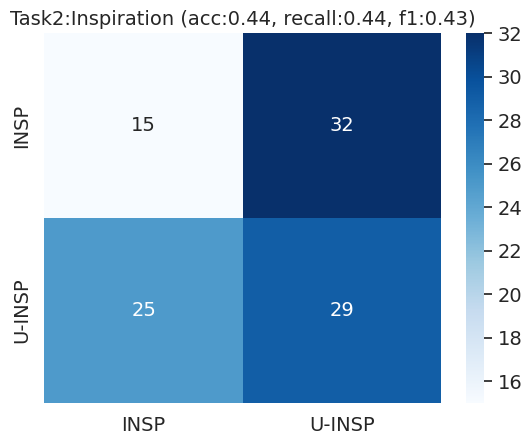

ROC-AUC for Task2:Inspiration: 0.4129


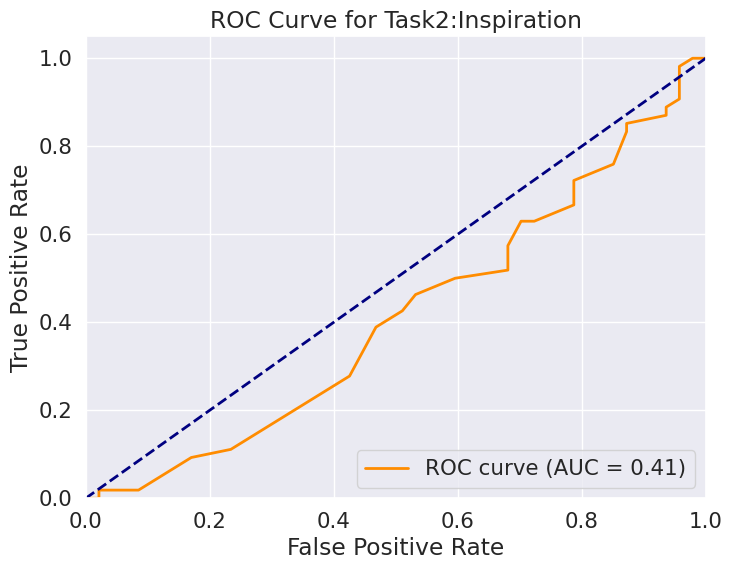

Top 5 Features by Mean Importance:['median_eye_move-mean_right_iris_relative_x', 'variance_speech_text-annoyance', 'max_speech_text-annoyance', 'max_speech_text-caring', 'variance_speech_text-embarrassment']


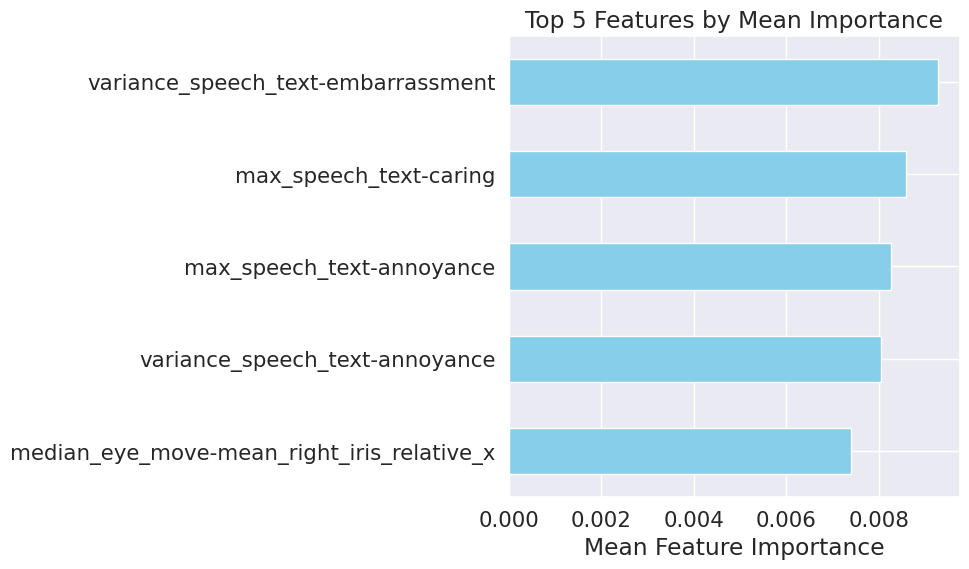

random_state:1
Total Accuracy: 0.31683168316831684
Total Recall: 0.31683168316831684
Total F1 Score: 0.29526854874269914


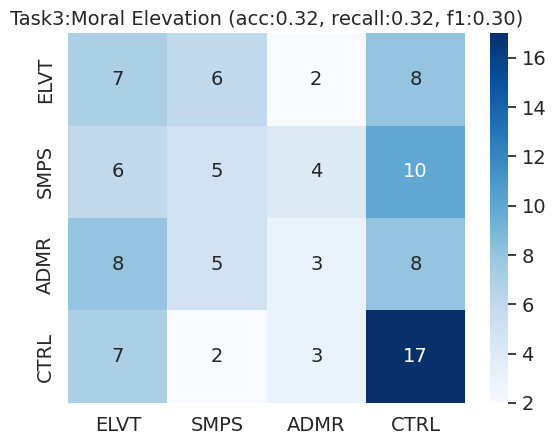

Top 5 Features by Mean Importance:['max_speech_text-disapproval', 'median_speech_text-joy', 'variance_speech_text-disapproval', 'max_speech_text-caring', 'pose-mean_ear_to_ear_difference_x']


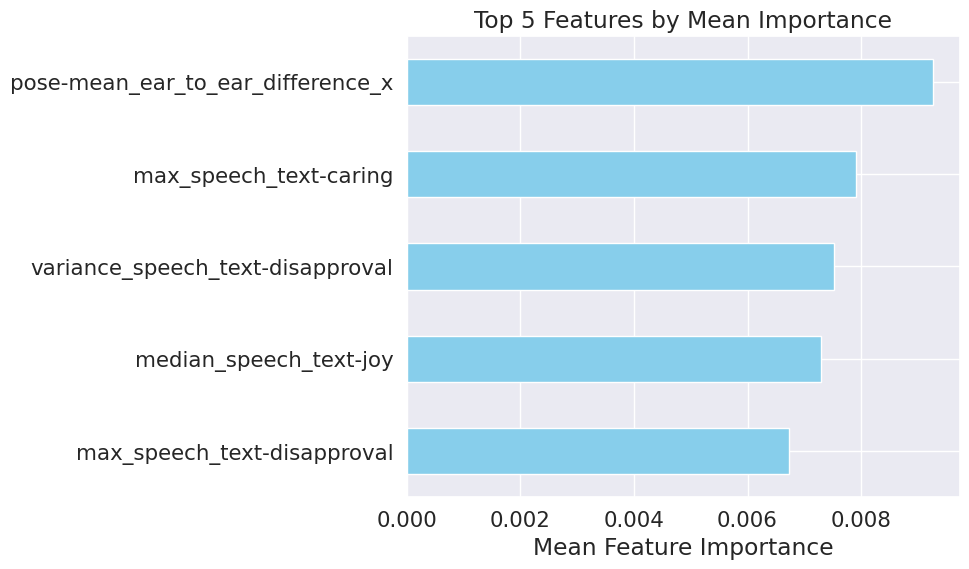

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

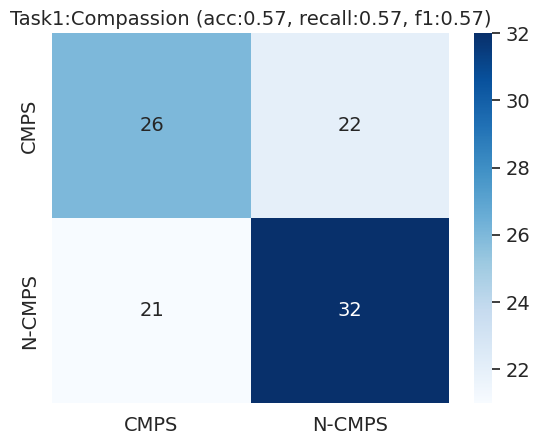

ROC-AUC for Task1:Compassion: 0.5680


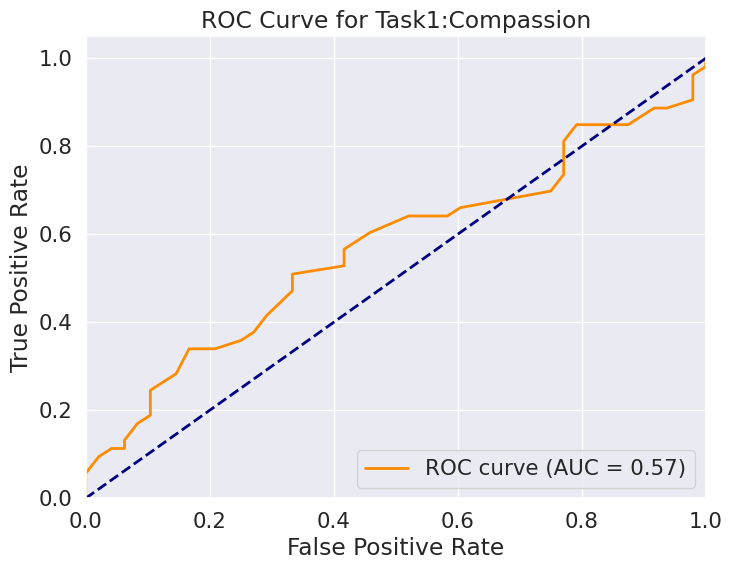

Top 5 Features by Mean Importance:['variance_speech_text-caring', 'median_speech_text-sadness', 'variance_speech_text-grief', 'thermal-end_to_begin_thermal_feature_5', 'max_speech_text-caring']


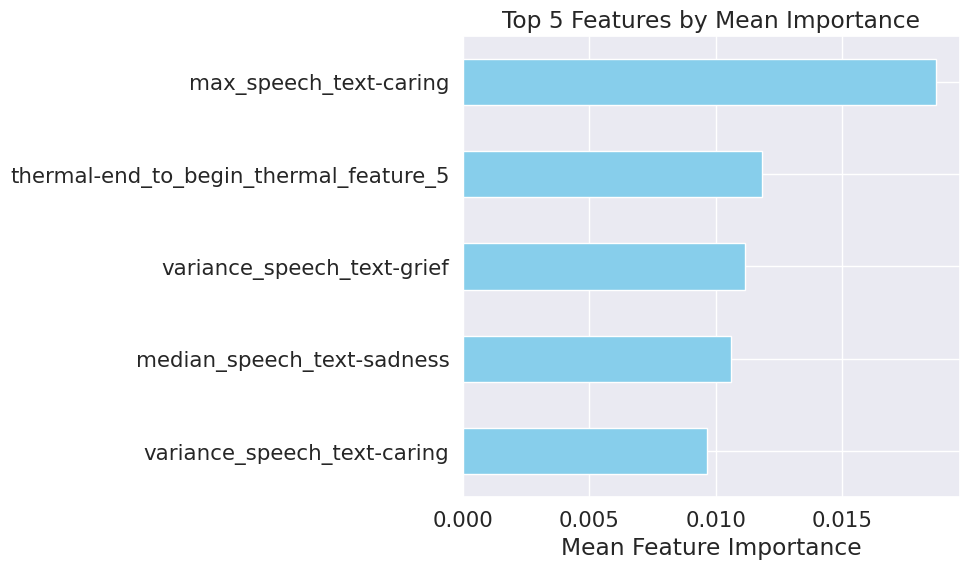

random_state:1
Total Accuracy: 0.49504950495049505
Total Recall: 0.49504950495049505
Total F1 Score: 0.48773800456968774


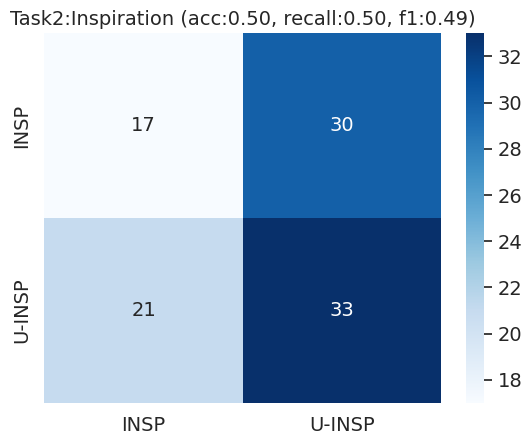

ROC-AUC for Task2:Inspiration: 0.4777


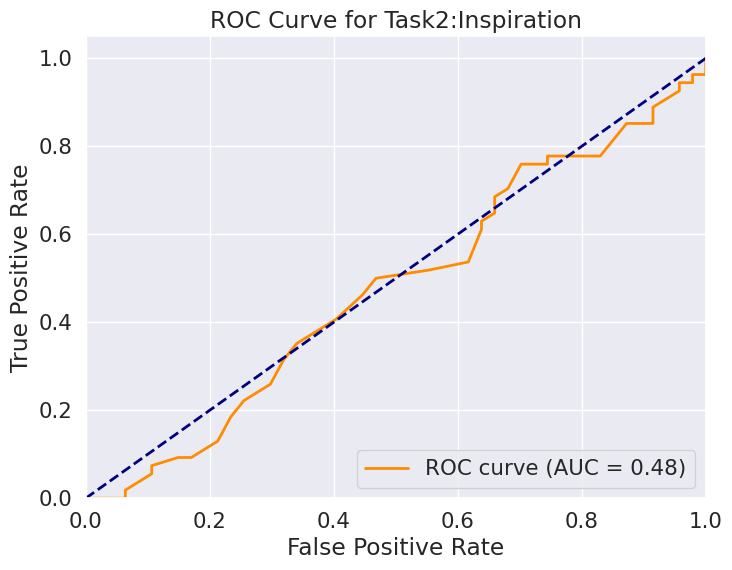

Top 5 Features by Mean Importance:['max_speech_text-annoyance', 'variance_speech_text-optimism', 'max_speech_text-disapproval', 'pose-max_nose_to_lip_difference_y', 'max_speech_text-caring']


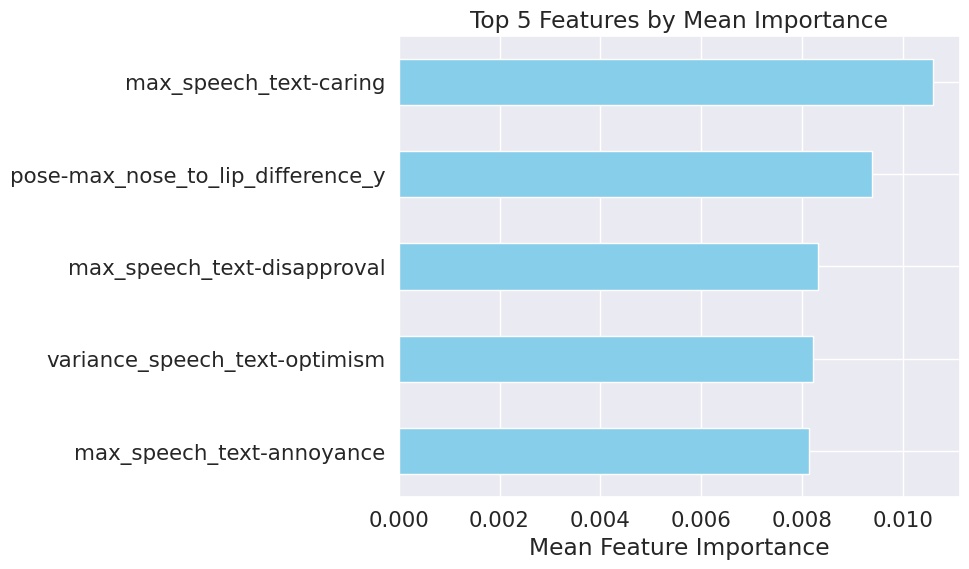

random_state:1
Total Accuracy: 0.2871287128712871
Total Recall: 0.2871287128712871
Total F1 Score: 0.27018879544231983


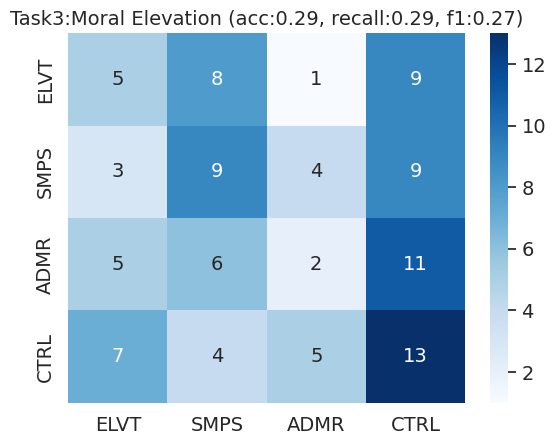

Top 5 Features by Mean Importance:['median_speech_text-neutral', 'median_speech_text-joy', 'pose-mean_ear_to_ear_difference_x', 'max_speech_text-disapproval', 'max_speech_text-caring']


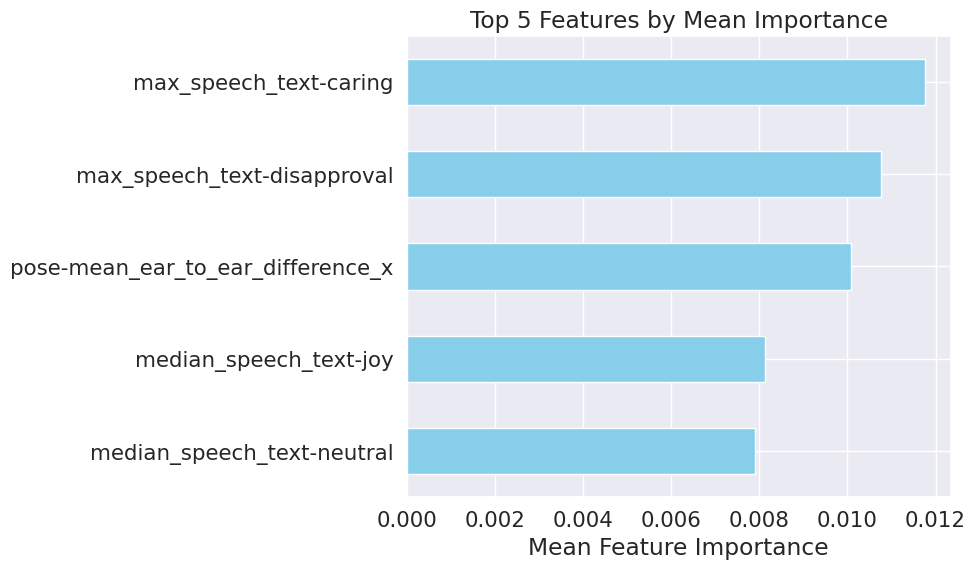

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

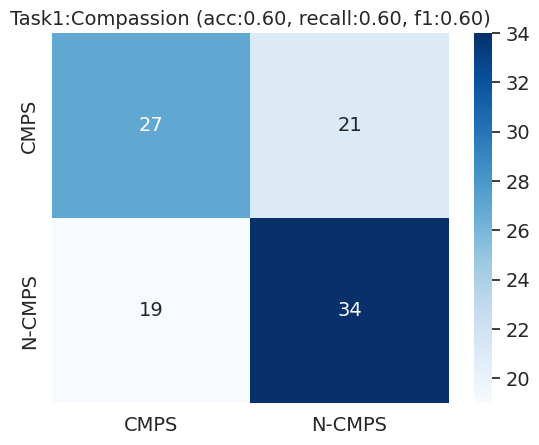

ROC-AUC for Task1:Compassion: 0.6425


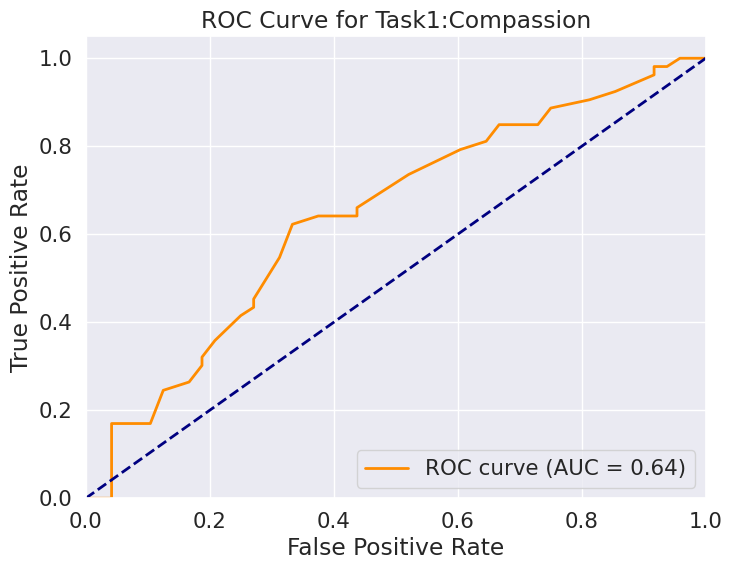

Top 5 Features by Mean Importance:['median_eye_move-max_left_iris_relative_y', 'median_speech_text-disapproval', 'max_speech_text-caring', 'thermal-end_to_begin_thermal_feature_5', 'variance_speech_text-caring']


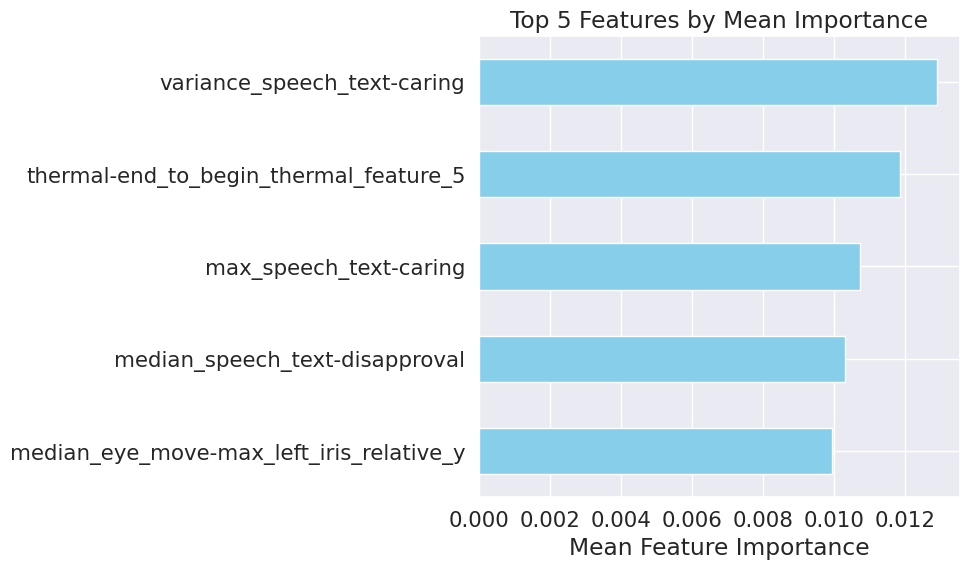

random_state:1
Total Accuracy: 0.48514851485148514
Total Recall: 0.48514851485148514
Total F1 Score: 0.4829011472575829


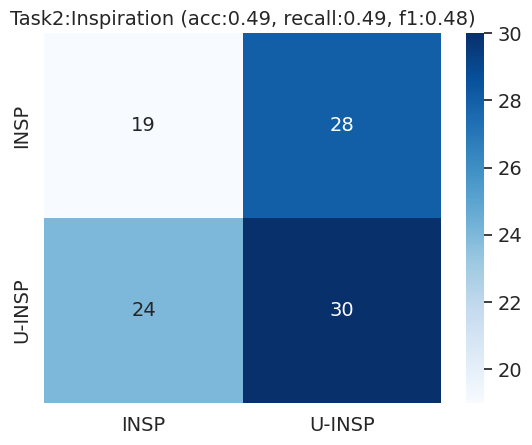

ROC-AUC for Task2:Inspiration: 0.4433


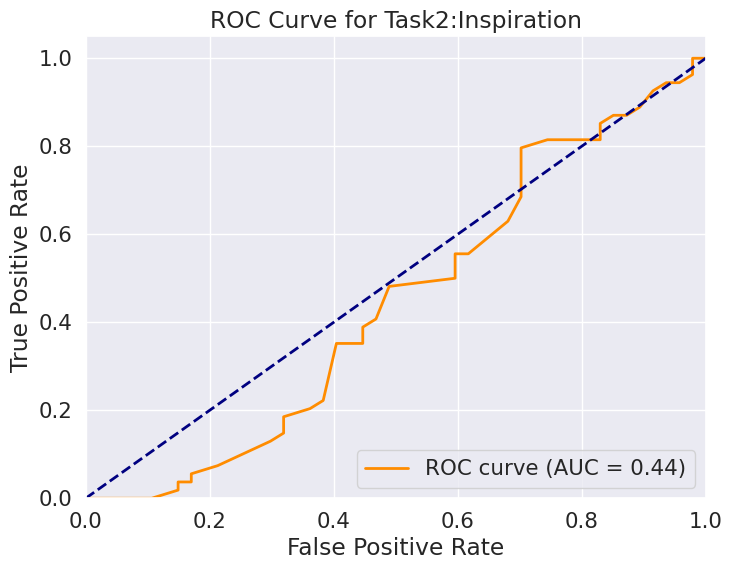

Top 5 Features by Mean Importance:['max_speech_text-annoyance', 'median_eye_move-mean_right_eye_height', 'variance_speech_text-annoyance', 'variance_speech_text-disapproval', 'max_speech_text-disapproval']


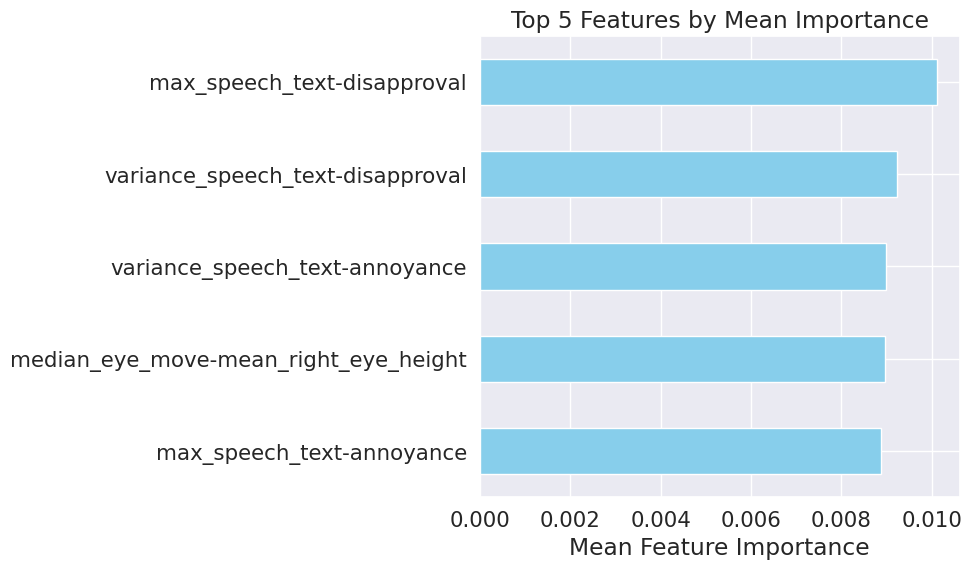

random_state:1
Total Accuracy: 0.31683168316831684
Total Recall: 0.31683168316831684
Total F1 Score: 0.30945122924331875


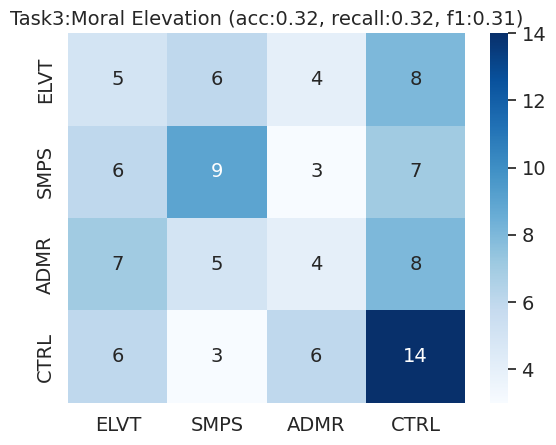

Top 5 Features by Mean Importance:['thermal-end_to_begin_thermal_feature_46', 'max_eye_move-variance_left_iris_relative_y', 'max_speech_text-disapproval', 'variance_speech_text-disapproval', 'median_speech_text-caring']


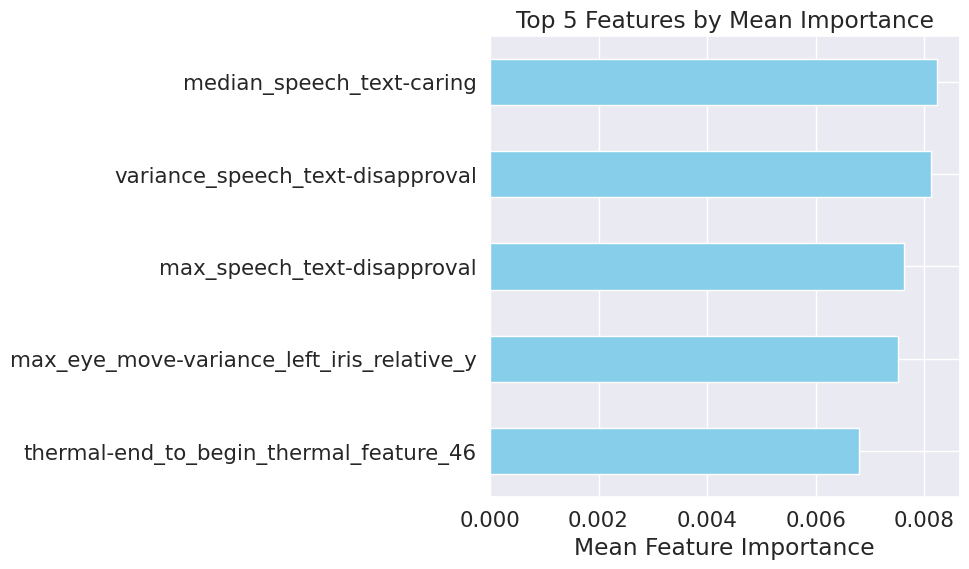

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

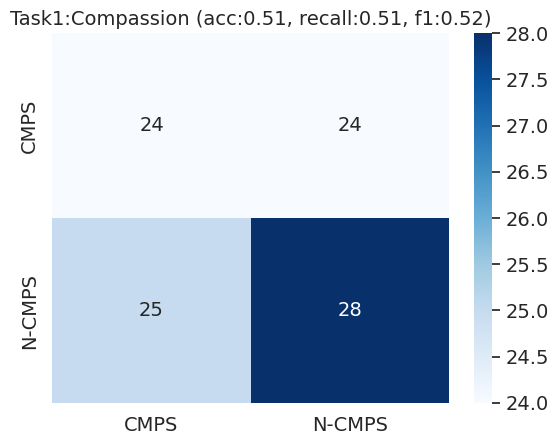

ROC-AUC for Task1:Compassion: 0.4591


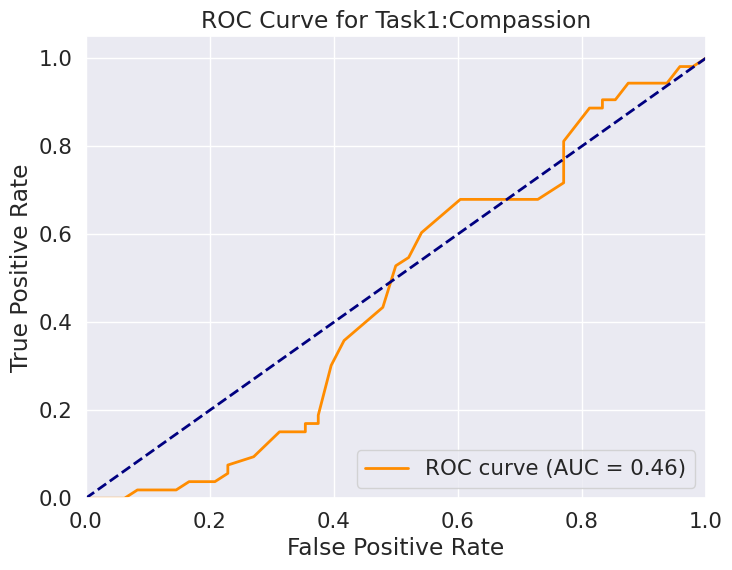

Top 5 Features by Mean Importance:['thermal-variance_thermal_feature_53', 'median_eye_move-mean_right_iris_relative_y', 'pose-max_left_head_angle', 'median_eye_move-end_to_begin_right_iris_relative_y', 'max_eye_move-end_to_begin_right_iris_relative_x']


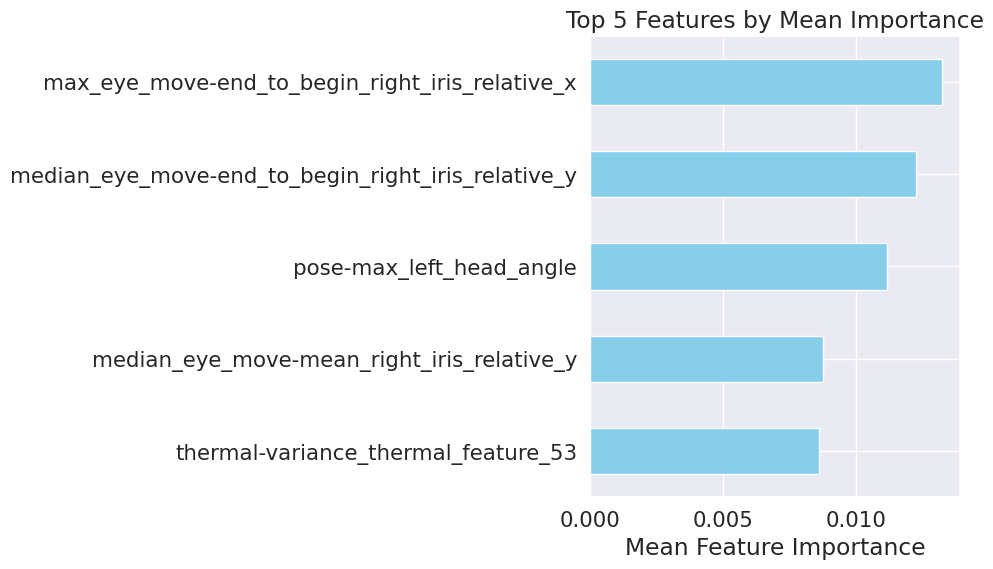

random_state:1
Total Accuracy: 0.5544554455445545
Total Recall: 0.5544554455445545
Total F1 Score: 0.5541924581046398


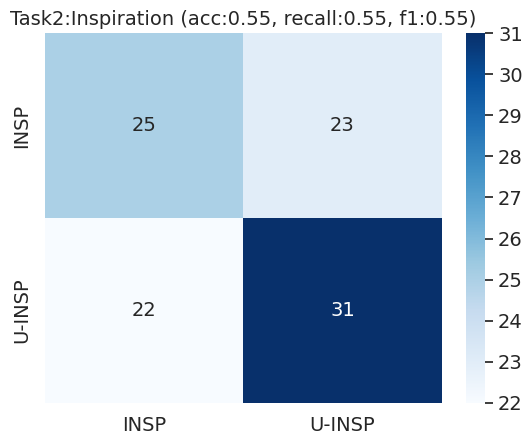

ROC-AUC for Task2:Inspiration: 0.5098


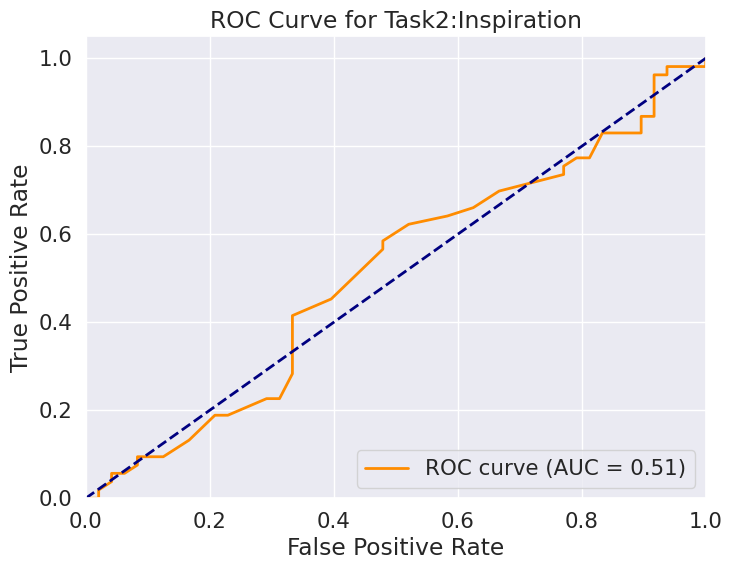

Top 5 Features by Mean Importance:['pose-max_ear_to_ear_difference_x', 'max_eye_move-end_to_begin_left_eye_width', 'median_eye_move-mean_right_eye_height', 'pose-end_to_begin_nose_to_lip_difference_y', 'median_eye_move-mean_left_eye_height']


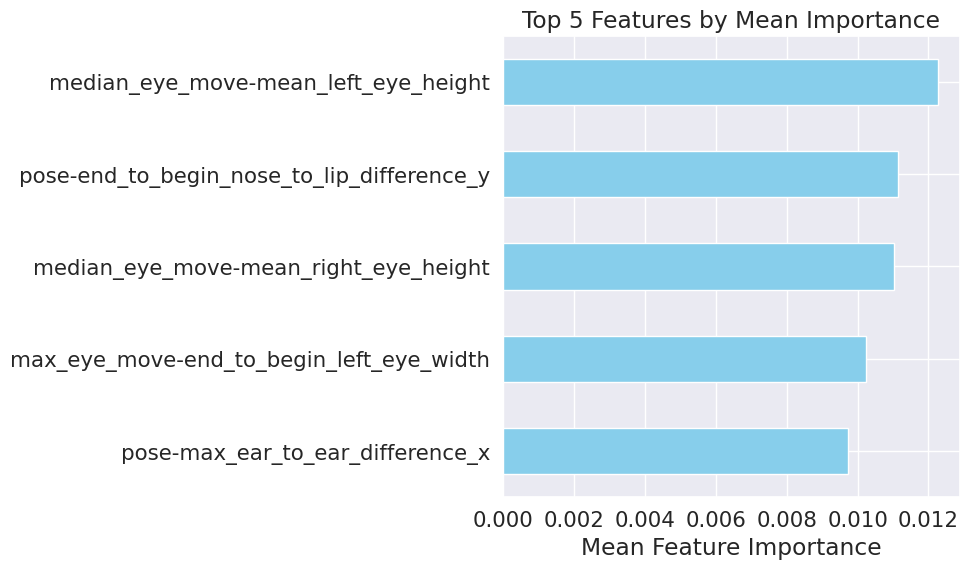

random_state:1
Total Accuracy: 0.22772277227722773
Total Recall: 0.22772277227722773
Total F1 Score: 0.22291892454551576


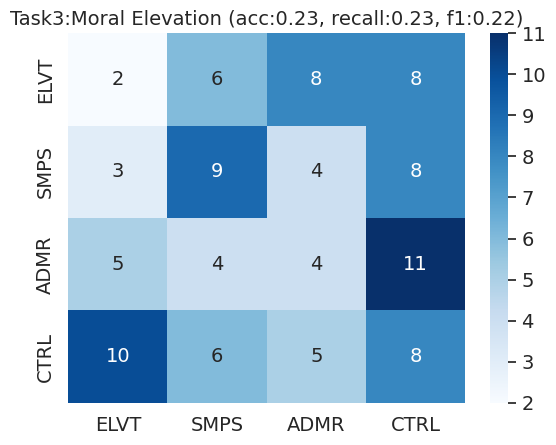

Top 5 Features by Mean Importance:['max_eye_move-end_to_begin_right_iris_relative_x', 'pose-mean_ear_to_ear_difference_x', 'pose-variance_nose_to_lip_difference_y', 'pose-max_ear_to_ear_difference_z', 'pose-max_left_head_angle']


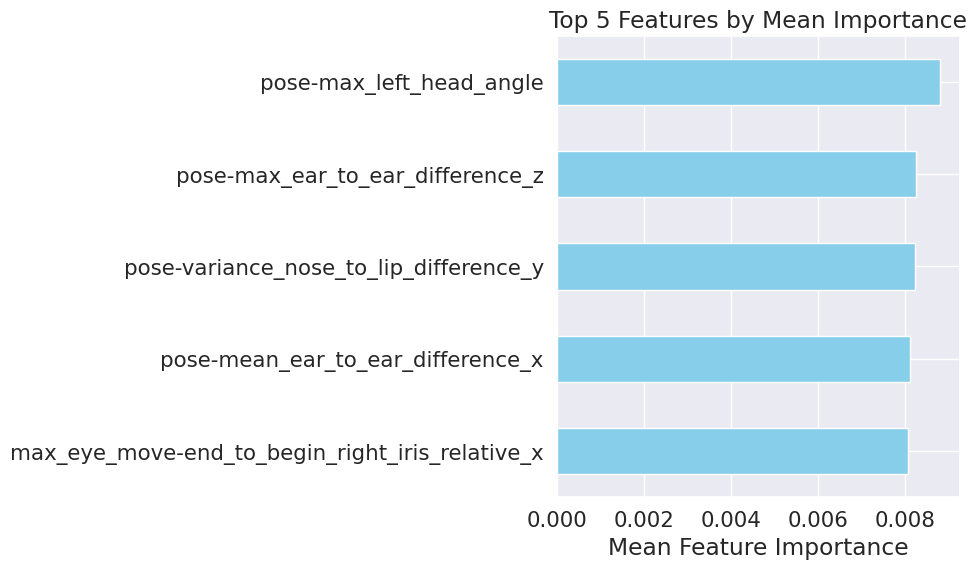

                                              df_name     model_name  do_rfe  \
0    df_acoustics, df_speech_text, df_facial, df_pose  Random Forest   False   
1   df_acoustics, df_speech_text, df_facial, df_ey...  Random Forest   False   
2   df_acoustics, df_speech_text, df_facial, df_re...  Random Forest   False   
3   df_acoustics, df_speech_text, df_facial, df_th...  Random Forest   False   
4   df_acoustics, df_speech_text, df_pose, df_eye_...  Random Forest   False   
5   df_acoustics, df_speech_text, df_pose, df_thermal  Random Forest   False   
6   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
7   df_acoustics, df_speech_text, df_eye_movement,...  Random Forest   False   
8   df_acoustics, df_speech_text, df_remote_ppg, d...  Random Forest   False   
9   df_acoustics, df_facial, df_pose, df_eye_movement  Random Forest   False   
10    df_acoustics, df_facial, df_pose, df_remote_ppg  Random Forest   False   
11       df_acoustics, df_facial, df_pos

,df_name,model_name,do_rfe,rfe_model_name,n_kept,do_model_grid_search,do_anova,Accuracy1,Accuracy2,Accuracy3
0,"df_acoustics, df_speech_text, df_facial, df_pose",Random Forest,False,SVM,15,False,False,0.613861,0.504950,0.297030
1,"df_acoustics, df_speech_text, df_facial, df_ey...",Random Forest,False,SVM,15,False,False,0.534653,0.524752,0.297030
2,"df_acoustics, df_speech_text, df_facial, df_re...",Random Forest,False,SVM,15,False,False,0.574257,0.504950,0.356436
3,"df_acoustics, df_speech_text, df_facial, df_th...",Random Forest,False,SVM,15,False,False,0.564356,0.455446,0.297030
4,"df_acoustics, df_speech_text, df_pose, df_eye_...",Random Forest,False,SVM,15,False,False,0.584158,0.495050,0.366337
5,"df_acoustics, df_speech_text, df_pose, df_thermal",Random Forest,False,SVM,15,False,False,0.544554,0.485149,0.277228
6,"df_acoustics, df_speech_text, df_eye_movement,...",Random Forest,False,SVM,15,False,False,0.603960,0.554455,0.326733
7,"df_acoustics, df_speech_text, df_eye_movement,...",Random Forest,False,SVM,15,False,False,0.534653,0.514851,0.267327
8,"df_acoustics, df_speech_text, df_remote_ppg, d...",Random Forest,False,SVM,15,False,False,0.554455,0.554455,0.287129
9,"df_acoustics, df_facial, df_pose, df_eye_movement",Random Forest,False,SVM,15,False,False,0.514851,0.475248,0.267327


In [60]:
selected_columns = [0,1,2,3,4,5,6]  
df_list = [all_df[i] for i in selected_columns]
df_names_list = [all_df_name[i] for i in selected_columns]
df_all_all_evaluations = pd.DataFrame()
df_all_all_predictions = pd.DataFrame()


# Generate all possible subsets of the list
all_combinations = []

n_included_in_combination_min = 3
n_included_in_combination_min = 4
for r in range(n_included_in_combination_min, n_included_in_combination_min + 1):  # Start with 1 to exclude the empty set
    all_combinations.extend(itertools.combinations(range(len(df_list)), r))

# Iterate over each combination and process it
for combination in all_combinations:
    # Get the actual DataFrames and their names for the current combination
    subset_dfs = [all_df[i] for i in combination]
    subset_names = [df_names_list[i] for i in combination]

    # Keep all columns for the first DataFrame, and only the third to end for others
    merged_df = subset_dfs[0].copy()  # Start with the first DataFrame
    for df in subset_dfs[1:]:
        # Concatenate with only the third to the last columns
        merged_df = pd.concat([merged_df, df.iloc[:, 2:]], axis=1)
        
    data_prepare_helper = psychai.data_preparation.data_preparation.DataPreparationHelper(merged_df.copy())
    parameter = {
        "replace_missing_data_with_median":True,
        "remove_all_nan_rows": True
    }
    df_prepared = data_prepare_helper.prepare_data(parameter)

    # Create a string representation of included DataFrames
    included_dfs = ", ".join(subset_names)
    print(f"Processing combination: {included_dfs}")

   # Set a fixed random state for reproducibility
    # This ensures that the results are consistent across runs by initializing the random seed
    random_state = 1

    group_column_list = ["user_id"]

    # Define parameter options
    # Number of features to retain after feature selection
    n_kept_list = [15]  # This can be adjusted to include more values for experimentation

    # Boolean flags indicating whether to perform specific preprocessing steps
    # Whether to perform ANOVA (Analysis of Variance) feature selection

    do_anova_list = [False]  # ANOVA helps in selecting features with significant differences across classes

    # Whether to perform Recursive Feature Elimination (RFE), a wrapper method for feature selection
    do_RFE_list = [False, True]

    # Whether to perform model hyperparameter tuning using Grid Search
    do_model_grid_search_list = [False]  # Grid Search is computationally expensive but optimizes hyperparameters

    # List of models to use for RFE (Recursive Feature Elimination)
    RFE_model_name_list = ["SVM"]  # Options can include "Decision Tree", "XGBoost", etc.

    # List of models to use for the final classification task
    default_model_name_list = ["Random Forest"]  # Options can include "SVM", "Logistic Regression", etc.

    # Generate all combinations of parameter values using Cartesian product
    # This ensures we test all combinations of the hyperparameters defined above
    param_combinations = list(itertools.product(
        n_kept_list, do_anova_list, do_RFE_list, do_model_grid_search_list, default_model_name_list, RFE_model_name_list, group_column_list
    ))
    try:
        df_all_evaluations, df_all_predictions = run_analysis(df_prepared, included_dfs, param_combinations)
        df_all_all_evaluations = pd.concat([df_all_all_evaluations, df_all_evaluations], ignore_index=True)
        print(df_all_all_evaluations)
    except:
        print(f"error for: {included_dfs}")

df_all_all_evaluations

## Late Fusion

### Trial 1

In [ ]:
df_combined = pd.DataFrame()
df_combined["predicted"] = all_y_pred
df_combined["actual"] = all_y_true
df_combined["user_id"] = all_group
df_combined["modality"] = all_model_name
df_combined.to_csv(r"/mnt/c/Working/Programming/Python/wsl/wsl2/examples/paper5_mmer_moral/emotion_recognition/combined.csv")
df_combined

In [108]:
df_new = pd.DataFrame({'user_id': range(1, 118)})
# Step 1: Take the first row for each user_id in df_combined
df_combined_first = df_combined.groupby('user_id').first().reset_index()
# Step 2: Merge df_new with df_combined_first on 'user_id'
df_new = df_new.merge(df_combined_first[['user_id', 'actual']], on='user_id', how='left')

# Step 1: Filter distinct entries of 'modality' for each 'user_id' and 'modality' combination
df_combined_distinct = df_combined.groupby(['user_id', 'modality']).first().reset_index()


# Step 2: Pivot df_combined_distinct to have separate columns for each 'modality'
df_pivoted = df_combined_distinct.pivot(index='user_id', columns='modality', values='predicted').reset_index()

# Rename columns to make them clear (optional)
df_pivoted.columns = [f"predicted_{col}" if col != 'user_id' else col for col in df_pivoted.columns]

# Step 3: Merge the pivoted DataFrame with df_new on 'user_id'
df_new = df_new.merge(df_pivoted, on='user_id', how='left')

df_new =  df_new.dropna(subset=['actual'])

df_new = df_new.reset_index()

feature_columns = ["predicted_df_acoustics","predicted_df_eye_movement","predicted_df_facial","predicted_df_mm_llm","predicted_df_pose","predicted_df_remote_ppg","predicted_df_speech_text","predicted_df_thermal"]

feature_columns = ["predicted_df_mm_llm","predicted_df_speech_text"]

In [ ]:
import pandas as pd
import seaborn as sns
from sklearn.model_selection import StratifiedKFold, cross_val_predict, KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import matplotlib.pyplot as plt
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
# Assume df_new is already loaded

# Step 1: Prepare features (X) and target (y)
# X = df_new.drop(columns=['user_id', 'actual','index'])  # Features
X = df_new[feature_columns]
y = df_new['actual']  # Target

# Assume df_new is already loaded

# Step 1: Prepare features (X) and target (y)
# X = df_new.drop(columns=['user_id', 'actual'])  # Features

# Convert 'actual' to strings to ensure consistency
# df_new['actual'] = df_new['actual'].astype(str)
y = df_new['actual']  # Target

# Step 2: Handle NaN values
# Replace NaN with the most frequent value for each nominal column
imputer = SimpleImputer(strategy='most_frequent')
X_imputed = imputer.fit_transform(X)

# Step 3: Encode nominal data
# One-hot encode categorical features
encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)  # Use sparse_output=False for dense output
X_encoded = encoder.fit_transform(X_imputed)

# Step 4: Initialize the model
# classifier = SVC(random_state=42)

#classifier = MLPClassifier(random_state=42, hidden_layer_sizes = (32,16))
classifier = LogisticRegression(random_state=random_state, max_iter=1000)
# Step 5: Perform 10-Fold Cross-Validation and Predict
cv = KFold(n_splits=10, shuffle=True, random_state=random_state)  # Stratified for class balance

y_pred = cross_val_predict(classifier, X_encoded, y, cv=cv)

# Step 6: Compute the Confusion Matrix
# Map labels to desired order
label_order = ["ELVT", "CMPS", "ADMR", "CTRL"]
cm = confusion_matrix(y, y_pred, labels=label_order)

# Print prediction metrics
print("Classification Report:")
print(classification_report(y, y_pred, target_names=label_order))

# Calculate overall accuracy
accuracy = accuracy_score(y, y_pred)
print(f"Accuracy: {accuracy:.4f}")

# Step 7: Visualize the Confusion Matrix using Heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_order, yticklabels=label_order)
plt.title("Confusion Matrix (10-Fold Cross-Validation)")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()


### Trial 2.1

In [49]:
df_multimodal_predictions.columns = ['modality', 'predicted', 'actual', 'user_id']
df_multimodal_predictions

entry_list_compassion = ['CMPS','N-CMPS']  # Replace with actual values
entry_list_inspiration = ['INSP', 'U-INSP']          # Replace with actual values
entry_list_moral_elevation = ["ELVT","SMPS","ADMR","CTRL"]  # Replace with actual values

# Filter the DataFrame based on the 'actual' column values in each list
df_compassion = df_multimodal_predictions[df_multimodal_predictions['actual'].isin(entry_list_compassion)]
df_inspiration = df_multimodal_predictions[df_multimodal_predictions['actual'].isin(entry_list_inspiration)]
df_moral_elevation = df_multimodal_predictions[df_multimodal_predictions['actual'].isin(entry_list_moral_elevation)]

df_compassion = df_compassion.reset_index().iloc[:,1:]
df_inspiration = df_inspiration.reset_index().iloc[:,1:]
df_moral_elevation = df_moral_elevation.reset_index().iloc[:,1:]


In [50]:
def reorganize_data_frame(df):
    df_new = pd.DataFrame({'user_id': range(1, 118)})

    # Step 1: Take the first row for each user_id in df_combined
    df_combined_first = df.groupby('user_id').first().reset_index()

    # Step 2: Merge df_new with df_combined_first on 'user_id'
    df_new = df_new.merge(df_combined_first[['user_id', 'actual']], on='user_id', how='left')

    # Step 1: Filter distinct entries of 'modality' for each 'user_id' and 'modality' combination
    df_combined_distinct = df.groupby(['user_id', 'modality']).first().reset_index()

    # Step 2: Pivot df_combined_distinct to have separate columns for each 'modality'
    df_pivoted = df_combined_distinct.pivot(index='user_id', columns='modality', values='predicted').reset_index()

    # Rename columns to make them clear (optional)
    df_pivoted.columns = [f"predicted_{col}" if col != 'user_id' else col for col in df_pivoted.columns]

    # Step 3: Merge the pivoted DataFrame with df_new on 'user_id'
    df_new = df_new.merge(df_pivoted, on='user_id', how='left')

    df_new =  df_new.dropna(subset=['actual'])

    df_new = df_new.reset_index()

    return df_new

df_compassion_updated = reorganize_data_frame(df_compassion)
df_inspiration_updated = reorganize_data_frame(df_inspiration)
df_moral_elevation_updated = reorganize_data_frame(df_moral_elevation)

Classification Report:
              precision    recall  f1-score   support

        CMPS       0.80      0.80      0.80        49
      N-CMPS       0.81      0.81      0.81        54

    accuracy                           0.81       103
   macro avg       0.81      0.81      0.81       103
weighted avg       0.81      0.81      0.81       103

Accuracy: 0.8058


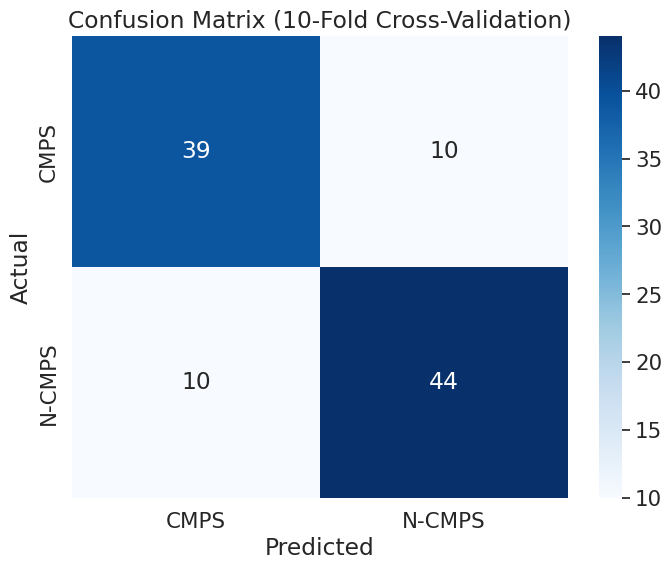

Classification Report:
              precision    recall  f1-score   support

        INSP       0.48      0.42      0.44        48
      U-INSP       0.54      0.60      0.57        55

    accuracy                           0.51       103
   macro avg       0.51      0.51      0.51       103
weighted avg       0.51      0.51      0.51       103

Accuracy: 0.5146


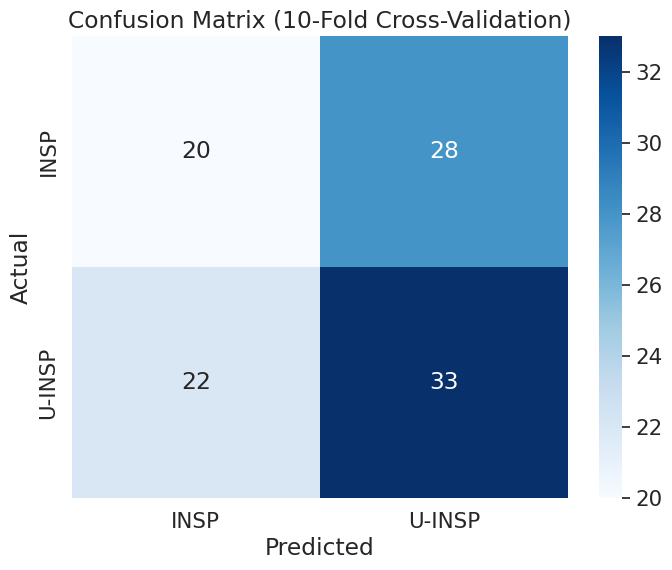

Classification Report:
              precision    recall  f1-score   support

        ELVT       0.40      0.42      0.41        24
        SMPS       0.80      0.93      0.86        30
        ADMR       0.43      0.42      0.43        24
        CTRL       0.30      0.24      0.27        25

    accuracy                           0.52       103
   macro avg       0.48      0.50      0.49       103
weighted avg       0.50      0.52      0.51       103

Accuracy: 0.5243


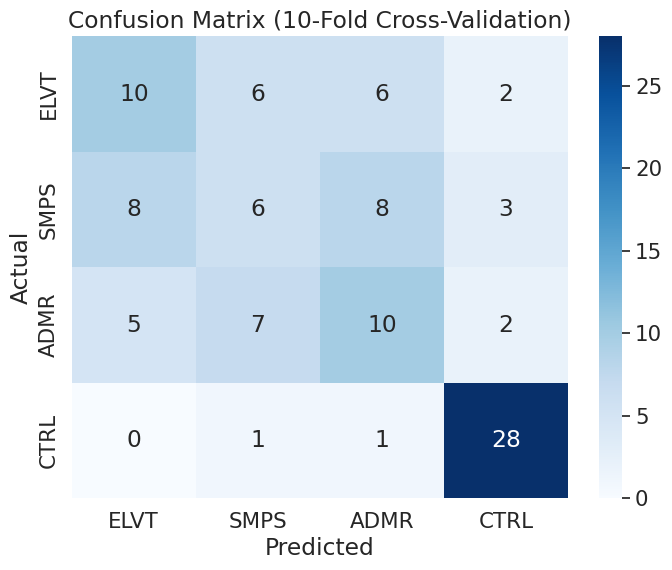

In [51]:
def predict(df, label_order):
    # Assume df_new is already loaded

    X = df.iloc[:,3:]
    y = df['actual']  # Target

    # Step 2: Handle NaN values
    # Replace NaN with the most frequent value for each nominal column
    imputer = SimpleImputer(strategy='most_frequent')
    X_imputed = imputer.fit_transform(X)

    # Step 3: Encode nominal data
    # One-hot encode categorical features
    encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)  # Use sparse_output=False for dense output
    X_encoded = encoder.fit_transform(X_imputed)


    # Step 4: Initialize the model
    # classifier = SVC(random_state=42)

    #classifier = MLPClassifier(random_state=42, hidden_layer_sizes = (32,16))
    classifier = LogisticRegression(random_state=random_state, max_iter=100)
    # classifier = RandomForestClassifier(random_state=random_state)
    
    # Step 5: Perform 10-Fold Cross-Validation and Predict
    cv = KFold(n_splits=10, shuffle=True, random_state=random_state)  # Stratified for class balance

    y_pred = cross_val_predict(classifier, X_encoded, y, cv=cv)

    # Step 6: Compute the Confusion Matrix
    # Map labels to desired order
    # label_order = ["ELVT", "CMPS", "ADMR", "CTRL"]
    cm = confusion_matrix(y, y_pred, labels=label_order)

    # Print prediction metrics
    print("Classification Report:")
    print(classification_report(y, y_pred, target_names=label_order))

    # Calculate overall accuracy
    accuracy = accuracy_score(y, y_pred)
    print(f"Accuracy: {accuracy:.4f}")

    # Step 7: Visualize the Confusion Matrix using Heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_order, yticklabels=label_order)
    plt.title("Confusion Matrix (10-Fold Cross-Validation)")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

predict(df_compassion_updated, label_order = entry_list_compassion)
predict(df_inspiration_updated, label_order = entry_list_inspiration)
predict(df_moral_elevation_updated, label_order = entry_list_moral_elevation)

### Trial 2.2

In [ ]:
df_compassion_updated

Classification Report:
              precision    recall  f1-score   support

        CMPS       0.80      0.88      0.83        49
      N-CMPS       0.88      0.80      0.83        54

    accuracy                           0.83       103
   macro avg       0.84      0.84      0.83       103
weighted avg       0.84      0.83      0.83       103

Accuracy: 0.8350


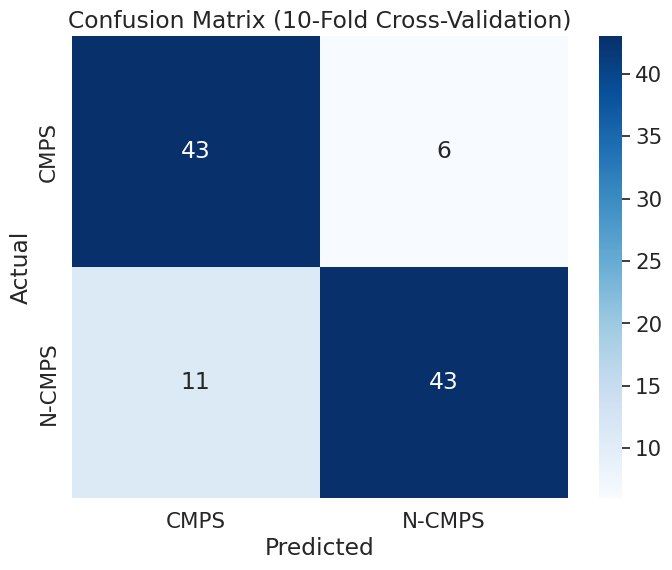

Classification Report:
              precision    recall  f1-score   support

        INSP       0.52      0.46      0.49        48
      U-INSP       0.57      0.64      0.60        55

    accuracy                           0.55       103
   macro avg       0.55      0.55      0.55       103
weighted avg       0.55      0.55      0.55       103

Accuracy: 0.5534


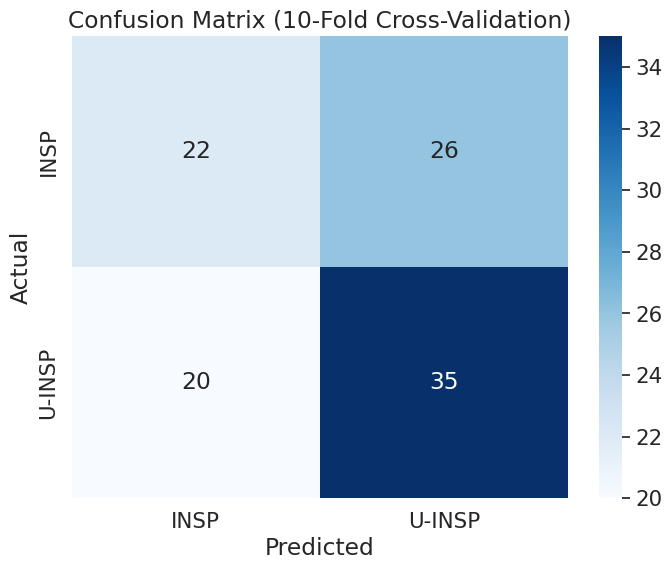

Classification Report:
              precision    recall  f1-score   support

        ELVT       0.39      0.46      0.42        24
        SMPS       0.82      0.90      0.86        30
        ADMR       0.56      0.42      0.48        24
        CTRL       0.38      0.36      0.37        25

    accuracy                           0.55       103
   macro avg       0.54      0.53      0.53       103
weighted avg       0.55      0.55      0.55       103

Accuracy: 0.5534


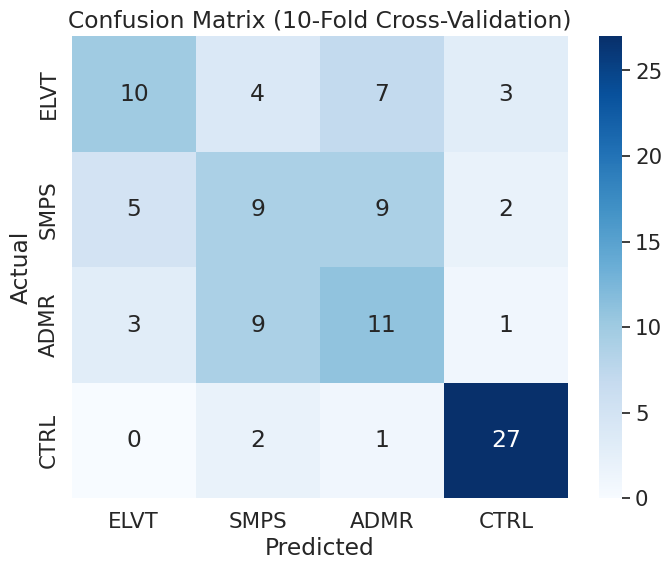

In [52]:
selected_columns = ['user_id','actual','predicted_acoustics','predicted_speech_text','predicted_facial','predicted_r-PPG','predicted_mllm']
# selected_columns = ['user_id','actual','predicted_mllm','predicted_speech_text']
predict(df_compassion_updated[selected_columns], label_order = entry_list_compassion)
predict(df_inspiration_updated[selected_columns], label_order = entry_list_inspiration)
predict(df_moral_elevation_updated[selected_columns], label_order = entry_list_moral_elevation)

- ref
    - https://github.com/PacktPublishing/Data-Augmentation-with-Python